## Projet 7 : Réalisez une analyse de sentiments grâce au Deep Learning

## Contexte

Vous êtesingénieur IA chez "Marketing Intelligence Consulting", une entreprise de conseil spécialisée sur les problématiques de marketing digital.

"Air Paradis" a missionné votre cabinet pour créer un produit IA permettant d’anticiper les bad buzz sur les réseaux sociaux en permettant de prédire le sentiment associé à un tweet.

Marc, votre manager, vous demande de tester plusieurs approches :
- approche “Modèle sur mesure simple”, pour développer rapidement un modèle classique (ex : régression logistique) permettant de prédire le sentiment associé à un tweet.
- approche “Modèle sur mesure avancé” pour développer un modèle basé sur des réseaux de neurones profonds pour prédire le sentiment associé à un tweet. => C’est ce modèle qui sera déployé et montré à Air Paradis.

Une démarche MLOPS devra être mis en oeuvre.

Le déploiement selon un pipeline continu du modèle via API intègrera également des tests unitaires automatisés.

Un suivi de performance du modèle en production sera également mis en place.

## Librairies utilisées avec le langage Python :

In [1]:
# Importation des librairies
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import csv
import json
import requests
import zipfile
import gzip
import shutil
import ast
import subprocess
import webbrowser
import time
# from sklearn.feature_extraction.text import TfidfVectorizer
# from sklearn.linear_model import LogisticRegressionCV
from tqdm import tqdm
import torch
from transformers import AutoTokenizer, AutoModelForSequenceClassification, ModernBertModel, ModernBertForTokenClassification, ModernBertForSequenceClassification, Trainer, TrainingArguments, TrainerCallback
import torch.nn as nn
import torch.optim
from torch.optim import AdamW
# import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader
# import torchtext
# from torchtext.data import get_tokenizer
from collections import Counter
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, LSTM, GRU, Dense, Dropout, Conv1D, MaxPooling1D, Bidirectional, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam , SGD, Adamax, RMSprop
from tensorflow.keras.regularizers import l2
from tensorflow.keras.utils import to_categorical
from plot_keras_history import show_history, plot_history
from datasets import Dataset
# import tensorflow_hub as hub
# from tensorflow import keras
# from nltk.corpus import stopwords, words
# from nltk.tokenize import word_tokenize, wordpunct_tokenize, RegexpTokenizer
# from nltk.stem import WordNetLemmatizer, PorterStemmer
# from nltk.util import ngrams
# from wordcloud import WordCloud
# from pandarallel import pandarallel
# pandarallel.initialize()
# from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
# from gensim.models import Word2Vec
# from transformers import BertTokenizer, BertModel
# from sklearn.decomposition import PCA
# from sklearn.cluster import KMeans
# from sklearn import manifold
# from sklearn.model_selection import KFold
from sklearn.metrics import adjusted_rand_score, classification_report, confusion_matrix, accuracy_score, roc_auc_score, recall_score, f1_score
from itertools import product
# from scipy.sparse import csr_matrix
# import multiprocessing
import mlflow
import mlflow.sklearn
import mlflow.tensorflow
import mlflow.pytorch
import mlflow.keras
import os
import warnings
warnings.filterwarnings('ignore')


In [2]:
# RaZ des runs mlflow
# shutil.rmtree('D:/tutorial-env/OCR/Projet7/mlruns', ignore_errors=True)

# Création répertoire local pour les logs MLFlow
local_path = "D:/tutorial-env/OCR/Projet7/mlruns"
# local_path = "/content/mlruns"
os.makedirs(local_path,exist_ok=True)

mlflow.set_tracking_uri(f"file:///{local_path}")
mlflow.set_experiment("RNN")

<Experiment: artifact_location='file:///D:/tutorial-env/OCR/Projet7/mlruns/342420157858240682', creation_time=1737385843073, experiment_id='342420157858240682', last_update_time=1737385843073, lifecycle_stage='active', name='RNN', tags={}>

# Neural Network From Scratch

Pour commencer, nous n'utiliserons pas d'embeddings pré-entrainés.

Nous devons donc manuellement pré-traiter nos données (tokenization, padding,...)

## Données :

In [3]:
# Importation de data :
X_train = pd.read_csv('D:/tutorial-env/OCR/Projet7/csv_p7_Xtrain_preprocessed.csv')
X_val = pd.read_csv('D:/tutorial-env/OCR/Projet7/csv_p7_Xval_preprocessed.csv')
X_test = pd.read_csv('D:/tutorial-env/OCR/Projet7/csv_p7_Xtest_preprocessed.csv')


In [ ]:
X_train.head()

,target,text,len_text,tweet_preprocess,token_by_tweet_temp,token_by_tweet_finalised,token_by_tweet_temp_sans_racinisation,token_by_tweet_finalised_sans_racinisation
0,0,Its a Blood red half moon. A beatle Landed on ...,120,Its a Blood red half moon. A beatle Landed on ...,"['blood', 'red', 'half', 'moon', 'beatl', 'lan...","['blood', 'red', 'half', 'moon', 'beatl', 'lan...","['blood', 'red', 'half', 'moon', 'beatle', 'la...","['blood', 'red', 'half', 'moon', 'saint', 'med..."
1,0,I'm so tense today I genuinely fear spontaneou...,138,I'm so tense today I genuinely fear spontaneou...,"['tens', 'genuin', 'fear', 'spontan', 'combust...","['tens', 'genuin', 'fear', 'spontan', 'combust...","['tense', 'genuinely', 'fear', 'spontaneously'...","['fear', 'left', 'worn', 'better', 'shoes_worn']"
2,0,Is doing revision...AGAIN!!,28,Is doing revision...AGAIN!!,['revis'],['revis'],['revision'],[]
3,1,@manuanya it just. *squishes* reminds me of ou...,98,it just. *squishes* reminds me of our glorious...,"['squish', 'remind', 'gloriou', 'media', 'room...","['squish', 'remind', 'gloriou', 'media', 'room...","['squishes', 'reminds', 'glorious', 'media', '...","['glorious', 'media', 'room', 'couch', 'liverp..."
4,1,watching letterman and talking,31,watching letterman and talking,"['watch', 'letterman', 'talk', 'watching_lette...","['watch', 'letterman', 'talk', 'watching_lette...","['watching', 'letterman', 'talking', 'watching...","['letterman', 'watching_letterman']"


In [ ]:
typ = type(X_train['token_by_tweet_finalised_sans_racinisation'][0])
print(f'le type de la colonne token_by_tweet_finalised_sans_racinisation est :{typ}')

le type de la colonne token_by_tweet_finalised_sans_racinisation est :<class 'str'>


On va transformer la chaine de caractère en liste de tokens comme initialement, puis on les retransformera en chaine de caractères sans les "codes" de la liste ( [ , ' )

In [4]:
# Conversion en liste de tokens (et non plus str) comme initialement
X_train['token_by_tweet_finalised_sans_racinisation'] = X_train['token_by_tweet_finalised_sans_racinisation'].apply(lambda x: ast.literal_eval(x))
X_val['token_by_tweet_finalised_sans_racinisation'] = X_val['token_by_tweet_finalised_sans_racinisation'].apply(lambda x: ast.literal_eval(x))
X_test['token_by_tweet_finalised_sans_racinisation'] = X_test['token_by_tweet_finalised_sans_racinisation'].apply(lambda x: ast.literal_eval(x))

X_train.head()

,target,text,len_text,tweet_preprocess,token_by_tweet_temp,token_by_tweet_finalised,token_by_tweet_temp_sans_racinisation,token_by_tweet_finalised_sans_racinisation
0,0,Its a Blood red half moon. A beatle Landed on ...,120,Its a Blood red half moon. A beatle Landed on ...,"['blood', 'red', 'half', 'moon', 'beatl', 'lan...","['blood', 'red', 'half', 'moon', 'beatl', 'lan...","['blood', 'red', 'half', 'moon', 'beatle', 'la...","[blood, red, half, moon, saint, medal, neck, b..."
1,0,I'm so tense today I genuinely fear spontaneou...,138,I'm so tense today I genuinely fear spontaneou...,"['tens', 'genuin', 'fear', 'spontan', 'combust...","['tens', 'genuin', 'fear', 'spontan', 'combust...","['tense', 'genuinely', 'fear', 'spontaneously'...","[fear, left, worn, better, shoes_worn]"
2,0,Is doing revision...AGAIN!!,28,Is doing revision...AGAIN!!,['revis'],['revis'],['revision'],[]
3,1,@manuanya it just. *squishes* reminds me of ou...,98,it just. *squishes* reminds me of our glorious...,"['squish', 'remind', 'gloriou', 'media', 'room...","['squish', 'remind', 'gloriou', 'media', 'room...","['squishes', 'reminds', 'glorious', 'media', '...","[glorious, media, room, couch, liverpool, medi..."
4,1,watching letterman and talking,31,watching letterman and talking,"['watch', 'letterman', 'talk', 'watching_lette...","['watch', 'letterman', 'talk', 'watching_lette...","['watching', 'letterman', 'talking', 'watching...","[letterman, watching_letterman]"


In [ ]:
typ = type(X_train['token_by_tweet_finalised_sans_racinisation'][0])
print(f'le type de la colonne token_by_tweet_finalised_sans_racinisation est :{typ}')

le type de la colonne token_by_tweet_finalised_sans_racinisation est :<class 'list'>


In [5]:
# Calculdu nombre de token dans chaque tweet
X_train['num_tokens'] = X_train['token_by_tweet_finalised_sans_racinisation'].apply(lambda x: len(x))
X_train.head()

,target,text,len_text,tweet_preprocess,token_by_tweet_temp,token_by_tweet_finalised,token_by_tweet_temp_sans_racinisation,token_by_tweet_finalised_sans_racinisation,num_tokens
0,0,Its a Blood red half moon. A beatle Landed on ...,120,Its a Blood red half moon. A beatle Landed on ...,"['blood', 'red', 'half', 'moon', 'beatl', 'lan...","['blood', 'red', 'half', 'moon', 'beatl', 'lan...","['blood', 'red', 'half', 'moon', 'beatle', 'la...","[blood, red, half, moon, saint, medal, neck, b...",13
1,0,I'm so tense today I genuinely fear spontaneou...,138,I'm so tense today I genuinely fear spontaneou...,"['tens', 'genuin', 'fear', 'spontan', 'combust...","['tens', 'genuin', 'fear', 'spontan', 'combust...","['tense', 'genuinely', 'fear', 'spontaneously'...","[fear, left, worn, better, shoes_worn]",5
2,0,Is doing revision...AGAIN!!,28,Is doing revision...AGAIN!!,['revis'],['revis'],['revision'],[],0
3,1,@manuanya it just. *squishes* reminds me of ou...,98,it just. *squishes* reminds me of our glorious...,"['squish', 'remind', 'gloriou', 'media', 'room...","['squish', 'remind', 'gloriou', 'media', 'room...","['squishes', 'reminds', 'glorious', 'media', '...","[glorious, media, room, couch, liverpool, medi...",7
4,1,watching letterman and talking,31,watching letterman and talking,"['watch', 'letterman', 'talk', 'watching_lette...","['watch', 'letterman', 'talk', 'watching_lette...","['watching', 'letterman', 'talking', 'watching...","[letterman, watching_letterman]",2


,count,mean,std,min,25%,50%,75%,90%,95%,max
num_tokens,128000.0,6.480836,4.619397,0.0,3.0,6.0,9.0,13.0,15.0,43.0


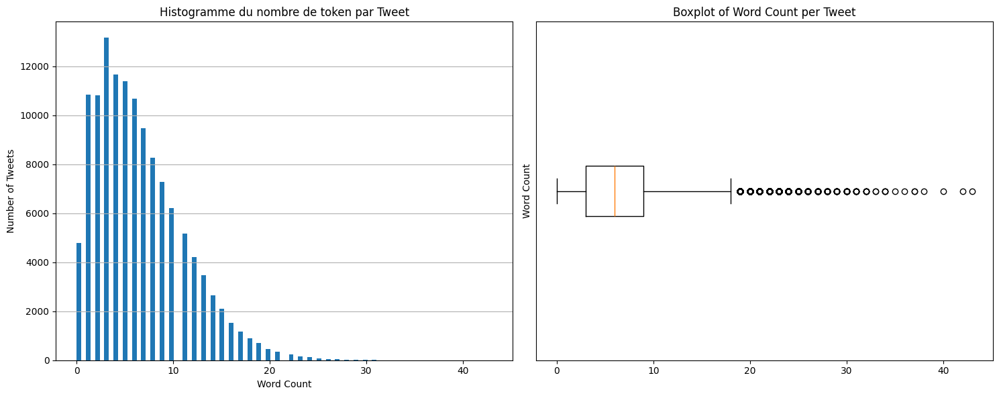

In [ ]:
# Statistiques descriptives pour choisir la valeur du paramètre max_seq_length de notre NN pour minimiser les coûts mémoire sans perdre trop d'informations
describe = pd.DataFrame(X_train['num_tokens'].describe()).T
percentile_90 = X_train['num_tokens'].quantile(0.90)
describe['90%'] = percentile_90
percentile_95 = X_train['num_tokens'].quantile(0.95)
describe['95%'] = percentile_95
describe = describe[[col for col in describe if col != "max"] + ["max"]]
display(describe)

# Visualisation
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Histogramme
ax1.hist(X_train['num_tokens'], bins=90)
ax1.set_title('Histogramme du nombre de token par Tweet')
ax1.set_xlabel('Word Count')
ax1.set_ylabel('Number of Tweets')
ax1.grid(axis='y')

# Boxplot of word count per tweet on the second axis (ax2)
ax2.boxplot(X_train['num_tokens'], vert=False)
ax2.set_title('Boxplot of Word Count per Tweet')
ax2.set_ylabel('Word Count')
ax2.set_yticks([])

# Adjust layout to avoid overlap
plt.tight_layout()
plt.show()



## Dictionnaires mots-indices et inversement :

Faisons un dictionnaire avec nos tokens du jeu d'entrainement :


In [6]:
chemin_fichier = "D:/tutorial-env/OCR/Projet7/all_tokens_train_sansracinisation.json"

try :
  with open (chemin_fichier, 'r', encoding = 'utf_8') as file :
    tokens = json.load(file)

    token_count = Counter(tokens)

    sorted_token_count = sorted(token_count.items(), key=lambda x: x[1], reverse=True)

    for token, count in sorted_token_count [:20]:
      print(f"{token}: {count}")
except FileNotFoundError :
  print('Le fichier n\'existe pas')


work: 5242
love: 5230
got: 4969
lol: 4780
time: 4567
back: 4535
one: 4349
know: 4163
amp: 3831
see: 3754
want: 3503
well: 3453
night: 3421
still: 3418
new: 3410
think: 3370
home: 3310
much: 3013
miss: 2913
need: 2886


In [7]:
# Fonction pour transformer chaque tweet d'une sequence de token en sequence d'indices

def tokens_to_idx(sentences_tokens,word_to_idx):
  sentences_idx = []
  for sent in sentences_tokens:
    sent_idx = []
    for word in sent:
      if word in word_to_idx:
        sent_idx.append(word_to_idx[word])
      else:
        sent_idx.append(word_to_idx['UNK'])
    sentences_idx.append(sent_idx)
  return sentences_idx

La fonction nous servira à transformer nos séquences en indices.

## Padding :

Et maintenant une fonction pour que les séquences aient la même longueur, on va donc tronquer les plus longues et remplir les plus courtes avec des 0.

In [8]:
# Fonction de padding pour définir une même longueur pour toutes les séquences
def padding(sentences, seq_len):
  features = np.zeros((len(sentences), seq_len),dtype=int)
  for ii, tweet in enumerate(sentences):
    len_tweet = len(tweet)
    if len_tweet != 0:
      if len_tweet <= seq_len:
        # If its shorter, we fill with zeros (the padding Token index)
        features[ii, -len(tweet):] = np.array(tweet)[:seq_len]
      if len_tweet > seq_len:
        # If its larger, we take the last 'seq_len' indexes
        features[ii, :] = np.array(tweet)[-seq_len:]
  return features

## Modèle de RNN :

-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit64_batch_size32_max_length15_num_words10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 60s 14ms/step - accuracy: 0.5307 - loss: 2.0999 - val_accuracy: 0.5796 - val_loss: 1.0782 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 15ms/step - accuracy: 0.5909 - loss: 0.9566 - val_accuracy: 0.6052 - val_loss: 0.7395 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 59s 15ms/step - accuracy: 0.6184 - loss: 0.7124 - val_accuracy: 0.6210 - val_loss: 0.6661 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 59s 15ms/step - accuracy: 0.6347 - loss: 0.6544 - val_accuracy: 0.6272 - val_loss: 0.6473 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 59s 15ms/step - accuracy: 0.6432 - loss: 0.6363 - val_accuracy: 0.6272 - val_loss: 0.6478 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 59s 15ms/step - accuracy:

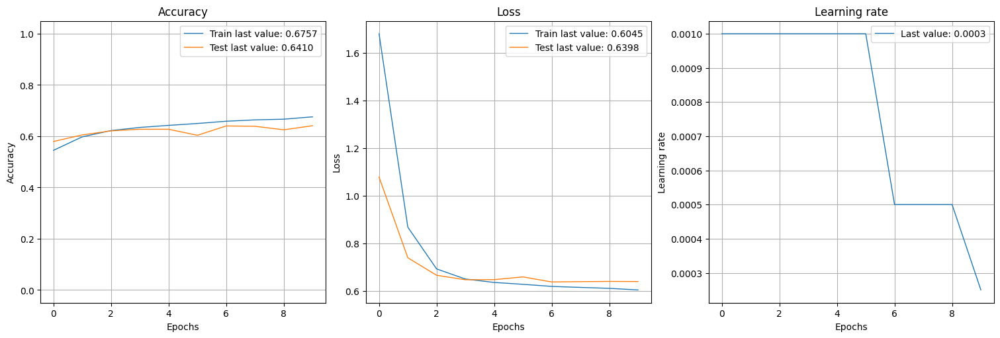

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step


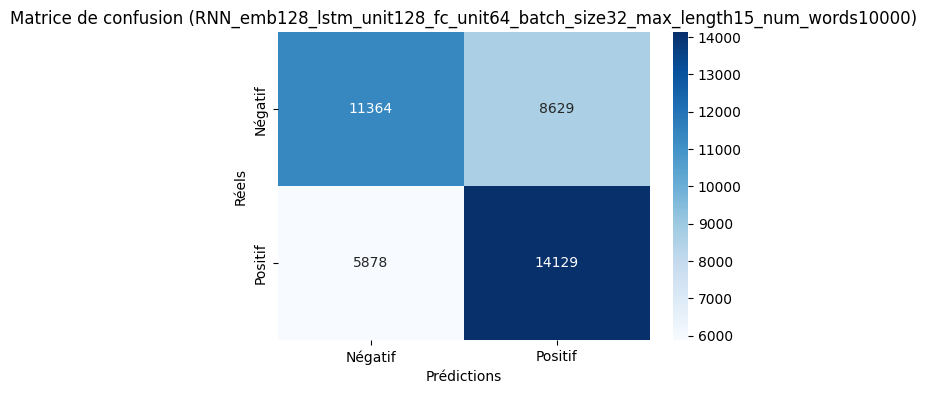

2025/03/07 12:47:56 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 12:48:12 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit64_batch_size32_max_length15_num_words30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 82s 20ms/step - accuracy: 0.5243 - loss: 2.1067 - val_accuracy: 0.5508 - val_loss: 1.0892 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 75s 19ms/step - accuracy: 0.5718 - loss: 0.9682 - val_accuracy: 0.6013 - val_loss: 0.7455 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 75s 19ms/step - accuracy: 0.6098 - loss: 0.7201 - val_accuracy: 0.6160 - val_loss: 0.6691 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 75s 19ms/step - accuracy: 0.6341 - loss: 0.6583 - val_accuracy: 0.6114 - val_loss: 0.6757 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 74s 19ms/step - accuracy: 0.6431 - loss: 0.6380 - val_accuracy: 0.6323 - val_loss: 0.6427 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 78s 20ms/step - accuracy:

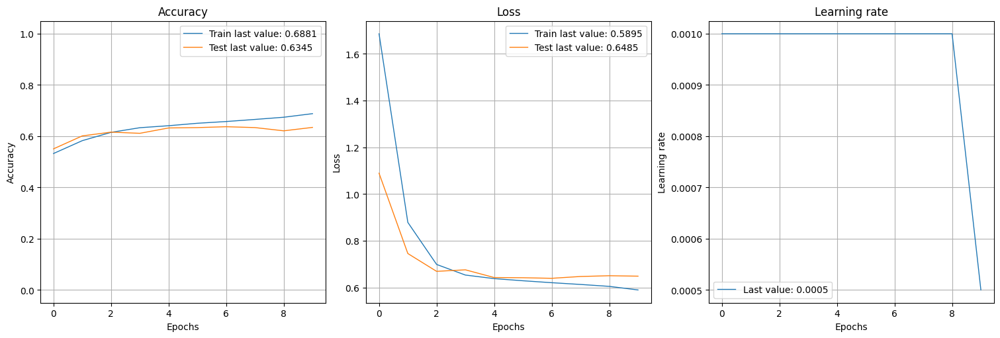

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


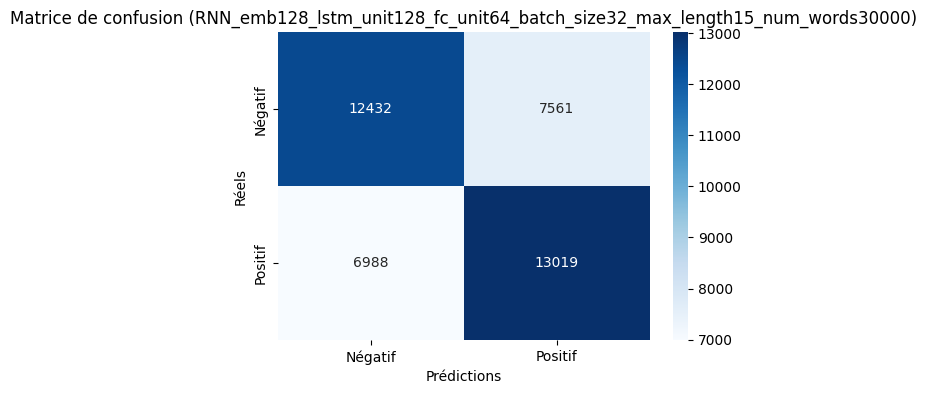

2025/03/07 13:01:02 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 13:01:14 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit64_batch_size32_max_length15_num_words50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 105s 26ms/step - accuracy: 0.5315 - loss: 2.1240 - val_accuracy: 0.5546 - val_loss: 1.0870 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 96s 24ms/step - accuracy: 0.5951 - loss: 0.9600 - val_accuracy: 0.6164 - val_loss: 0.7362 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 96s 24ms/step - accuracy: 0.6247 - loss: 0.7090 - val_accuracy: 0.6237 - val_loss: 0.6667 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 97s 24ms/step - accuracy: 0.6367 - loss: 0.6513 - val_accuracy: 0.6179 - val_loss: 0.6481 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 100s 25ms/step - accuracy: 0.6484 - loss: 0.6335 - val_accuracy: 0.6192 - val_loss: 0.6450 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 97s 24ms/step - accurac

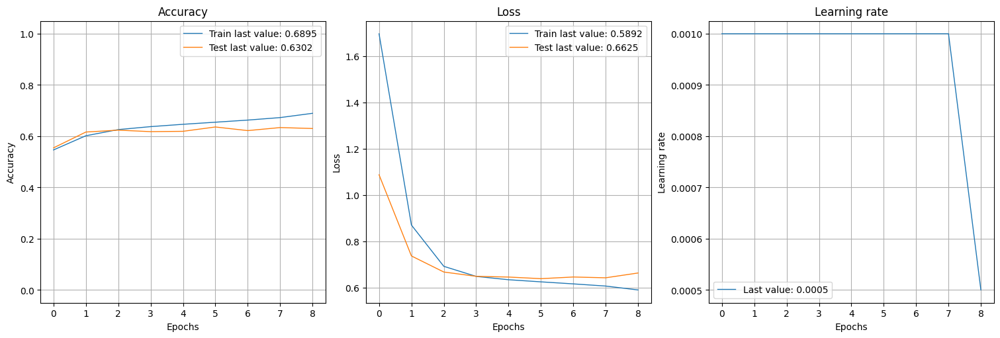

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


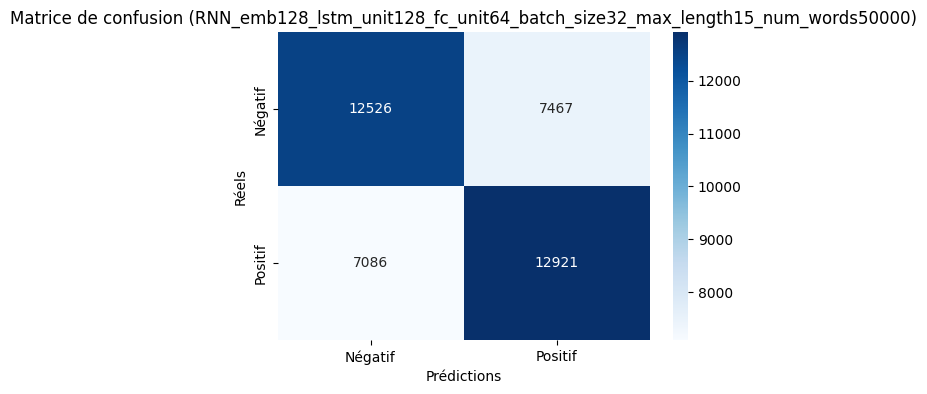

2025/03/07 13:16:03 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 13:16:16 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit64_batch_size32_max_length30_num_words10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 99s 24ms/step - accuracy: 0.5228 - loss: 2.1039 - val_accuracy: 0.5565 - val_loss: 1.0859 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 92s 23ms/step - accuracy: 0.5999 - loss: 0.9533 - val_accuracy: 0.5867 - val_loss: 0.7550 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 93s 23ms/step - accuracy: 0.6431 - loss: 0.6978 - val_accuracy: 0.6448 - val_loss: 0.6494 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 94s 23ms/step - accuracy: 0.6577 - loss: 0.6380 - val_accuracy: 0.6455 - val_loss: 0.6335 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 93s 23ms/step - accuracy: 0.6647 - loss: 0.6204 - val_accuracy: 0.6137 - val_loss: 0.6790 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 92s 23ms/step - accuracy:

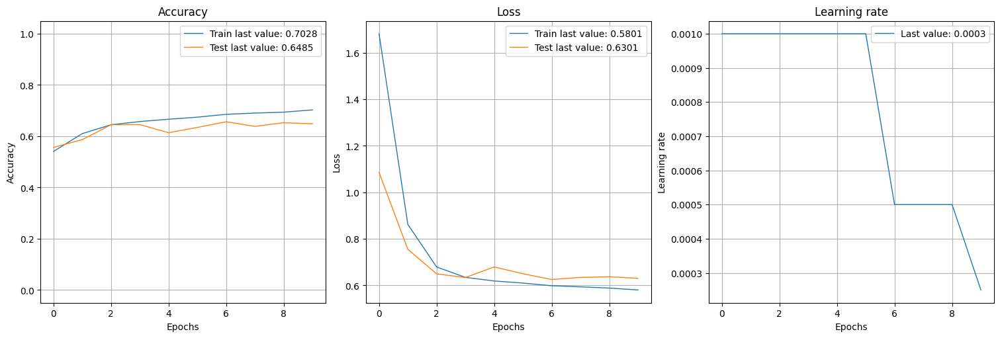

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 12s 9ms/step


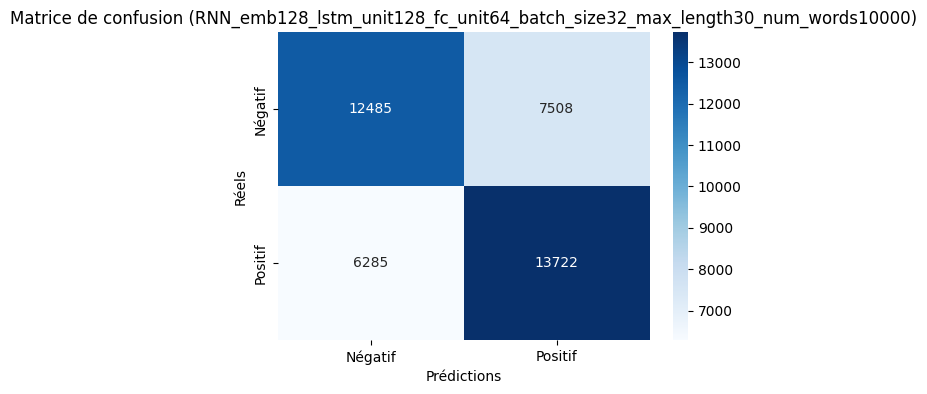

2025/03/07 13:32:07 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 13:32:20 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit64_batch_size32_max_length30_num_words30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 120s 29ms/step - accuracy: 0.5247 - loss: 2.1174 - val_accuracy: 0.5760 - val_loss: 1.0831 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 116s 29ms/step - accuracy: 0.5934 - loss: 0.9595 - val_accuracy: 0.6018 - val_loss: 0.7408 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 116s 29ms/step - accuracy: 0.6370 - loss: 0.7025 - val_accuracy: 0.6394 - val_loss: 0.6531 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 117s 29ms/step - accuracy: 0.6574 - loss: 0.6389 - val_accuracy: 0.6442 - val_loss: 0.6389 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 123s 31ms/step - accuracy: 0.6673 - loss: 0.6188 - val_accuracy: 0.6464 - val_loss: 0.6332 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 117s 29ms/step - acc

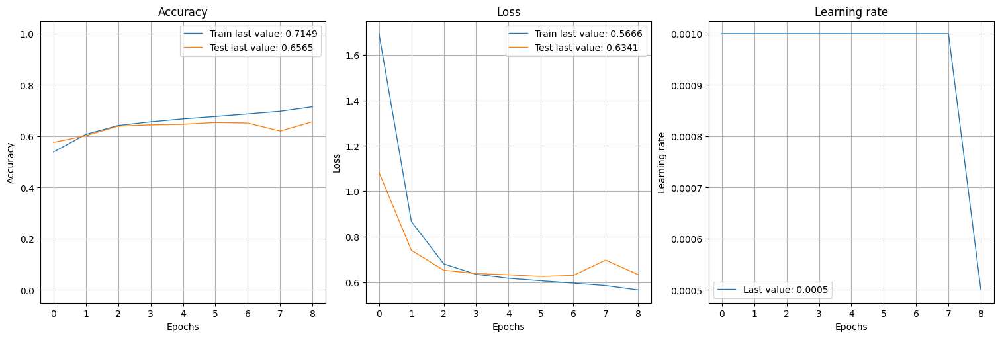

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 11s 9ms/step


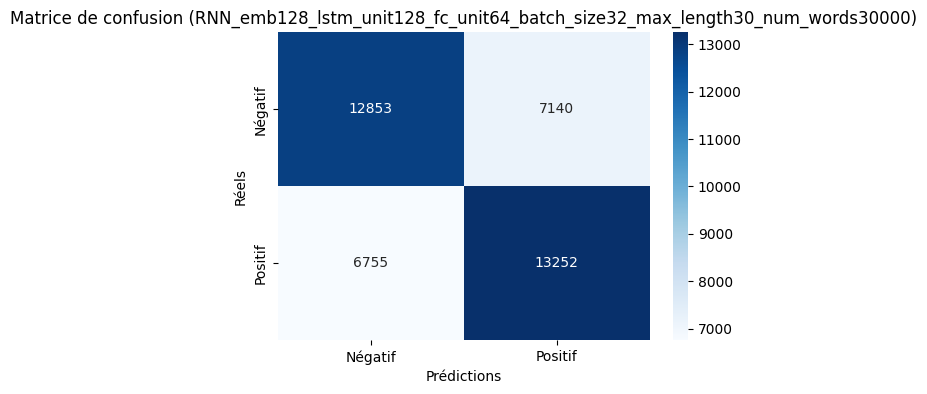

2025/03/07 13:49:50 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 13:50:03 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit64_batch_size32_max_length30_num_words50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 139s 34ms/step - accuracy: 0.5303 - loss: 2.1062 - val_accuracy: 0.6014 - val_loss: 1.0725 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 132s 33ms/step - accuracy: 0.6045 - loss: 0.9514 - val_accuracy: 0.6089 - val_loss: 0.7391 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 132s 33ms/step - accuracy: 0.6430 - loss: 0.6971 - val_accuracy: 0.6356 - val_loss: 0.6543 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 130s 33ms/step - accuracy: 0.6591 - loss: 0.6372 - val_accuracy: 0.6154 - val_loss: 0.6553 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 144s 36ms/step - accuracy: 0.6725 - loss: 0.6157 - val_accuracy: 0.6486 - val_loss: 0.6326 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 134s 34ms/step - acc

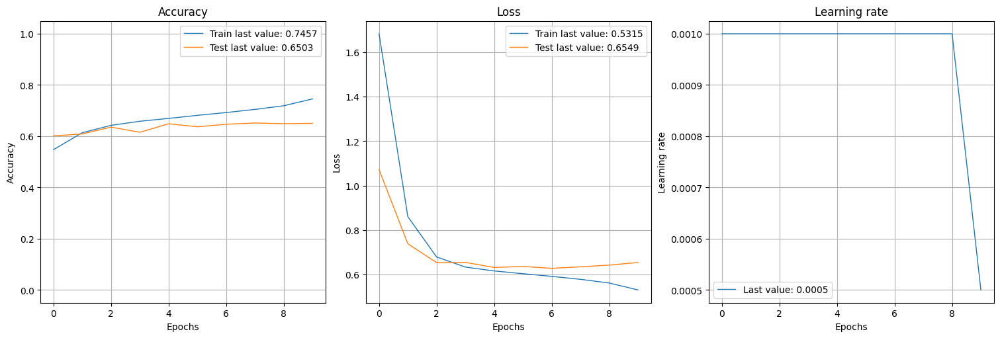

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step


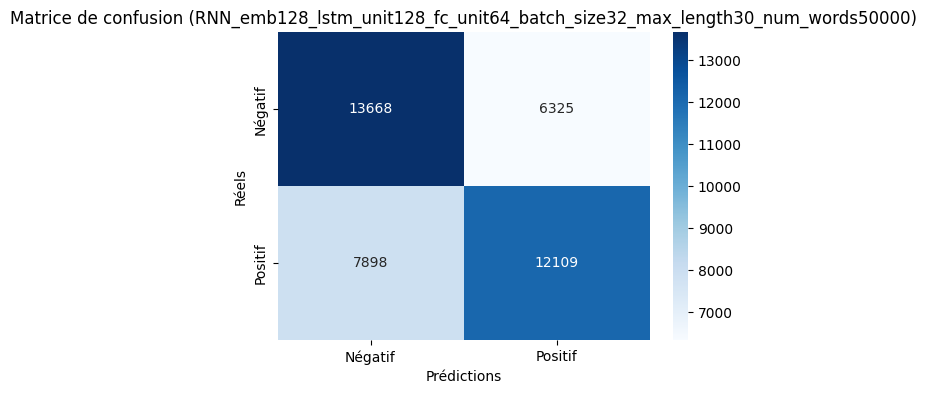

2025/03/07 14:13:06 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 14:13:20 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit64_batch_size64_max_length15_num_words10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 44s 21ms/step - accuracy: 0.5243 - loss: 2.3485 - val_accuracy: 0.5531 - val_loss: 1.5809 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 41s 20ms/step - accuracy: 0.5594 - loss: 1.4279 - val_accuracy: 0.5840 - val_loss: 1.0753 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 41s 21ms/step - accuracy: 0.5976 - loss: 1.0037 - val_accuracy: 0.5781 - val_loss: 0.8487 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 43s 21ms/step - accuracy: 0.6161 - loss: 0.8073 - val_accuracy: 0.5984 - val_loss: 0.7385 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 41s 20ms/step - accuracy: 0.6305 - loss: 0.7164 - val_accuracy: 0.6160 - val_loss: 0.6880 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 41s 21ms/step - accuracy:

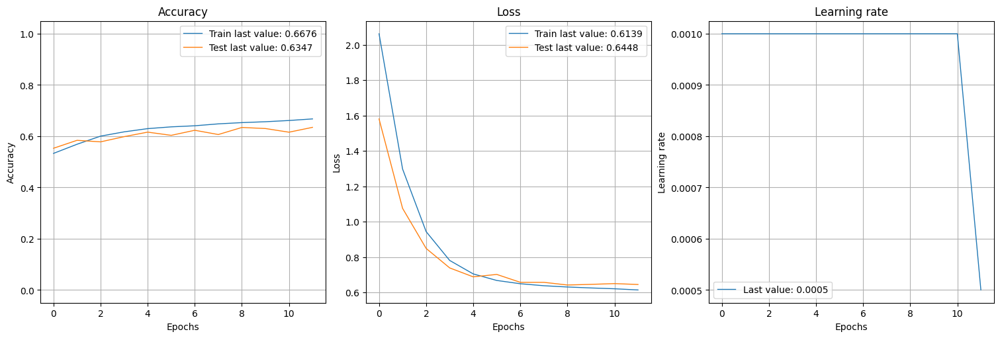

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step


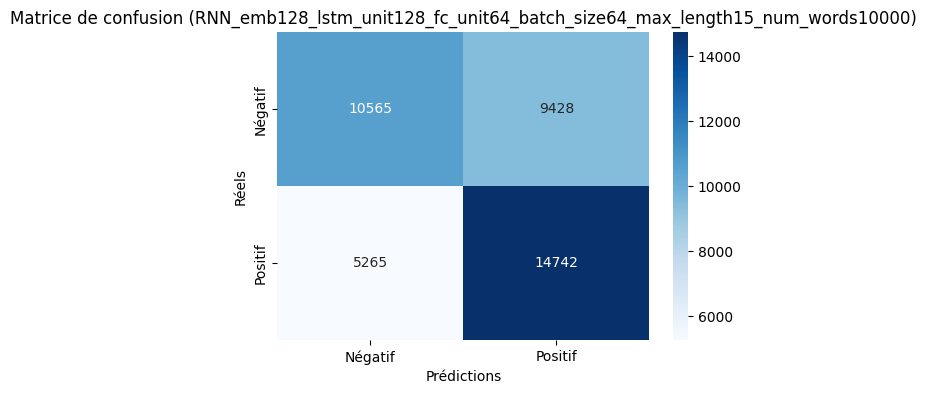

2025/03/07 14:21:51 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 14:22:03 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit64_batch_size64_max_length15_num_words30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 53s 25ms/step - accuracy: 0.5158 - loss: 2.3515 - val_accuracy: 0.5464 - val_loss: 1.5838 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 52s 26ms/step - accuracy: 0.5517 - loss: 1.4313 - val_accuracy: 0.5583 - val_loss: 1.0827 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 50s 25ms/step - accuracy: 0.5879 - loss: 1.0098 - val_accuracy: 0.6025 - val_loss: 0.8448 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 50s 25ms/step - accuracy: 0.6124 - loss: 0.8120 - val_accuracy: 0.6167 - val_loss: 0.7363 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 51s 25ms/step - accuracy: 0.6245 - loss: 0.7191 - val_accuracy: 0.6029 - val_loss: 0.6922 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 51s 25ms/step - accuracy:

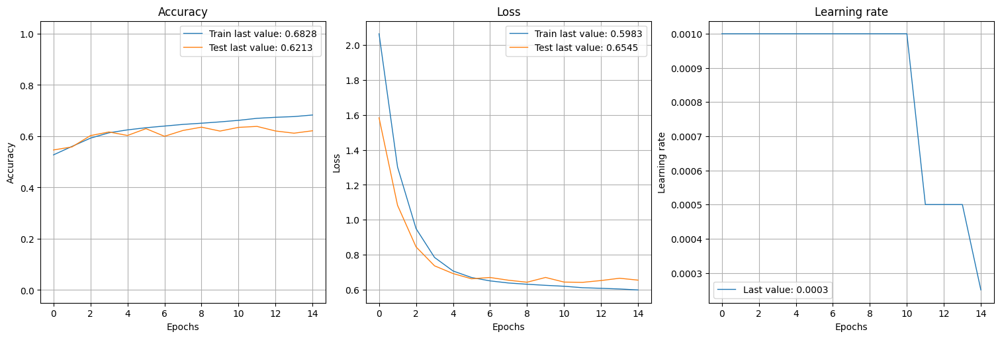

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


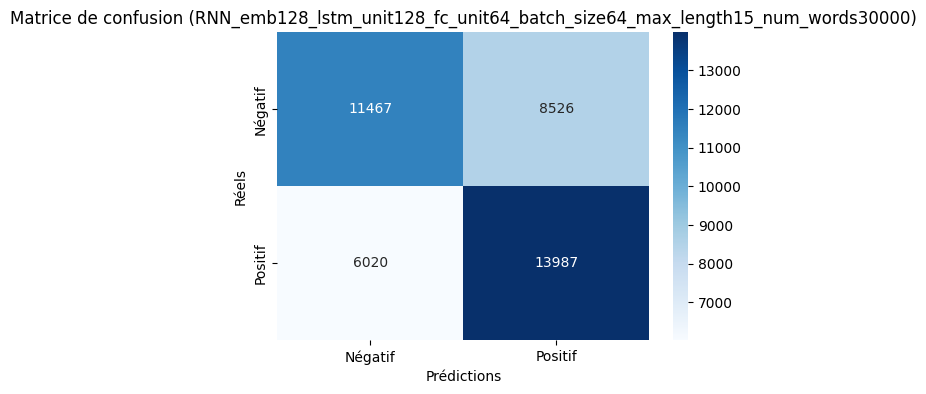

2025/03/07 14:35:02 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 14:35:16 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit64_batch_size64_max_length15_num_words50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 66s 32ms/step - accuracy: 0.5256 - loss: 2.3387 - val_accuracy: 0.5459 - val_loss: 1.5780 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 63s 32ms/step - accuracy: 0.5582 - loss: 1.4250 - val_accuracy: 0.5779 - val_loss: 1.0783 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 63s 32ms/step - accuracy: 0.5930 - loss: 1.0045 - val_accuracy: 0.6022 - val_loss: 0.8433 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 65s 32ms/step - accuracy: 0.6152 - loss: 0.8080 - val_accuracy: 0.6144 - val_loss: 0.7358 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 64s 32ms/step - accuracy: 0.6273 - loss: 0.7168 - val_accuracy: 0.6119 - val_loss: 0.6976 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 64s 32ms/step - accuracy:

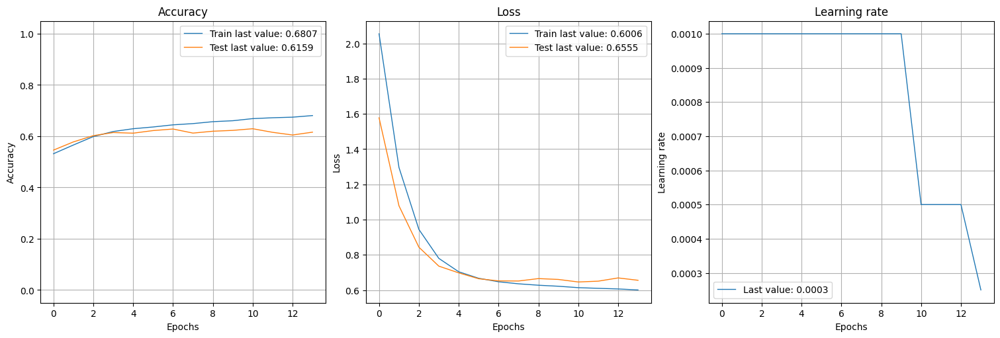

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step


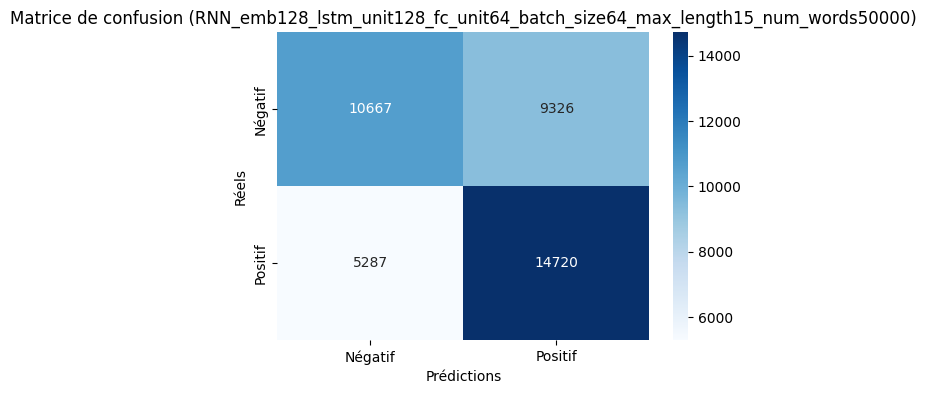

2025/03/07 14:50:44 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 14:50:56 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit64_batch_size64_max_length30_num_words10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 84s 40ms/step - accuracy: 0.5181 - loss: 2.3639 - val_accuracy: 0.5456 - val_loss: 1.5901 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 73s 36ms/step - accuracy: 0.5525 - loss: 1.4357 - val_accuracy: 0.5623 - val_loss: 1.0843 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 81s 40ms/step - accuracy: 0.6011 - loss: 1.0055 - val_accuracy: 0.6172 - val_loss: 0.8363 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 76s 38ms/step - accuracy: 0.6290 - loss: 0.8001 - val_accuracy: 0.6052 - val_loss: 0.7524 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 73s 36ms/step - accuracy: 0.6435 - loss: 0.7070 - val_accuracy: 0.6176 - val_loss: 0.6858 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 75s 37ms/step - accuracy:

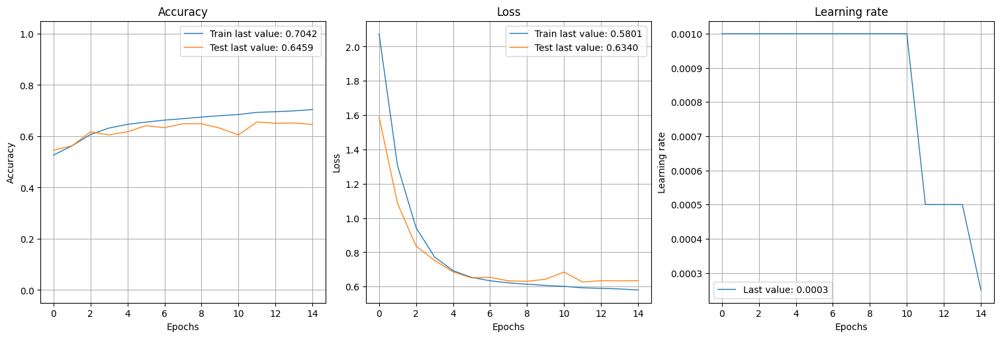

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step


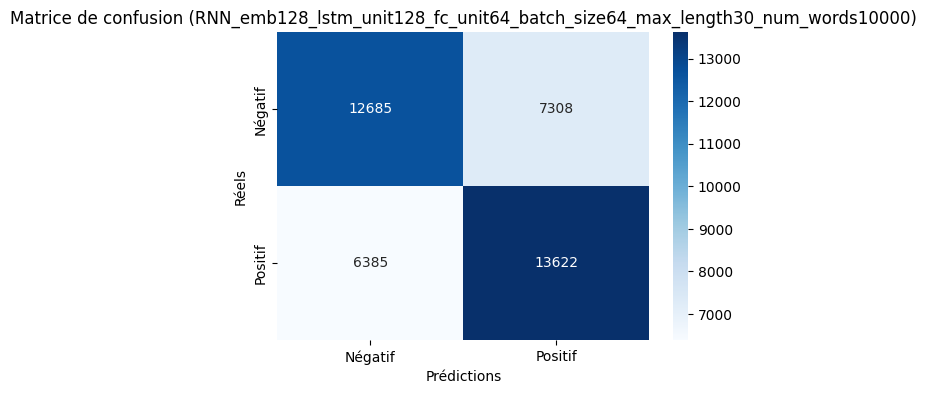

2025/03/07 15:10:53 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 15:11:05 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit64_batch_size64_max_length30_num_words30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 86s 42ms/step - accuracy: 0.5255 - loss: 2.3600 - val_accuracy: 0.5723 - val_loss: 1.5820 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 83s 42ms/step - accuracy: 0.5775 - loss: 1.4274 - val_accuracy: 0.6036 - val_loss: 1.0646 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 85s 43ms/step - accuracy: 0.6209 - loss: 0.9922 - val_accuracy: 0.6237 - val_loss: 0.8298 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 87s 44ms/step - accuracy: 0.6393 - loss: 0.7936 - val_accuracy: 0.6345 - val_loss: 0.7230 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 84s 42ms/step - accuracy: 0.6513 - loss: 0.7003 - val_accuracy: 0.6424 - val_loss: 0.6723 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 88s 44ms/step - accuracy:

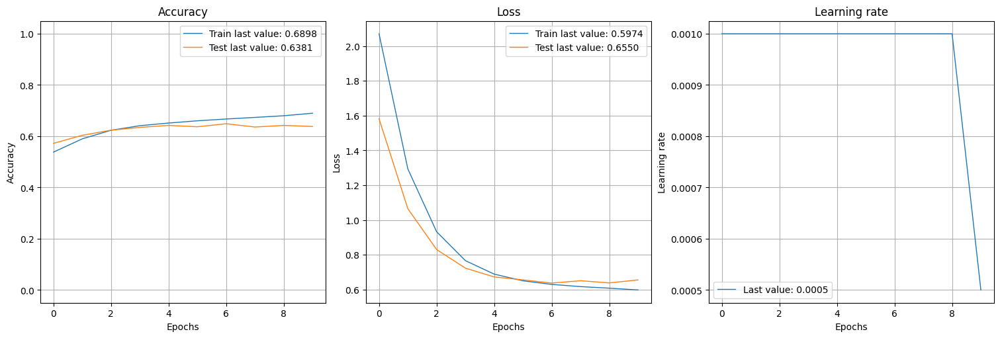

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step


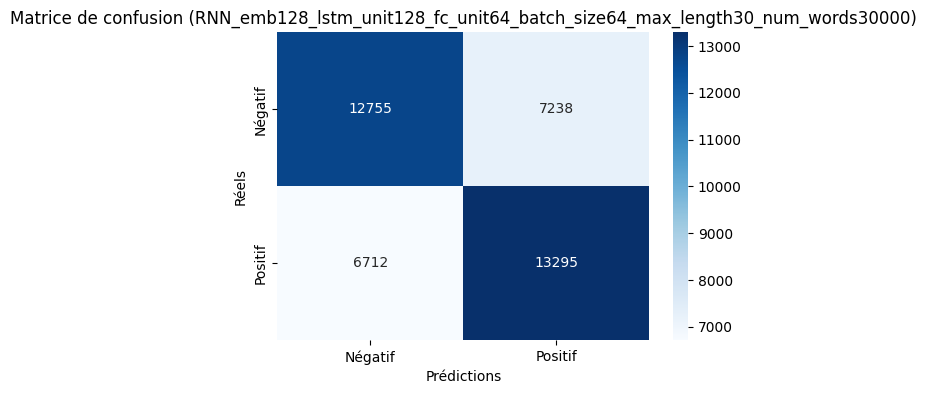

2025/03/07 15:25:29 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 15:25:43 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit64_batch_size64_max_length30_num_words50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 97s 47ms/step - accuracy: 0.5207 - loss: 2.3448 - val_accuracy: 0.5443 - val_loss: 1.5802 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 102s 51ms/step - accuracy: 0.5506 - loss: 1.4285 - val_accuracy: 0.5763 - val_loss: 1.0782 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 103s 52ms/step - accuracy: 0.5928 - loss: 1.0055 - val_accuracy: 0.5993 - val_loss: 0.8456 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 101s 51ms/step - accuracy: 0.6254 - loss: 0.8013 - val_accuracy: 0.5944 - val_loss: 0.7468 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 101s 50ms/step - accuracy: 0.6425 - loss: 0.7065 - val_accuracy: 0.5864 - val_loss: 0.7486 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 95s 47ms/step - accur

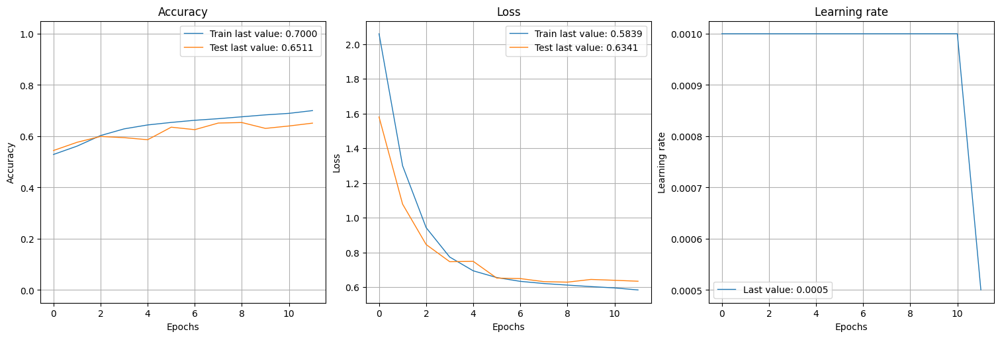

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step


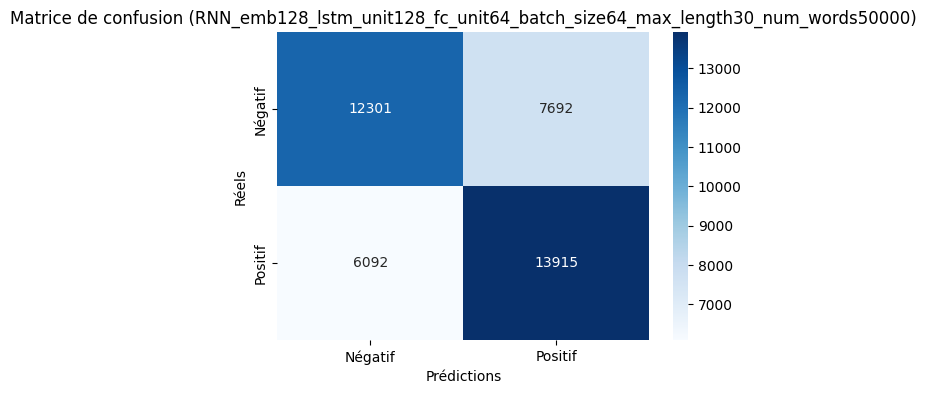

2025/03/07 15:46:07 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 15:46:21 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit128_batch_size32_max_length15_num_words10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 71s 17ms/step - accuracy: 0.5209 - loss: 2.4309 - val_accuracy: 0.5753 - val_loss: 1.1776 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 68s 17ms/step - accuracy: 0.5747 - loss: 1.0309 - val_accuracy: 0.5658 - val_loss: 0.7817 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 75s 19ms/step - accuracy: 0.6142 - loss: 0.7275 - val_accuracy: 0.6217 - val_loss: 0.6678 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.6321 - loss: 0.6598 - val_accuracy: 0.6007 - val_loss: 0.6624 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 68s 17ms/step - accuracy: 0.6428 - loss: 0.6397 - val_accuracy: 0.6144 - val_loss: 0.6471 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 68s 17ms/step - accuracy

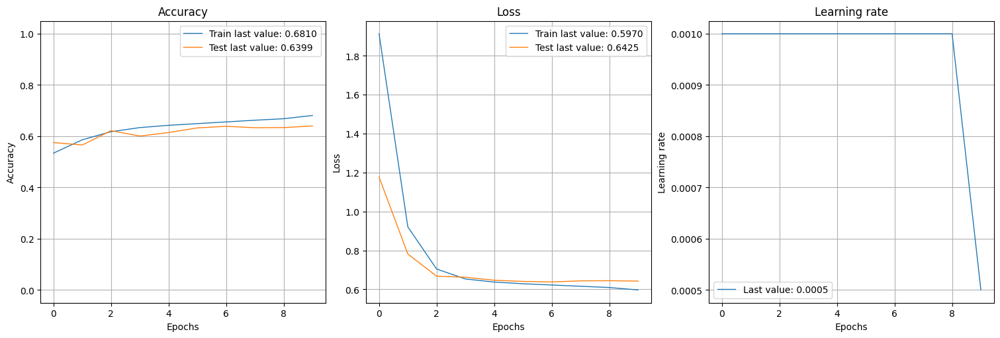

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


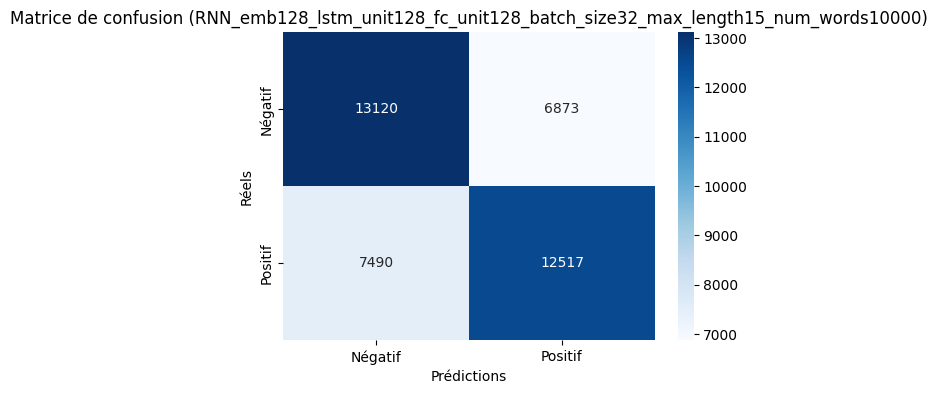

2025/03/07 15:58:14 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 15:58:28 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit128_batch_size32_max_length15_num_words30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 96s 23ms/step - accuracy: 0.5215 - loss: 2.3976 - val_accuracy: 0.5506 - val_loss: 1.1716 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 92s 23ms/step - accuracy: 0.5755 - loss: 1.0244 - val_accuracy: 0.6061 - val_loss: 0.7607 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 93s 23ms/step - accuracy: 0.6138 - loss: 0.7285 - val_accuracy: 0.6231 - val_loss: 0.6694 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 93s 23ms/step - accuracy: 0.6330 - loss: 0.6593 - val_accuracy: 0.6236 - val_loss: 0.6520 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 93s 23ms/step - accuracy: 0.6425 - loss: 0.6388 - val_accuracy: 0.6269 - val_loss: 0.6478 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 95s 24ms/step - accuracy

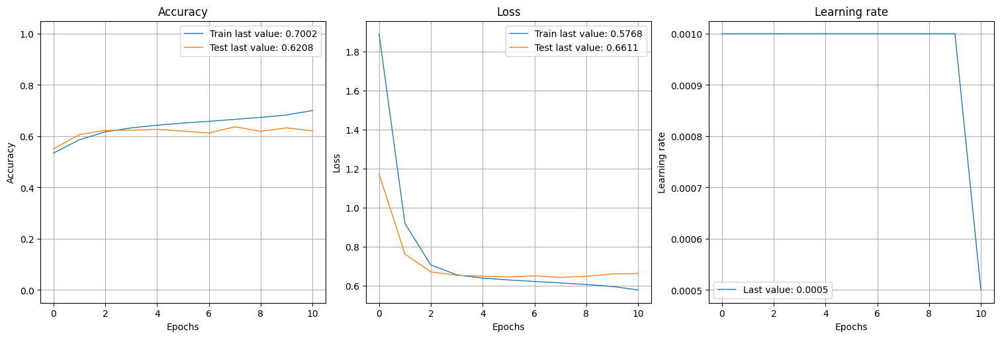

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


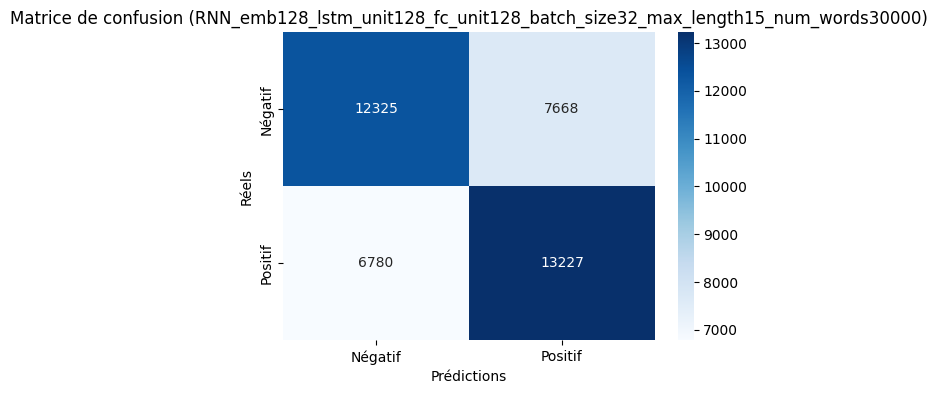

2025/03/07 16:15:39 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 16:15:52 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit128_batch_size32_max_length15_num_words50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 119s 29ms/step - accuracy: 0.5257 - loss: 2.4101 - val_accuracy: 0.5654 - val_loss: 1.1726 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 116s 29ms/step - accuracy: 0.5737 - loss: 1.0270 - val_accuracy: 0.6019 - val_loss: 0.7607 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 116s 29ms/step - accuracy: 0.6162 - loss: 0.7270 - val_accuracy: 0.6163 - val_loss: 0.6724 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 116s 29ms/step - accuracy: 0.6310 - loss: 0.6601 - val_accuracy: 0.6222 - val_loss: 0.6512 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 114s 29ms/step - accuracy: 0.6436 - loss: 0.6378 - val_accuracy: 0.6271 - val_loss: 0.6460 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 117s 29ms/step - ac

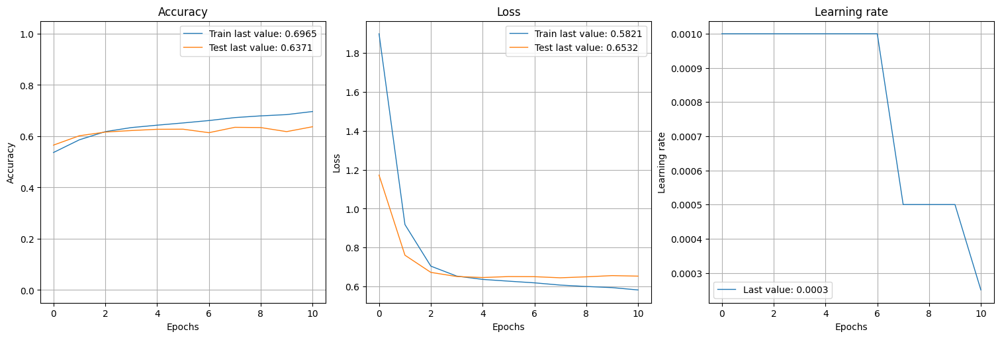

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


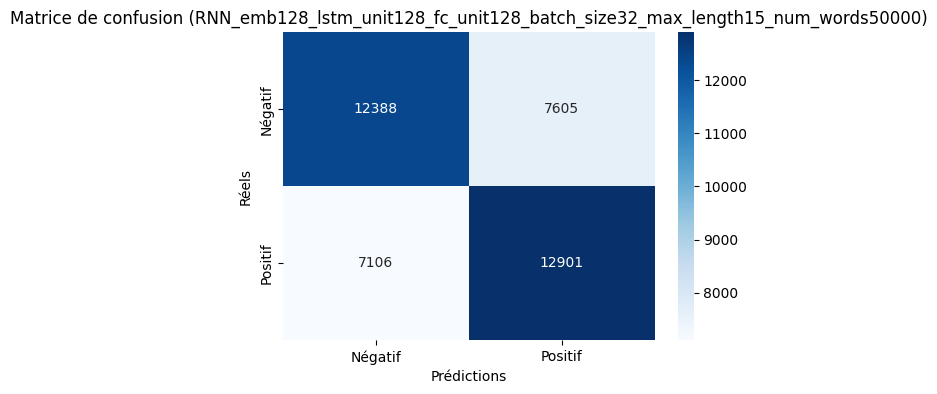

2025/03/07 16:37:29 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 16:37:43 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit128_batch_size32_max_length30_num_words10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 110s 27ms/step - accuracy: 0.5293 - loss: 2.3987 - val_accuracy: 0.5766 - val_loss: 1.1626 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 102s 26ms/step - accuracy: 0.5994 - loss: 1.0125 - val_accuracy: 0.6266 - val_loss: 0.7436 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 104s 26ms/step - accuracy: 0.6385 - loss: 0.7111 - val_accuracy: 0.6243 - val_loss: 0.6629 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 104s 26ms/step - accuracy: 0.6558 - loss: 0.6416 - val_accuracy: 0.6470 - val_loss: 0.6347 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 103s 26ms/step - accuracy: 0.6666 - loss: 0.6198 - val_accuracy: 0.6420 - val_loss: 0.6374 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 105s 26ms/step - ac

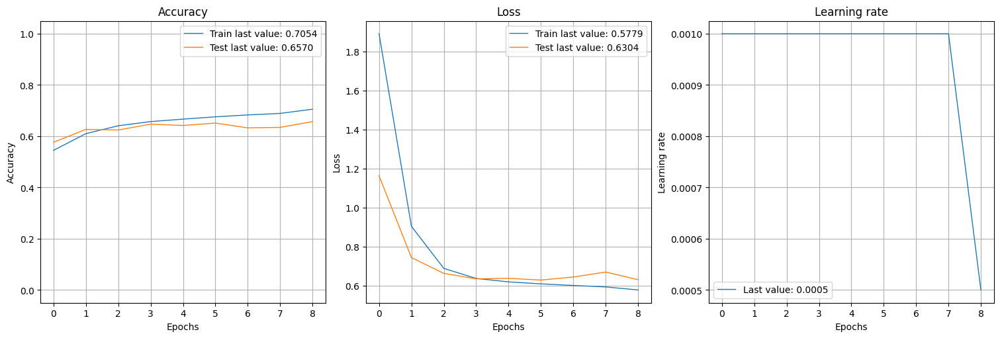

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step


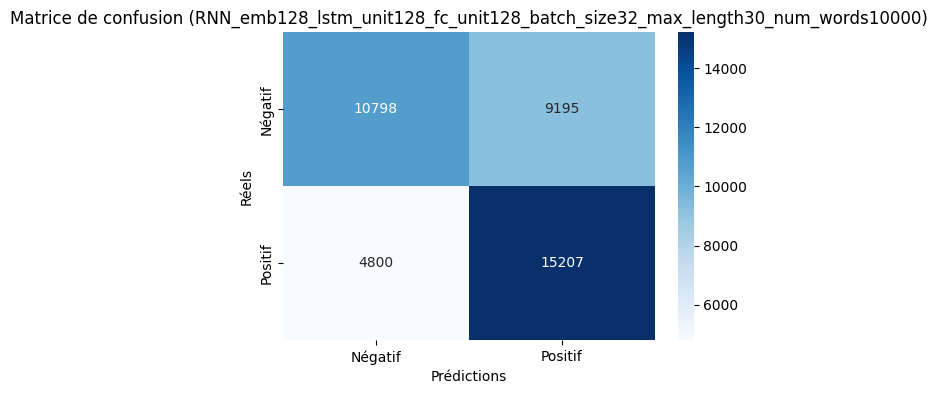

2025/03/07 16:53:56 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 16:54:10 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit128_batch_size32_max_length30_num_words30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 132s 32ms/step - accuracy: 0.5275 - loss: 2.4186 - val_accuracy: 0.5894 - val_loss: 1.1653 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 131s 33ms/step - accuracy: 0.5996 - loss: 1.0160 - val_accuracy: 0.5787 - val_loss: 0.7817 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 131s 33ms/step - accuracy: 0.6415 - loss: 0.7110 - val_accuracy: 0.6286 - val_loss: 0.6643 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 129s 32ms/step - accuracy: 0.6555 - loss: 0.6422 - val_accuracy: 0.6448 - val_loss: 0.6373 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 131s 33ms/step - accuracy: 0.6676 - loss: 0.6194 - val_accuracy: 0.6362 - val_loss: 0.6435 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 130s 32ms/step - ac

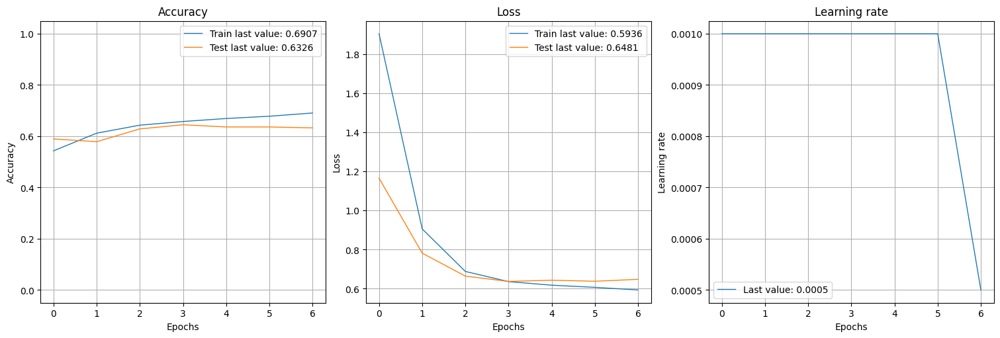

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step


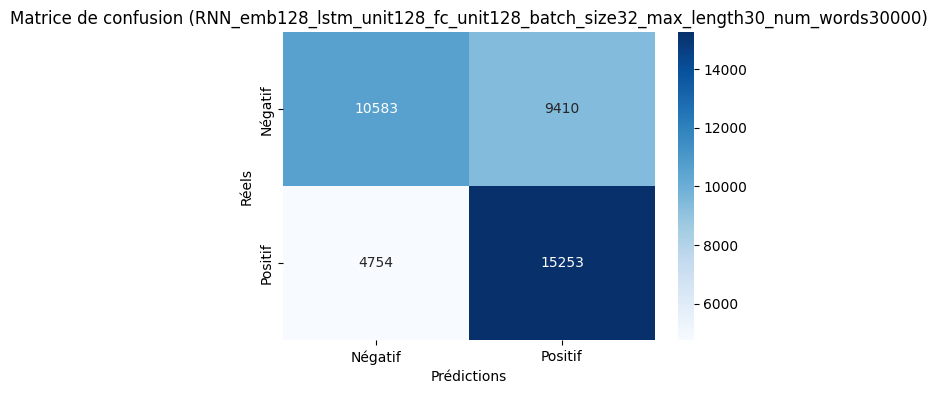

2025/03/07 17:09:41 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 17:09:54 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit128_batch_size32_max_length30_num_words50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 159s 39ms/step - accuracy: 0.5338 - loss: 2.4156 - val_accuracy: 0.5970 - val_loss: 1.1573 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 151s 38ms/step - accuracy: 0.6112 - loss: 1.0083 - val_accuracy: 0.6205 - val_loss: 0.7492 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 154s 38ms/step - accuracy: 0.6416 - loss: 0.7101 - val_accuracy: 0.6397 - val_loss: 0.6573 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 151s 38ms/step - accuracy: 0.6604 - loss: 0.6389 - val_accuracy: 0.6422 - val_loss: 0.6424 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 151s 38ms/step - accuracy: 0.6726 - loss: 0.6154 - val_accuracy: 0.6440 - val_loss: 0.6369 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 152s 38ms/step - ac

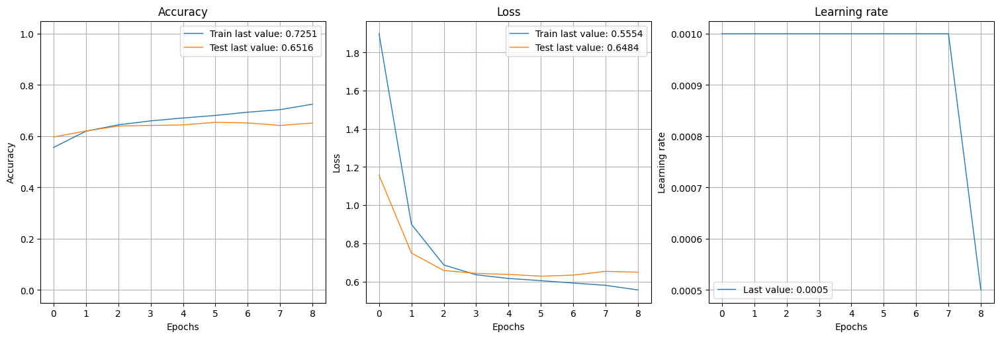

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step


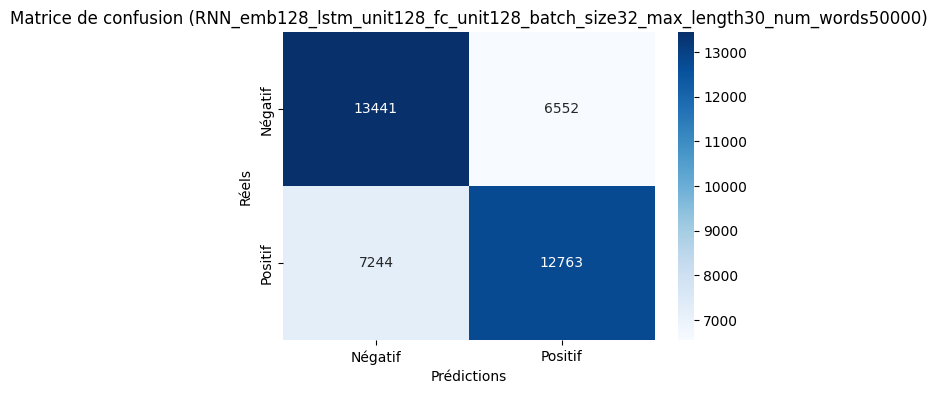

2025/03/07 17:32:58 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 17:33:12 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit128_batch_size64_max_length15_num_words10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 47s 22ms/step - accuracy: 0.5216 - loss: 2.7082 - val_accuracy: 0.5486 - val_loss: 1.7755 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 44s 22ms/step - accuracy: 0.5572 - loss: 1.5900 - val_accuracy: 0.5806 - val_loss: 1.1644 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 44s 22ms/step - accuracy: 0.5891 - loss: 1.0791 - val_accuracy: 0.6099 - val_loss: 0.8793 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 44s 22ms/step - accuracy: 0.6132 - loss: 0.8417 - val_accuracy: 0.6154 - val_loss: 0.7516 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 45s 22ms/step - accuracy: 0.6265 - loss: 0.7317 - val_accuracy: 0.6270 - val_loss: 0.6903 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 43s 22ms/step - accuracy

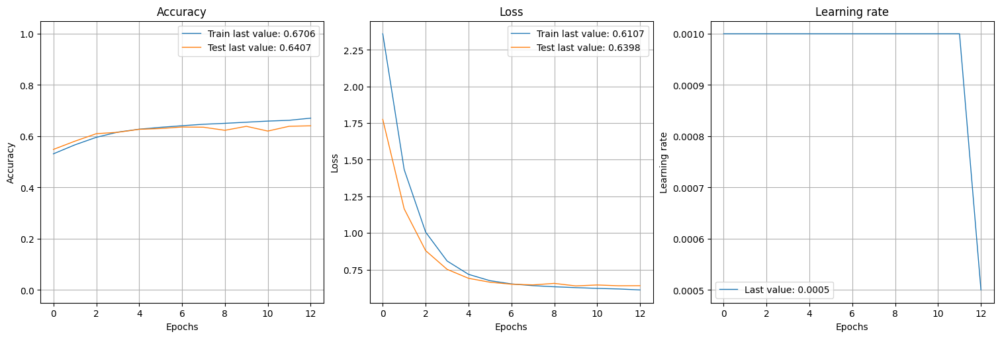

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


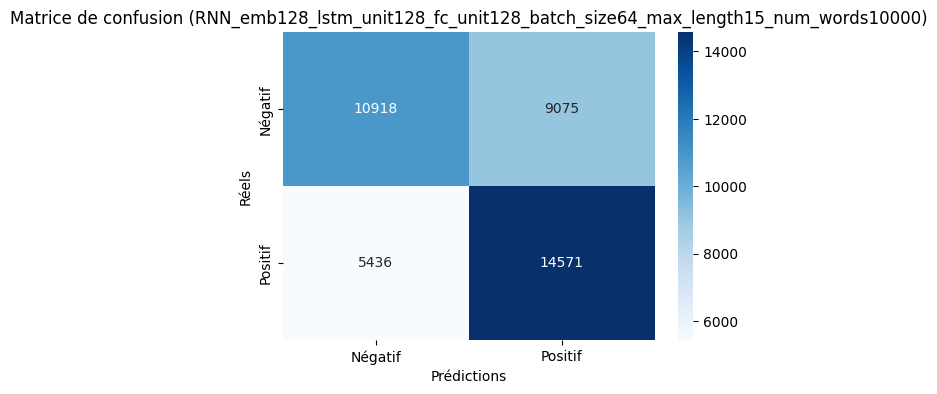

2025/03/07 17:43:02 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 17:43:15 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit128_batch_size64_max_length15_num_words30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 61s 29ms/step - accuracy: 0.5215 - loss: 2.6991 - val_accuracy: 0.5507 - val_loss: 1.7714 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 56s 28ms/step - accuracy: 0.5573 - loss: 1.5863 - val_accuracy: 0.5839 - val_loss: 1.1623 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 56s 28ms/step - accuracy: 0.5926 - loss: 1.0765 - val_accuracy: 0.6016 - val_loss: 0.8811 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 57s 28ms/step - accuracy: 0.6110 - loss: 0.8410 - val_accuracy: 0.6074 - val_loss: 0.7569 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 67s 33ms/step - accuracy: 0.6231 - loss: 0.7322 - val_accuracy: 0.6224 - val_loss: 0.6943 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 62s 31ms/step - accuracy

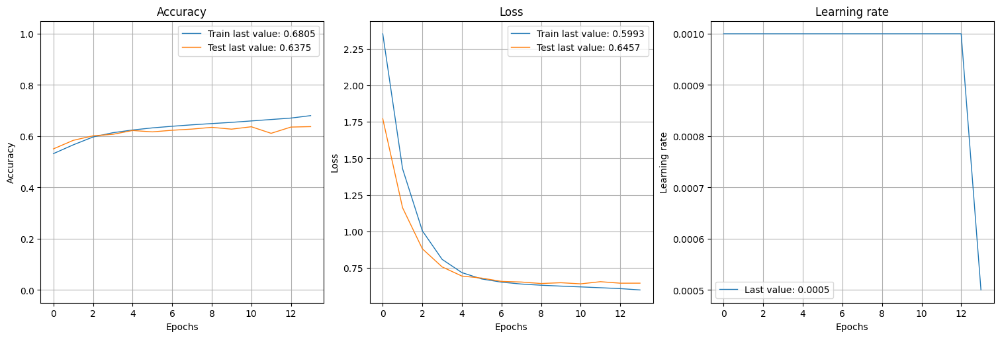

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


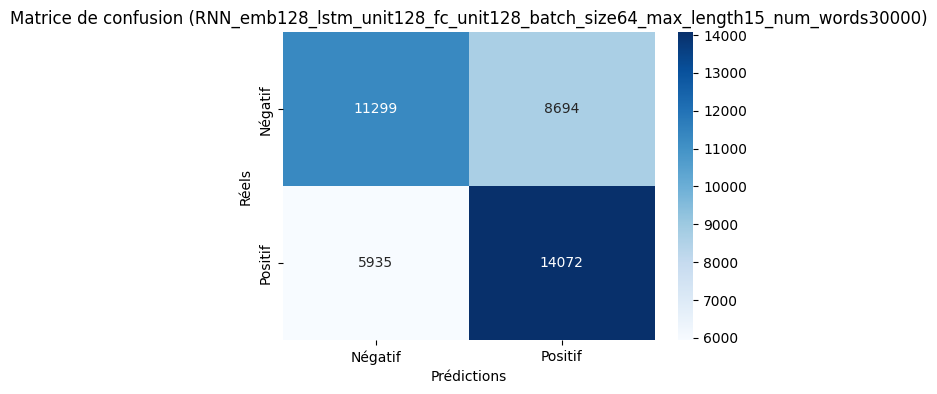

2025/03/07 17:57:09 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 17:57:23 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit128_batch_size64_max_length15_num_words50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 72s 34ms/step - accuracy: 0.5195 - loss: 2.7078 - val_accuracy: 0.5369 - val_loss: 1.7778 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 68s 34ms/step - accuracy: 0.5434 - loss: 1.5929 - val_accuracy: 0.5544 - val_loss: 1.1749 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 67s 34ms/step - accuracy: 0.5681 - loss: 1.0903 - val_accuracy: 0.5877 - val_loss: 0.8940 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 68s 34ms/step - accuracy: 0.5989 - loss: 0.8539 - val_accuracy: 0.5688 - val_loss: 0.7752 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 68s 34ms/step - accuracy: 0.6147 - loss: 0.7417 - val_accuracy: 0.5955 - val_loss: 0.7062 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 68s 34ms/step - accuracy

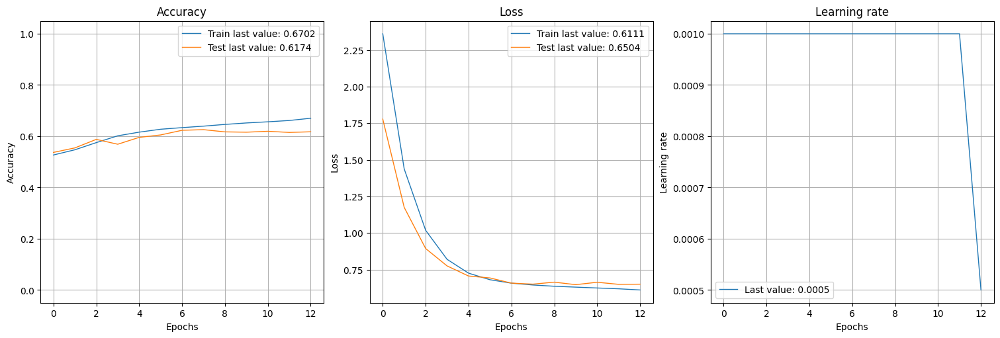

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


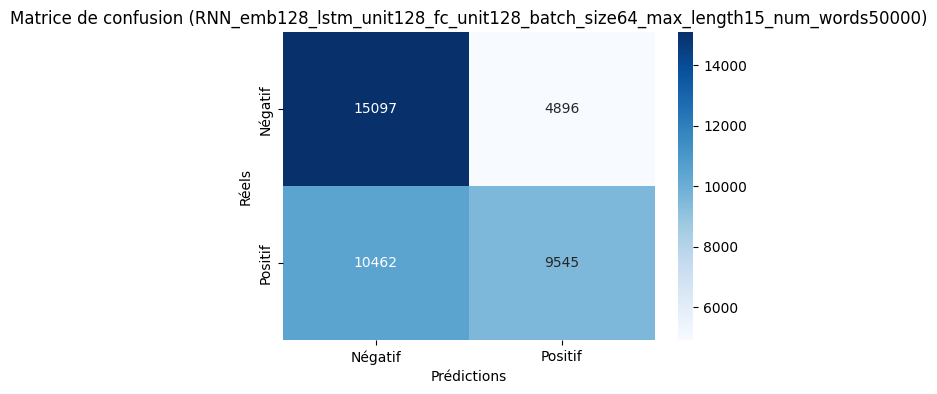

2025/03/07 18:12:28 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 18:12:41 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit128_batch_size64_max_length30_num_words10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 81s 39ms/step - accuracy: 0.5219 - loss: 2.7035 - val_accuracy: 0.5591 - val_loss: 1.7713 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 76s 38ms/step - accuracy: 0.5664 - loss: 1.5855 - val_accuracy: 0.6072 - val_loss: 1.1513 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 78s 39ms/step - accuracy: 0.6094 - loss: 1.0678 - val_accuracy: 0.6307 - val_loss: 0.8645 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 78s 39ms/step - accuracy: 0.6368 - loss: 0.8270 - val_accuracy: 0.6155 - val_loss: 0.7611 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 78s 39ms/step - accuracy: 0.6490 - loss: 0.7162 - val_accuracy: 0.6455 - val_loss: 0.6772 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 77s 38ms/step - accuracy

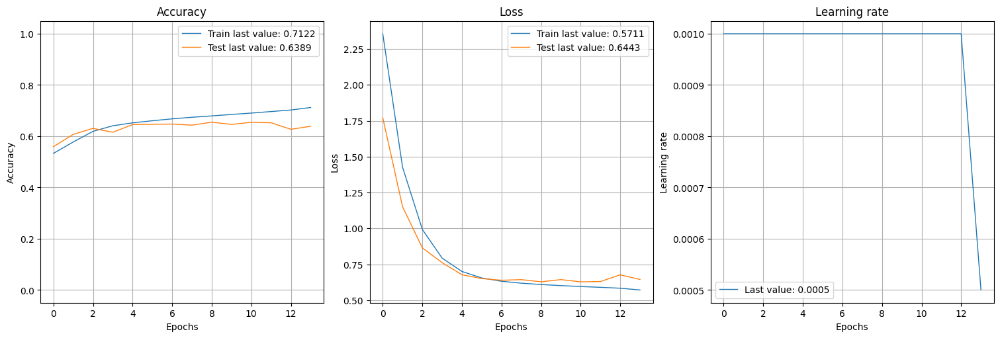

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step


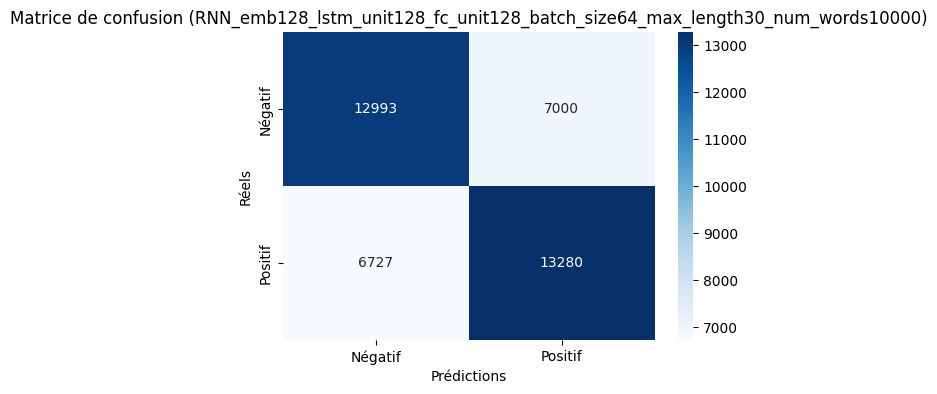

2025/03/07 18:31:10 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 18:31:23 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit128_batch_size64_max_length30_num_words30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 93s 45ms/step - accuracy: 0.5203 - loss: 2.7114 - val_accuracy: 0.5561 - val_loss: 1.7762 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 89s 45ms/step - accuracy: 0.5641 - loss: 1.5899 - val_accuracy: 0.5929 - val_loss: 1.1587 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 89s 44ms/step - accuracy: 0.6049 - loss: 1.0720 - val_accuracy: 0.6221 - val_loss: 0.8722 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 89s 44ms/step - accuracy: 0.6317 - loss: 0.8312 - val_accuracy: 0.6288 - val_loss: 0.7467 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 91s 46ms/step - accuracy: 0.6467 - loss: 0.7182 - val_accuracy: 0.6391 - val_loss: 0.6824 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 88s 44ms/step - accuracy

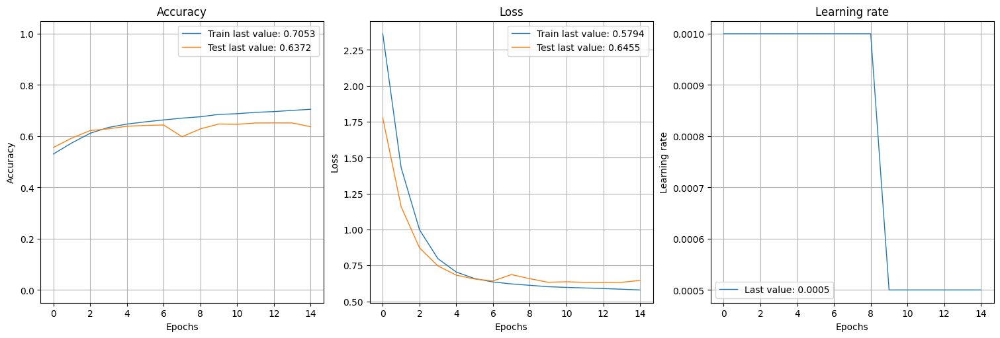

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step


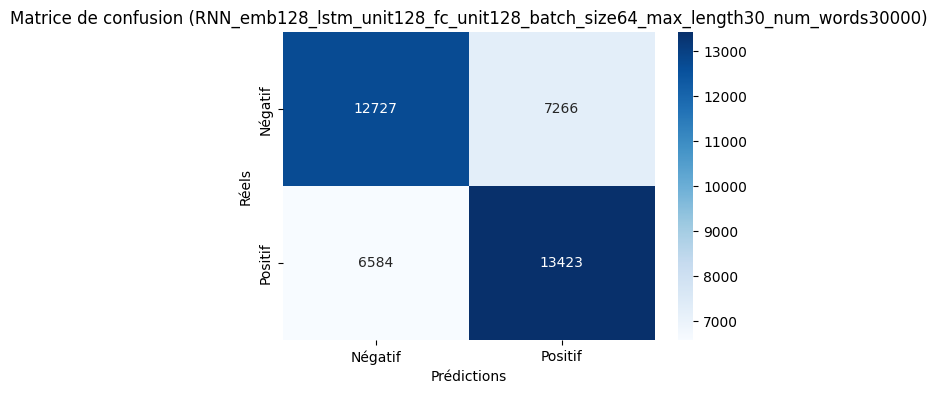

2025/03/07 18:54:18 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 18:54:32 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


-----------------------------------------------------------------------------
RNN_emb128_lstm_unit128_fc_unit128_batch_size64_max_length30_num_words50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 104s 51ms/step - accuracy: 0.5202 - loss: 2.6946 - val_accuracy: 0.5447 - val_loss: 1.7699 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 100s 50ms/step - accuracy: 0.5539 - loss: 1.5845 - val_accuracy: 0.5836 - val_loss: 1.1599 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 102s 51ms/step - accuracy: 0.5983 - loss: 1.0735 - val_accuracy: 0.6050 - val_loss: 0.8786 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 98s 49ms/step - accuracy: 0.6289 - loss: 0.8316 - val_accuracy: 0.5900 - val_loss: 0.7724 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 101s 51ms/step - accuracy: 0.6435 - loss: 0.7200 - val_accuracy: 0.6217 - val_loss: 0.6975 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 100s 50ms/step - acc

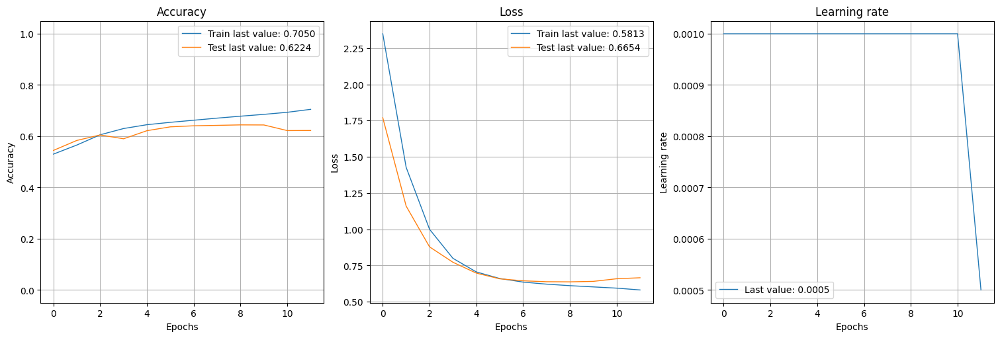

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step


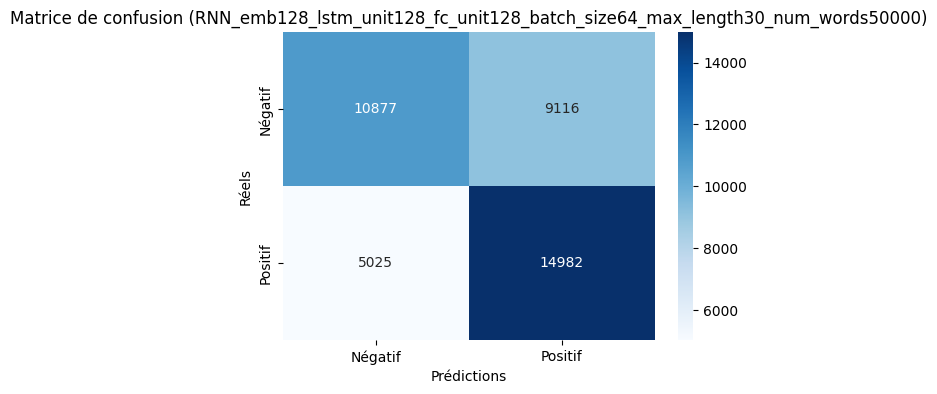

2025/03/07 19:14:55 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 19:15:08 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Tests d'hyperparamètres terminés et métriques enregistrées dans MLflow.


In [ ]:
# Hyperparamètres à tester
embedding_dims = [64, 128]  # Tailles des embeddings
lstm_units = [64, 128]  # Nombre d'unités LSTM
fc_units = [64, 128]   # Nombre d'unités Dense
cnn_filters = 64  # Présence ou absence de CNN
kernel_size = 3  # Taille du noyau CNN
batch_sizes = [32,64]
epochs = 15
dropout_rate =  0.6 # Différents taux de dropout
max_length_list = [15,30]  # Longueur maximale des séquences

# Différentes stratégies de tokenization
num_word_list =  [10000,30000,50000]  # Taille du vocabulaire
best_recall_class_0 = 0

# Enregistrement avec MLflow
for embedding_dim,lstm_unit,fc_unit,batch_size,max_length,num_words in product(
    embedding_dims,lstm_units,fc_units,batch_sizes,max_length_list,num_word_list):

    run_name = f"RNN_emb{embedding_dim}_lstm_unit{lstm_unit}_fc_unit{fc_unit}_batch_size{batch_size}_max_length{max_length}_num_words{num_words}"
    with mlflow.start_run(experiment_id='342420157858240682', run_name=run_name):
        mlflow.log_param("embedding_dim", embedding_dim)
        mlflow.log_param("lstm_units", lstm_unit)
        mlflow.log_param("fc_units", fc_unit)
        mlflow.log_param("cnn_filters", cnn_filters)
        mlflow.log_param("batch_size", batch_size)
        mlflow.log_param("epochs", epochs)
        mlflow.log_param("dropout_rate", dropout_rate)
        mlflow.log_param("num_words", num_words)
        mlflow.log_param("max_length", max_length)

        # Prétraitement des données
        # Réservons deux nombres pour les tokens spéciaux : un pour les mots hors dictionnaire ('UNK') et l'autre pour la sequence ('PAD').
        most_used_words = [token for token, count in sorted_token_count[:num_words-2]]
        # dictionnaire mots vers indices
        word_to_idx = {}
        # dictionnaire  indices vers mots
        idx_to_word = {}

        # Inclusion du premier token d'abord
        PAD_token = 0
        UNK_token = 1

        word_to_idx['PAD'] = PAD_token
        word_to_idx['UNK'] = UNK_token

        idx_to_word[PAD_token] = 'PAD'
        idx_to_word[UNK_token] = 'UNK'

        # Remplissage du dictionnaire avec les mots les plus fréquents
        for num,word in enumerate(most_used_words):
          word_to_idx[word] = num + 2
          idx_to_word[num+2] = word

        X_train_idx = tokens_to_idx(X_train['token_by_tweet_finalised_sans_racinisation'],word_to_idx)
        X_val_idx = tokens_to_idx(X_val['token_by_tweet_finalised_sans_racinisation'],word_to_idx)
        X_test_idx = tokens_to_idx(X_test['token_by_tweet_finalised_sans_racinisation'],word_to_idx)

        X_train_pad = padding(X_train_idx,max_length)
        X_val_pad = padding(X_val_idx,max_length)
        X_test_pad = padding(X_test_idx,max_length)

        # Ajout de bruit dans les données d'entrainement
        X_train_pad_noisy = X_train_pad + np.random.normal(0.0, 0.01,X_train_pad.shape)

        # One hot encoding
        y_train_categorical = to_categorical(X_train['target'], num_classes=2)
        y_val_categorical = to_categorical(X_val['target'], num_classes=2)
        y_test_categorical =to_categorical(X_test['target'], num_classes=2)

        vocab_size = len(word_to_idx) + 1
        mlflow.log_param("max_vocab_size", vocab_size)

        # Définition du modèle
        model = Sequential()
        model.add(Embedding(input_dim=vocab_size, output_dim=embedding_dim, input_length=max_length, trainable=True))

        if cnn_filters:
            model.add(Conv1D(filters=cnn_filters, kernel_size=kernel_size, activation='relu'))
            model.add(MaxPooling1D(pool_size=2))
            model.add(BatchNormalization())

        model.add(LSTM(lstm_unit, return_sequences=False, kernel_regularizer=l2(0.01)))
        model.add(Dropout(dropout_rate))
        model.add(Dense(fc_unit, activation='relu', kernel_regularizer=l2(0.01)))
        model.add(Dense(2, activation='softmax'))

        model.compile(optimizer=SGD(learning_rate=0.001, momentum=0.9), loss='categorical_crossentropy', metrics=['accuracy'])

        lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=1e-6)
        es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
        callbacks_list = [lr, es]

        # On accorde plus de poids aux erreurs sur la classe 0 dans notre mission
        # class_weight = {0: 1.5, 1: 1.0}
        print("-----------------------------------------------------------------------------")
        print(f"{run_name}")

        history = model.fit(
            X_train_pad_noisy, y_train_categorical,
            validation_data=(X_val_pad, y_val_categorical),
            batch_size=batch_size,
            epochs=epochs,
            callbacks=callbacks_list
            # class_weight=class_weight
        )


        # Courbe d'entrainement et de validation
        # plot_training_history(history)
        show_history(history)
        plot_history(history, path=f"D:/tutorial-env/OCR/Projet7/save/{run_name}.png")
        plt.close()


        # Journalisation des métriques dans MLflow
        mlflow.log_metric("final_train_accuracy", history.history['accuracy'][-1])
        mlflow.log_metric("final_val_accuracy", history.history['val_accuracy'][-1])

        # Évaluation
        y_pred_proba = model.predict(X_test_pad)
        y_pred = (y_pred_proba > 0.5).astype(int)
        test_accuracy = accuracy_score(y_test_categorical, y_pred)
        test_recall = recall_score(y_test_categorical, y_pred, average = 'macro')
        test_f1 = f1_score(y_test_categorical, y_pred, average = 'macro')
        test_roc_auc = roc_auc_score(y_test_categorical, y_pred_proba, average = 'macro')
        report = classification_report(y_test_categorical, y_pred, output_dict=True)
        recall_class_0 = report['0']['recall']

        # Visualisation distribution des probas
        # plt.hist(y_pred_proba, bins=50, edgecolor='k')
        # plt.title('Distribution des prédictions')

        mlflow.log_metric("test_accuracy", test_accuracy)
        mlflow.log_metric("test_recall", test_recall.item())
        mlflow.log_metric("test_f1", test_f1.item())
        mlflow.log_metric("test_roc_auc", test_roc_auc.item())
        mlflow.log_metric("recall_class_0", recall_class_0)

        # Matrice de confusion
        y_test_labels = y_test_categorical.argmax(axis=1)
        y_pred_labels = y_pred.argmax(axis=1)
        conf_matrix = confusion_matrix(y_test_labels, y_pred_labels)
        plt.figure(figsize=(6, 4))
        sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=["Négatif", "Positif"],
                    yticklabels=["Négatif", "Positif"])
        plt.xlabel("Prédictions")
        plt.ylabel("Réels")
        plt.title(f"Matrice de confusion ({run_name})")
        plt.show()


        # Enregistrement du modèle
        mlflow.tensorflow.log_model(model, run_name)
        if recall_class_0>best_recall_class_0:
          best_recall_class_0 = recall_class_0
          best_run_name = run_name
          model.save(f"D:/tutorial-env/OCR/Projet7/save/{best_run_name}.h5")
          plt.savefig(f"D:/tutorial-env/OCR/Projet7/save/confusion_matrix_{best_run_name}.png")
          mlflow.log_artifact(f"D:/tutorial-env/OCR/Projet7/save/confusion_matrix_{best_run_name}.png")
        plt.close()

print("Tests d'hyperparamètres terminés et métriques enregistrées dans MLflow.")

In [ ]:
process = subprocess.Popen(["mlflow", "ui", "--backend-store-uri", "file:/D:/tutorial-env/OCR/Projet7/mlruns", "--port", "5006"],stdout = subprocess.PIPE, stderr = subprocess.PIPE)
time.sleep(1)
webbrowser.open("http://localhost:5006")
print(f"MLFlow lancé")

MLFlow lancé


Pour anticiper les bad buzz, nous privilégierons un fort recall pour la classe négative 0. Cela permet de diminuer la mauvaise classification des tweets négatifs sans pour autant tout classifier en négatif.

Dans ce cas du RNN from scratch, les meilleurs résultats sont avec les hyperparamètres suivants :
- Taille des embeddings : 128
- Nombre d'unités LSTM : 128
- Nombre d'unités Dense : 128
- Batch size : 64
- Taux de dropout : 0.6
- Longueur max des séquences : 15
- Taille de vocabulaire :  50000

Résultats :
- un recall de 75% pour la classe négative,
- un f1 score de 61%,
- et une aire sous la courbe ROC de 0.69 (bonne capacité à distinguer les deux classes),
- la matrice de confusion montre un minimum de 4896 tweets négatifs manqués.

Voici la matrice de confusion :

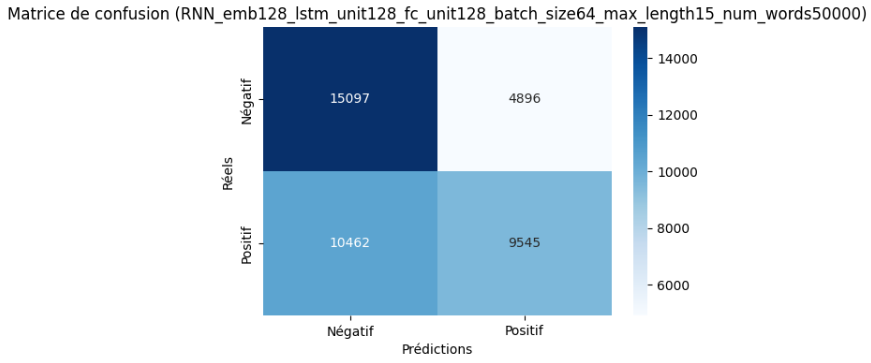

Pour optimiser les résultats et limiter le léger overfitting, il faudrait prendre plus de données mais cela augmenterait drastiquement le temps d'entrainement.

# GloVe

Les embeddings GloVe (Global Vectors for Word Representation) sont des vecteurs de mots pré-entrainés qui capturent les relations sémantiques entre les mots.

Nous initialiserons donc notre couche d'embedding avec ces vecteurs et les garderons fixes.

## Embeddings :

In [ ]:
# Importation des embedding GloVe pour les tweets
url = "http://nlp.stanford.edu/data/glove.twitter.27B.zip"
output_zip_path = "D:\\tutorial-env\\OCR\\Projet7\\glove.twitter.27B.zip"
response = requests.get(url,stream = True)
with open(output_zip_path, "wb") as f:
    f.write(response.content)
print("téléchargement terminé")

téléchargement terminé


In [ ]:
# Extraction du fichier zip
with zipfile.ZipFile(output_zip_path, 'r') as zip_ref:
    zip_ref.extractall("D:\\tutorial-env\\OCR\\Projet7")
print("extraction terminé")

os.remove(output_zip_path)
print("fichier zip supprimé")

extraction terminé
fichier zip supprimé


In [ ]:
def load_glove_embeddings(glove_file_path, word_index, embedding_dim):
    """
    Charge les embeddings GloVe et crée une matrice d'embeddings utilisable dans Keras.

    Params:
    - glove_file_path (str) : chemin vers le fichier GloVe (.txt)
    - word_index (dict) : dictionnaire {mot: index} du tokenizer Keras
    - embedding_dim (int) : dimension des embeddings GloVe utilisés

    Return:
    - embedding_matrix (numpy array) : matrice d'embeddings prête à l'emploi
    """
    embeddings_index = {}
    with open(glove_file_path, encoding="utf-8") as f:
        for line in f:
            values = line.split()
            word = values[0]
            coefs = np.asarray(values[1:], dtype='float32')
            embeddings_index[word] = coefs

    f = sum(1 for word in word_index if word in embeddings_index)
    print(f"Couverture  du vocabulaire : {f}/{len(word_index)}")

    vocab_size = len(word_index) + 1  # +1 pour le token "OOV"
    embedding_matrix = np.zeros((vocab_size, embedding_dim))

    for word, i in word_index.items():
        embedding_vector = embeddings_index.get(word)
        if embedding_vector is not None:
            embedding_matrix[i] = embedding_vector  # Mot trouvé → utiliser GloVe

    return embedding_matrix, vocab_size

## Modèle de RNN :

Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit32_batch_size32_max_length15_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 60s 14ms/step - accuracy: 0.5785 - loss: 1.5080 - val_accuracy: 0.6655 - val_loss: 0.8497 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 49s 12ms/step - accuracy: 0.6663 - loss: 0.7810 - val_accuracy: 0.6758 - val_loss: 0.6473 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 49s 12ms/step - accuracy: 0.6765 - loss: 0.6342 - val_accuracy: 0.6795 - val_loss: 0.6039 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 51s 13ms/step - accuracy: 0.6838 - loss: 0.5998 - val_accuracy: 0.6803 - val_loss: 0.5939 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 48s 12ms/step - accuracy: 0.6836 - loss: 0.5931 - val_accuracy: 0.6833 - val_loss: 0.5895 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

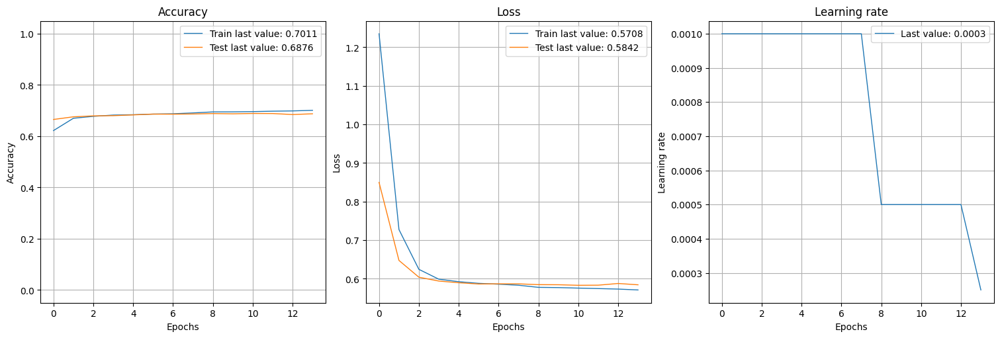

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


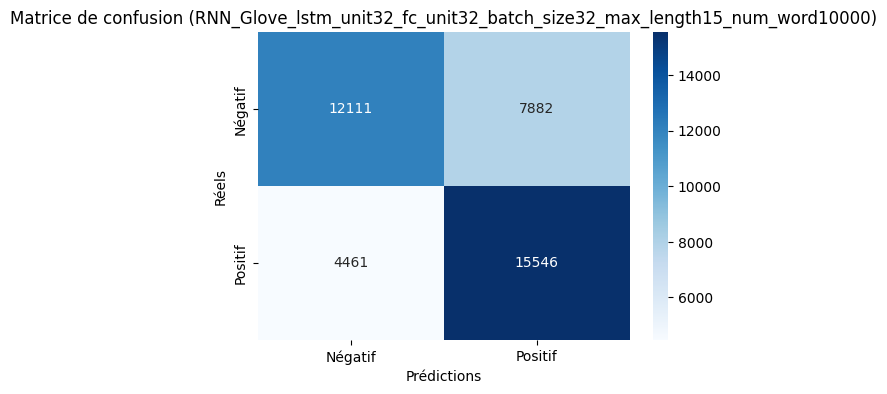

2025/03/07 21:55:41 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 21:56:01 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit32_batch_size32_max_length15_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 50s 12ms/step - accuracy: 0.5746 - loss: 1.5199 - val_accuracy: 0.6684 - val_loss: 0.8494 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6643 - loss: 0.7825 - val_accuracy: 0.6786 - val_loss: 0.6462 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6780 - loss: 0.6347 - val_accuracy: 0.6813 - val_loss: 0.6039 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6833 - loss: 0.6003 - val_accuracy: 0.6698 - val_loss: 0.5933 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6824 - loss: 0.5929 - val_accuracy: 0.6844 - val_loss: 0.5880 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

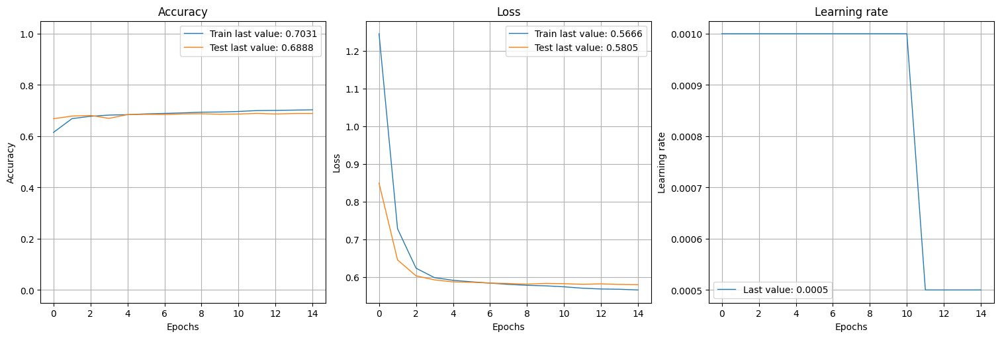

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step


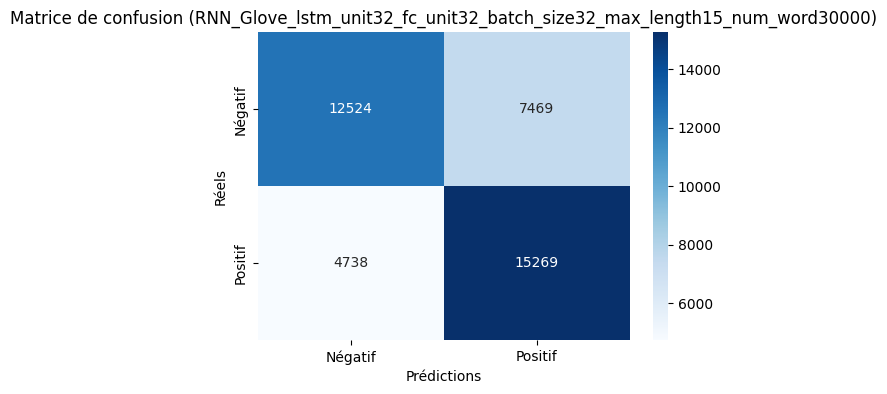

2025/03/07 22:08:48 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 22:09:02 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit32_batch_size32_max_length15_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 51s 12ms/step - accuracy: 0.5757 - loss: 1.5074 - val_accuracy: 0.6549 - val_loss: 0.8471 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 48s 12ms/step - accuracy: 0.6645 - loss: 0.7809 - val_accuracy: 0.6795 - val_loss: 0.6453 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 48s 12ms/step - accuracy: 0.6755 - loss: 0.6349 - val_accuracy: 0.6816 - val_loss: 0.6036 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 48s 12ms/step - accuracy: 0.6813 - loss: 0.6019 - val_accuracy: 0.6848 - val_loss: 0.5929 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 48s 12ms/step - accuracy: 0.6861 - loss: 0.5919 - val_accuracy: 0.6856 - val_loss: 0.5880 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

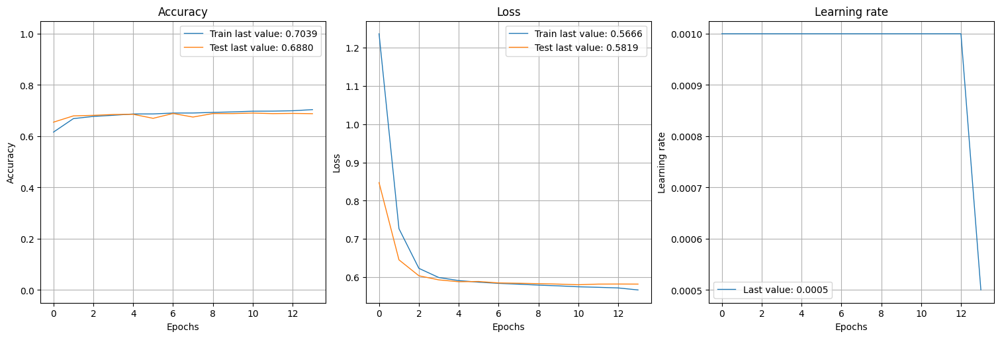

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step


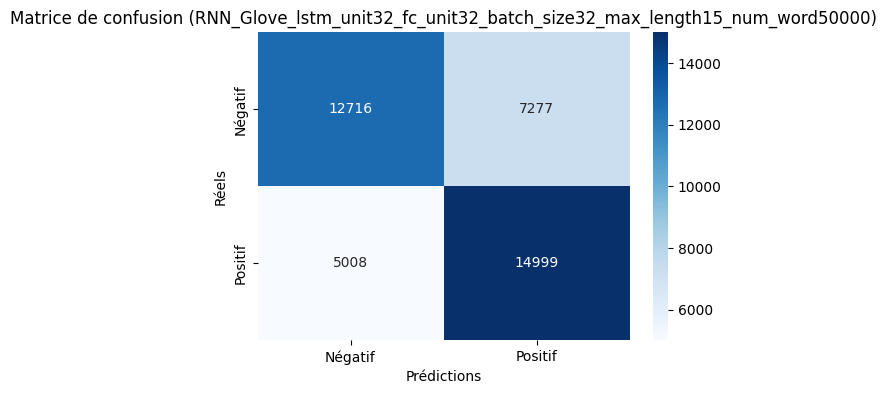

2025/03/07 22:21:12 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 22:21:25 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit32_batch_size32_max_length30_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 73s 18ms/step - accuracy: 0.6094 - loss: 1.4763 - val_accuracy: 0.6925 - val_loss: 0.8209 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 71s 18ms/step - accuracy: 0.6911 - loss: 0.7554 - val_accuracy: 0.6957 - val_loss: 0.6306 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 69s 17ms/step - accuracy: 0.7012 - loss: 0.6139 - val_accuracy: 0.7038 - val_loss: 0.5826 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 69s 17ms/step - accuracy: 0.7038 - loss: 0.5808 - val_accuracy: 0.7050 - val_loss: 0.5720 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 70s 17ms/step - accuracy: 0.7088 - loss: 0.5711 - val_accuracy: 0.7060 - val_loss: 0.5678 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

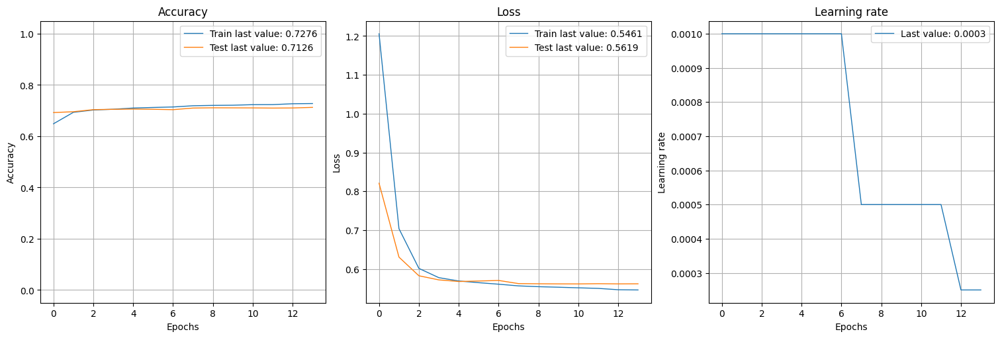

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


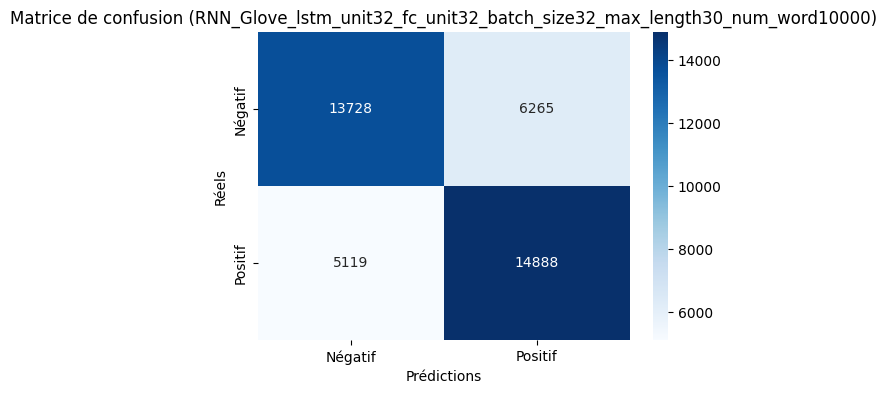

2025/03/07 22:38:43 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 22:38:56 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit32_batch_size32_max_length30_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 71s 17ms/step - accuracy: 0.5955 - loss: 1.4988 - val_accuracy: 0.6952 - val_loss: 0.8227 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.6906 - loss: 0.7586 - val_accuracy: 0.7032 - val_loss: 0.6252 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 68s 17ms/step - accuracy: 0.6992 - loss: 0.6142 - val_accuracy: 0.7077 - val_loss: 0.5801 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.7083 - loss: 0.5779 - val_accuracy: 0.7078 - val_loss: 0.5692 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.7100 - loss: 0.5683 - val_accuracy: 0.7086 - val_loss: 0.5643 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

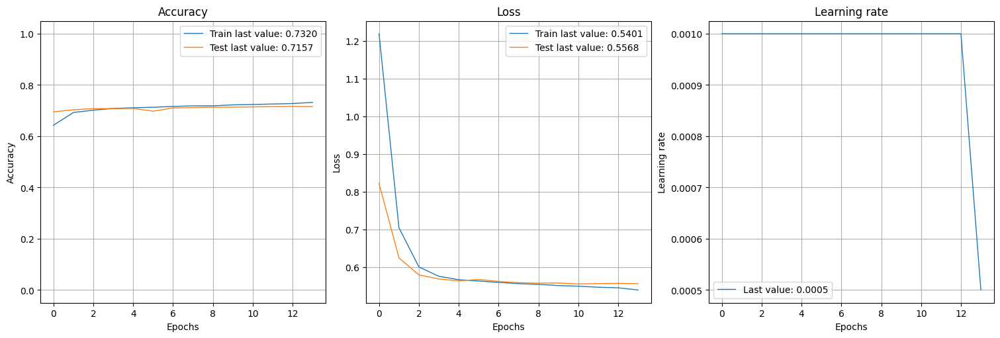

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


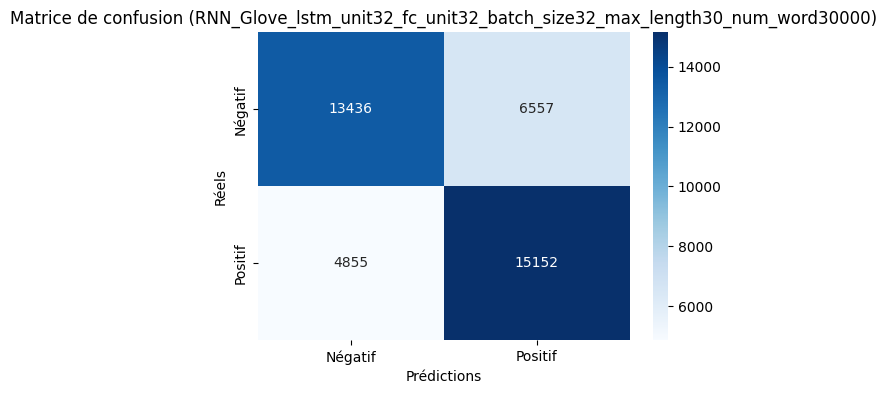

2025/03/07 22:55:48 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 22:56:02 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit32_batch_size32_max_length30_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 74s 18ms/step - accuracy: 0.5760 - loss: 1.5075 - val_accuracy: 0.6869 - val_loss: 0.8299 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 69s 17ms/step - accuracy: 0.6887 - loss: 0.7622 - val_accuracy: 0.7007 - val_loss: 0.6256 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 70s 17ms/step - accuracy: 0.7011 - loss: 0.6153 - val_accuracy: 0.7023 - val_loss: 0.5849 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 69s 17ms/step - accuracy: 0.7074 - loss: 0.5804 - val_accuracy: 0.7060 - val_loss: 0.5727 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 69s 17ms/step - accuracy: 0.7123 - loss: 0.5669 - val_accuracy: 0.7066 - val_loss: 0.5690 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

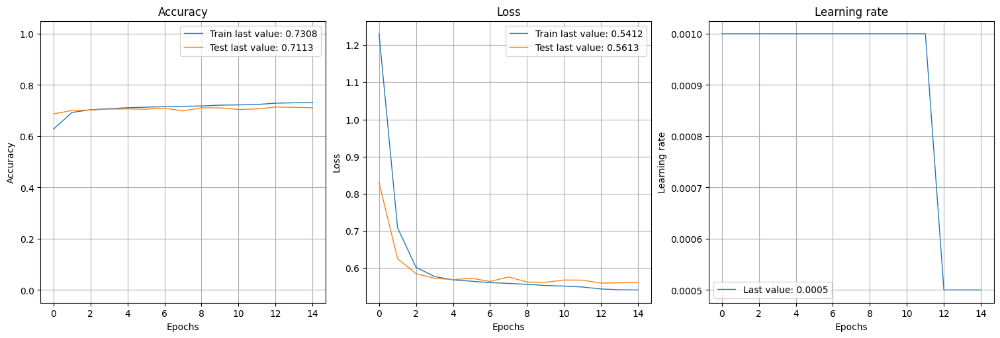

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


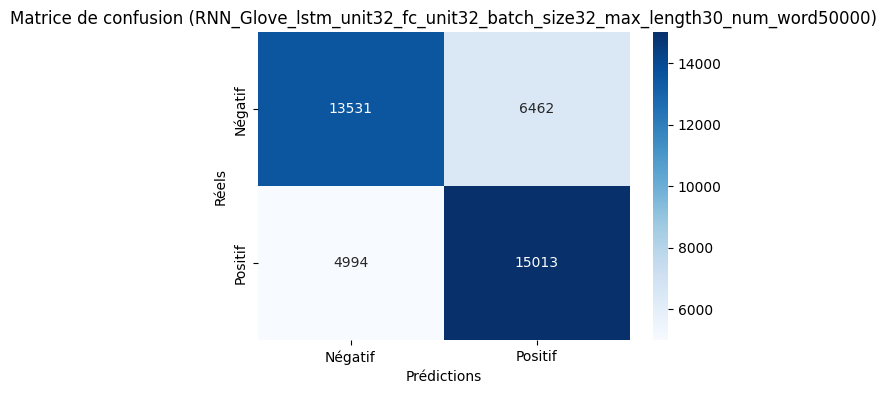

2025/03/07 23:14:30 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 23:14:44 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit64_batch_size32_max_length15_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 49s 12ms/step - accuracy: 0.5753 - loss: 1.5666 - val_accuracy: 0.6678 - val_loss: 0.8619 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 46s 12ms/step - accuracy: 0.6615 - loss: 0.7934 - val_accuracy: 0.6754 - val_loss: 0.6517 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6740 - loss: 0.6391 - val_accuracy: 0.6818 - val_loss: 0.6035 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 46s 12ms/step - accuracy: 0.6809 - loss: 0.6015 - val_accuracy: 0.6821 - val_loss: 0.5942 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 46s 11ms/step - accuracy: 0.6858 - loss: 0.5922 - val_accuracy: 0.6863 - val_loss: 0.5878 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

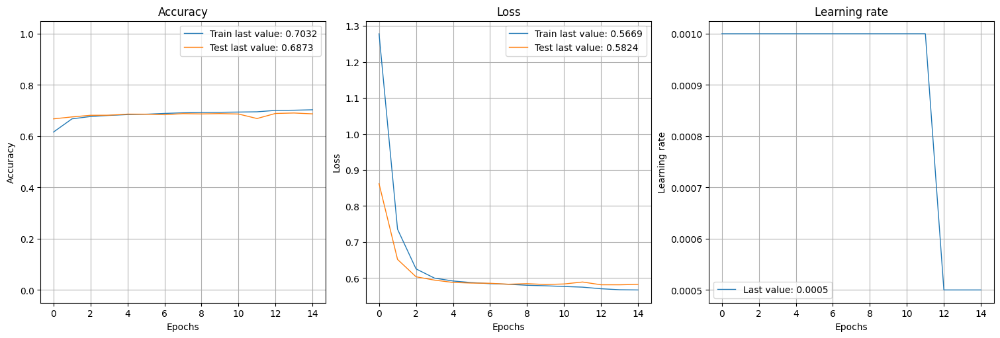

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step


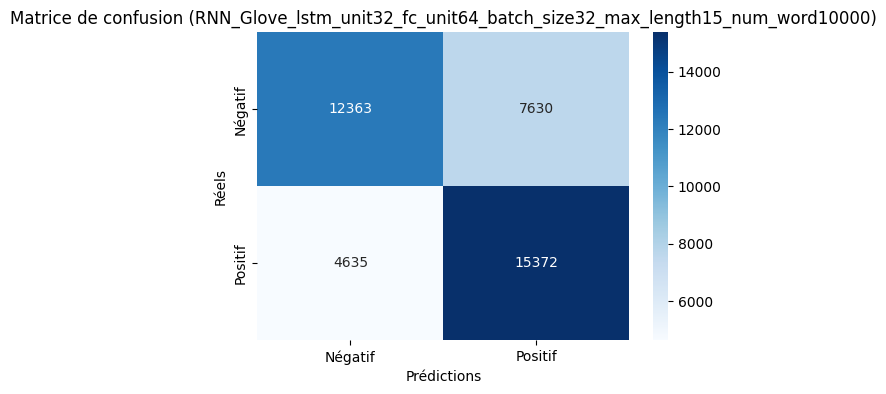

2025/03/07 23:27:22 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 23:27:35 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit64_batch_size32_max_length15_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 51s 12ms/step - accuracy: 0.5749 - loss: 1.5724 - val_accuracy: 0.6649 - val_loss: 0.8672 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6648 - loss: 0.7964 - val_accuracy: 0.6753 - val_loss: 0.6546 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6773 - loss: 0.6366 - val_accuracy: 0.6765 - val_loss: 0.6066 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6800 - loss: 0.6048 - val_accuracy: 0.6827 - val_loss: 0.5929 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6827 - loss: 0.5928 - val_accuracy: 0.6841 - val_loss: 0.5891 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

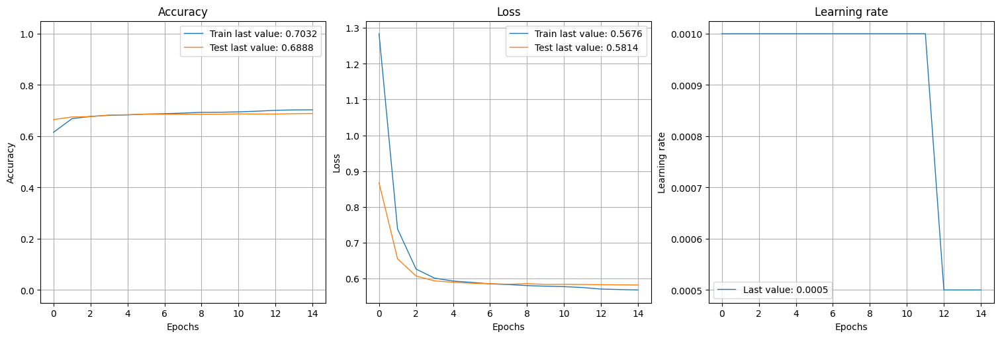

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step


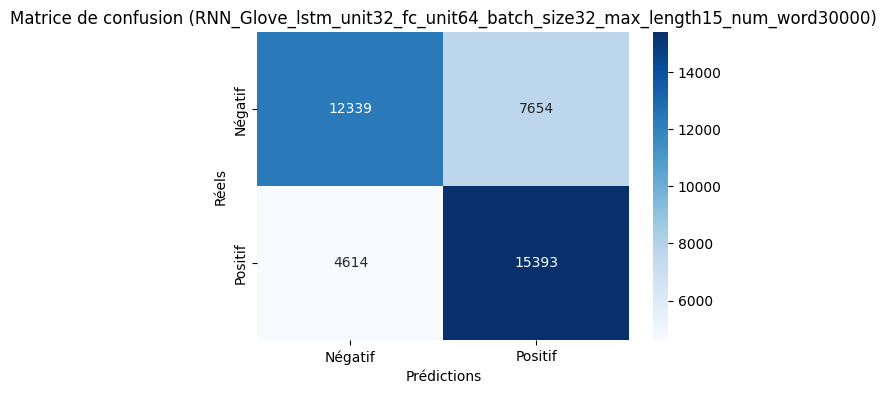

2025/03/07 23:40:26 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 23:40:39 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit64_batch_size32_max_length15_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 53s 12ms/step - accuracy: 0.5845 - loss: 1.5693 - val_accuracy: 0.6695 - val_loss: 0.8644 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 49s 12ms/step - accuracy: 0.6695 - loss: 0.7908 - val_accuracy: 0.6781 - val_loss: 0.6496 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 49s 12ms/step - accuracy: 0.6740 - loss: 0.6392 - val_accuracy: 0.6796 - val_loss: 0.6056 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 48s 12ms/step - accuracy: 0.6815 - loss: 0.6020 - val_accuracy: 0.6827 - val_loss: 0.5940 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 50s 12ms/step - accuracy: 0.6831 - loss: 0.5912 - val_accuracy: 0.6829 - val_loss: 0.5899 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

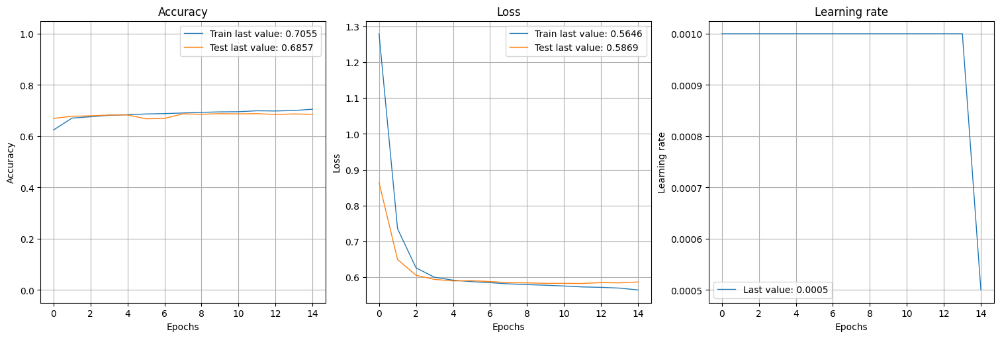

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step


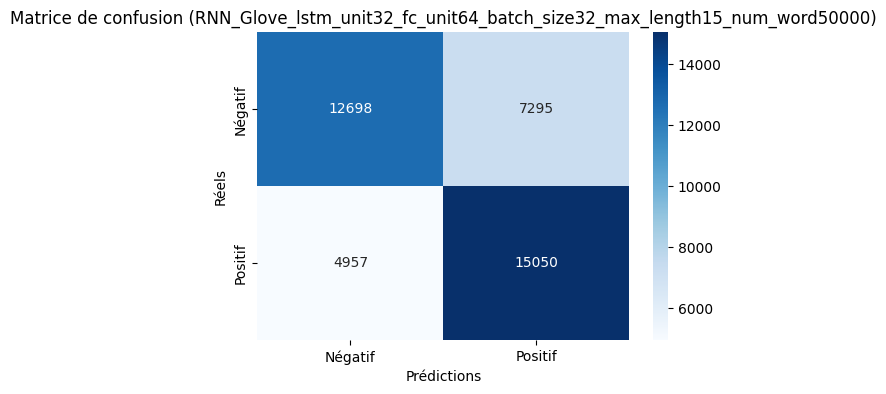

2025/03/07 23:53:56 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/07 23:54:09 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit64_batch_size32_max_length30_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 72s 17ms/step - accuracy: 0.5953 - loss: 1.5691 - val_accuracy: 0.6929 - val_loss: 0.8433 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 70s 17ms/step - accuracy: 0.6922 - loss: 0.7726 - val_accuracy: 0.6993 - val_loss: 0.6288 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 70s 17ms/step - accuracy: 0.7031 - loss: 0.6125 - val_accuracy: 0.7034 - val_loss: 0.5801 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 68s 17ms/step - accuracy: 0.7042 - loss: 0.5808 - val_accuracy: 0.6971 - val_loss: 0.5788 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.7087 - loss: 0.5706 - val_accuracy: 0.7077 - val_loss: 0.5685 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

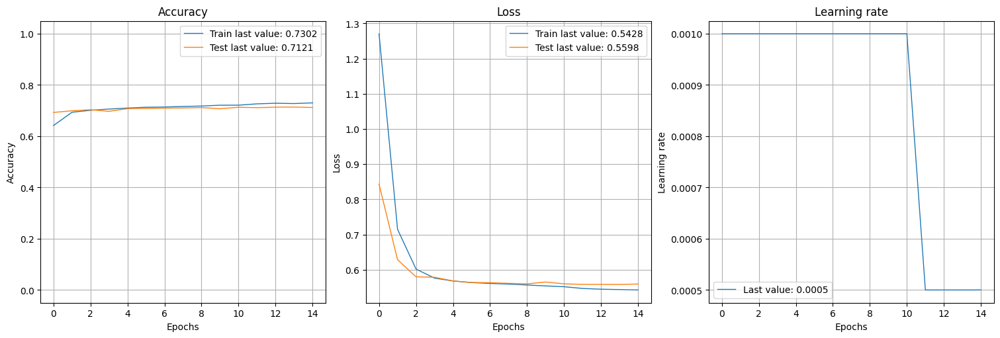

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


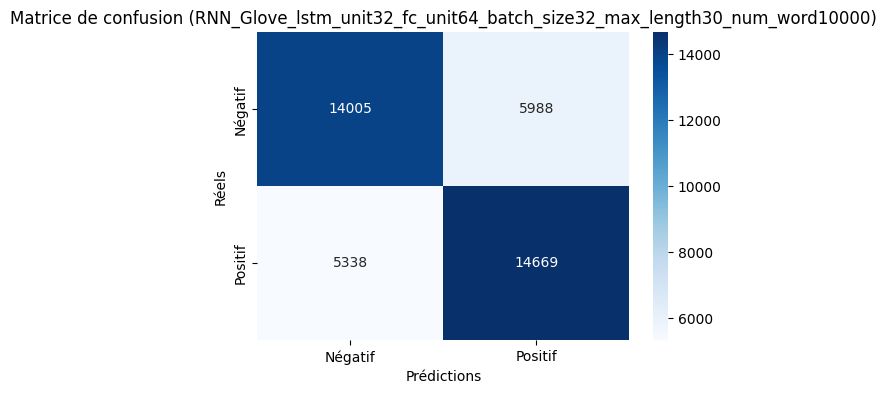

2025/03/08 00:12:16 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 00:12:30 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit64_batch_size32_max_length30_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 71s 17ms/step - accuracy: 0.5753 - loss: 1.5866 - val_accuracy: 0.6911 - val_loss: 0.8491 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 65s 16ms/step - accuracy: 0.6905 - loss: 0.7772 - val_accuracy: 0.6993 - val_loss: 0.6318 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 64s 16ms/step - accuracy: 0.7020 - loss: 0.6157 - val_accuracy: 0.7050 - val_loss: 0.5821 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 65s 16ms/step - accuracy: 0.7064 - loss: 0.5797 - val_accuracy: 0.7050 - val_loss: 0.5719 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 65s 16ms/step - accuracy: 0.7100 - loss: 0.5682 - val_accuracy: 0.7081 - val_loss: 0.5664 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

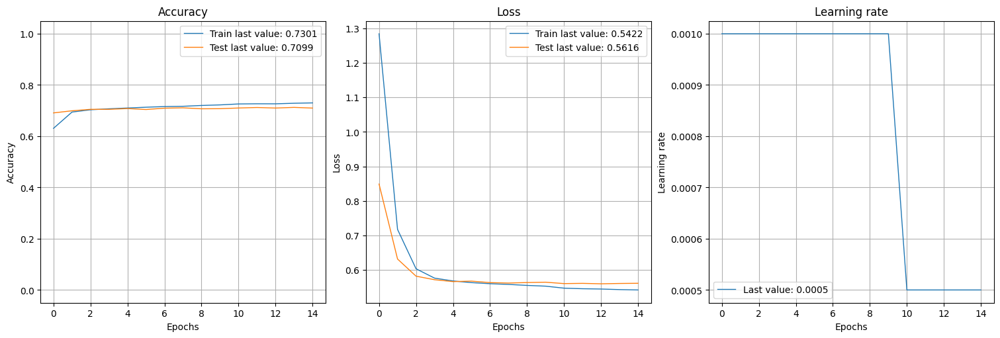

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


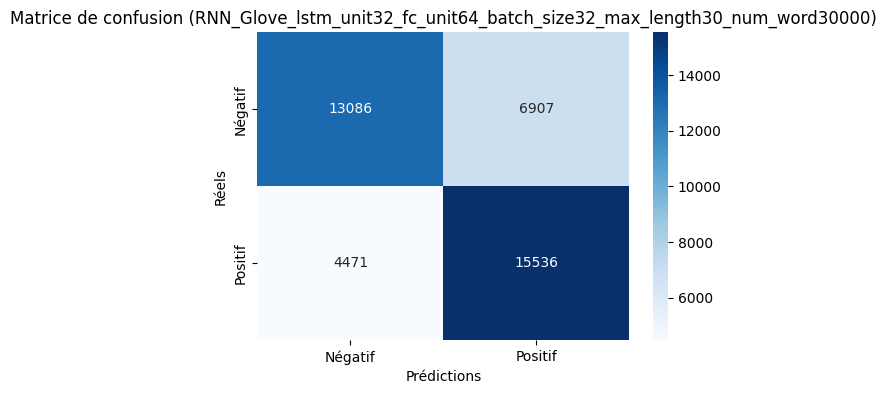

2025/03/08 00:29:43 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 00:29:56 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit64_batch_size32_max_length30_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 71s 17ms/step - accuracy: 0.5832 - loss: 1.5785 - val_accuracy: 0.6897 - val_loss: 0.8492 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 66s 16ms/step - accuracy: 0.6924 - loss: 0.7742 - val_accuracy: 0.7007 - val_loss: 0.6285 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 66s 16ms/step - accuracy: 0.7026 - loss: 0.6146 - val_accuracy: 0.7017 - val_loss: 0.5833 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 66s 16ms/step - accuracy: 0.7066 - loss: 0.5789 - val_accuracy: 0.7078 - val_loss: 0.5703 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 66s 16ms/step - accuracy: 0.7108 - loss: 0.5674 - val_accuracy: 0.7032 - val_loss: 0.5680 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

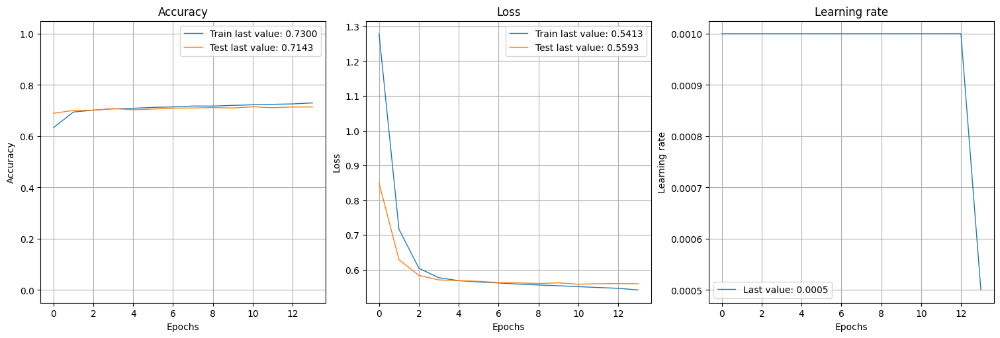

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


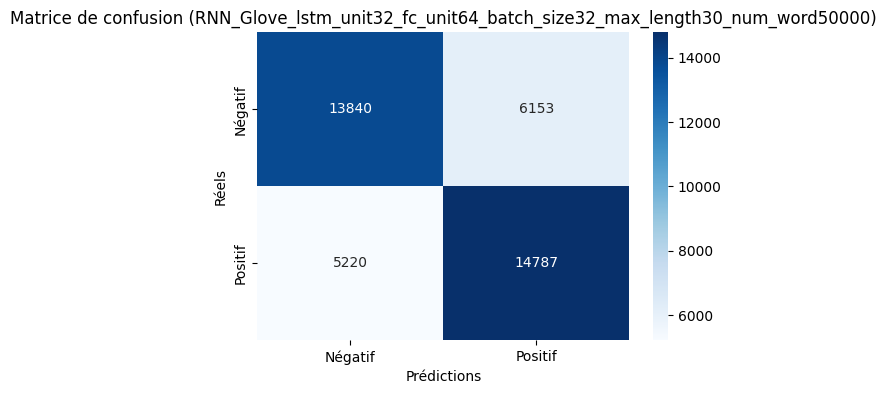

2025/03/08 00:46:20 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 00:46:34 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit128_batch_size32_max_length15_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 50s 12ms/step - accuracy: 0.5741 - loss: 1.6397 - val_accuracy: 0.6680 - val_loss: 0.8854 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 46s 12ms/step - accuracy: 0.6684 - loss: 0.8062 - val_accuracy: 0.6815 - val_loss: 0.6514 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 48s 12ms/step - accuracy: 0.6782 - loss: 0.6400 - val_accuracy: 0.6848 - val_loss: 0.6029 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 45s 11ms/step - accuracy: 0.6827 - loss: 0.6013 - val_accuracy: 0.6876 - val_loss: 0.5901 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6848 - loss: 0.5923 - val_accuracy: 0.6742 - val_loss: 0.5879 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

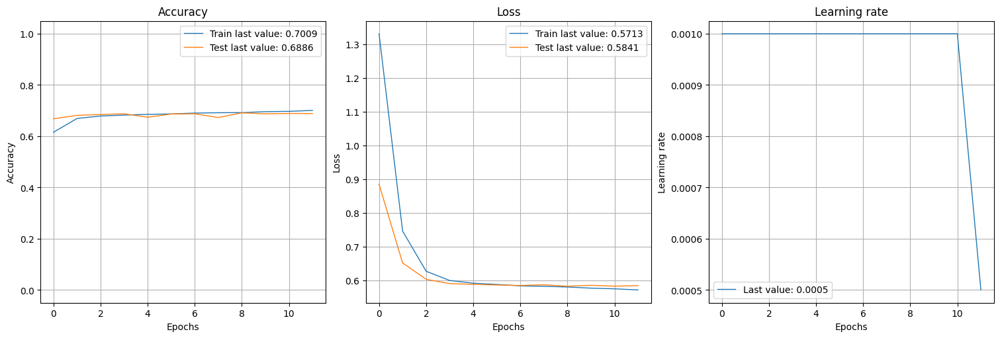

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


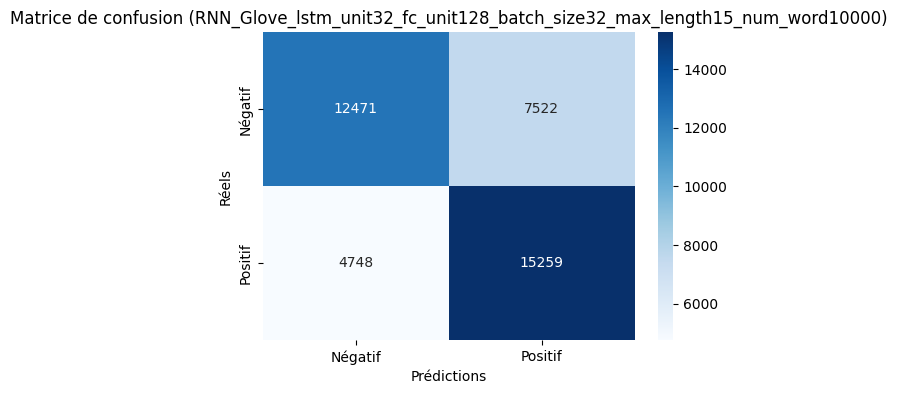

2025/03/08 00:56:45 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 00:56:58 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit128_batch_size32_max_length15_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 51s 12ms/step - accuracy: 0.5596 - loss: 1.6594 - val_accuracy: 0.6671 - val_loss: 0.8905 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 44s 11ms/step - accuracy: 0.6659 - loss: 0.8120 - val_accuracy: 0.6782 - val_loss: 0.6536 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 44s 11ms/step - accuracy: 0.6791 - loss: 0.6395 - val_accuracy: 0.6815 - val_loss: 0.6049 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 44s 11ms/step - accuracy: 0.6812 - loss: 0.6037 - val_accuracy: 0.6833 - val_loss: 0.5930 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 44s 11ms/step - accuracy: 0.6822 - loss: 0.5926 - val_accuracy: 0.6821 - val_loss: 0.5905 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

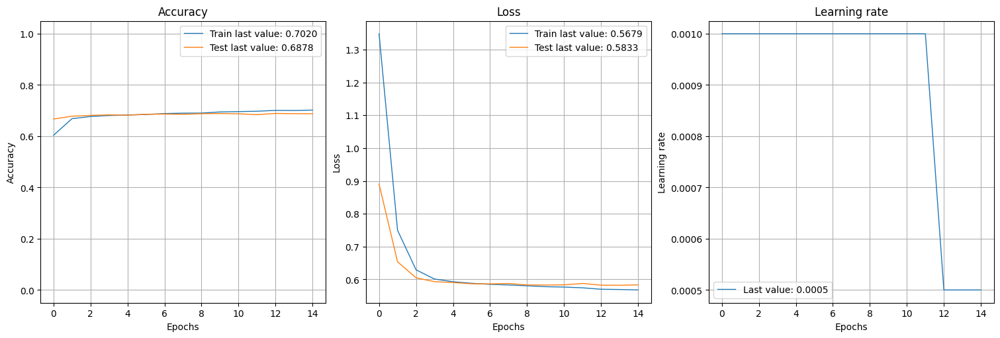

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step


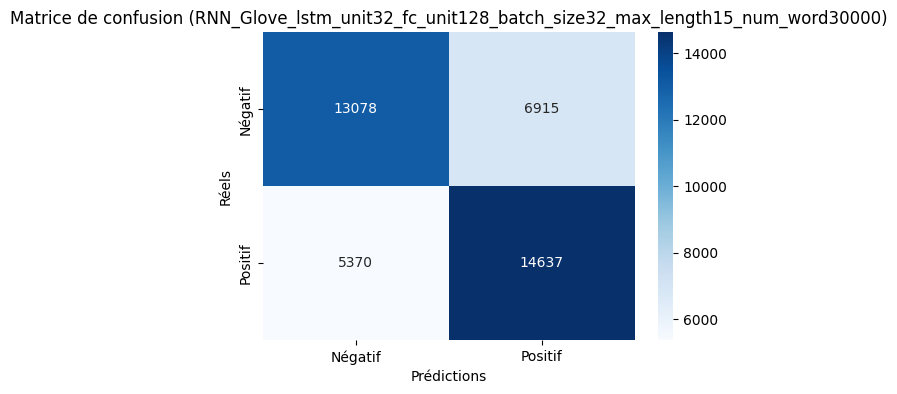

2025/03/08 01:09:00 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 01:09:14 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit128_batch_size32_max_length15_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 11ms/step - accuracy: 0.5694 - loss: 1.6402 - val_accuracy: 0.6672 - val_loss: 0.8832 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6645 - loss: 0.8060 - val_accuracy: 0.6799 - val_loss: 0.6523 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 44s 11ms/step - accuracy: 0.6766 - loss: 0.6396 - val_accuracy: 0.6653 - val_loss: 0.6076 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 44s 11ms/step - accuracy: 0.6800 - loss: 0.6034 - val_accuracy: 0.6794 - val_loss: 0.5964 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 44s 11ms/step - accuracy: 0.6861 - loss: 0.5932 - val_accuracy: 0.6853 - val_loss: 0.5893 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━

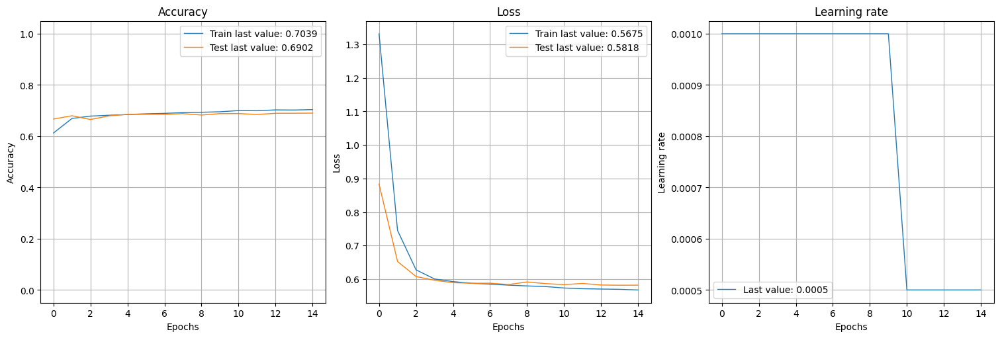

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step


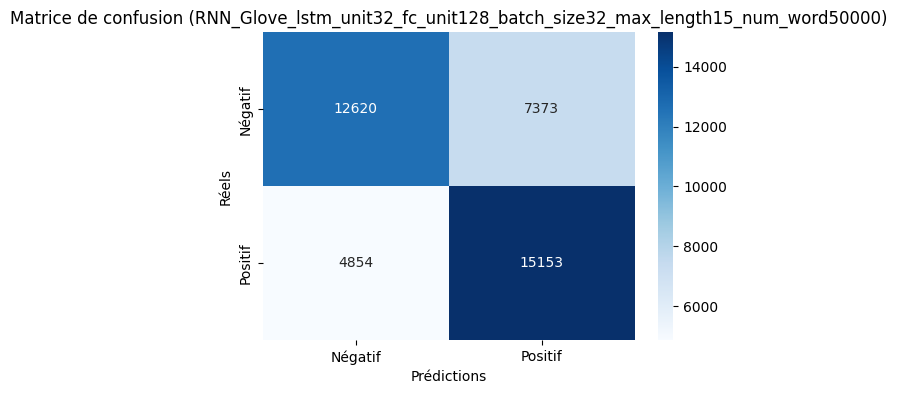

2025/03/08 01:21:11 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 01:21:24 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit128_batch_size32_max_length30_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 65s 16ms/step - accuracy: 0.6048 - loss: 1.6214 - val_accuracy: 0.6898 - val_loss: 0.8617 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 62s 15ms/step - accuracy: 0.6887 - loss: 0.7852 - val_accuracy: 0.7003 - val_loss: 0.6320 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 61s 15ms/step - accuracy: 0.7028 - loss: 0.6161 - val_accuracy: 0.7028 - val_loss: 0.5846 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 61s 15ms/step - accuracy: 0.7064 - loss: 0.5793 - val_accuracy: 0.7028 - val_loss: 0.5748 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 62s 16ms/step - accuracy: 0.7108 - loss: 0.5686 - val_accuracy: 0.7082 - val_loss: 0.5656 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

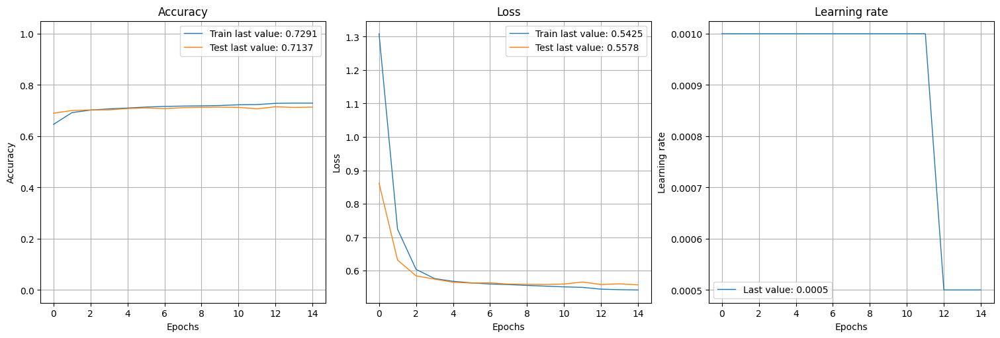

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


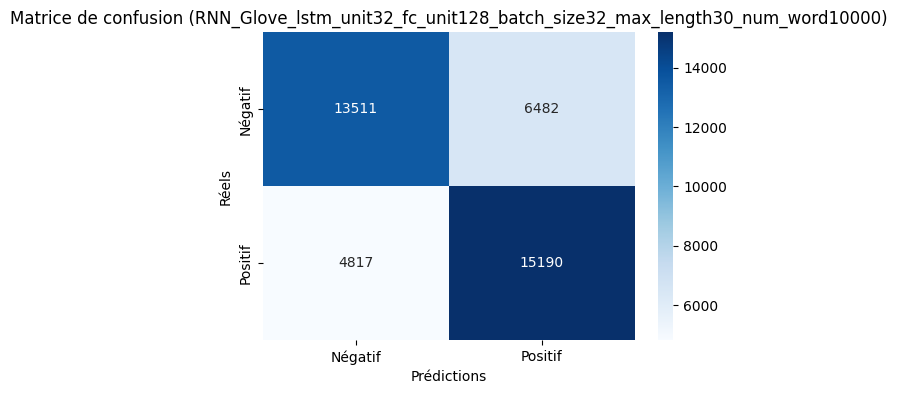

2025/03/08 01:37:49 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 01:38:02 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit128_batch_size32_max_length30_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 65s 16ms/step - accuracy: 0.5870 - loss: 1.6343 - val_accuracy: 0.6890 - val_loss: 0.8638 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 61s 15ms/step - accuracy: 0.6938 - loss: 0.7812 - val_accuracy: 0.6892 - val_loss: 0.6362 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.7035 - loss: 0.6170 - val_accuracy: 0.6978 - val_loss: 0.5908 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.7073 - loss: 0.5800 - val_accuracy: 0.7056 - val_loss: 0.5727 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 66s 17ms/step - accuracy: 0.7109 - loss: 0.5699 - val_accuracy: 0.7063 - val_loss: 0.5685 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

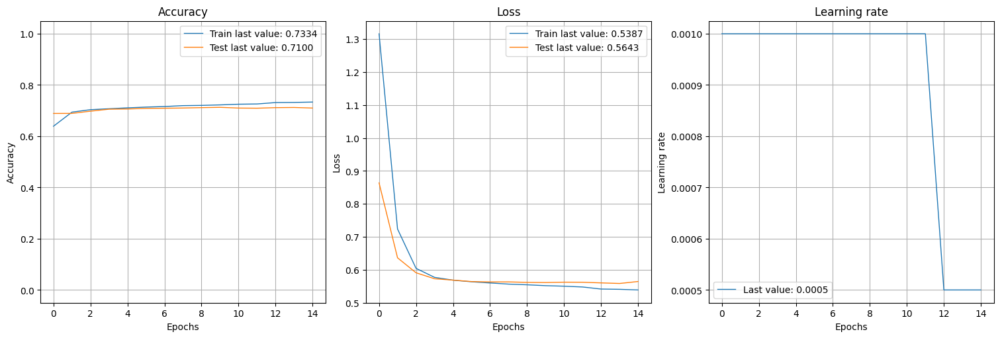

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step


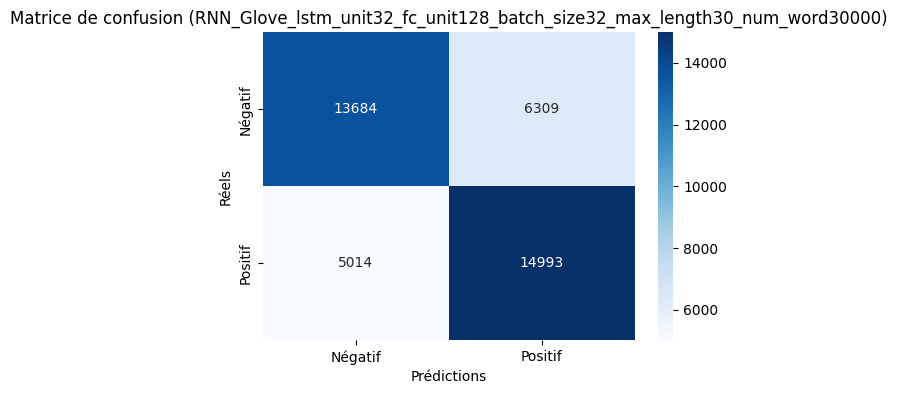

2025/03/08 01:54:47 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 01:55:00 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit128_batch_size32_max_length30_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 63s 15ms/step - accuracy: 0.5964 - loss: 1.6215 - val_accuracy: 0.6893 - val_loss: 0.8618 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 61s 15ms/step - accuracy: 0.6938 - loss: 0.7826 - val_accuracy: 0.7007 - val_loss: 0.6309 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 61s 15ms/step - accuracy: 0.7026 - loss: 0.6157 - val_accuracy: 0.7036 - val_loss: 0.5840 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 63s 16ms/step - accuracy: 0.7059 - loss: 0.5806 - val_accuracy: 0.7070 - val_loss: 0.5705 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 60s 15ms/step - accuracy: 0.7101 - loss: 0.5678 - val_accuracy: 0.7090 - val_loss: 0.5668 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━

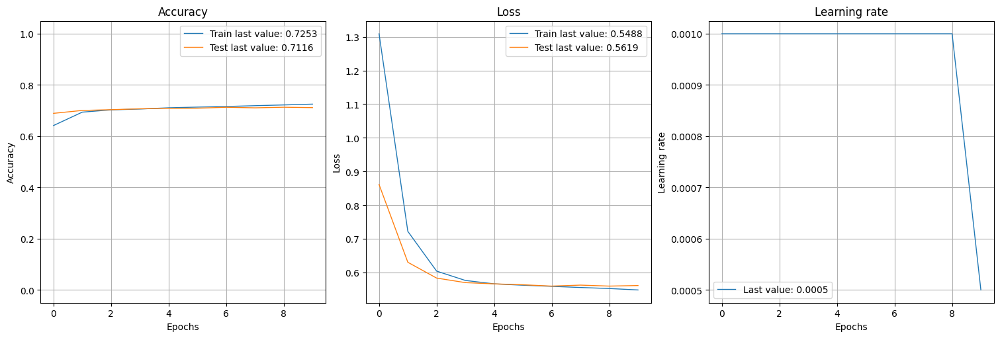

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step


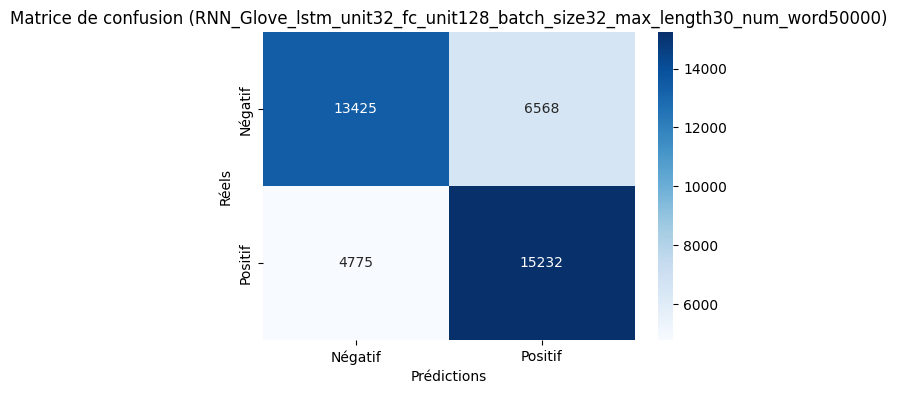

2025/03/08 02:06:02 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 02:06:16 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit32_batch_size32_max_length15_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 59s 14ms/step - accuracy: 0.5964 - loss: 1.6902 - val_accuracy: 0.6697 - val_loss: 0.8962 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 55s 14ms/step - accuracy: 0.6707 - loss: 0.8109 - val_accuracy: 0.6802 - val_loss: 0.6537 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 55s 14ms/step - accuracy: 0.6797 - loss: 0.6388 - val_accuracy: 0.6797 - val_loss: 0.6060 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 55s 14ms/step - accuracy: 0.6830 - loss: 0.5990 - val_accuracy: 0.6838 - val_loss: 0.5930 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 54s 14ms/step - accuracy: 0.6856 - loss: 0.5890 - val_accuracy: 0.6857 - val_loss: 0.5879 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

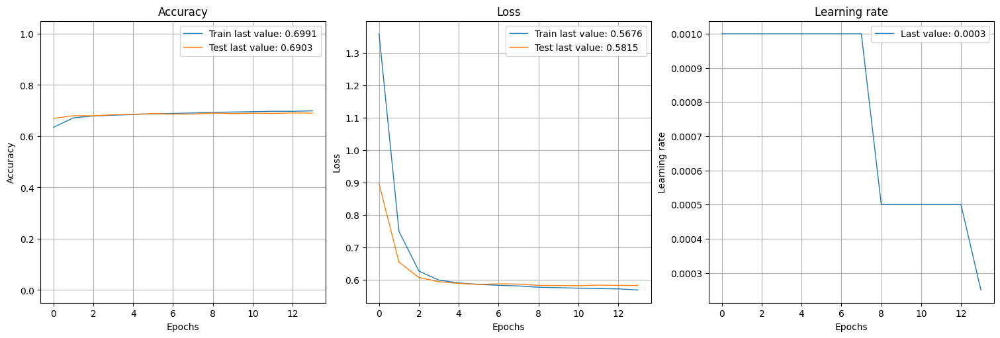

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


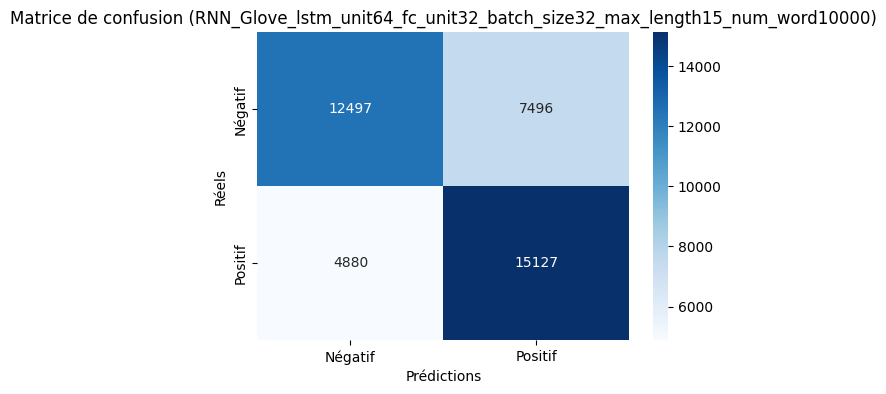

2025/03/08 02:20:08 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 02:20:21 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit32_batch_size32_max_length15_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 59s 14ms/step - accuracy: 0.5903 - loss: 1.6895 - val_accuracy: 0.6697 - val_loss: 0.8950 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 62s 15ms/step - accuracy: 0.6736 - loss: 0.8098 - val_accuracy: 0.6803 - val_loss: 0.6546 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 59s 15ms/step - accuracy: 0.6810 - loss: 0.6367 - val_accuracy: 0.6837 - val_loss: 0.6033 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 14ms/step - accuracy: 0.6826 - loss: 0.6012 - val_accuracy: 0.6833 - val_loss: 0.5920 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 55s 14ms/step - accuracy: 0.6854 - loss: 0.5912 - val_accuracy: 0.6846 - val_loss: 0.5892 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

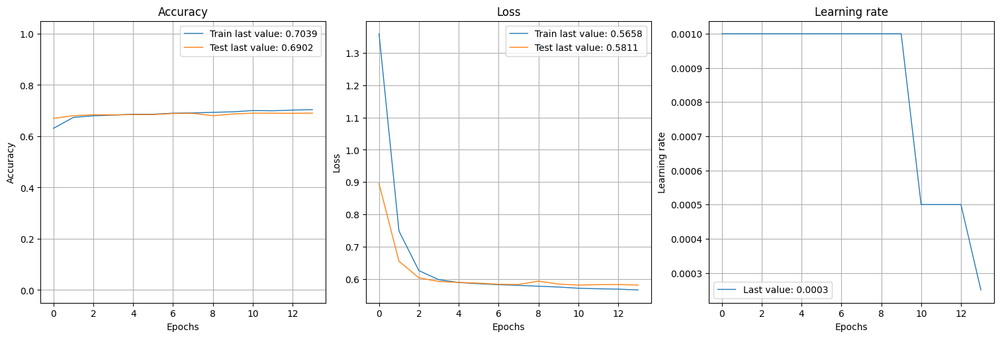

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


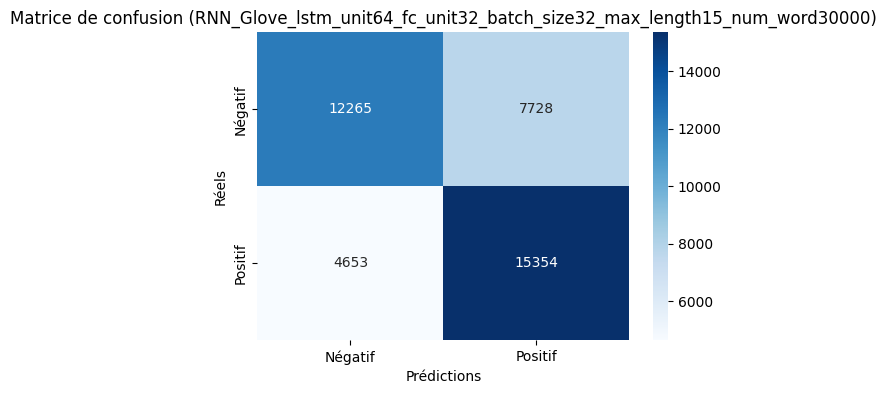

2025/03/08 02:34:30 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 02:34:43 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit32_batch_size32_max_length15_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 14ms/step - accuracy: 0.5865 - loss: 1.7015 - val_accuracy: 0.6715 - val_loss: 0.8974 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 56s 14ms/step - accuracy: 0.6698 - loss: 0.8141 - val_accuracy: 0.6652 - val_loss: 0.6571 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 55s 14ms/step - accuracy: 0.6792 - loss: 0.6388 - val_accuracy: 0.6830 - val_loss: 0.6030 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 54s 14ms/step - accuracy: 0.6862 - loss: 0.6003 - val_accuracy: 0.6817 - val_loss: 0.5948 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 55s 14ms/step - accuracy: 0.6877 - loss: 0.5866 - val_accuracy: 0.6846 - val_loss: 0.5889 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

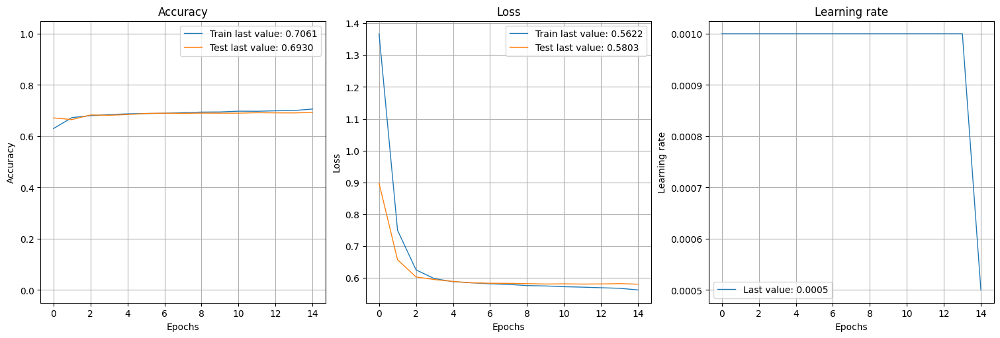

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


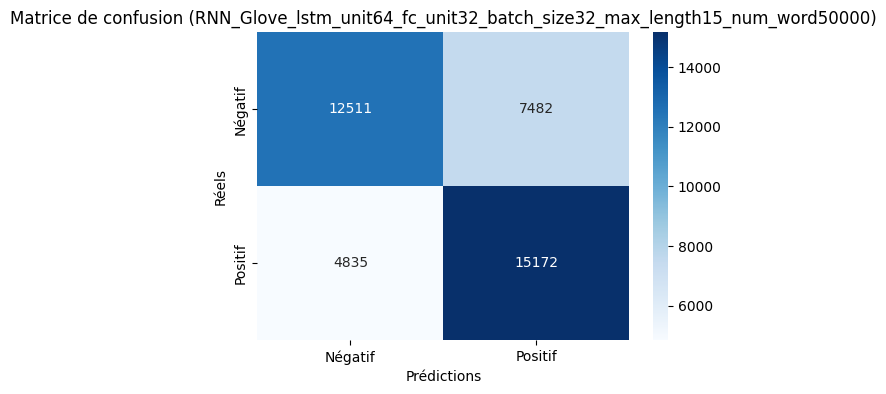

2025/03/08 02:49:24 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 02:49:38 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit32_batch_size32_max_length30_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 91s 22ms/step - accuracy: 0.6029 - loss: 1.6892 - val_accuracy: 0.6935 - val_loss: 0.8794 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 87s 22ms/step - accuracy: 0.6946 - loss: 0.7937 - val_accuracy: 0.6992 - val_loss: 0.6363 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 87s 22ms/step - accuracy: 0.7044 - loss: 0.6167 - val_accuracy: 0.7060 - val_loss: 0.5825 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 86s 22ms/step - accuracy: 0.7066 - loss: 0.5789 - val_accuracy: 0.7084 - val_loss: 0.5697 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 86s 22ms/step - accuracy: 0.7117 - loss: 0.5657 - val_accuracy: 0.7112 - val_loss: 0.5646 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

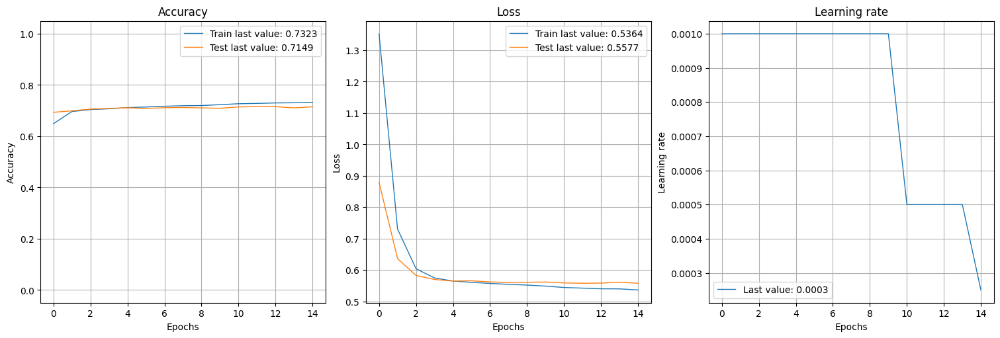

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step


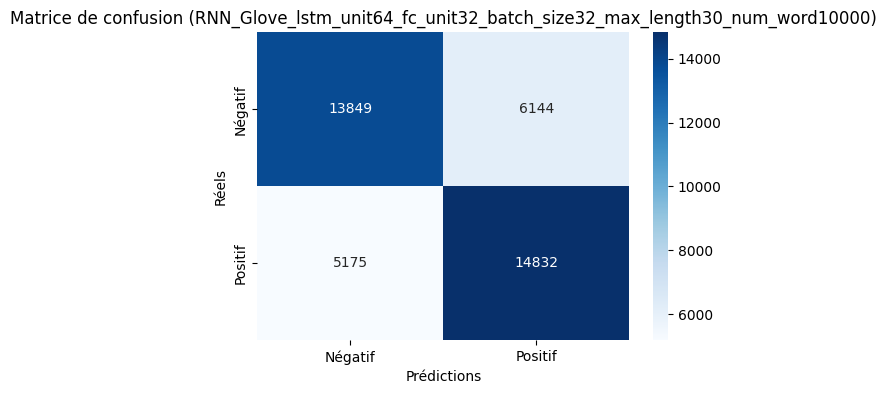

2025/03/08 03:12:34 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 03:12:47 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit32_batch_size32_max_length30_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 86s 21ms/step - accuracy: 0.6066 - loss: 1.6883 - val_accuracy: 0.6949 - val_loss: 0.8778 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 83s 21ms/step - accuracy: 0.6966 - loss: 0.7947 - val_accuracy: 0.7030 - val_loss: 0.6349 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 84s 21ms/step - accuracy: 0.7065 - loss: 0.6146 - val_accuracy: 0.7063 - val_loss: 0.5821 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 83s 21ms/step - accuracy: 0.7094 - loss: 0.5772 - val_accuracy: 0.7058 - val_loss: 0.5709 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 83s 21ms/step - accuracy: 0.7116 - loss: 0.5653 - val_accuracy: 0.7084 - val_loss: 0.5667 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

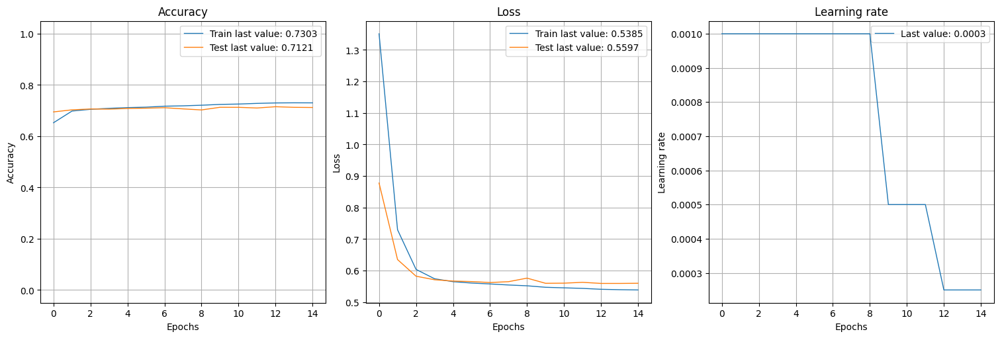

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 9s 7ms/step


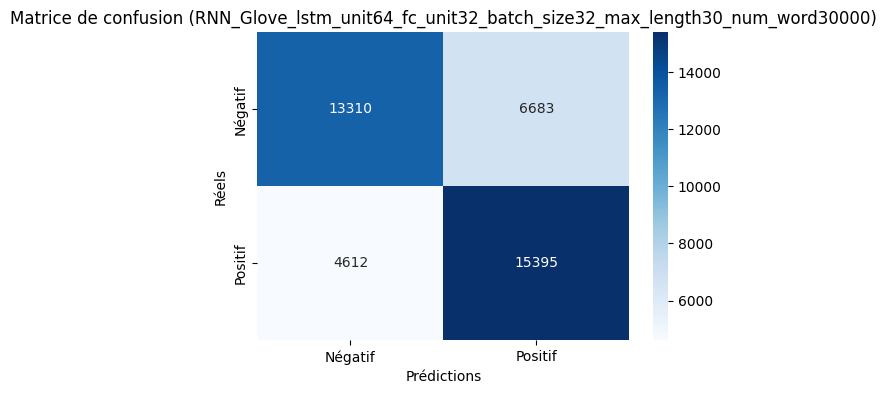

2025/03/08 03:34:30 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 03:34:44 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit32_batch_size32_max_length30_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 83s 20ms/step - accuracy: 0.6039 - loss: 1.6775 - val_accuracy: 0.6931 - val_loss: 0.8752 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 81s 20ms/step - accuracy: 0.6944 - loss: 0.7919 - val_accuracy: 0.7009 - val_loss: 0.6334 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 80s 20ms/step - accuracy: 0.7051 - loss: 0.6147 - val_accuracy: 0.7028 - val_loss: 0.5833 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 80s 20ms/step - accuracy: 0.7102 - loss: 0.5753 - val_accuracy: 0.7089 - val_loss: 0.5691 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 79s 20ms/step - accuracy: 0.7139 - loss: 0.5641 - val_accuracy: 0.7067 - val_loss: 0.5671 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

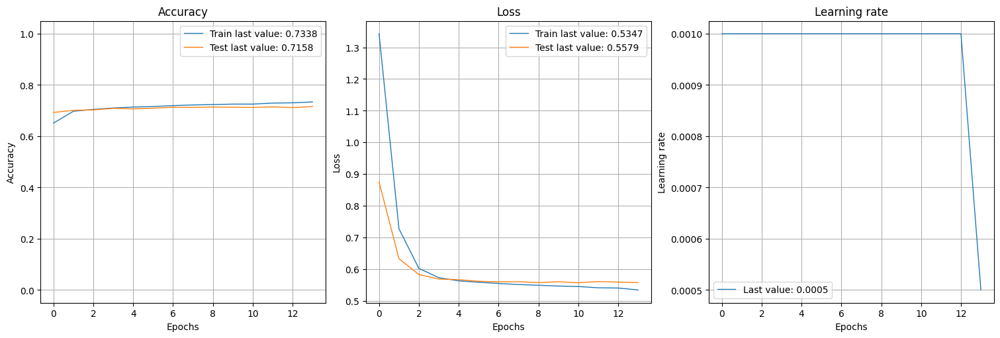

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 9s 7ms/step


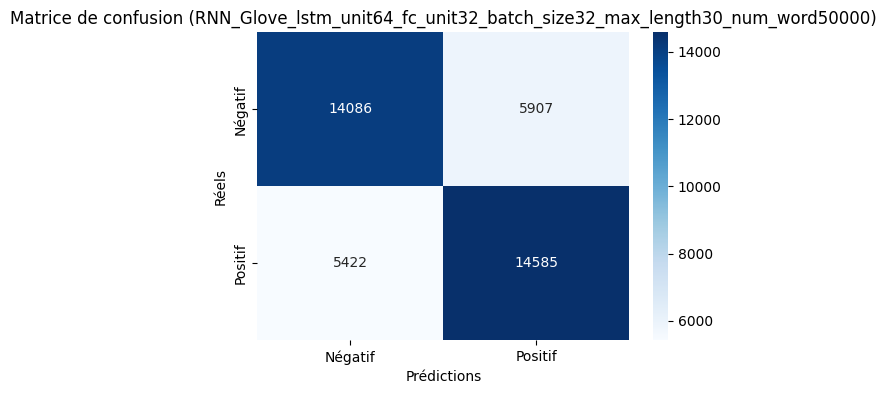

2025/03/08 03:54:33 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 03:54:46 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit64_batch_size32_max_length15_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 51s 12ms/step - accuracy: 0.5979 - loss: 1.8576 - val_accuracy: 0.6736 - val_loss: 0.9432 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 48s 12ms/step - accuracy: 0.6717 - loss: 0.8466 - val_accuracy: 0.6797 - val_loss: 0.6631 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6776 - loss: 0.6466 - val_accuracy: 0.6739 - val_loss: 0.6150 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 48s 12ms/step - accuracy: 0.6829 - loss: 0.6027 - val_accuracy: 0.6856 - val_loss: 0.5914 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6861 - loss: 0.5903 - val_accuracy: 0.6841 - val_loss: 0.5881 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

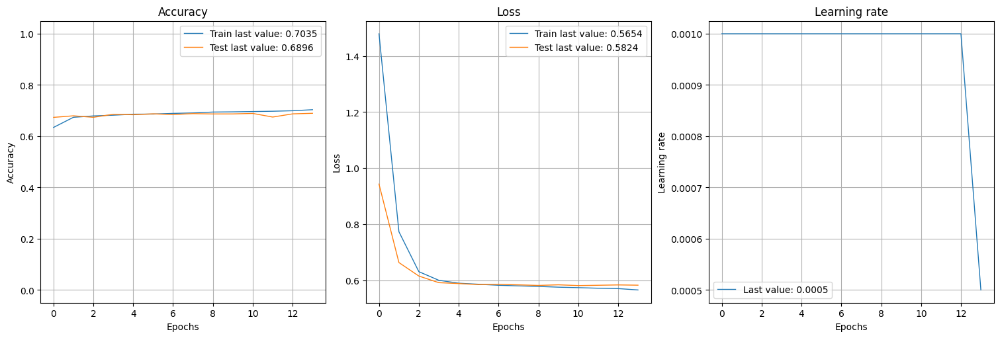

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step


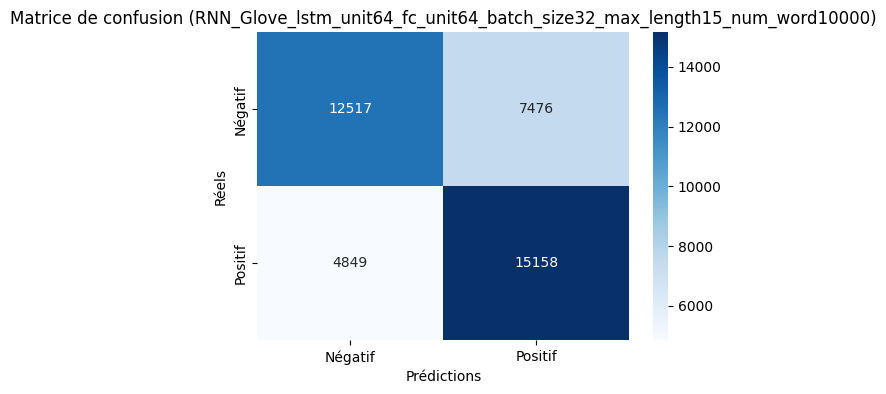

2025/03/08 04:06:55 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 04:07:08 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit64_batch_size32_max_length15_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 51s 12ms/step - accuracy: 0.5881 - loss: 1.8602 - val_accuracy: 0.6740 - val_loss: 0.9421 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 48s 12ms/step - accuracy: 0.6704 - loss: 0.8470 - val_accuracy: 0.6802 - val_loss: 0.6638 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6788 - loss: 0.6456 - val_accuracy: 0.6822 - val_loss: 0.6053 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6820 - loss: 0.6014 - val_accuracy: 0.6864 - val_loss: 0.5901 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 47s 12ms/step - accuracy: 0.6877 - loss: 0.5888 - val_accuracy: 0.6866 - val_loss: 0.5864 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

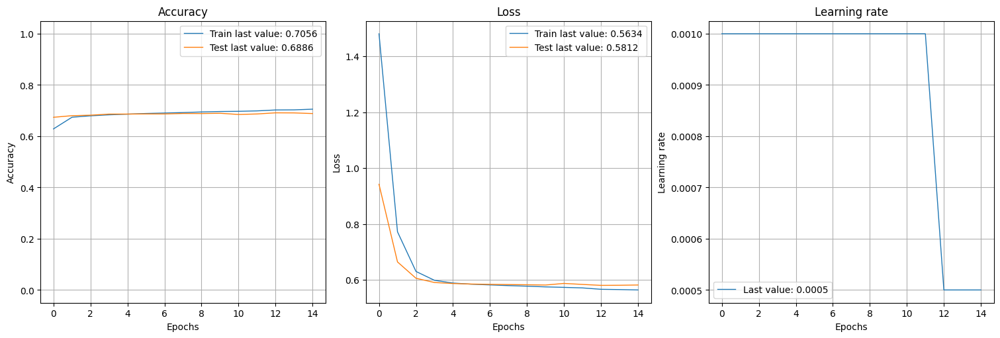

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step


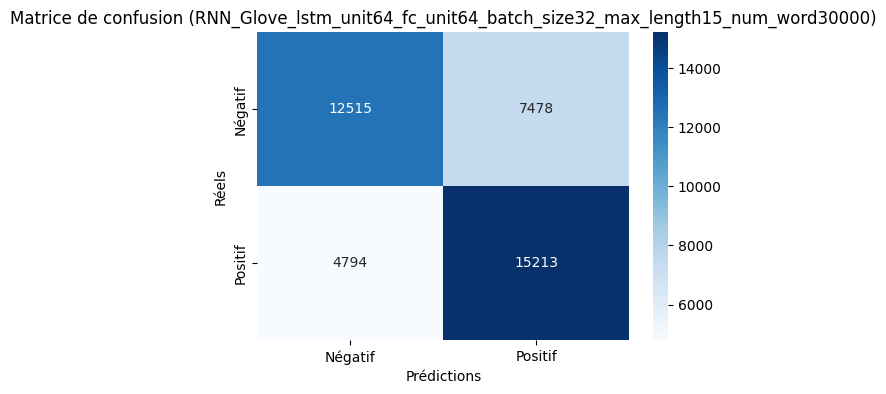

2025/03/08 04:20:02 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 04:20:15 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit64_batch_size32_max_length15_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 49s 12ms/step - accuracy: 0.5924 - loss: 1.8480 - val_accuracy: 0.6710 - val_loss: 0.9409 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 46s 11ms/step - accuracy: 0.6696 - loss: 0.8457 - val_accuracy: 0.6780 - val_loss: 0.6629 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 46s 11ms/step - accuracy: 0.6808 - loss: 0.6444 - val_accuracy: 0.6832 - val_loss: 0.6062 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 46s 12ms/step - accuracy: 0.6829 - loss: 0.6020 - val_accuracy: 0.6829 - val_loss: 0.5931 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 46s 11ms/step - accuracy: 0.6860 - loss: 0.5896 - val_accuracy: 0.6864 - val_loss: 0.5865 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

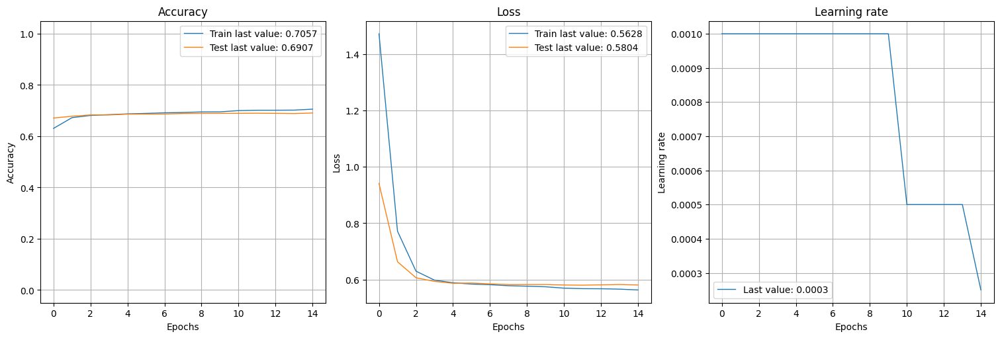

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step


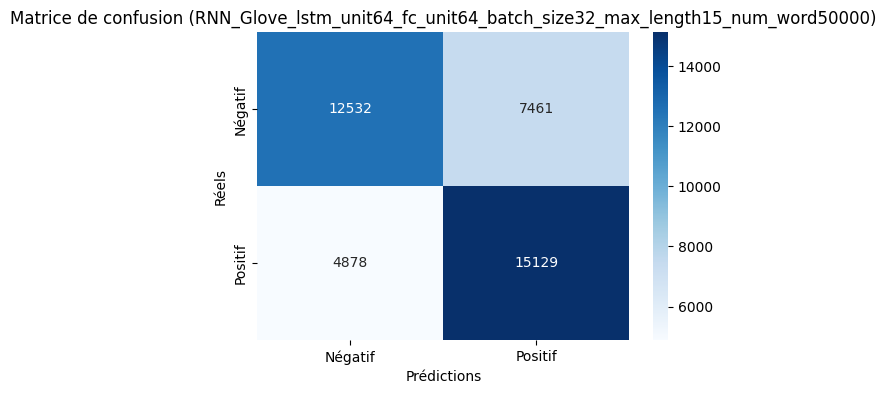

2025/03/08 04:32:43 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 04:32:56 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit64_batch_size32_max_length30_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 77s 19ms/step - accuracy: 0.6149 - loss: 1.8153 - val_accuracy: 0.6933 - val_loss: 0.9155 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 72s 18ms/step - accuracy: 0.6949 - loss: 0.8185 - val_accuracy: 0.6988 - val_loss: 0.6438 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 73s 18ms/step - accuracy: 0.7002 - loss: 0.6227 - val_accuracy: 0.7035 - val_loss: 0.5863 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 74s 18ms/step - accuracy: 0.7080 - loss: 0.5782 - val_accuracy: 0.7071 - val_loss: 0.5703 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 73s 18ms/step - accuracy: 0.7123 - loss: 0.5651 - val_accuracy: 0.7041 - val_loss: 0.5687 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

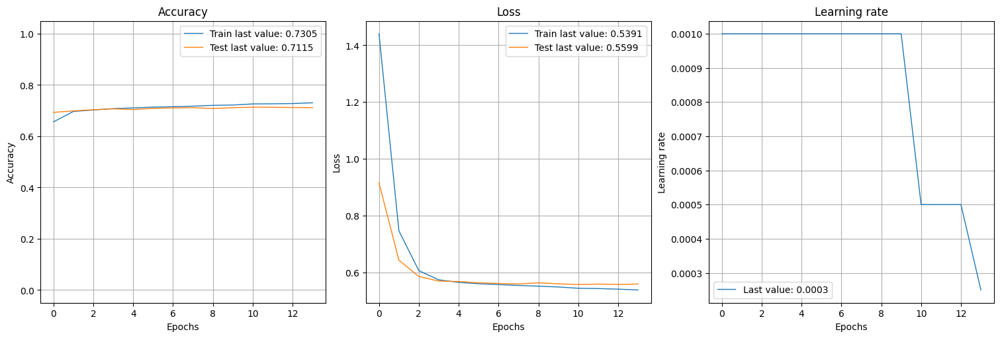

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


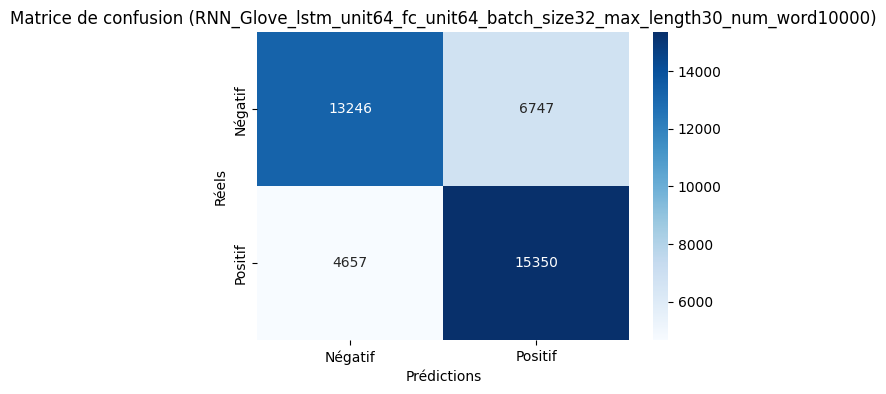

2025/03/08 04:51:15 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 04:51:29 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit64_batch_size32_max_length30_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 75s 18ms/step - accuracy: 0.6134 - loss: 1.8318 - val_accuracy: 0.6952 - val_loss: 0.9167 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 69s 17ms/step - accuracy: 0.6958 - loss: 0.8212 - val_accuracy: 0.7033 - val_loss: 0.6415 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 68s 17ms/step - accuracy: 0.7027 - loss: 0.6219 - val_accuracy: 0.7028 - val_loss: 0.5849 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 71s 18ms/step - accuracy: 0.7076 - loss: 0.5786 - val_accuracy: 0.7087 - val_loss: 0.5693 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 69s 17ms/step - accuracy: 0.7113 - loss: 0.5650 - val_accuracy: 0.7099 - val_loss: 0.5646 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━━

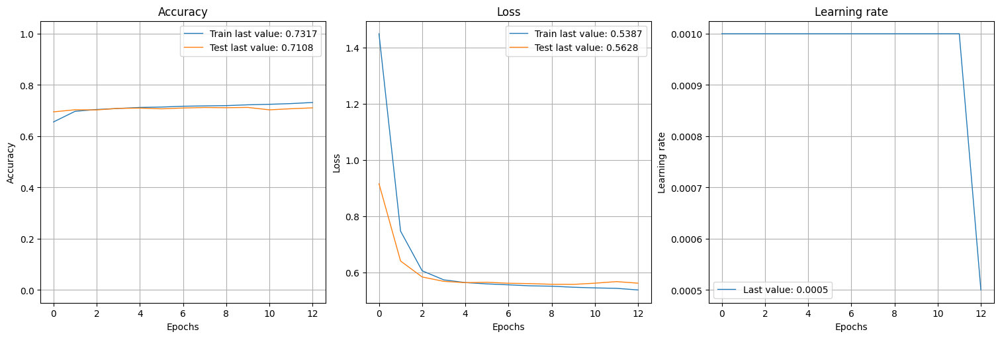

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step


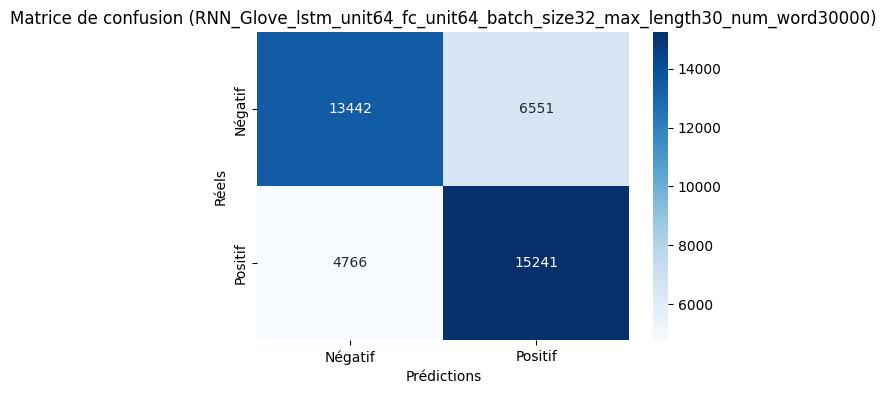

2025/03/08 05:07:39 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 05:07:58 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit64_batch_size32_max_length30_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 73s 18ms/step - accuracy: 0.6057 - loss: 1.8391 - val_accuracy: 0.6924 - val_loss: 0.9212 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.6951 - loss: 0.8224 - val_accuracy: 0.7057 - val_loss: 0.6419 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.7025 - loss: 0.6228 - val_accuracy: 0.7050 - val_loss: 0.5877 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.7065 - loss: 0.5799 - val_accuracy: 0.7082 - val_loss: 0.5713 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.7127 - loss: 0.5654 - val_accuracy: 0.7074 - val_loss: 0.5670 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

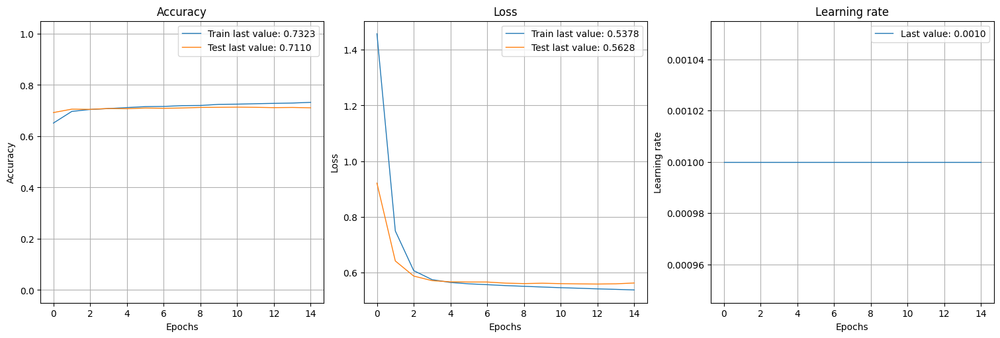

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step


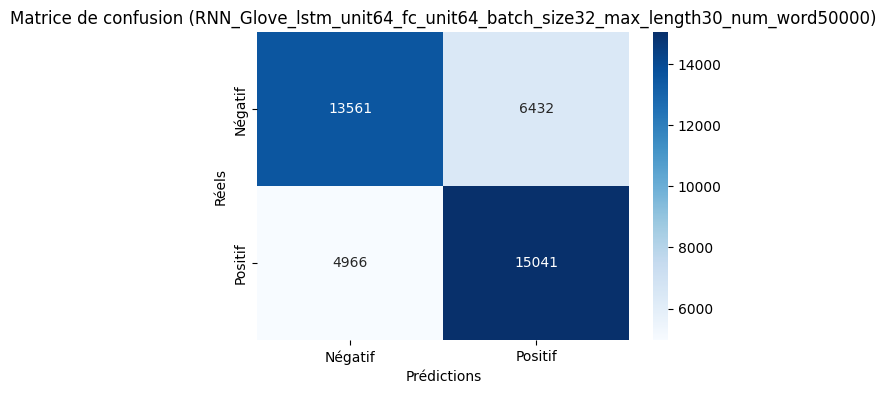

2025/03/08 05:25:58 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 05:26:11 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit128_batch_size32_max_length15_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 46s 11ms/step - accuracy: 0.5826 - loss: 2.0058 - val_accuracy: 0.6679 - val_loss: 0.9881 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 43s 11ms/step - accuracy: 0.6684 - loss: 0.8776 - val_accuracy: 0.6773 - val_loss: 0.6734 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 43s 11ms/step - accuracy: 0.6787 - loss: 0.6524 - val_accuracy: 0.6811 - val_loss: 0.6091 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 43s 11ms/step - accuracy: 0.6824 - loss: 0.6039 - val_accuracy: 0.6839 - val_loss: 0.5918 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 42s 10ms/step - accuracy: 0.6867 - loss: 0.5907 - val_accuracy: 0.6846 - val_loss: 0.5887 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

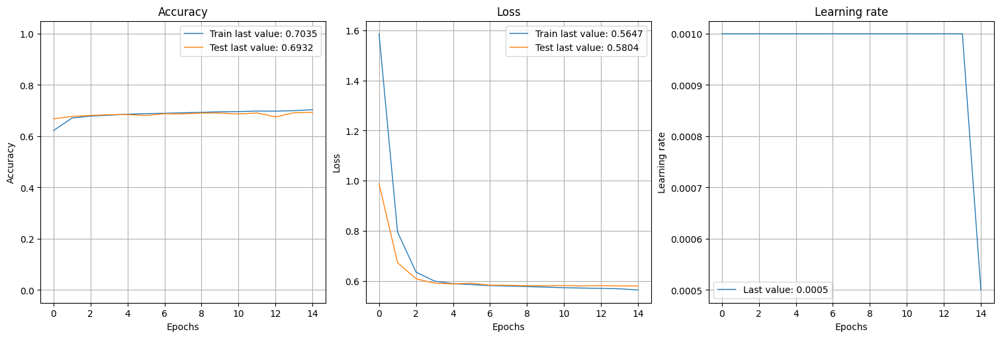

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


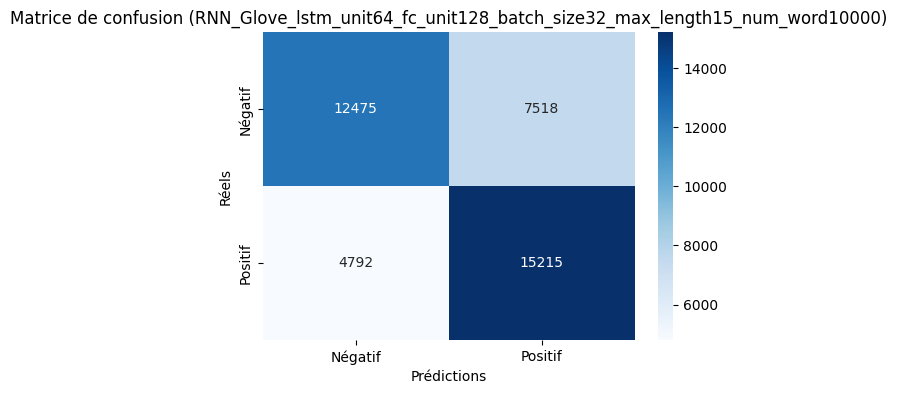

2025/03/08 05:37:48 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 05:38:02 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit128_batch_size32_max_length15_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 46s 11ms/step - accuracy: 0.5843 - loss: 1.9957 - val_accuracy: 0.6709 - val_loss: 0.9839 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 43s 11ms/step - accuracy: 0.6687 - loss: 0.8774 - val_accuracy: 0.6792 - val_loss: 0.6742 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 42s 11ms/step - accuracy: 0.6784 - loss: 0.6522 - val_accuracy: 0.6835 - val_loss: 0.6071 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 43s 11ms/step - accuracy: 0.6817 - loss: 0.6038 - val_accuracy: 0.6806 - val_loss: 0.5939 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 43s 11ms/step - accuracy: 0.6830 - loss: 0.5914 - val_accuracy: 0.6866 - val_loss: 0.5863 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

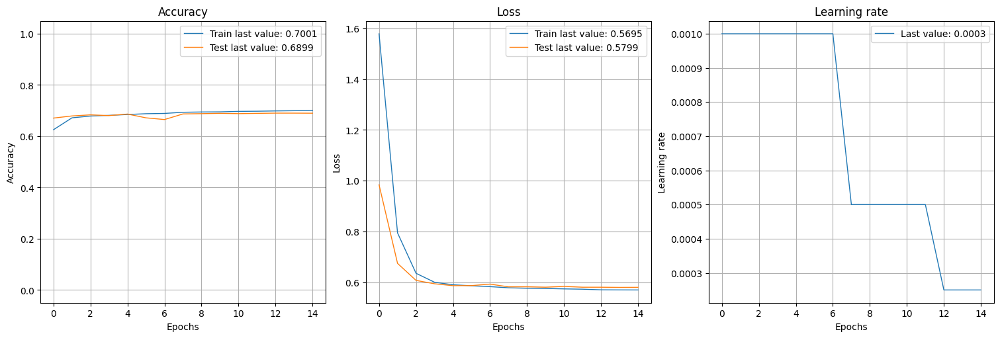

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step


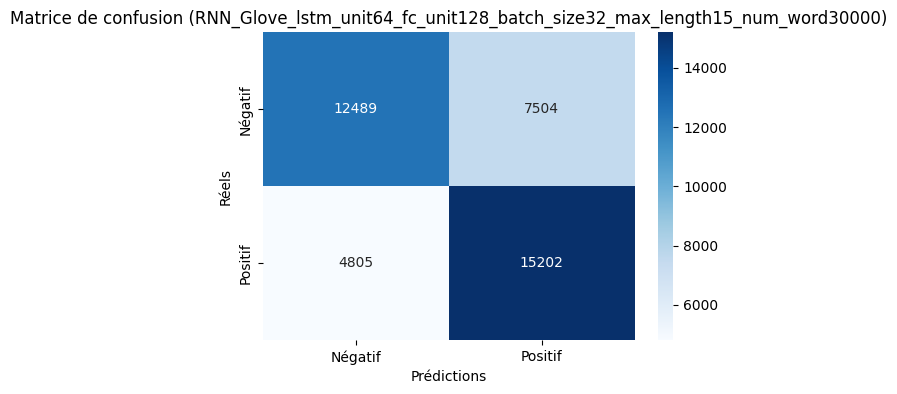

2025/03/08 05:49:49 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 05:50:02 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit128_batch_size32_max_length15_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 45s 11ms/step - accuracy: 0.5885 - loss: 2.0076 - val_accuracy: 0.6546 - val_loss: 0.9900 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 42s 11ms/step - accuracy: 0.6708 - loss: 0.8784 - val_accuracy: 0.6784 - val_loss: 0.6755 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 43s 11ms/step - accuracy: 0.6808 - loss: 0.6507 - val_accuracy: 0.6827 - val_loss: 0.6090 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 42s 11ms/step - accuracy: 0.6812 - loss: 0.6053 - val_accuracy: 0.6840 - val_loss: 0.5929 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 42s 11ms/step - accuracy: 0.6863 - loss: 0.5893 - val_accuracy: 0.6840 - val_loss: 0.5892 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━

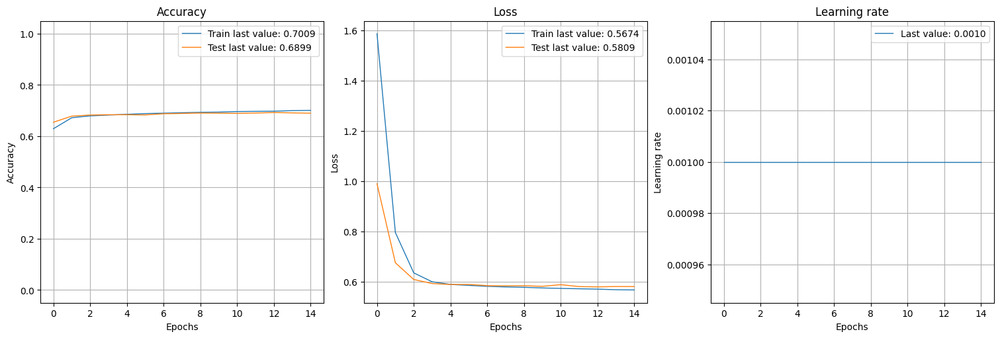

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step


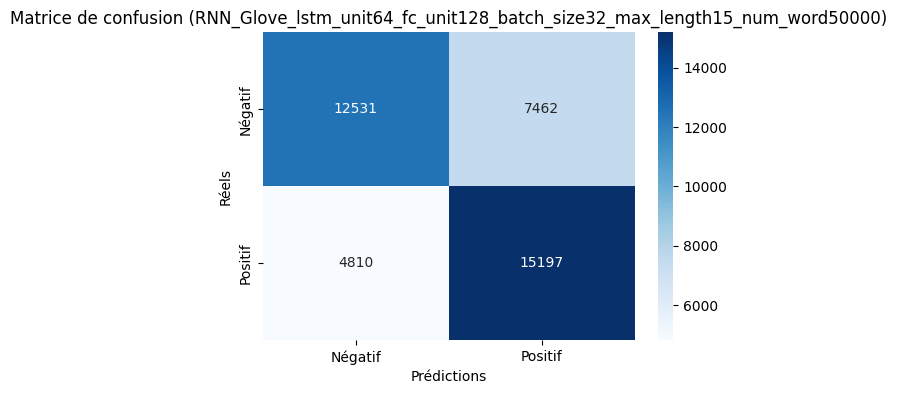

2025/03/08 06:01:32 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 06:01:46 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit128_batch_size32_max_length30_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 70s 17ms/step - accuracy: 0.6128 - loss: 1.9993 - val_accuracy: 0.6959 - val_loss: 0.9663 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.6931 - loss: 0.8559 - val_accuracy: 0.6997 - val_loss: 0.6541 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.7022 - loss: 0.6303 - val_accuracy: 0.7055 - val_loss: 0.5857 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 65s 16ms/step - accuracy: 0.7046 - loss: 0.5818 - val_accuracy: 0.7063 - val_loss: 0.5744 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 65s 16ms/step - accuracy: 0.7090 - loss: 0.5681 - val_accuracy: 0.7084 - val_loss: 0.5667 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

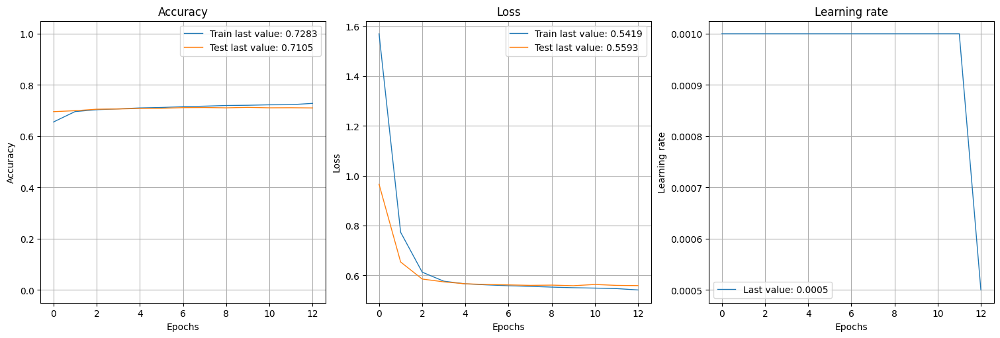

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step


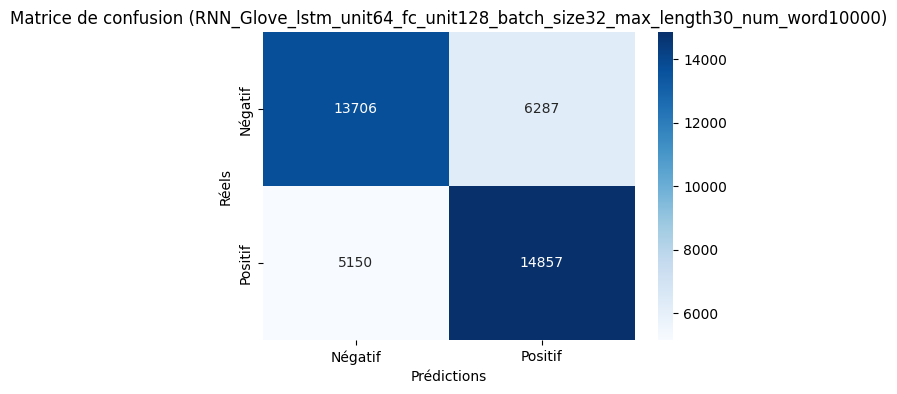

2025/03/08 06:17:17 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 06:17:31 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit128_batch_size32_max_length30_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 70s 17ms/step - accuracy: 0.6048 - loss: 1.9886 - val_accuracy: 0.6908 - val_loss: 0.9660 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 65s 16ms/step - accuracy: 0.6917 - loss: 0.8566 - val_accuracy: 0.6967 - val_loss: 0.6566 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 64s 16ms/step - accuracy: 0.7019 - loss: 0.6310 - val_accuracy: 0.7034 - val_loss: 0.5891 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 65s 16ms/step - accuracy: 0.7071 - loss: 0.5810 - val_accuracy: 0.7049 - val_loss: 0.5720 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 65s 16ms/step - accuracy: 0.7082 - loss: 0.5689 - val_accuracy: 0.7086 - val_loss: 0.5661 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

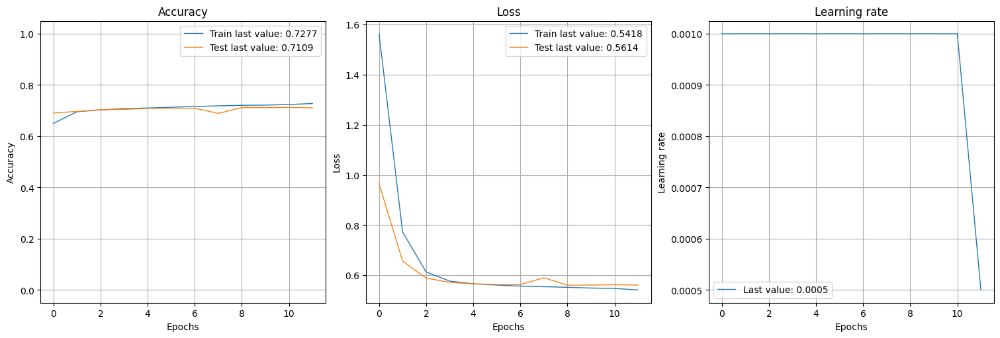

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


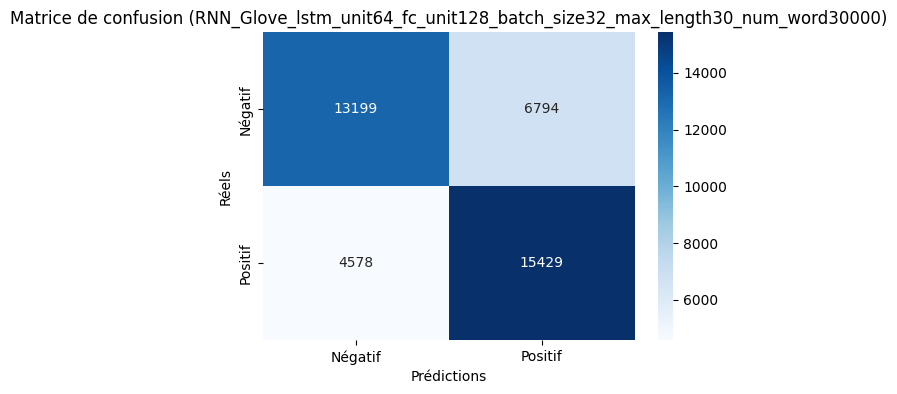

2025/03/08 06:31:38 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 06:31:52 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit128_batch_size32_max_length30_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 70s 17ms/step - accuracy: 0.5897 - loss: 1.9951 - val_accuracy: 0.6928 - val_loss: 0.9658 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 67s 17ms/step - accuracy: 0.6909 - loss: 0.8565 - val_accuracy: 0.7023 - val_loss: 0.6520 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 66s 16ms/step - accuracy: 0.7029 - loss: 0.6300 - val_accuracy: 0.7037 - val_loss: 0.5862 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 66s 17ms/step - accuracy: 0.7095 - loss: 0.5800 - val_accuracy: 0.7024 - val_loss: 0.5740 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 65s 16ms/step - accuracy: 0.7122 - loss: 0.5660 - val_accuracy: 0.7062 - val_loss: 0.5646 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━

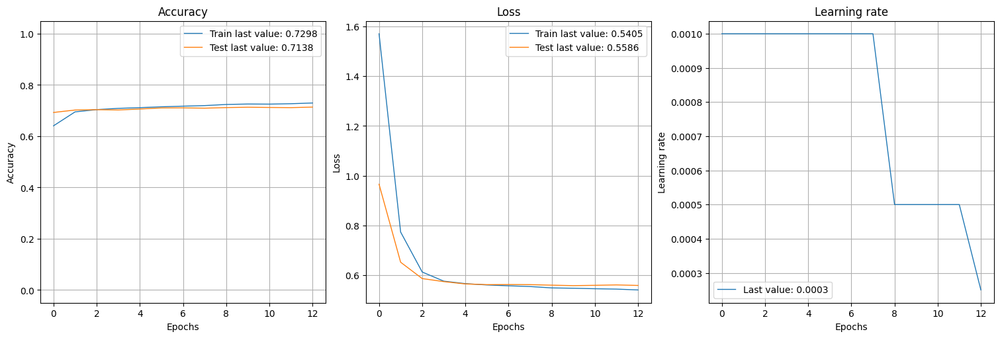

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


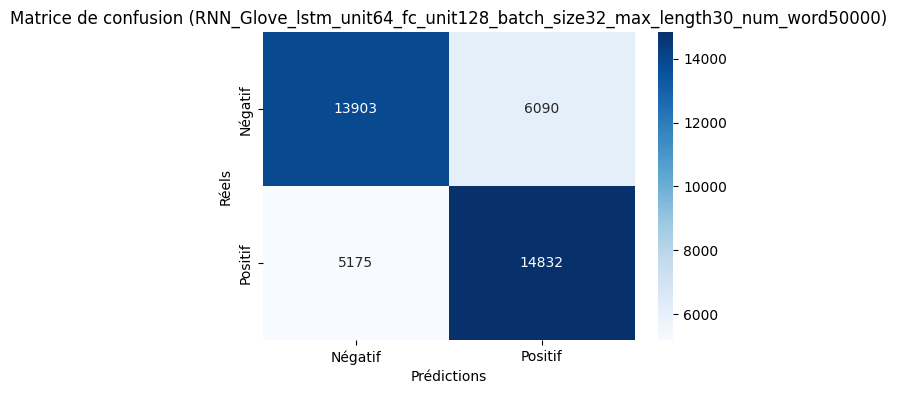

2025/03/08 06:47:13 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 06:47:27 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit32_batch_size32_max_length15_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 59s 14ms/step - accuracy: 0.5951 - loss: 1.8312 - val_accuracy: 0.6723 - val_loss: 0.9352 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 56s 14ms/step - accuracy: 0.6708 - loss: 0.8383 - val_accuracy: 0.6825 - val_loss: 0.6609 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 56s 14ms/step - accuracy: 0.6814 - loss: 0.6417 - val_accuracy: 0.6823 - val_loss: 0.6037 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 56s 14ms/step - accuracy: 0.6836 - loss: 0.6004 - val_accuracy: 0.6715 - val_loss: 0.5912 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 56s 14ms/step - accuracy: 0.6855 - loss: 0.5858 - val_accuracy: 0.6872 - val_loss: 0.5864 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

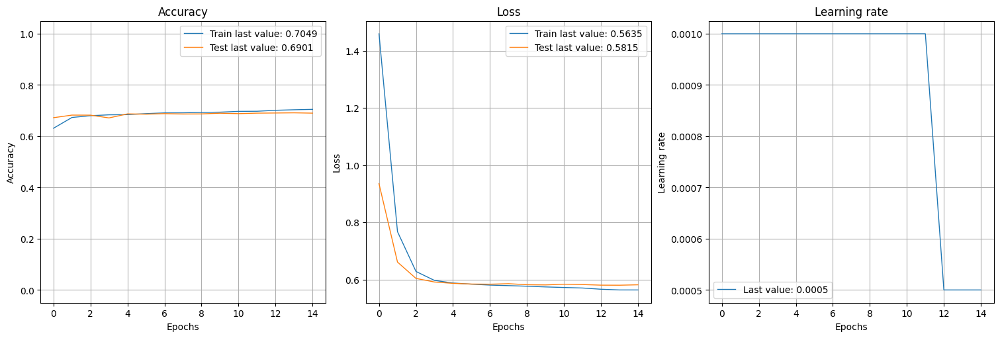

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


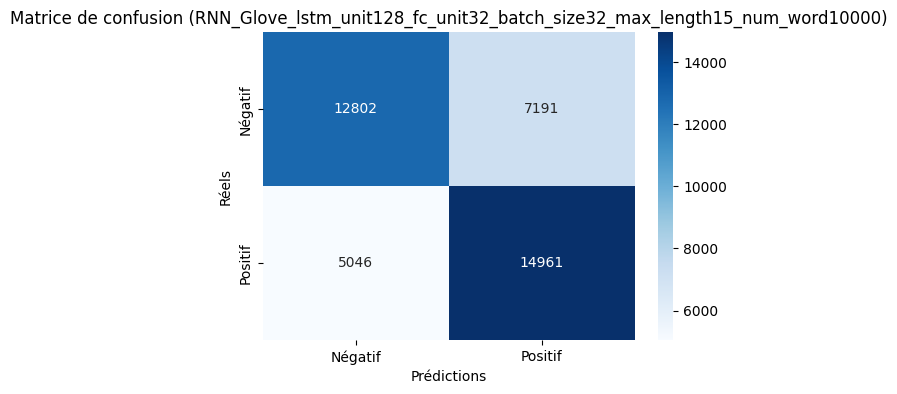

2025/03/08 07:02:36 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 07:02:49 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit32_batch_size32_max_length15_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 62s 15ms/step - accuracy: 0.5910 - loss: 1.8307 - val_accuracy: 0.6711 - val_loss: 0.9362 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 14ms/step - accuracy: 0.6704 - loss: 0.8409 - val_accuracy: 0.6787 - val_loss: 0.6642 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 14ms/step - accuracy: 0.6804 - loss: 0.6437 - val_accuracy: 0.6823 - val_loss: 0.6056 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 57s 14ms/step - accuracy: 0.6825 - loss: 0.5994 - val_accuracy: 0.6846 - val_loss: 0.5930 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 14ms/step - accuracy: 0.6863 - loss: 0.5867 - val_accuracy: 0.6857 - val_loss: 0.5886 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

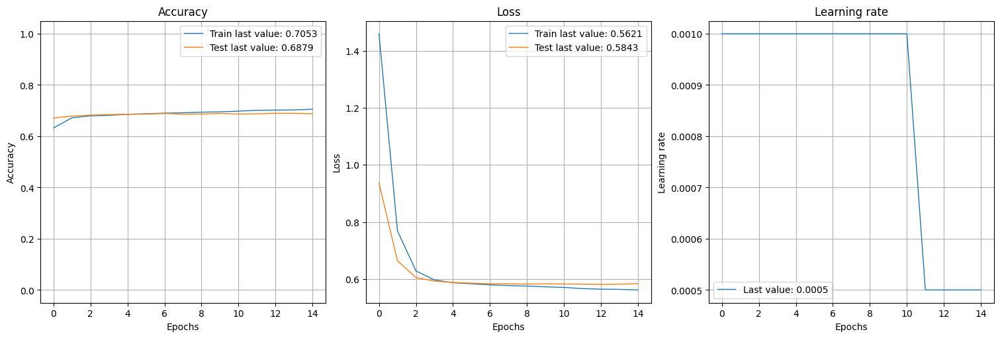

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


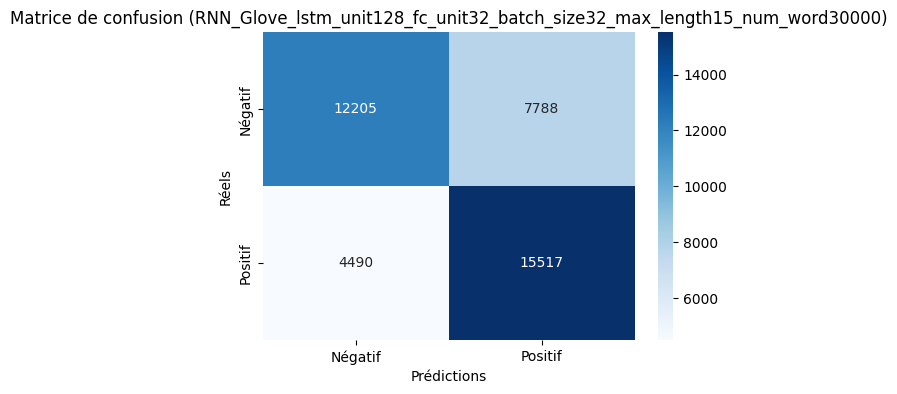

2025/03/08 07:18:30 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 07:18:47 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit32_batch_size32_max_length15_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 60s 14ms/step - accuracy: 0.5961 - loss: 1.8374 - val_accuracy: 0.6721 - val_loss: 0.9381 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 57s 14ms/step - accuracy: 0.6713 - loss: 0.8416 - val_accuracy: 0.6792 - val_loss: 0.6624 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 57s 14ms/step - accuracy: 0.6823 - loss: 0.6413 - val_accuracy: 0.6789 - val_loss: 0.6088 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 14ms/step - accuracy: 0.6838 - loss: 0.6005 - val_accuracy: 0.6826 - val_loss: 0.5969 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 14ms/step - accuracy: 0.6858 - loss: 0.5885 - val_accuracy: 0.6859 - val_loss: 0.5864 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━

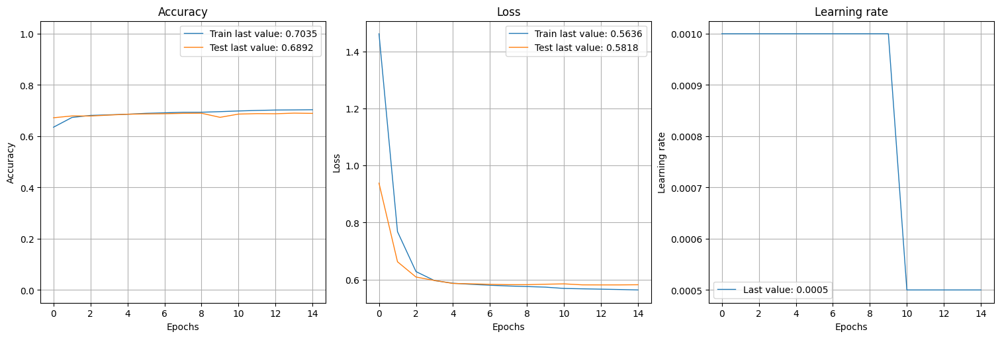

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


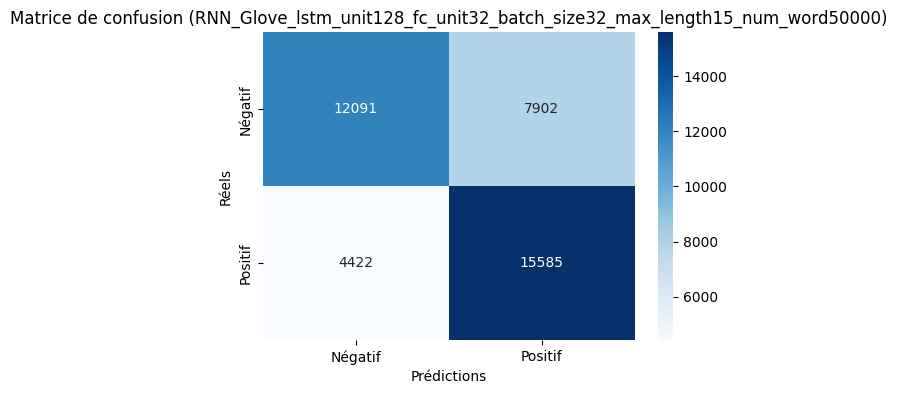

2025/03/08 07:34:13 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 07:34:26 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit32_batch_size32_max_length30_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 105s 26ms/step - accuracy: 0.6396 - loss: 1.8077 - val_accuracy: 0.6900 - val_loss: 0.9188 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 100s 25ms/step - accuracy: 0.6988 - loss: 0.8152 - val_accuracy: 0.7000 - val_loss: 0.6425 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 100s 25ms/step - accuracy: 0.7033 - loss: 0.6206 - val_accuracy: 0.7049 - val_loss: 0.5848 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 99s 25ms/step - accuracy: 0.7067 - loss: 0.5783 - val_accuracy: 0.7052 - val_loss: 0.5713 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 100s 25ms/step - accuracy: 0.7092 - loss: 0.5661 - val_accuracy: 0.7038 - val_loss: 0.5735 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━

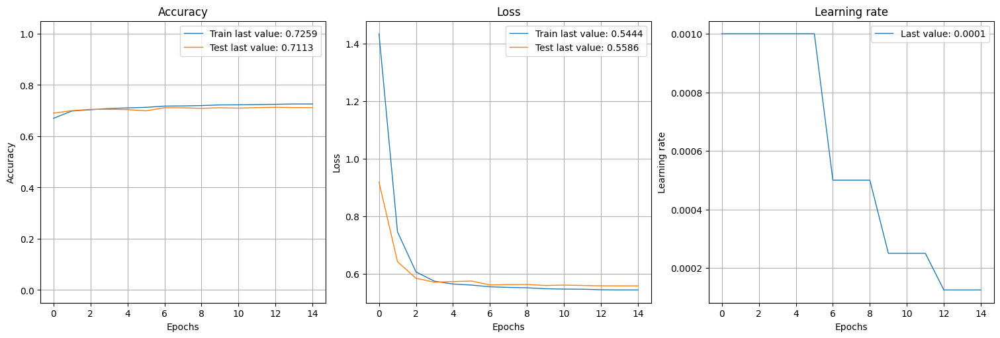

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step


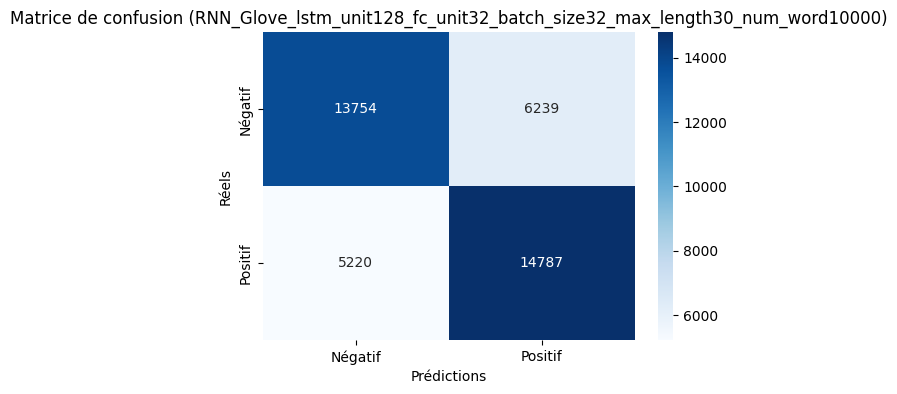

2025/03/08 08:00:50 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 08:01:03 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit32_batch_size32_max_length30_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 109s 27ms/step - accuracy: 0.6290 - loss: 1.8073 - val_accuracy: 0.6907 - val_loss: 0.9180 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 108s 27ms/step - accuracy: 0.6948 - loss: 0.8163 - val_accuracy: 0.7013 - val_loss: 0.6428 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 105s 26ms/step - accuracy: 0.7034 - loss: 0.6196 - val_accuracy: 0.7022 - val_loss: 0.5882 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 104s 26ms/step - accuracy: 0.7076 - loss: 0.5766 - val_accuracy: 0.7084 - val_loss: 0.5695 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 103s 26ms/step - accuracy: 0.7094 - loss: 0.5666 - val_accuracy: 0.7071 - val_loss: 0.5665 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━

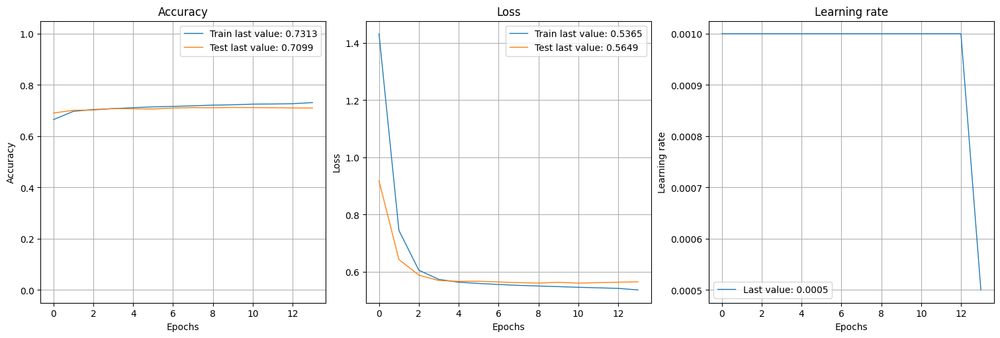

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step


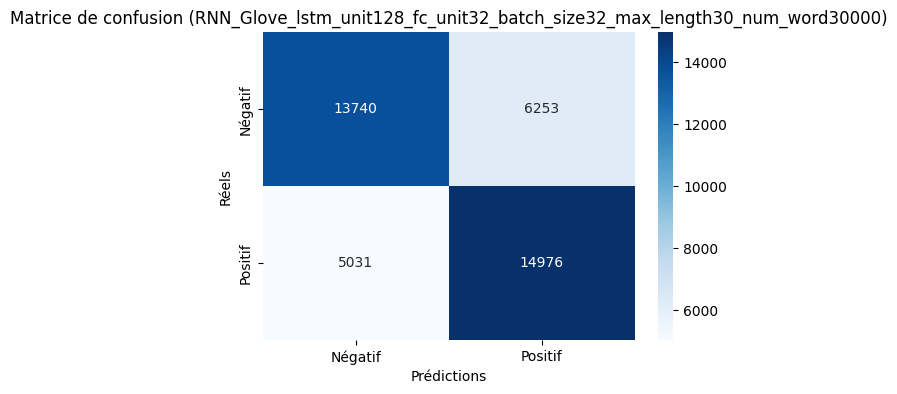

2025/03/08 08:26:40 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 08:27:00 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit32_batch_size32_max_length30_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 106s 26ms/step - accuracy: 0.6271 - loss: 1.8081 - val_accuracy: 0.6929 - val_loss: 0.9135 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 104s 26ms/step - accuracy: 0.6968 - loss: 0.8150 - val_accuracy: 0.6985 - val_loss: 0.6426 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 104s 26ms/step - accuracy: 0.7051 - loss: 0.6191 - val_accuracy: 0.7046 - val_loss: 0.5834 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 102s 25ms/step - accuracy: 0.7083 - loss: 0.5771 - val_accuracy: 0.7036 - val_loss: 0.5725 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 102s 26ms/step - accuracy: 0.7133 - loss: 0.5626 - val_accuracy: 0.7062 - val_loss: 0.5675 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━

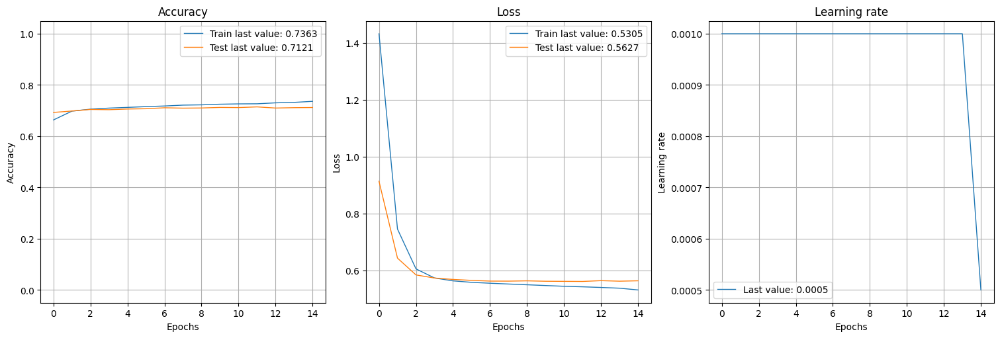

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step


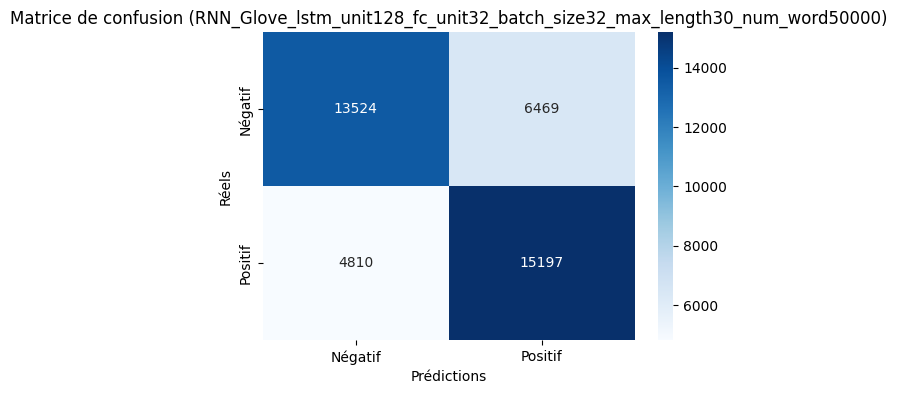

2025/03/08 08:53:53 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 08:54:12 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit64_batch_size32_max_length15_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 62s 15ms/step - accuracy: 0.5939 - loss: 2.0735 - val_accuracy: 0.6724 - val_loss: 1.0055 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 59s 15ms/step - accuracy: 0.6673 - loss: 0.8911 - val_accuracy: 0.6796 - val_loss: 0.6777 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 15ms/step - accuracy: 0.6770 - loss: 0.6544 - val_accuracy: 0.6822 - val_loss: 0.6088 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 14ms/step - accuracy: 0.6806 - loss: 0.6059 - val_accuracy: 0.6840 - val_loss: 0.5934 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 15ms/step - accuracy: 0.6870 - loss: 0.5882 - val_accuracy: 0.6856 - val_loss: 0.5875 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

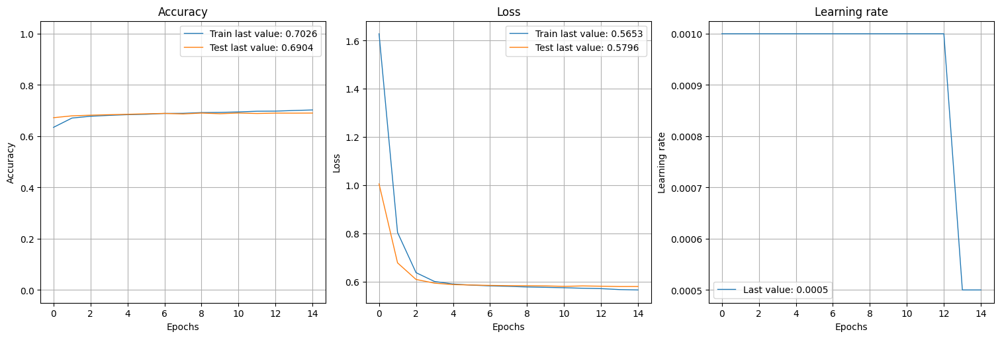

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


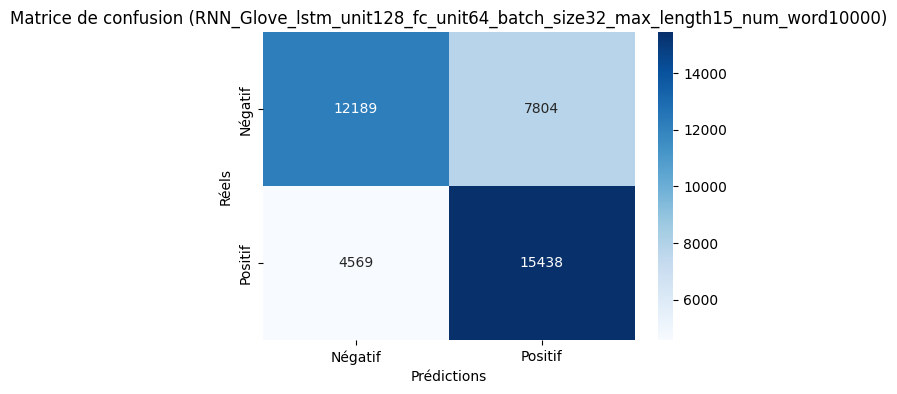

2025/03/08 09:10:04 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 09:10:23 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit64_batch_size32_max_length15_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 61s 14ms/step - accuracy: 0.6107 - loss: 2.0685 - val_accuracy: 0.6745 - val_loss: 1.0032 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 15ms/step - accuracy: 0.6730 - loss: 0.8865 - val_accuracy: 0.6812 - val_loss: 0.6751 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 15ms/step - accuracy: 0.6790 - loss: 0.6534 - val_accuracy: 0.6844 - val_loss: 0.6063 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 57s 14ms/step - accuracy: 0.6824 - loss: 0.6017 - val_accuracy: 0.6861 - val_loss: 0.5911 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 15ms/step - accuracy: 0.6844 - loss: 0.5882 - val_accuracy: 0.6871 - val_loss: 0.5857 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━━

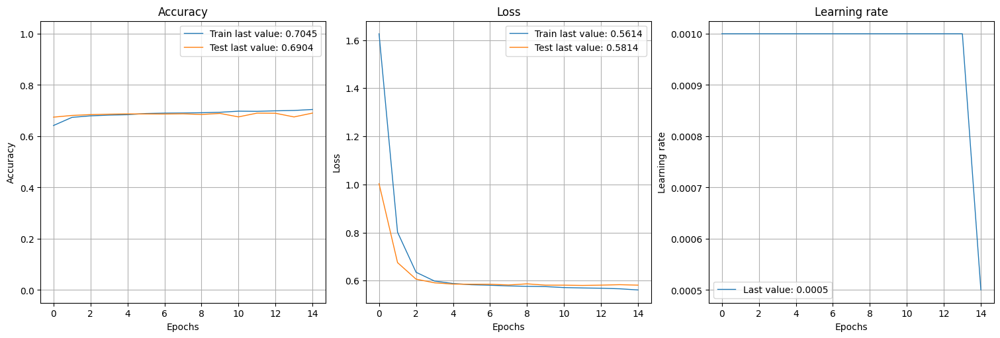

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


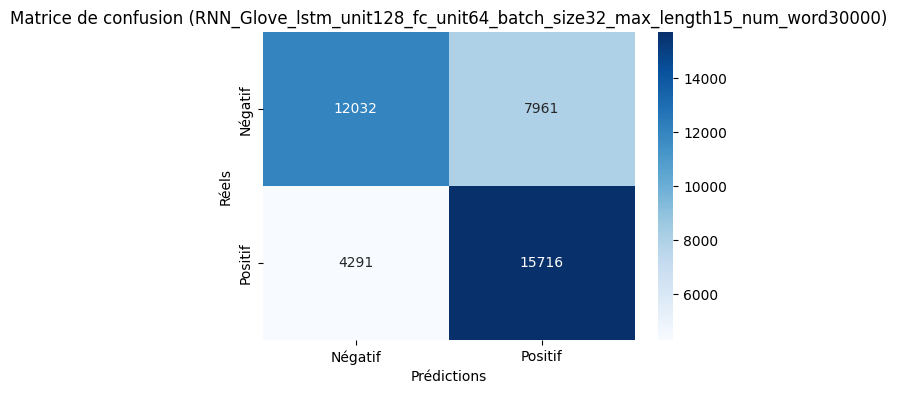

2025/03/08 09:25:58 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 09:26:17 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit64_batch_size32_max_length15_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 63s 15ms/step - accuracy: 0.5987 - loss: 2.0650 - val_accuracy: 0.6745 - val_loss: 1.0010 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 60s 15ms/step - accuracy: 0.6697 - loss: 0.8897 - val_accuracy: 0.6798 - val_loss: 0.6756 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 60s 15ms/step - accuracy: 0.6790 - loss: 0.6519 - val_accuracy: 0.6838 - val_loss: 0.6072 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 60s 15ms/step - accuracy: 0.6857 - loss: 0.6019 - val_accuracy: 0.6822 - val_loss: 0.5941 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 60s 15ms/step - accuracy: 0.6860 - loss: 0.5898 - val_accuracy: 0.6852 - val_loss: 0.5874 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━

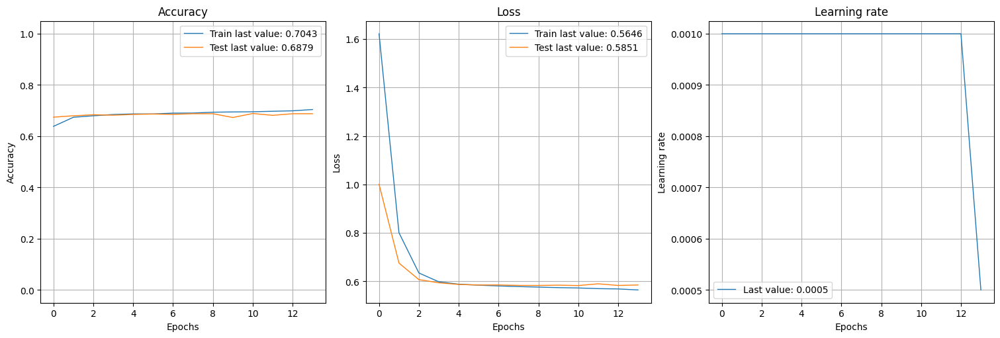

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 9s 7ms/step


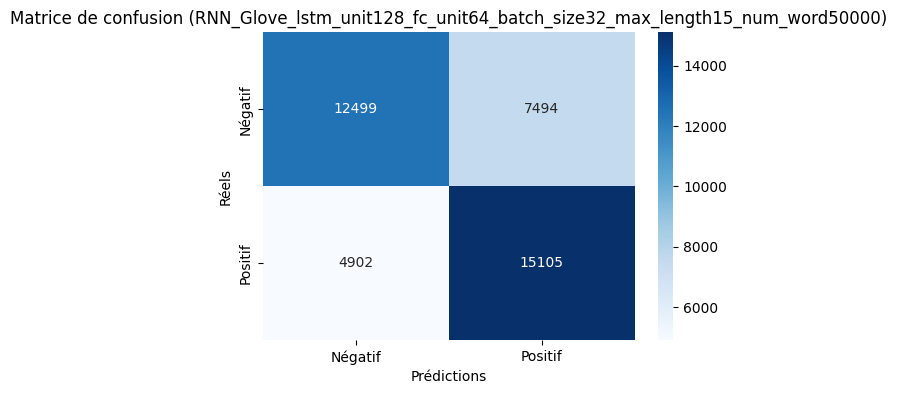

2025/03/08 09:41:26 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 09:41:44 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit64_batch_size32_max_length30_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 108s 26ms/step - accuracy: 0.6126 - loss: 2.0537 - val_accuracy: 0.6933 - val_loss: 0.9843 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 106s 26ms/step - accuracy: 0.6911 - loss: 0.8693 - val_accuracy: 0.6977 - val_loss: 0.6584 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 106s 26ms/step - accuracy: 0.6999 - loss: 0.6336 - val_accuracy: 0.7021 - val_loss: 0.5893 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 104s 26ms/step - accuracy: 0.7064 - loss: 0.5804 - val_accuracy: 0.7046 - val_loss: 0.5724 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 105s 26ms/step - accuracy: 0.7090 - loss: 0.5681 - val_accuracy: 0.7063 - val_loss: 0.5664 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━

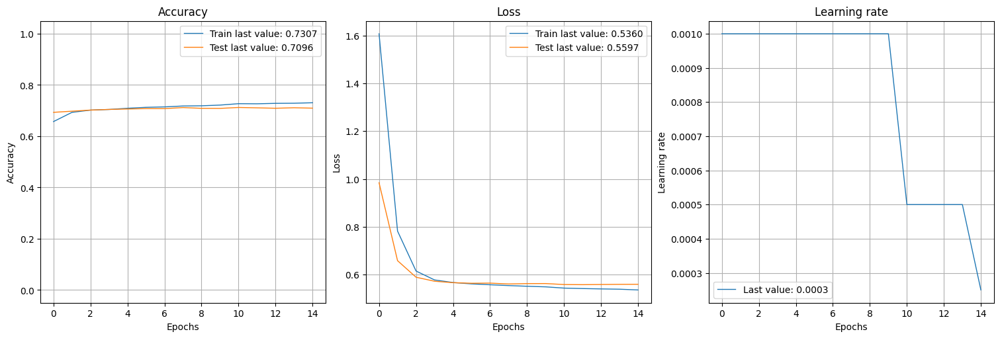

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step


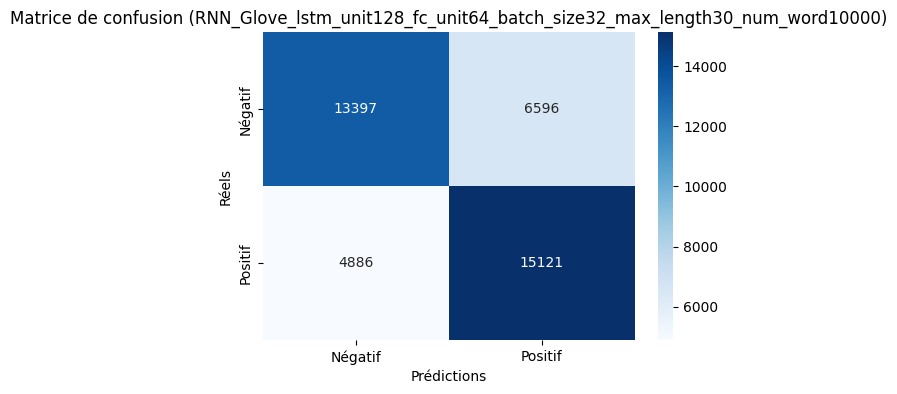

2025/03/08 10:09:22 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 10:09:41 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit64_batch_size32_max_length30_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 106s 26ms/step - accuracy: 0.6194 - loss: 2.0424 - val_accuracy: 0.6960 - val_loss: 0.9795 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 104s 26ms/step - accuracy: 0.6960 - loss: 0.8638 - val_accuracy: 0.7008 - val_loss: 0.6547 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 102s 25ms/step - accuracy: 0.7023 - loss: 0.6313 - val_accuracy: 0.7059 - val_loss: 0.5858 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 105s 26ms/step - accuracy: 0.7082 - loss: 0.5781 - val_accuracy: 0.7077 - val_loss: 0.5705 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 103s 26ms/step - accuracy: 0.7139 - loss: 0.5648 - val_accuracy: 0.7101 - val_loss: 0.5645 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━

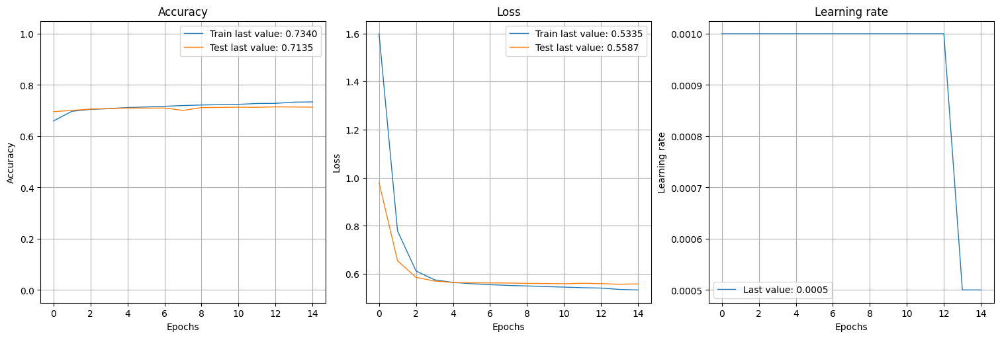

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 15s 12ms/step


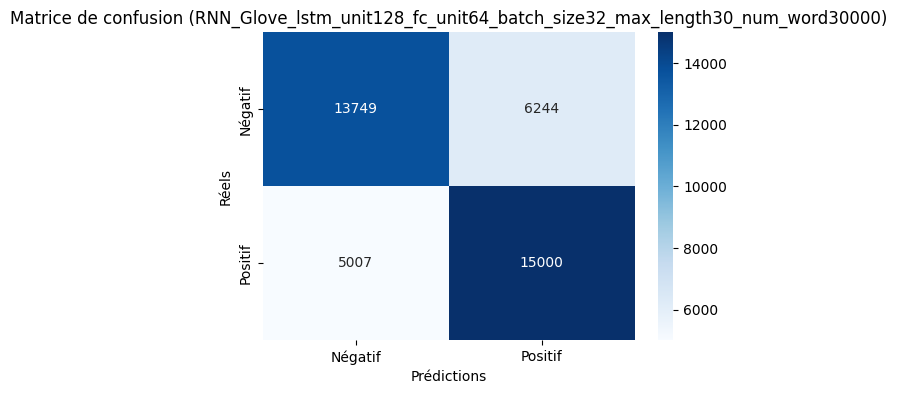

2025/03/08 10:36:42 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 10:37:00 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit64_batch_size32_max_length30_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 120s 29ms/step - accuracy: 0.6283 - loss: 2.0587 - val_accuracy: 0.6936 - val_loss: 0.9838 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 106s 26ms/step - accuracy: 0.6968 - loss: 0.8646 - val_accuracy: 0.7029 - val_loss: 0.6550 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 107s 27ms/step - accuracy: 0.7068 - loss: 0.6286 - val_accuracy: 0.7052 - val_loss: 0.5858 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 107s 27ms/step - accuracy: 0.7083 - loss: 0.5780 - val_accuracy: 0.7090 - val_loss: 0.5699 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 105s 26ms/step - accuracy: 0.7123 - loss: 0.5639 - val_accuracy: 0.7110 - val_loss: 0.5647 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━

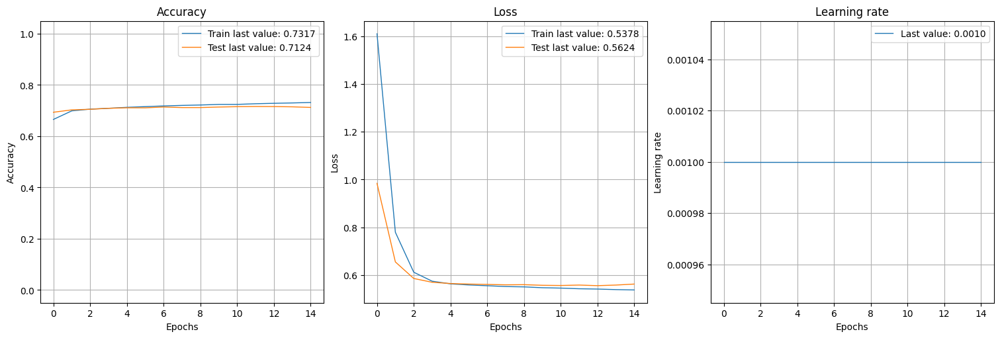

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 11ms/step


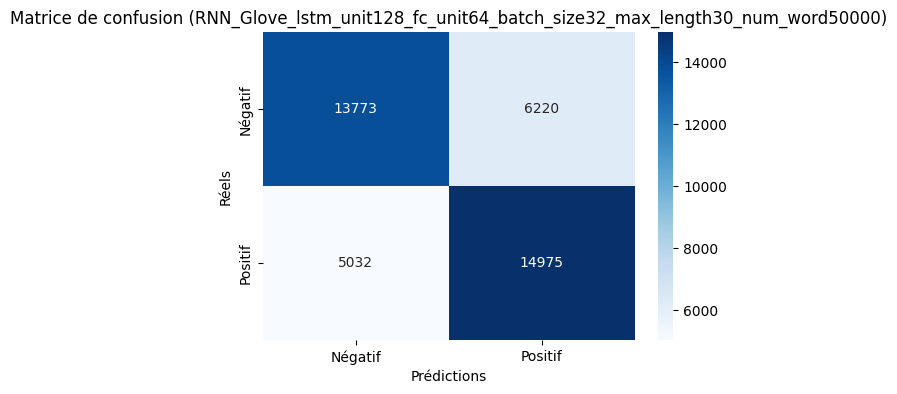

2025/03/08 11:04:55 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 11:05:17 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit128_batch_size32_max_length15_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 60s 14ms/step - accuracy: 0.5962 - loss: 2.3722 - val_accuracy: 0.6727 - val_loss: 1.0916 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 57s 14ms/step - accuracy: 0.6699 - loss: 0.9495 - val_accuracy: 0.6763 - val_loss: 0.6968 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 57s 14ms/step - accuracy: 0.6776 - loss: 0.6649 - val_accuracy: 0.6832 - val_loss: 0.6122 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 56s 14ms/step - accuracy: 0.6827 - loss: 0.6042 - val_accuracy: 0.6844 - val_loss: 0.5929 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 14ms/step - accuracy: 0.6863 - loss: 0.5896 - val_accuracy: 0.6834 - val_loss: 0.5894 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━

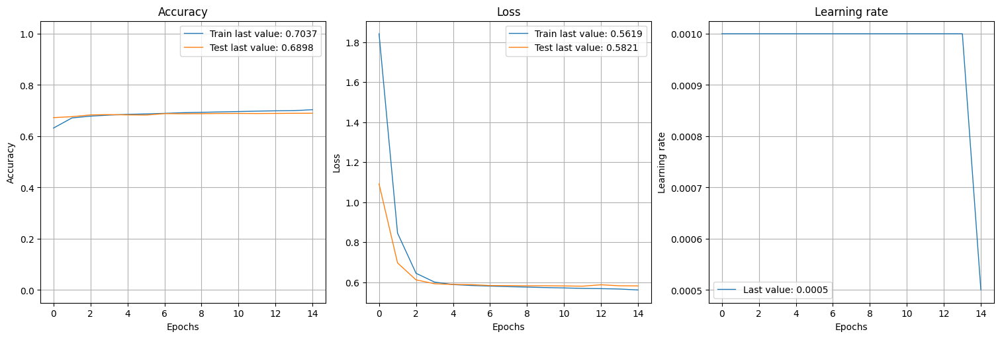

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


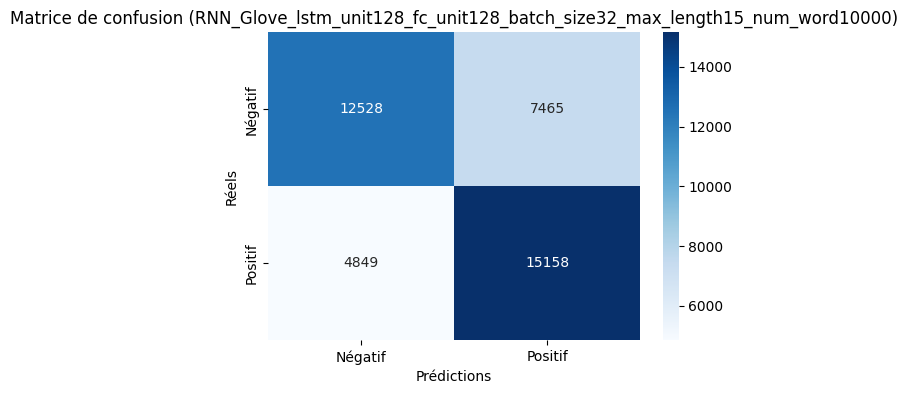

2025/03/08 11:20:06 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 11:20:19 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit128_batch_size32_max_length15_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 61s 15ms/step - accuracy: 0.5903 - loss: 2.3903 - val_accuracy: 0.6672 - val_loss: 1.0996 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 61s 15ms/step - accuracy: 0.6702 - loss: 0.9546 - val_accuracy: 0.6766 - val_loss: 0.6978 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 15ms/step - accuracy: 0.6779 - loss: 0.6663 - val_accuracy: 0.6827 - val_loss: 0.6124 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 59s 15ms/step - accuracy: 0.6838 - loss: 0.6064 - val_accuracy: 0.6837 - val_loss: 0.5936 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 14ms/step - accuracy: 0.6874 - loss: 0.5891 - val_accuracy: 0.6857 - val_loss: 0.5873 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━━

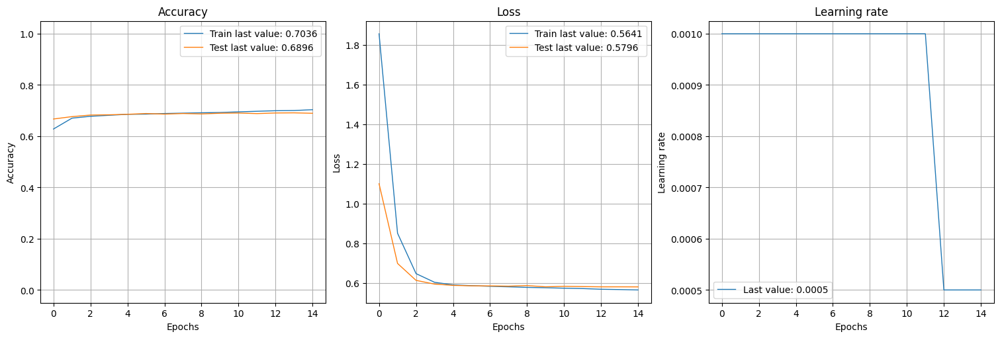

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


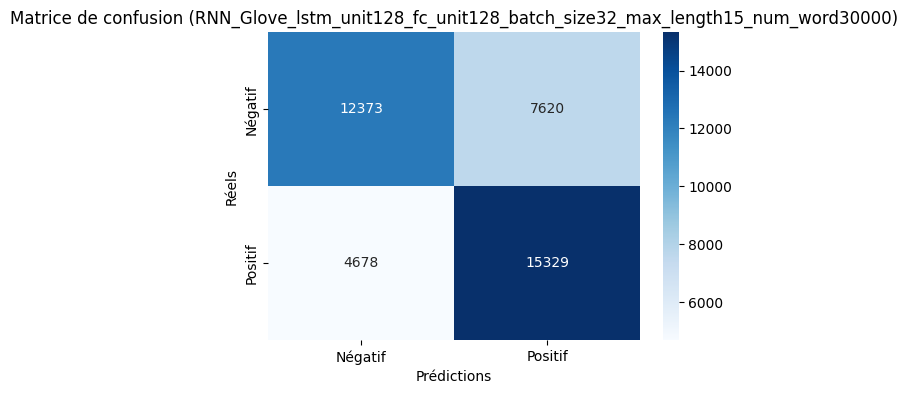

2025/03/08 11:35:48 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 11:36:00 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit128_batch_size32_max_length15_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 58s 14ms/step - accuracy: 0.5917 - loss: 2.3720 - val_accuracy: 0.6707 - val_loss: 1.0931 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 56s 14ms/step - accuracy: 0.6709 - loss: 0.9486 - val_accuracy: 0.6722 - val_loss: 0.6995 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 56s 14ms/step - accuracy: 0.6777 - loss: 0.6669 - val_accuracy: 0.6828 - val_loss: 0.6120 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 56s 14ms/step - accuracy: 0.6836 - loss: 0.6037 - val_accuracy: 0.6823 - val_loss: 0.5935 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 56s 14ms/step - accuracy: 0.6864 - loss: 0.5893 - val_accuracy: 0.6862 - val_loss: 0.5890 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━

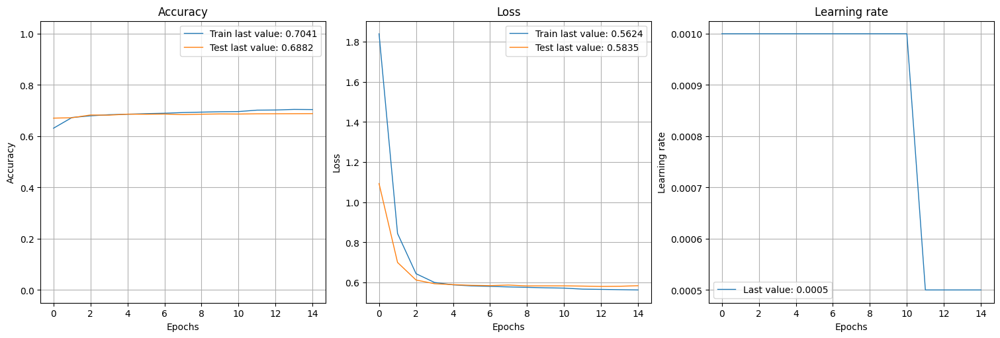

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


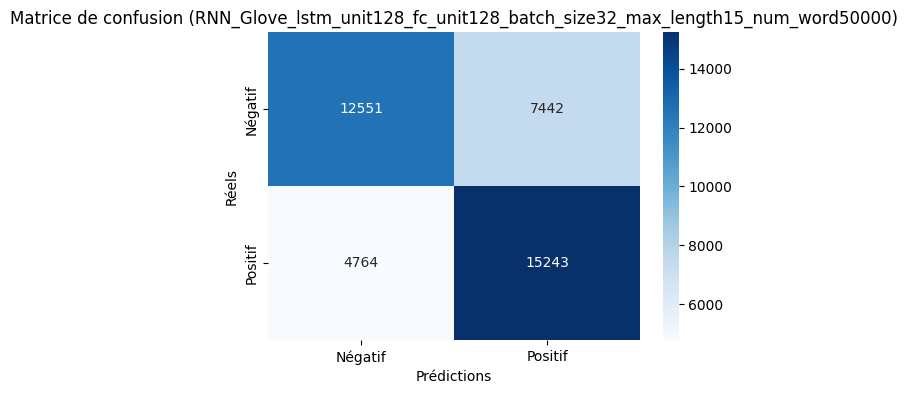

2025/03/08 11:50:55 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 11:51:08 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit128_batch_size32_max_length30_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 101s 25ms/step - accuracy: 0.6095 - loss: 2.3760 - val_accuracy: 0.6899 - val_loss: 1.0764 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 101s 25ms/step - accuracy: 0.6914 - loss: 0.9322 - val_accuracy: 0.6982 - val_loss: 0.6760 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 100s 25ms/step - accuracy: 0.7020 - loss: 0.6446 - val_accuracy: 0.7018 - val_loss: 0.5951 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 100s 25ms/step - accuracy: 0.7069 - loss: 0.5797 - val_accuracy: 0.7050 - val_loss: 0.5718 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 100s 25ms/step - accuracy: 0.7083 - loss: 0.5682 - val_accuracy: 0.7072 - val_loss: 0.5663 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━

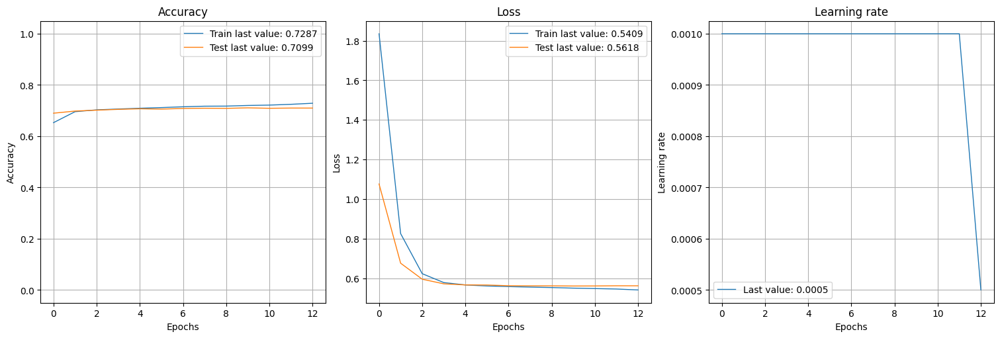

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step


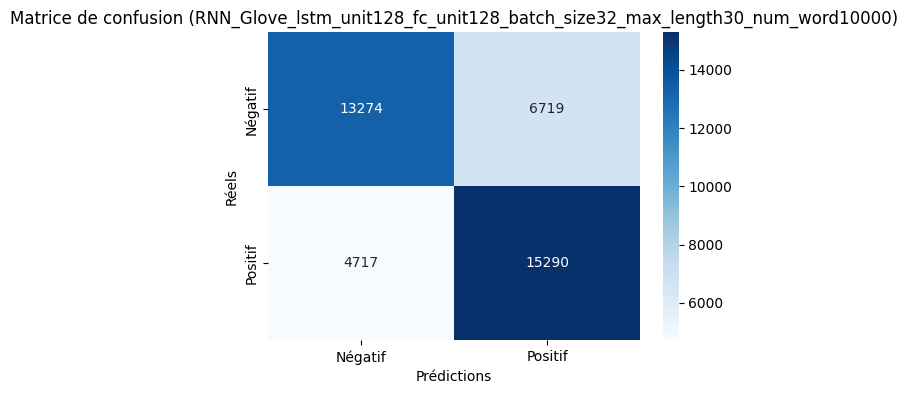

2025/03/08 12:13:51 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 12:14:06 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit128_batch_size32_max_length30_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 102s 25ms/step - accuracy: 0.6216 - loss: 2.3582 - val_accuracy: 0.6927 - val_loss: 1.0705 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 99s 25ms/step - accuracy: 0.6943 - loss: 0.9289 - val_accuracy: 0.6999 - val_loss: 0.6749 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 99s 25ms/step - accuracy: 0.7039 - loss: 0.6434 - val_accuracy: 0.7032 - val_loss: 0.5915 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 98s 24ms/step - accuracy: 0.7090 - loss: 0.5805 - val_accuracy: 0.7055 - val_loss: 0.5722 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 98s 24ms/step - accuracy: 0.7105 - loss: 0.5675 - val_accuracy: 0.6954 - val_loss: 0.5702 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━

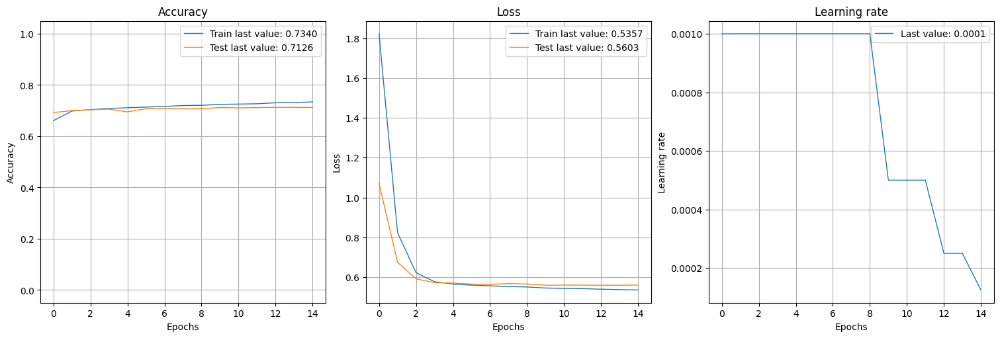

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step


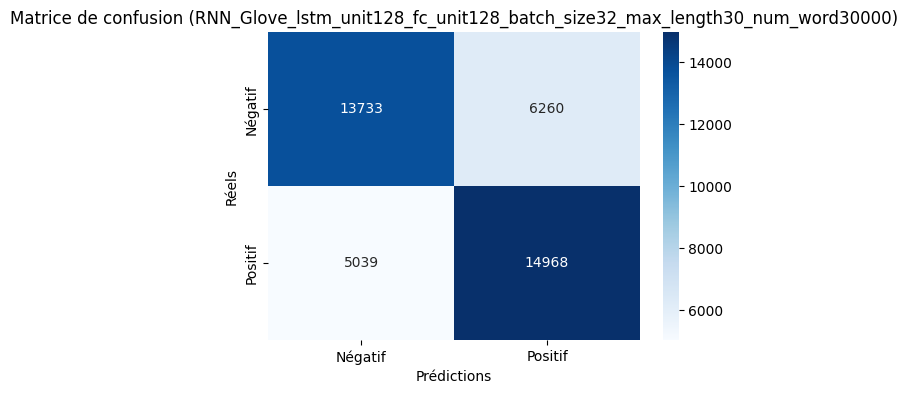

2025/03/08 12:39:33 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 12:39:45 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit128_batch_size32_max_length30_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 99s 24ms/step - accuracy: 0.6262 - loss: 2.3525 - val_accuracy: 0.6923 - val_loss: 1.0718 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 97s 24ms/step - accuracy: 0.6983 - loss: 0.9238 - val_accuracy: 0.7016 - val_loss: 0.6735 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 96s 24ms/step - accuracy: 0.7036 - loss: 0.6414 - val_accuracy: 0.7063 - val_loss: 0.5905 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 98s 24ms/step - accuracy: 0.7070 - loss: 0.5812 - val_accuracy: 0.7079 - val_loss: 0.5725 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 98s 25ms/step - accuracy: 0.7131 - loss: 0.5648 - val_accuracy: 0.7104 - val_loss: 0.5652 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━

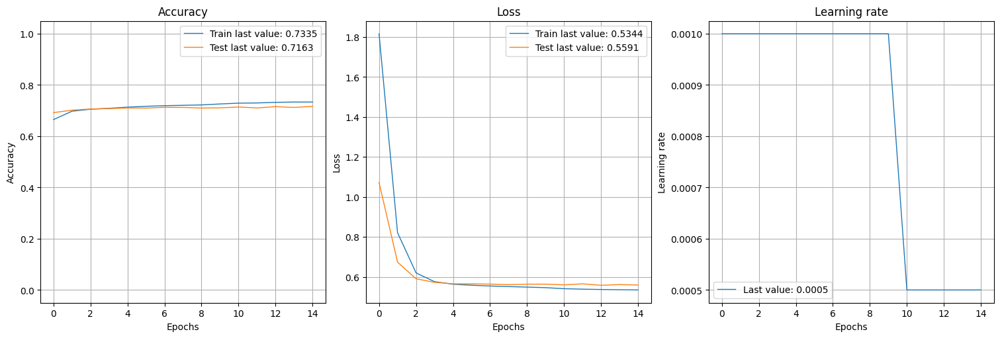

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step


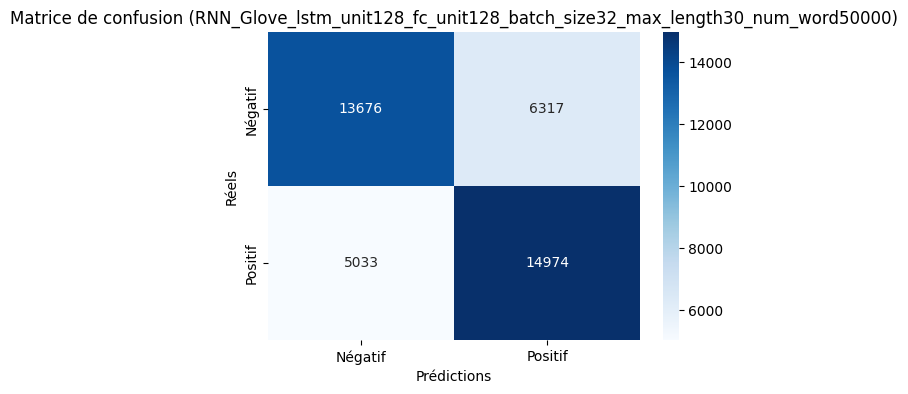

2025/03/08 13:04:51 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 13:05:03 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit32_batch_size64_max_length15_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 21s 10ms/step - accuracy: 0.5639 - loss: 1.6584 - val_accuracy: 0.6526 - val_loss: 1.1538 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 20s 10ms/step - accuracy: 0.6514 - loss: 1.0656 - val_accuracy: 0.6704 - val_loss: 0.8433 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 20s 10ms/step - accuracy: 0.6665 - loss: 0.8066 - val_accuracy: 0.6733 - val_loss: 0.7087 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 10ms/step - accuracy: 0.6746 - loss: 0.6922 - val_accuracy: 0.6787 - val_loss: 0.6440 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 10ms/step - accuracy: 0.6777 - loss: 0.6377 - val_accuracy: 0.6816 - val_loss: 0.6155 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

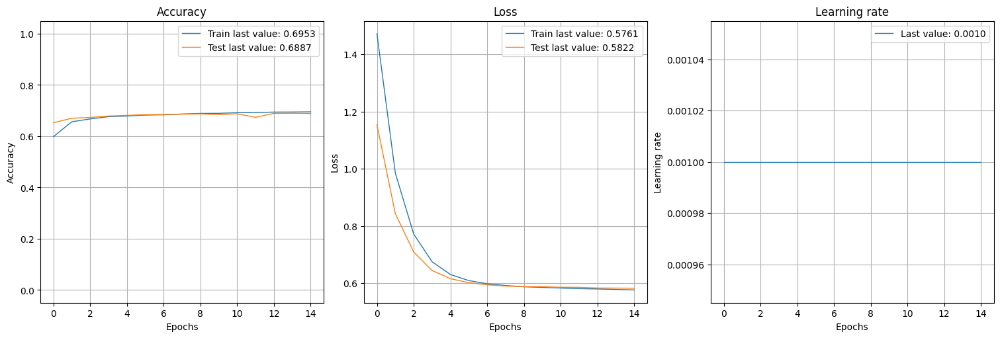

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


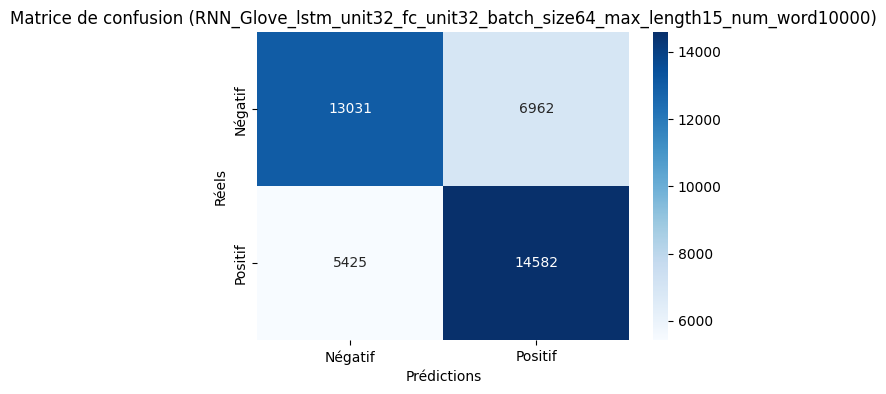

2025/03/08 13:10:51 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 13:11:08 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit32_batch_size64_max_length15_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 22s 10ms/step - accuracy: 0.5542 - loss: 1.6587 - val_accuracy: 0.6513 - val_loss: 1.1537 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6512 - loss: 1.0644 - val_accuracy: 0.6703 - val_loss: 0.8430 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6705 - loss: 0.8054 - val_accuracy: 0.6758 - val_loss: 0.7069 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 10ms/step - accuracy: 0.6784 - loss: 0.6897 - val_accuracy: 0.6789 - val_loss: 0.6447 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 10ms/step - accuracy: 0.6811 - loss: 0.6371 - val_accuracy: 0.6801 - val_loss: 0.6160 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━

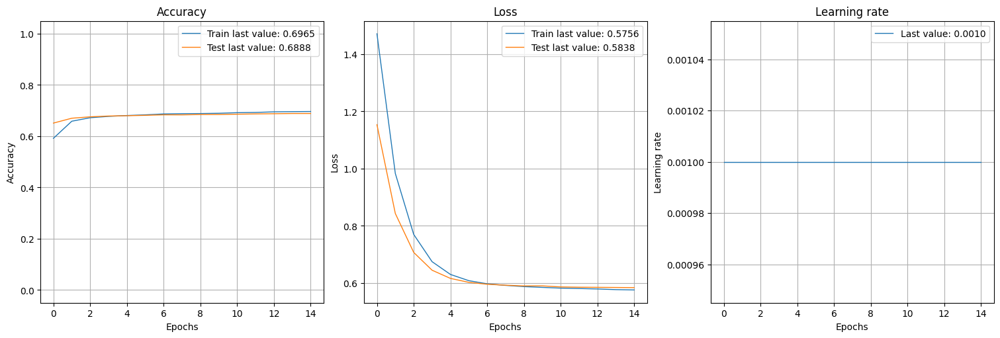

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


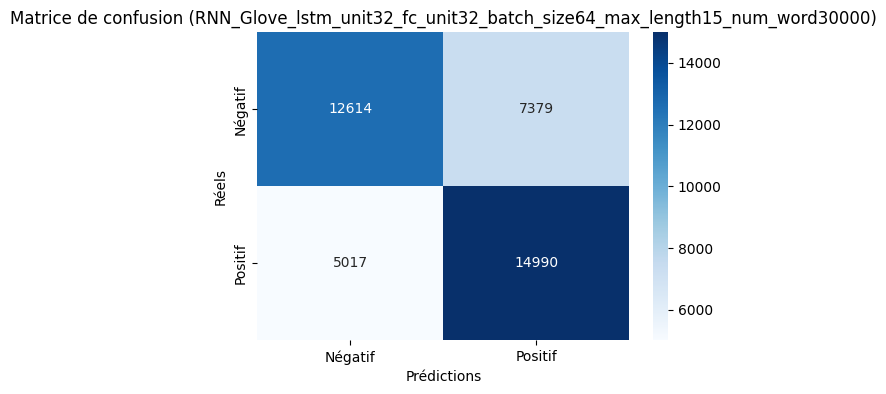

2025/03/08 13:16:45 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 13:16:58 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit32_batch_size64_max_length15_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 22s 10ms/step - accuracy: 0.5630 - loss: 1.6573 - val_accuracy: 0.6543 - val_loss: 1.1507 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6532 - loss: 1.0624 - val_accuracy: 0.6740 - val_loss: 0.8389 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6723 - loss: 0.8035 - val_accuracy: 0.6644 - val_loss: 0.7051 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 20s 10ms/step - accuracy: 0.6777 - loss: 0.6893 - val_accuracy: 0.6829 - val_loss: 0.6415 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 10ms/step - accuracy: 0.6850 - loss: 0.6340 - val_accuracy: 0.6834 - val_loss: 0.6137 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━

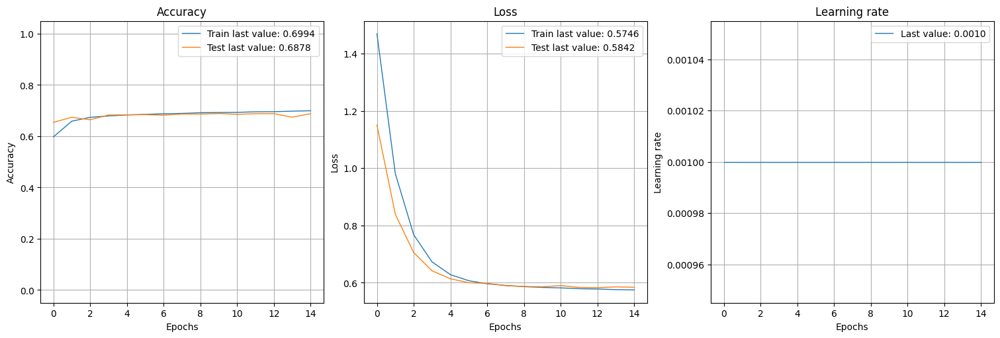

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


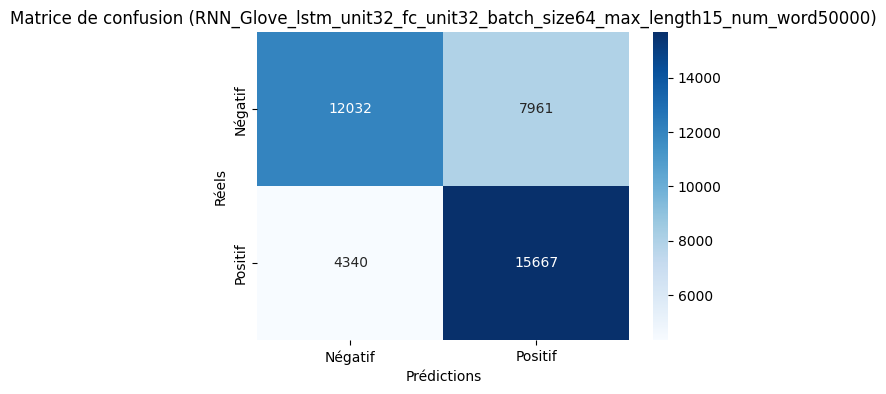

2025/03/08 13:22:33 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 13:22:45 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit32_batch_size64_max_length30_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 14ms/step - accuracy: 0.5636 - loss: 1.6425 - val_accuracy: 0.6708 - val_loss: 1.1253 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 15ms/step - accuracy: 0.6745 - loss: 1.0381 - val_accuracy: 0.6909 - val_loss: 0.8182 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.6926 - loss: 0.7793 - val_accuracy: 0.6974 - val_loss: 0.6834 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 14ms/step - accuracy: 0.7024 - loss: 0.6633 - val_accuracy: 0.7001 - val_loss: 0.6233 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.7057 - loss: 0.6123 - val_accuracy: 0.7013 - val_loss: 0.5952 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

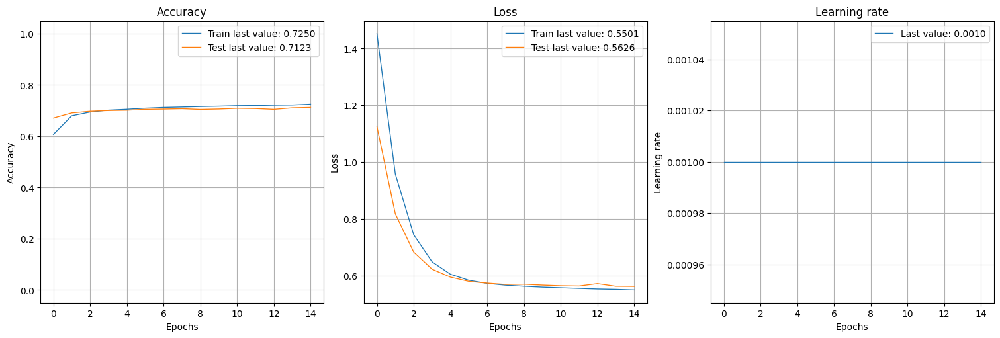

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


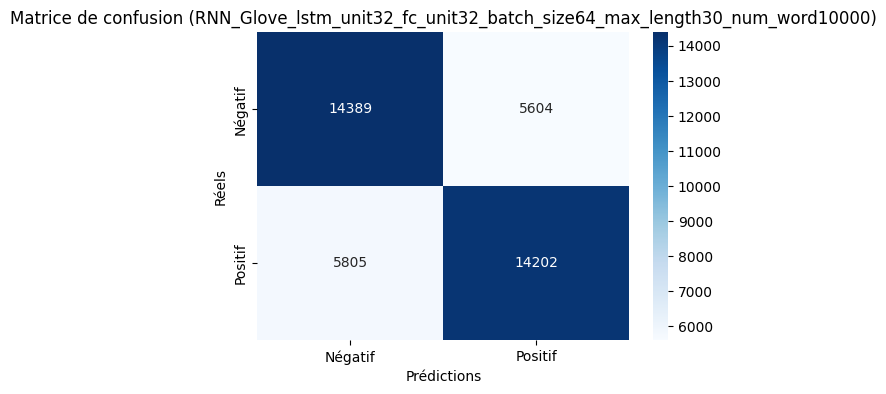

2025/03/08 13:30:48 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 13:31:00 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit32_batch_size64_max_length30_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 14ms/step - accuracy: 0.5619 - loss: 1.6496 - val_accuracy: 0.6777 - val_loss: 1.1325 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 27s 14ms/step - accuracy: 0.6721 - loss: 1.0487 - val_accuracy: 0.6943 - val_loss: 0.8195 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.6925 - loss: 0.7843 - val_accuracy: 0.6992 - val_loss: 0.6829 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.7002 - loss: 0.6677 - val_accuracy: 0.7028 - val_loss: 0.6219 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.7032 - loss: 0.6165 - val_accuracy: 0.7016 - val_loss: 0.5973 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

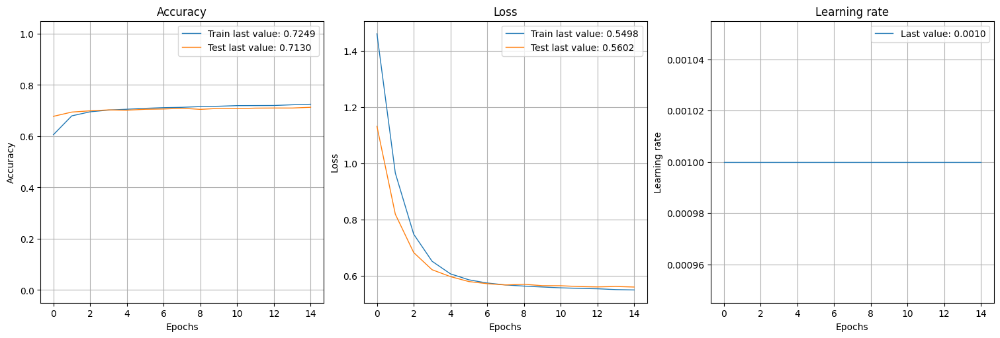

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step


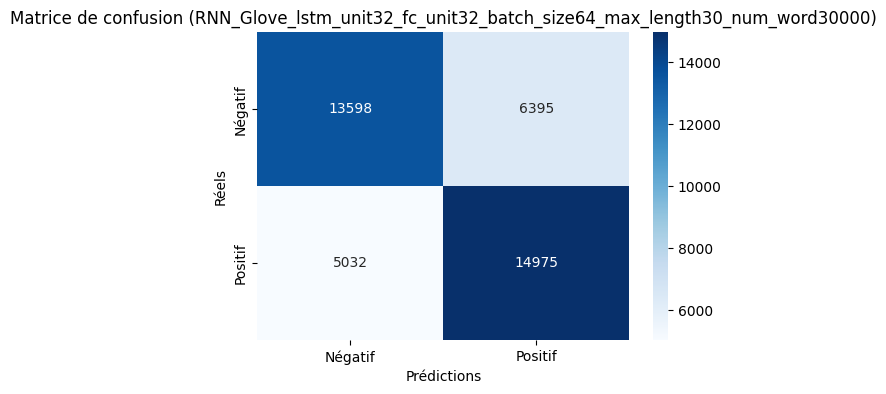

2025/03/08 13:38:58 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 13:39:10 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit32_batch_size64_max_length30_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 15ms/step - accuracy: 0.5622 - loss: 1.6549 - val_accuracy: 0.6729 - val_loss: 1.1286 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 14ms/step - accuracy: 0.6714 - loss: 1.0446 - val_accuracy: 0.6900 - val_loss: 0.8181 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.6940 - loss: 0.7809 - val_accuracy: 0.6914 - val_loss: 0.6877 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.7013 - loss: 0.6642 - val_accuracy: 0.7022 - val_loss: 0.6207 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.7060 - loss: 0.6115 - val_accuracy: 0.7045 - val_loss: 0.5924 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

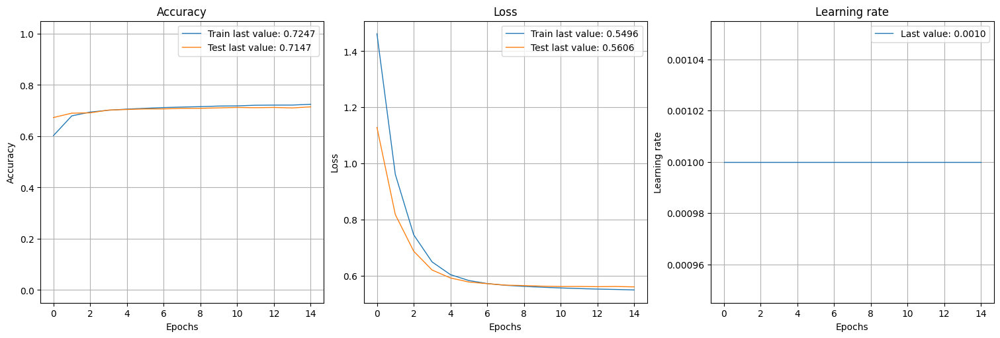

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


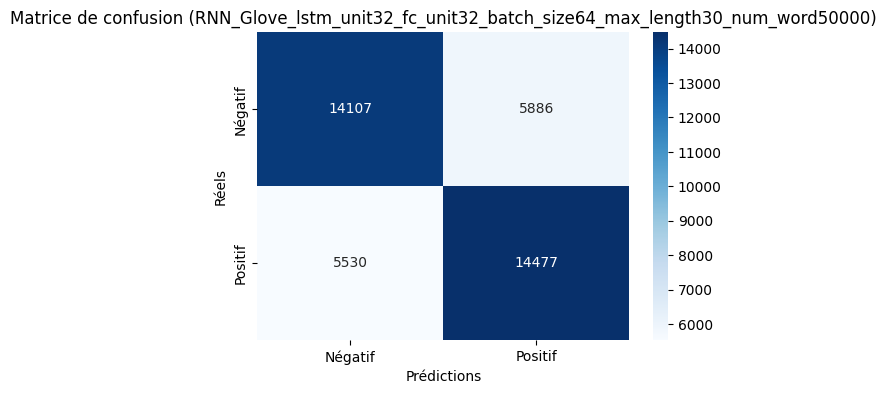

2025/03/08 13:47:11 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 13:47:27 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit64_batch_size64_max_length15_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 22s 10ms/step - accuracy: 0.5527 - loss: 1.7403 - val_accuracy: 0.6500 - val_loss: 1.2030 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 10ms/step - accuracy: 0.6472 - loss: 1.1051 - val_accuracy: 0.6693 - val_loss: 0.8628 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 20s 10ms/step - accuracy: 0.6657 - loss: 0.8250 - val_accuracy: 0.6748 - val_loss: 0.7149 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 10ms/step - accuracy: 0.6769 - loss: 0.6961 - val_accuracy: 0.6783 - val_loss: 0.6474 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6806 - loss: 0.6408 - val_accuracy: 0.6798 - val_loss: 0.6178 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━

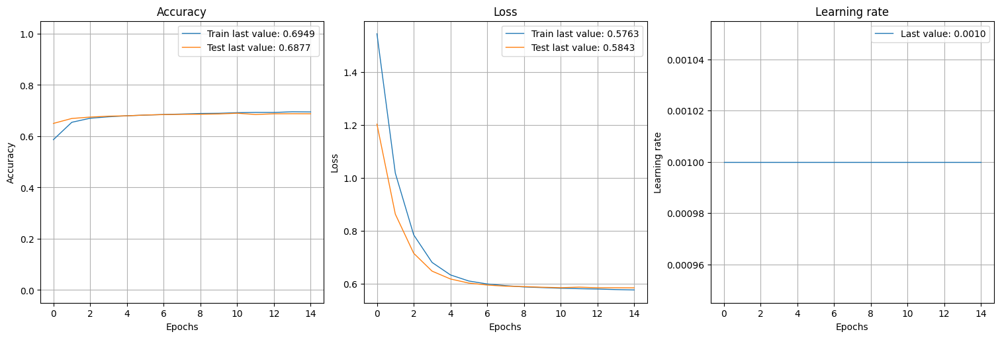

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


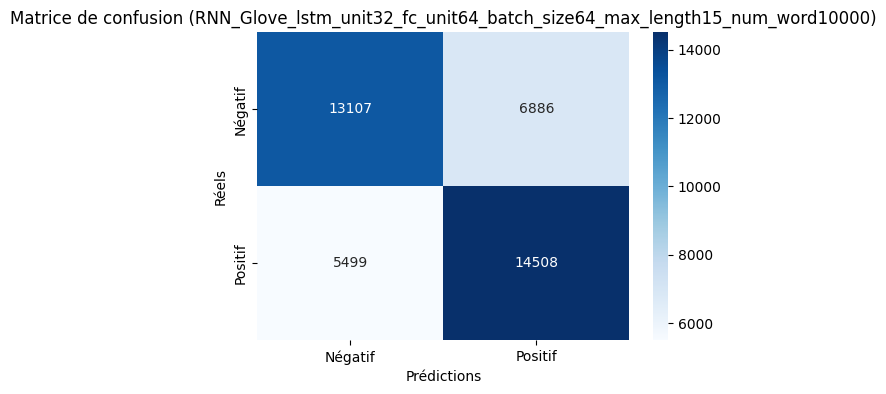

2025/03/08 13:53:04 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 13:53:16 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit64_batch_size64_max_length15_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 22s 10ms/step - accuracy: 0.5530 - loss: 1.7694 - val_accuracy: 0.6476 - val_loss: 1.2146 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6480 - loss: 1.1170 - val_accuracy: 0.6708 - val_loss: 0.8686 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 18s 9ms/step - accuracy: 0.6708 - loss: 0.8273 - val_accuracy: 0.6768 - val_loss: 0.7181 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6756 - loss: 0.6987 - val_accuracy: 0.6810 - val_loss: 0.6489 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6834 - loss: 0.6386 - val_accuracy: 0.6829 - val_loss: 0.6168 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━━

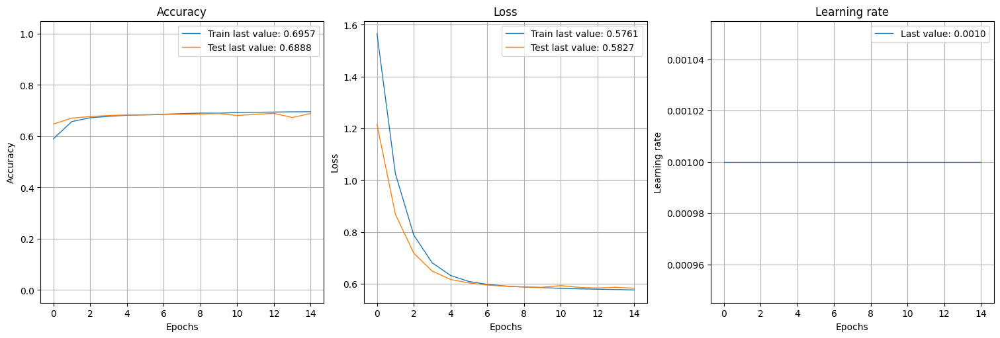

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


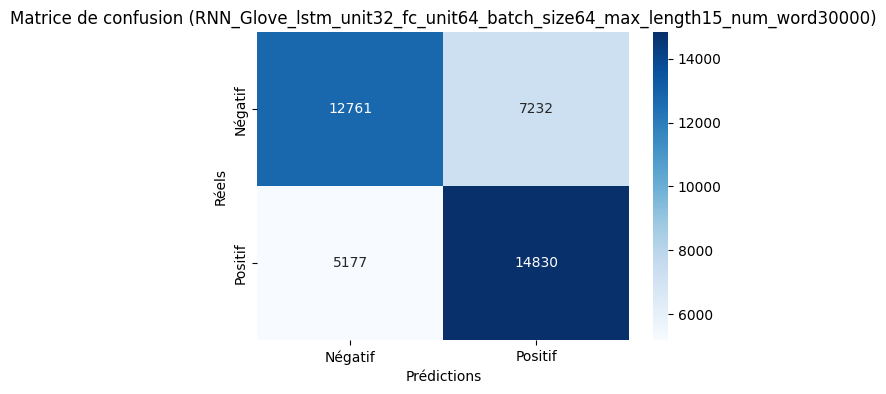

2025/03/08 13:58:50 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 13:59:04 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit64_batch_size64_max_length15_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 22s 10ms/step - accuracy: 0.5423 - loss: 1.7757 - val_accuracy: 0.6413 - val_loss: 1.2263 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 10ms/step - accuracy: 0.6413 - loss: 1.1243 - val_accuracy: 0.6650 - val_loss: 0.8742 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 10ms/step - accuracy: 0.6666 - loss: 0.8316 - val_accuracy: 0.6743 - val_loss: 0.7203 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 20s 10ms/step - accuracy: 0.6738 - loss: 0.7035 - val_accuracy: 0.6762 - val_loss: 0.6514 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6793 - loss: 0.6418 - val_accuracy: 0.6802 - val_loss: 0.6187 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

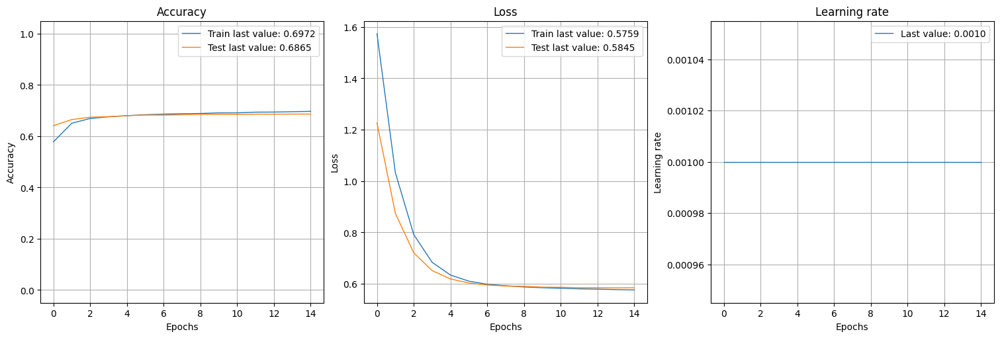

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


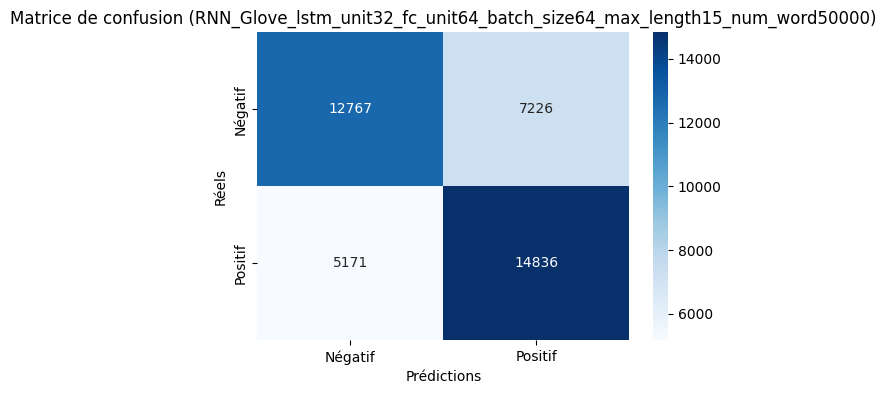

2025/03/08 14:04:44 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 14:05:00 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit64_batch_size64_max_length30_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 32s 15ms/step - accuracy: 0.5764 - loss: 1.7492 - val_accuracy: 0.6741 - val_loss: 1.1855 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 14ms/step - accuracy: 0.6768 - loss: 1.0873 - val_accuracy: 0.6930 - val_loss: 0.8443 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.6924 - loss: 0.8035 - val_accuracy: 0.6959 - val_loss: 0.6970 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.7004 - loss: 0.6763 - val_accuracy: 0.7018 - val_loss: 0.6268 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 14ms/step - accuracy: 0.7060 - loss: 0.6178 - val_accuracy: 0.7034 - val_loss: 0.5959 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

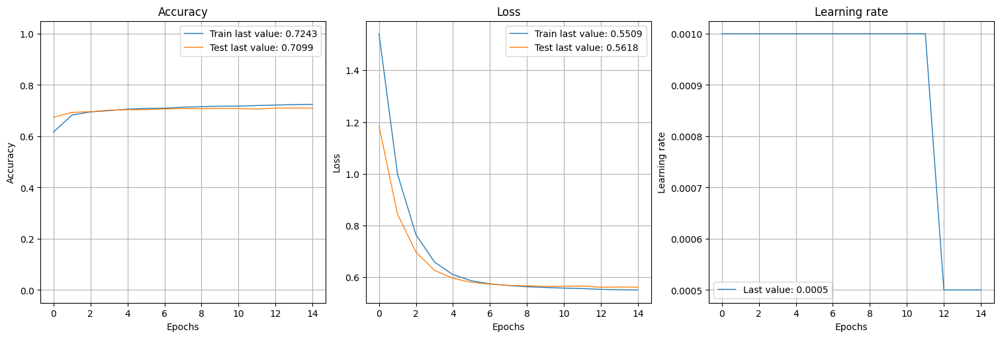

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step


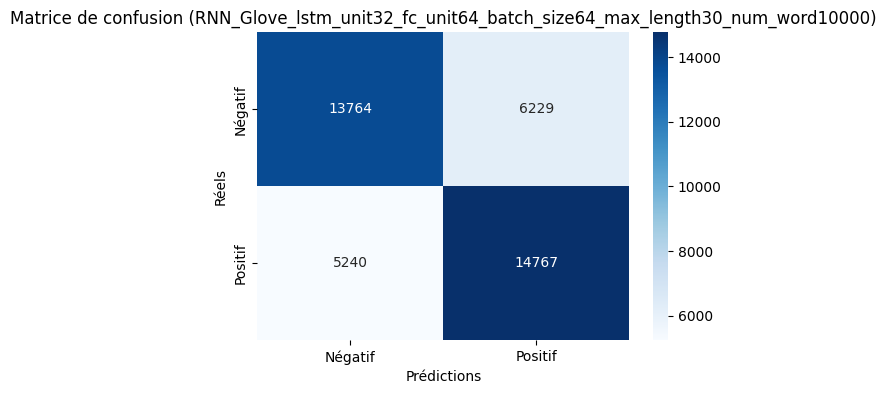

2025/03/08 14:13:12 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 14:13:29 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit64_batch_size64_max_length30_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 14ms/step - accuracy: 0.5415 - loss: 1.7744 - val_accuracy: 0.6619 - val_loss: 1.2068 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 27s 14ms/step - accuracy: 0.6685 - loss: 1.1048 - val_accuracy: 0.6907 - val_loss: 0.8507 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.6905 - loss: 0.8105 - val_accuracy: 0.6962 - val_loss: 0.6975 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.7002 - loss: 0.6795 - val_accuracy: 0.7012 - val_loss: 0.6281 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.7053 - loss: 0.6189 - val_accuracy: 0.7034 - val_loss: 0.5963 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

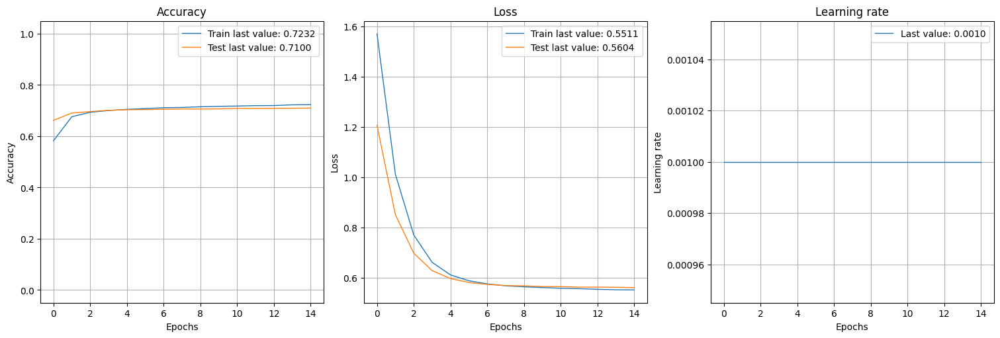

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step


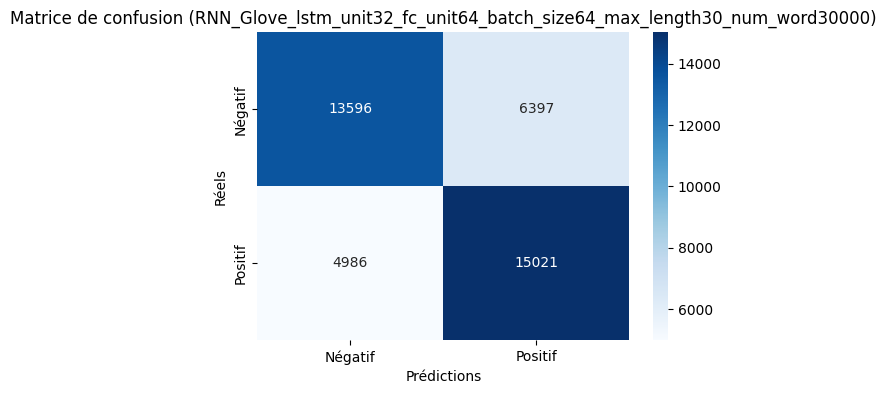

2025/03/08 14:21:22 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 14:21:40 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit64_batch_size64_max_length30_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 32s 15ms/step - accuracy: 0.5662 - loss: 1.7451 - val_accuracy: 0.6739 - val_loss: 1.1830 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.6754 - loss: 1.0875 - val_accuracy: 0.6927 - val_loss: 0.8444 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.6944 - loss: 0.8010 - val_accuracy: 0.6983 - val_loss: 0.6947 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.6999 - loss: 0.6760 - val_accuracy: 0.7010 - val_loss: 0.6273 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 14ms/step - accuracy: 0.7072 - loss: 0.6176 - val_accuracy: 0.7038 - val_loss: 0.5955 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

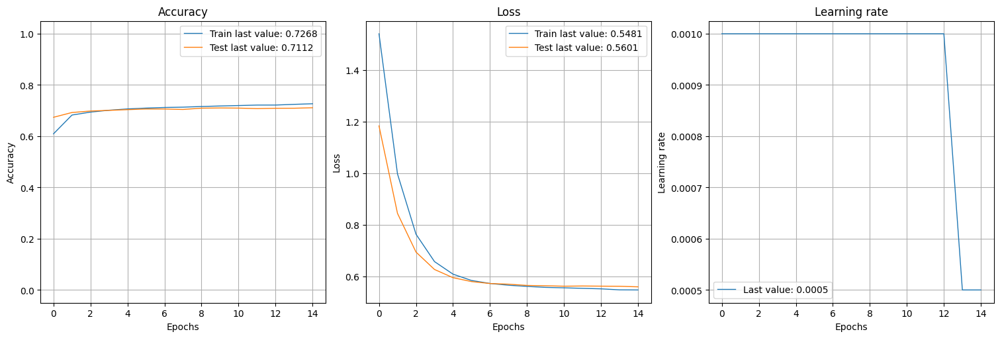

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step


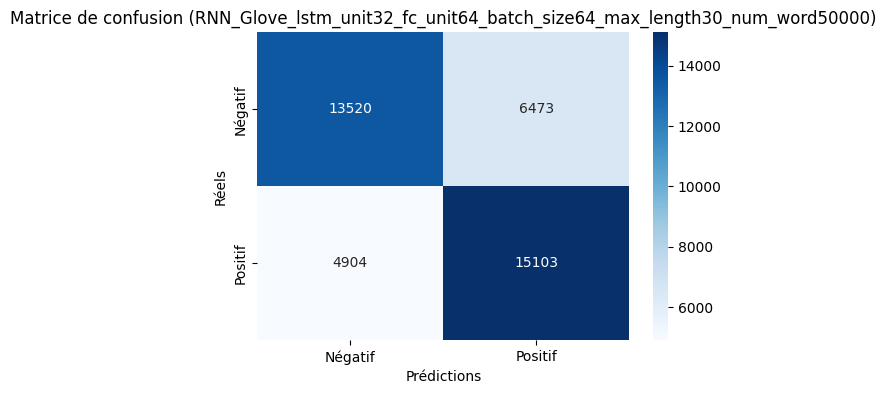

2025/03/08 14:29:45 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 14:30:01 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit128_batch_size64_max_length15_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 21s 10ms/step - accuracy: 0.5461 - loss: 1.8182 - val_accuracy: 0.6496 - val_loss: 1.2468 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6478 - loss: 1.1402 - val_accuracy: 0.6693 - val_loss: 0.8835 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6674 - loss: 0.8371 - val_accuracy: 0.6726 - val_loss: 0.7264 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6755 - loss: 0.7018 - val_accuracy: 0.6808 - val_loss: 0.6507 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6782 - loss: 0.6422 - val_accuracy: 0.6808 - val_loss: 0.6177 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━

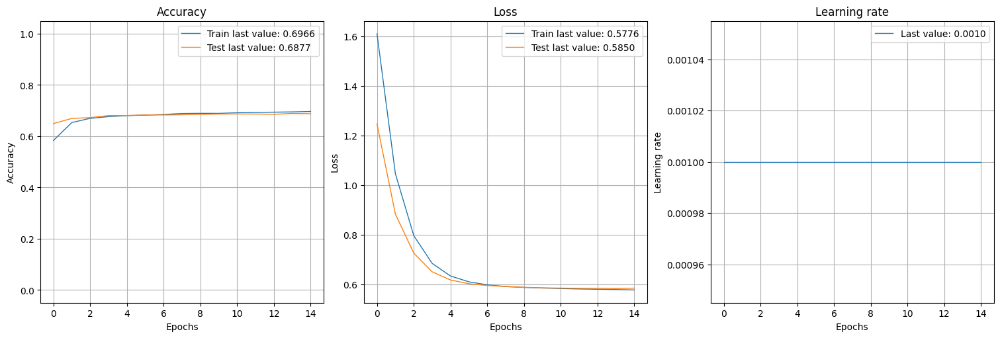

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


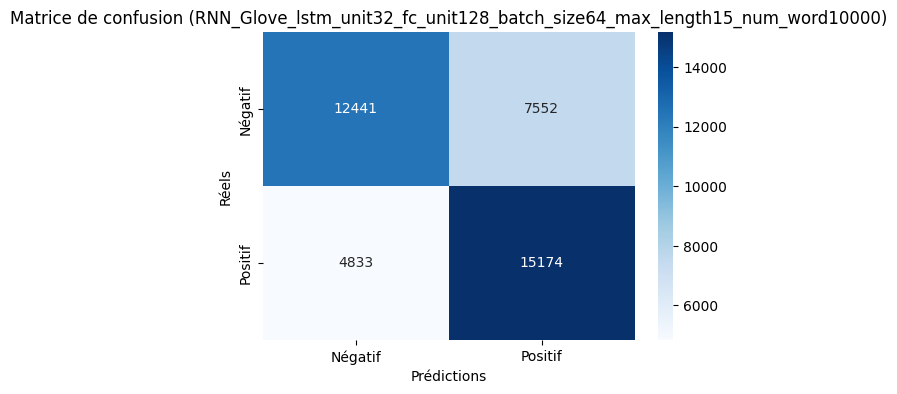

2025/03/08 14:35:37 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 14:35:54 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit128_batch_size64_max_length15_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 21s 9ms/step - accuracy: 0.5456 - loss: 1.8161 - val_accuracy: 0.6497 - val_loss: 1.2417 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6452 - loss: 1.1401 - val_accuracy: 0.6694 - val_loss: 0.8808 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 18s 9ms/step - accuracy: 0.6652 - loss: 0.8388 - val_accuracy: 0.6764 - val_loss: 0.7238 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 10ms/step - accuracy: 0.6749 - loss: 0.7055 - val_accuracy: 0.6798 - val_loss: 0.6512 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 19s 9ms/step - accuracy: 0.6819 - loss: 0.6415 - val_accuracy: 0.6812 - val_loss: 0.6189 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━━━━

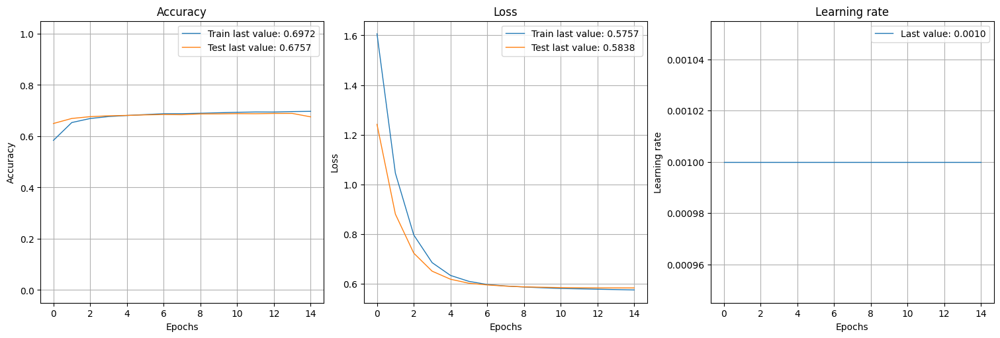

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


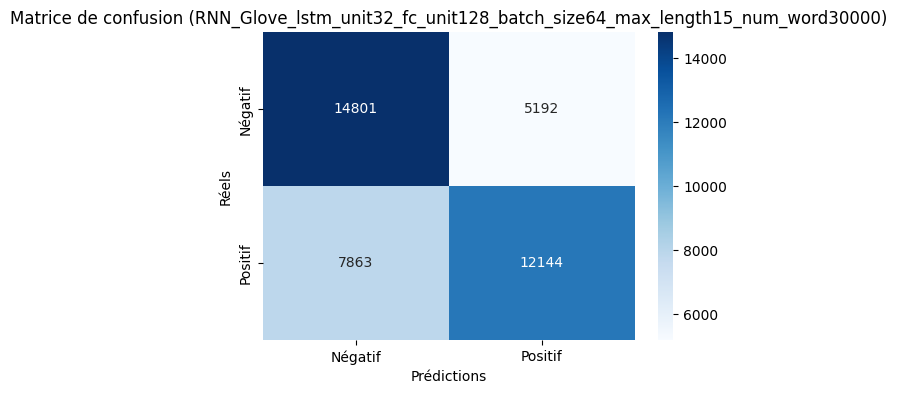

2025/03/08 14:41:33 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 14:41:51 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit128_batch_size64_max_length15_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 24s 11ms/step - accuracy: 0.5690 - loss: 1.7979 - val_accuracy: 0.6537 - val_loss: 1.2319 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 21s 11ms/step - accuracy: 0.6536 - loss: 1.1293 - val_accuracy: 0.6705 - val_loss: 0.8794 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 21s 11ms/step - accuracy: 0.6699 - loss: 0.8349 - val_accuracy: 0.6778 - val_loss: 0.7217 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 22s 11ms/step - accuracy: 0.6770 - loss: 0.7026 - val_accuracy: 0.6809 - val_loss: 0.6528 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 22s 11ms/step - accuracy: 0.6804 - loss: 0.6422 - val_accuracy: 0.6829 - val_loss: 0.6196 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━

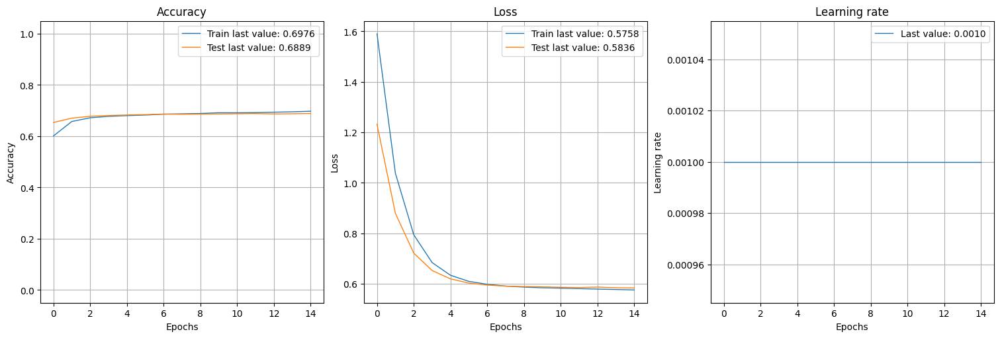

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


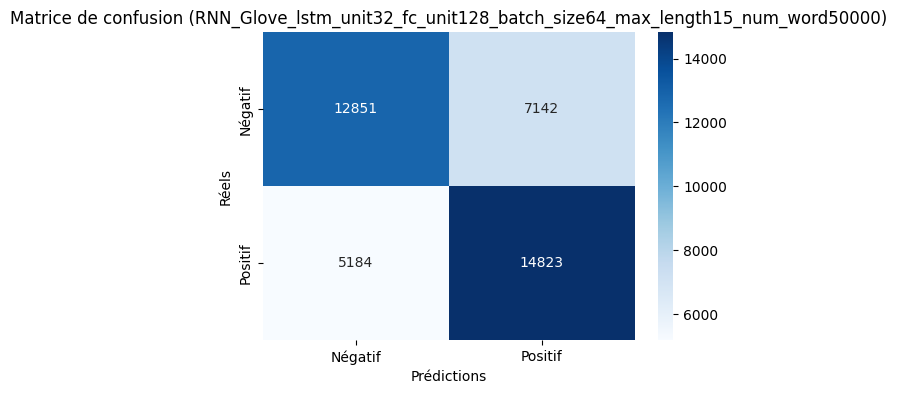

2025/03/08 14:47:48 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 14:48:04 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit128_batch_size64_max_length30_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 14ms/step - accuracy: 0.5475 - loss: 1.8241 - val_accuracy: 0.6707 - val_loss: 1.2281 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 14ms/step - accuracy: 0.6682 - loss: 1.1283 - val_accuracy: 0.6912 - val_loss: 0.8625 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 27s 14ms/step - accuracy: 0.6938 - loss: 0.8183 - val_accuracy: 0.6982 - val_loss: 0.7028 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 15ms/step - accuracy: 0.7011 - loss: 0.6829 - val_accuracy: 0.6994 - val_loss: 0.6311 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 27s 14ms/step - accuracy: 0.7026 - loss: 0.6217 - val_accuracy: 0.7027 - val_loss: 0.5973 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

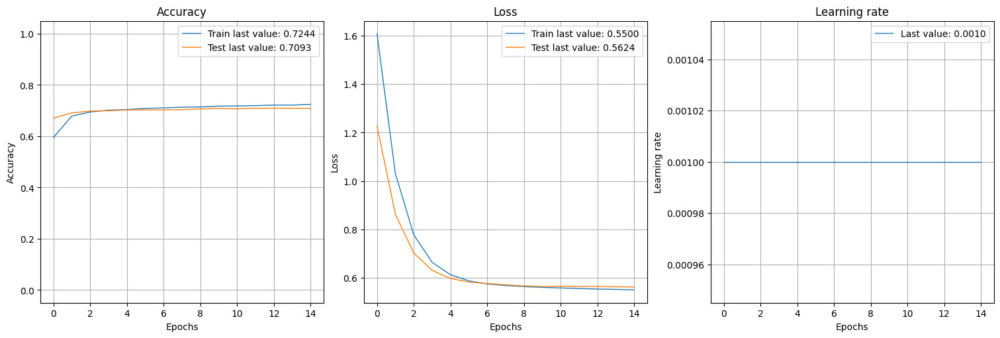

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


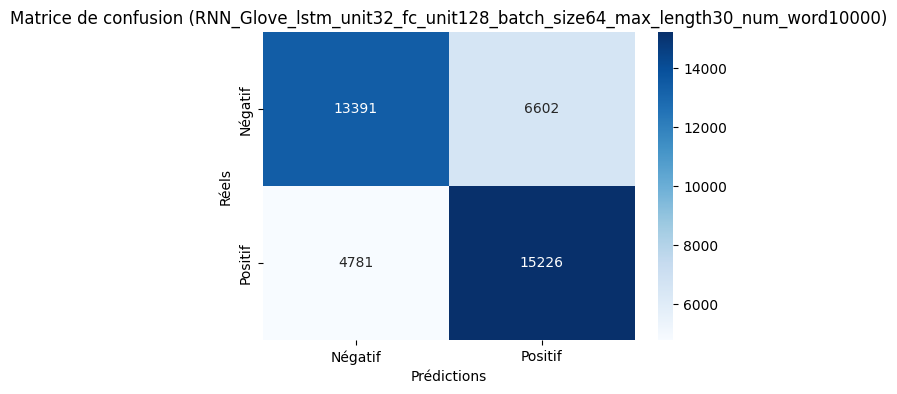

2025/03/08 14:56:26 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 14:56:44 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit128_batch_size64_max_length30_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 37s 16ms/step - accuracy: 0.5532 - loss: 1.8287 - val_accuracy: 0.6737 - val_loss: 1.2284 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 32s 16ms/step - accuracy: 0.6788 - loss: 1.1230 - val_accuracy: 0.6931 - val_loss: 0.8620 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 32s 16ms/step - accuracy: 0.6962 - loss: 0.8156 - val_accuracy: 0.6964 - val_loss: 0.7040 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 33s 16ms/step - accuracy: 0.7042 - loss: 0.6801 - val_accuracy: 0.7002 - val_loss: 0.6304 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 32s 16ms/step - accuracy: 0.7082 - loss: 0.6183 - val_accuracy: 0.7026 - val_loss: 0.5973 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

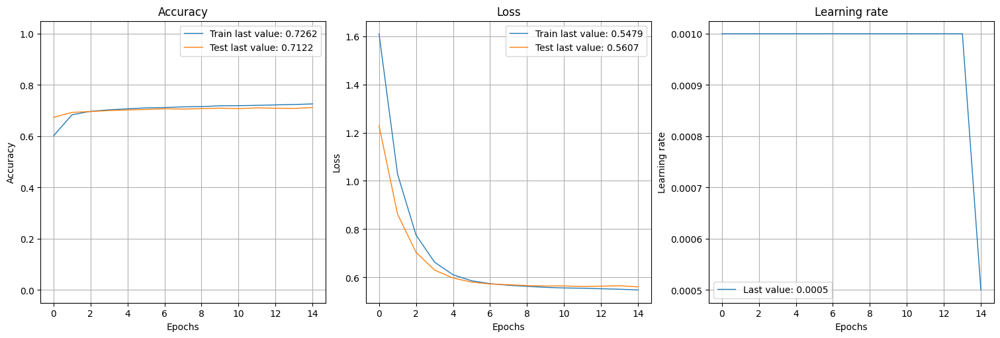

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


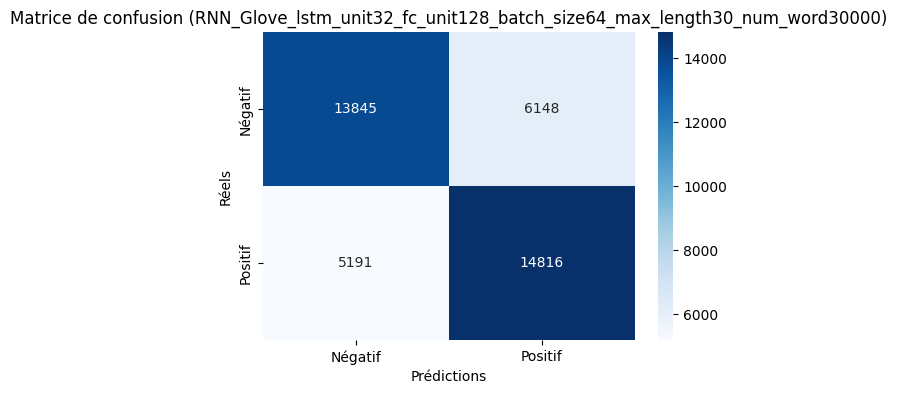

2025/03/08 15:05:58 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 15:06:12 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit32_fc_unit128_batch_size64_max_length30_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 34s 16ms/step - accuracy: 0.5494 - loss: 1.8291 - val_accuracy: 0.6718 - val_loss: 1.2307 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6714 - loss: 1.1269 - val_accuracy: 0.6936 - val_loss: 0.8614 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 15ms/step - accuracy: 0.6953 - loss: 0.8167 - val_accuracy: 0.6987 - val_loss: 0.7008 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 33s 16ms/step - accuracy: 0.7021 - loss: 0.6802 - val_accuracy: 0.7007 - val_loss: 0.6308 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 35s 18ms/step - accuracy: 0.7065 - loss: 0.6179 - val_accuracy: 0.7034 - val_loss: 0.5954 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━

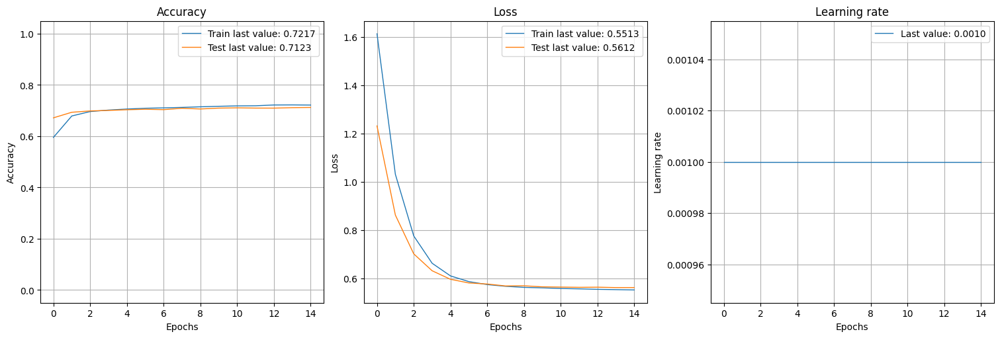

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


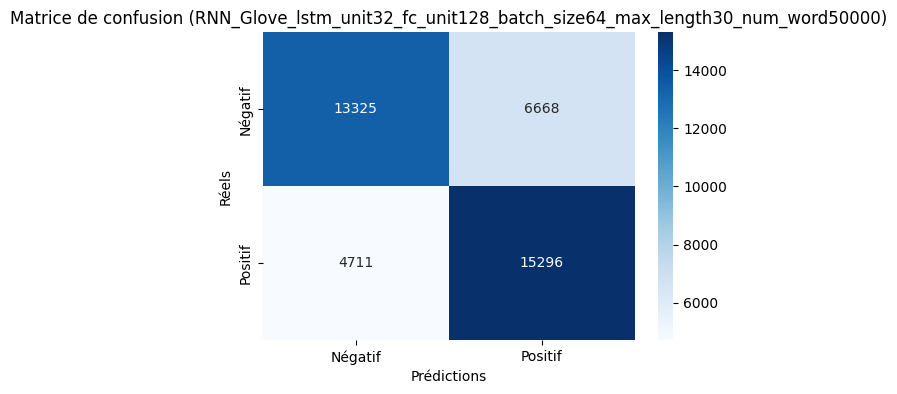

2025/03/08 15:14:55 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 15:15:08 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit32_batch_size64_max_length15_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 13ms/step - accuracy: 0.5746 - loss: 1.8840 - val_accuracy: 0.6595 - val_loss: 1.2692 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6583 - loss: 1.1585 - val_accuracy: 0.6724 - val_loss: 0.8942 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6720 - loss: 0.8462 - val_accuracy: 0.6757 - val_loss: 0.7292 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6740 - loss: 0.7100 - val_accuracy: 0.6800 - val_loss: 0.6531 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6808 - loss: 0.6435 - val_accuracy: 0.6826 - val_loss: 0.6182 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

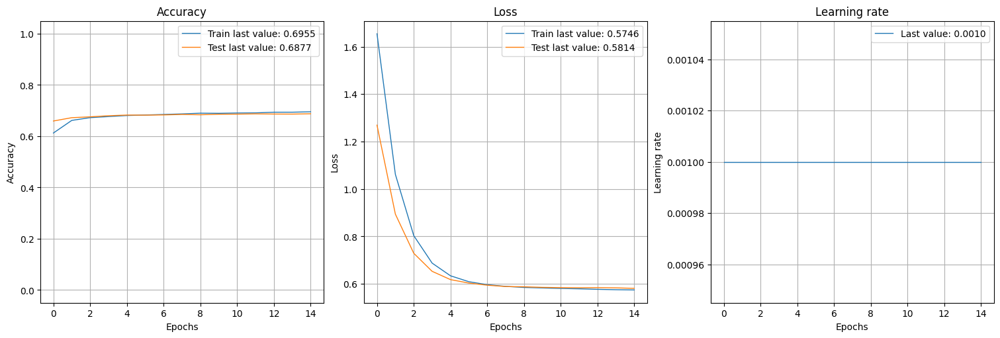

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step


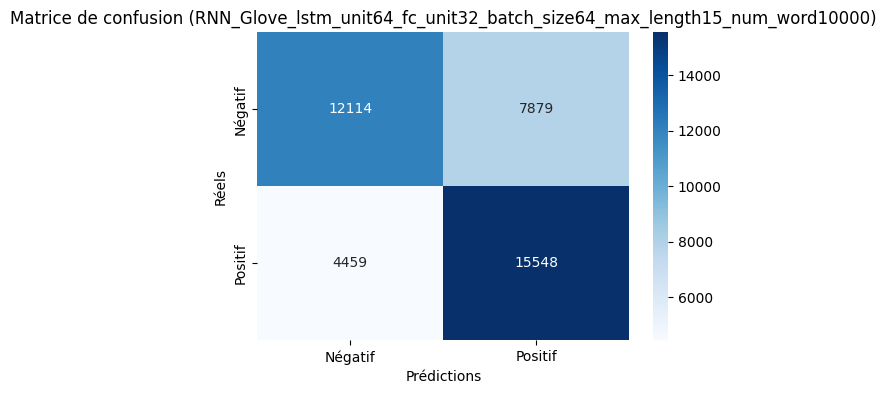

2025/03/08 15:22:36 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 15:22:50 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit32_batch_size64_max_length15_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 14ms/step - accuracy: 0.5641 - loss: 1.8675 - val_accuracy: 0.6579 - val_loss: 1.2625 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6600 - loss: 1.1508 - val_accuracy: 0.6740 - val_loss: 0.8912 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6738 - loss: 0.8439 - val_accuracy: 0.6770 - val_loss: 0.7283 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 27s 13ms/step - accuracy: 0.6766 - loss: 0.7075 - val_accuracy: 0.6810 - val_loss: 0.6538 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6805 - loss: 0.6431 - val_accuracy: 0.6835 - val_loss: 0.6188 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

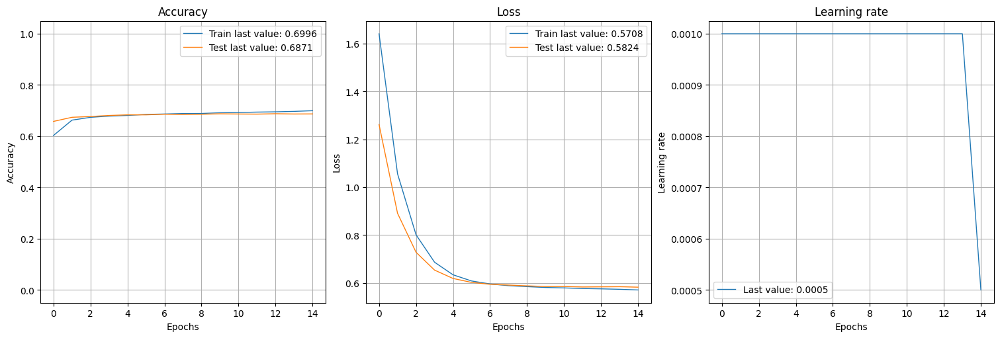

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step


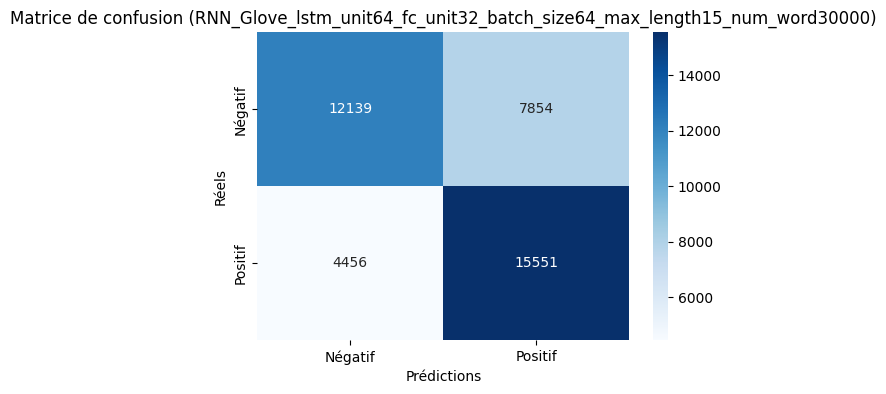

2025/03/08 15:30:31 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 15:30:44 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit32_batch_size64_max_length15_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 13ms/step - accuracy: 0.5460 - loss: 1.8926 - val_accuracy: 0.6537 - val_loss: 1.2748 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6562 - loss: 1.1618 - val_accuracy: 0.6710 - val_loss: 0.8970 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 27s 13ms/step - accuracy: 0.6721 - loss: 0.8479 - val_accuracy: 0.6780 - val_loss: 0.7311 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6764 - loss: 0.7089 - val_accuracy: 0.6818 - val_loss: 0.6557 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 27s 13ms/step - accuracy: 0.6800 - loss: 0.6455 - val_accuracy: 0.6826 - val_loss: 0.6209 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

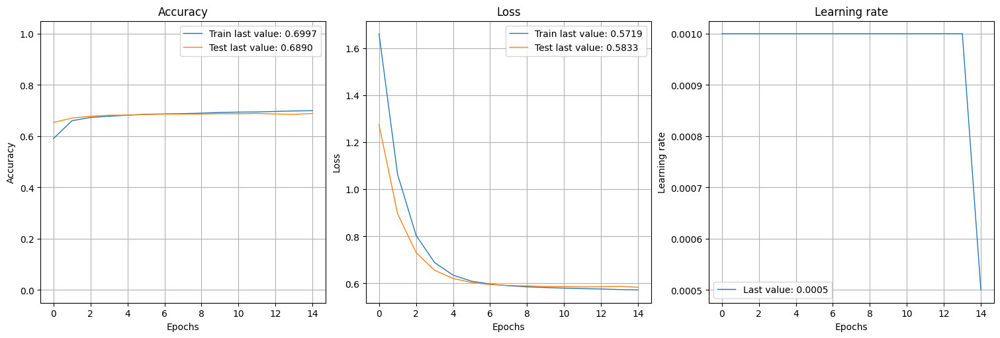

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


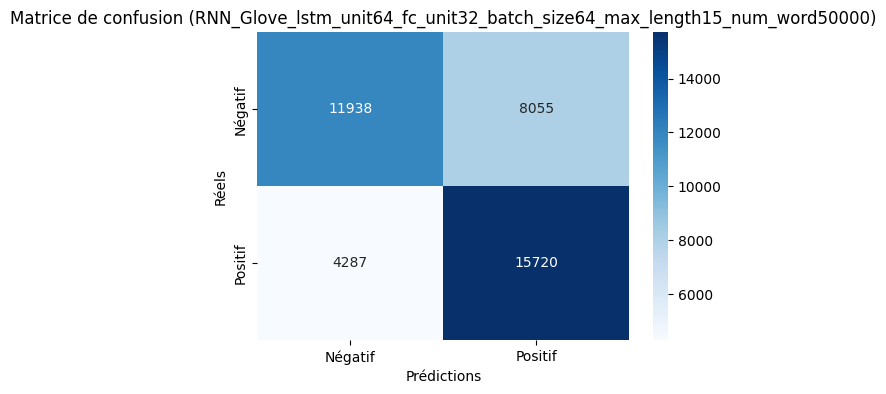

2025/03/08 15:38:19 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 15:38:32 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit32_batch_size64_max_length30_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 47s 22ms/step - accuracy: 0.5859 - loss: 1.8707 - val_accuracy: 0.6837 - val_loss: 1.2430 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 43s 21ms/step - accuracy: 0.6821 - loss: 1.1348 - val_accuracy: 0.6967 - val_loss: 0.8709 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 42s 21ms/step - accuracy: 0.6964 - loss: 0.8229 - val_accuracy: 0.6995 - val_loss: 0.7066 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 43s 21ms/step - accuracy: 0.7038 - loss: 0.6817 - val_accuracy: 0.7016 - val_loss: 0.6315 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 43s 22ms/step - accuracy: 0.7023 - loss: 0.6222 - val_accuracy: 0.6985 - val_loss: 0.6041 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

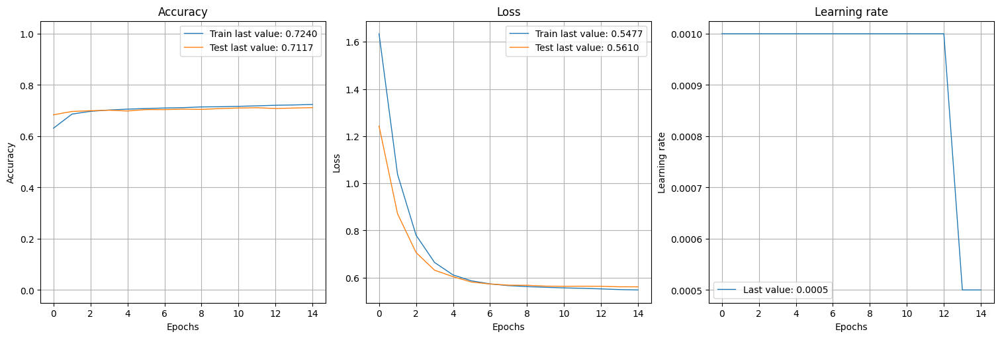

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


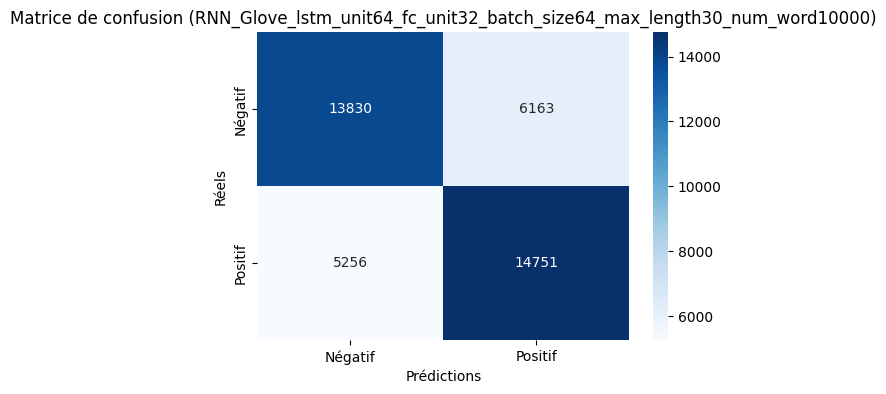

2025/03/08 15:50:20 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 15:50:33 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit32_batch_size64_max_length30_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 47s 22ms/step - accuracy: 0.5719 - loss: 1.8857 - val_accuracy: 0.6826 - val_loss: 1.2523 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 44s 22ms/step - accuracy: 0.6843 - loss: 1.1413 - val_accuracy: 0.6969 - val_loss: 0.8750 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 44s 22ms/step - accuracy: 0.6971 - loss: 0.8267 - val_accuracy: 0.6996 - val_loss: 0.7090 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 45s 22ms/step - accuracy: 0.7045 - loss: 0.6855 - val_accuracy: 0.7036 - val_loss: 0.6328 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 44s 22ms/step - accuracy: 0.7070 - loss: 0.6190 - val_accuracy: 0.7037 - val_loss: 0.5978 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

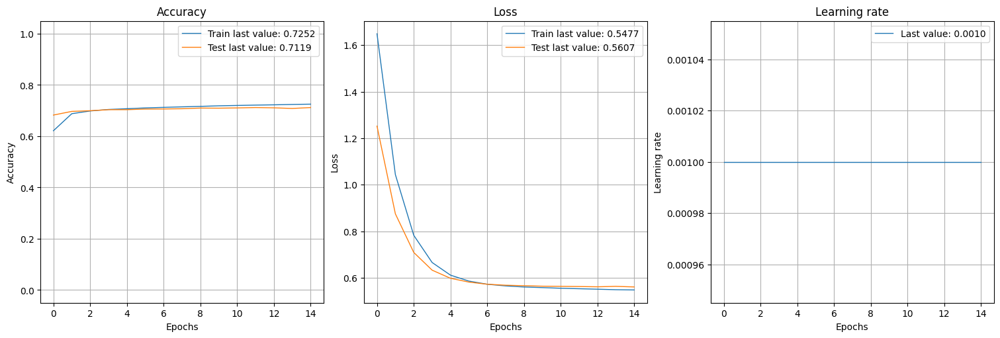

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


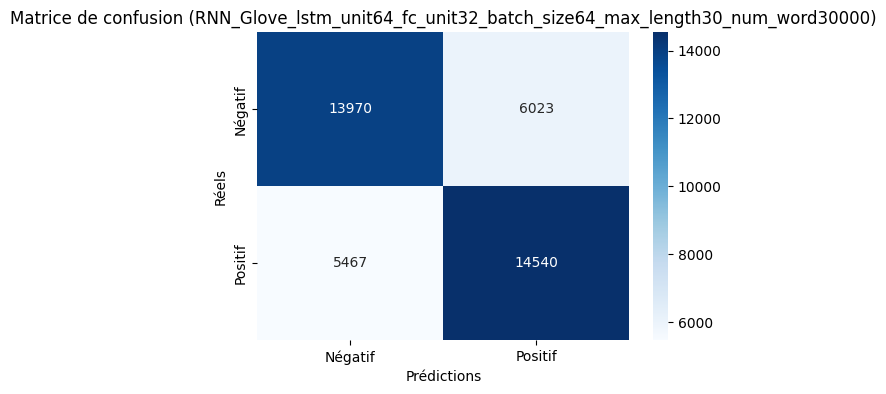

2025/03/08 16:02:38 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 16:02:51 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit32_batch_size64_max_length30_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 46s 22ms/step - accuracy: 0.5590 - loss: 1.8966 - val_accuracy: 0.6748 - val_loss: 1.2615 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 46s 23ms/step - accuracy: 0.6792 - loss: 1.1482 - val_accuracy: 0.6934 - val_loss: 0.8784 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 45s 22ms/step - accuracy: 0.6935 - loss: 0.8304 - val_accuracy: 0.6971 - val_loss: 0.7118 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 44s 22ms/step - accuracy: 0.7026 - loss: 0.6858 - val_accuracy: 0.7017 - val_loss: 0.6339 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 44s 22ms/step - accuracy: 0.7055 - loss: 0.6220 - val_accuracy: 0.7025 - val_loss: 0.5995 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

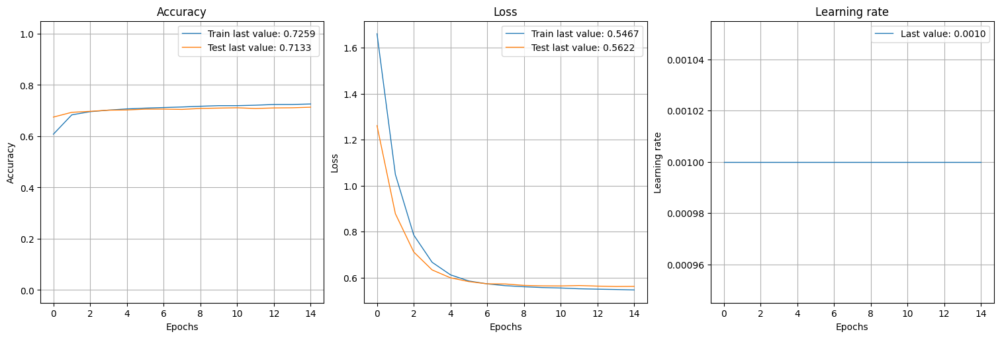

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


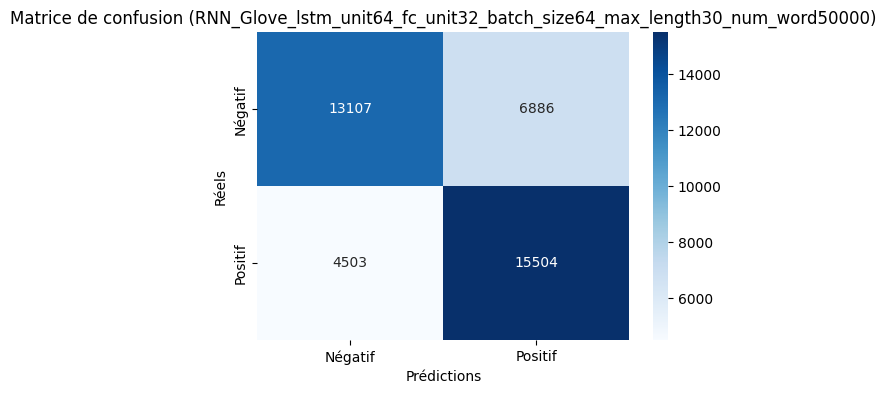

2025/03/08 16:14:53 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 16:15:07 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit64_batch_size64_max_length15_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 13ms/step - accuracy: 0.5825 - loss: 2.0534 - val_accuracy: 0.6607 - val_loss: 1.3636 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 25s 13ms/step - accuracy: 0.6616 - loss: 1.2380 - val_accuracy: 0.6725 - val_loss: 0.9390 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6734 - loss: 0.8813 - val_accuracy: 0.6768 - val_loss: 0.7494 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6770 - loss: 0.7234 - val_accuracy: 0.6793 - val_loss: 0.6635 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6804 - loss: 0.6506 - val_accuracy: 0.6790 - val_loss: 0.6259 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

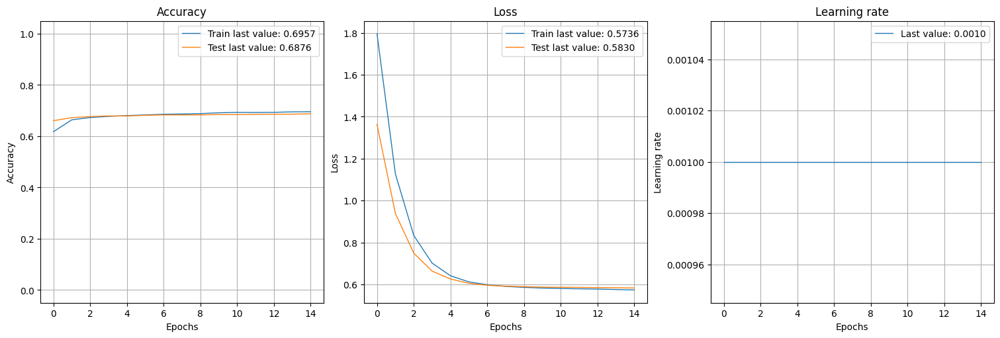

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


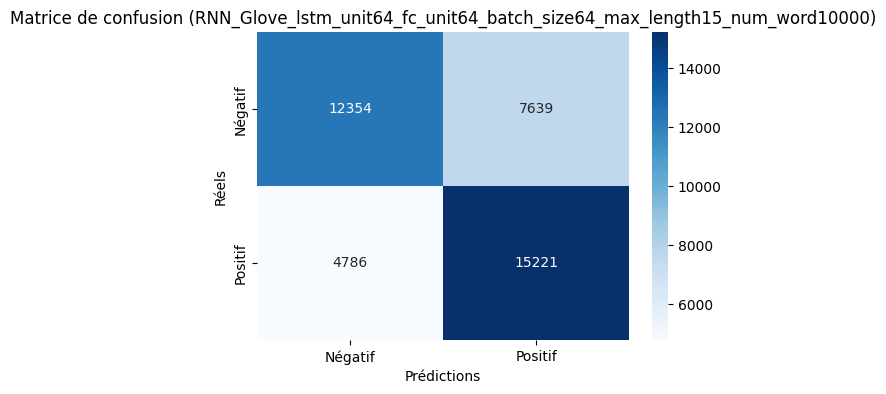

2025/03/08 16:22:24 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 16:22:37 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit64_batch_size64_max_length15_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 32s 15ms/step - accuracy: 0.5584 - loss: 2.0519 - val_accuracy: 0.6562 - val_loss: 1.3585 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.6538 - loss: 1.2333 - val_accuracy: 0.6717 - val_loss: 0.9356 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.6694 - loss: 0.8803 - val_accuracy: 0.6783 - val_loss: 0.7474 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.6782 - loss: 0.7206 - val_accuracy: 0.6804 - val_loss: 0.6626 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6796 - loss: 0.6507 - val_accuracy: 0.6799 - val_loss: 0.6257 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

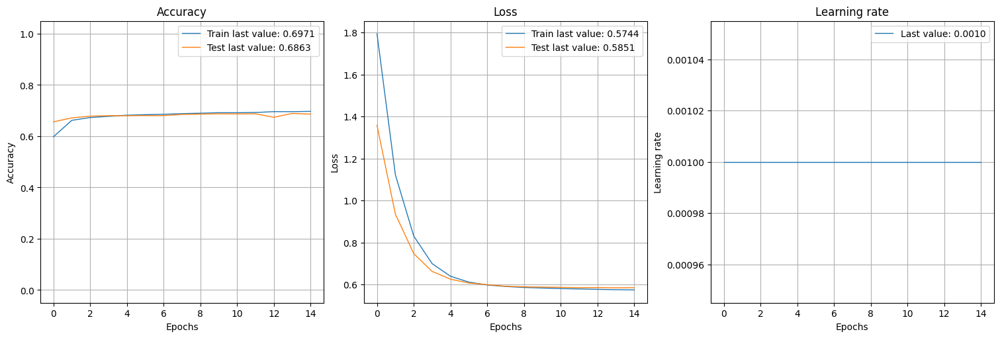

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step


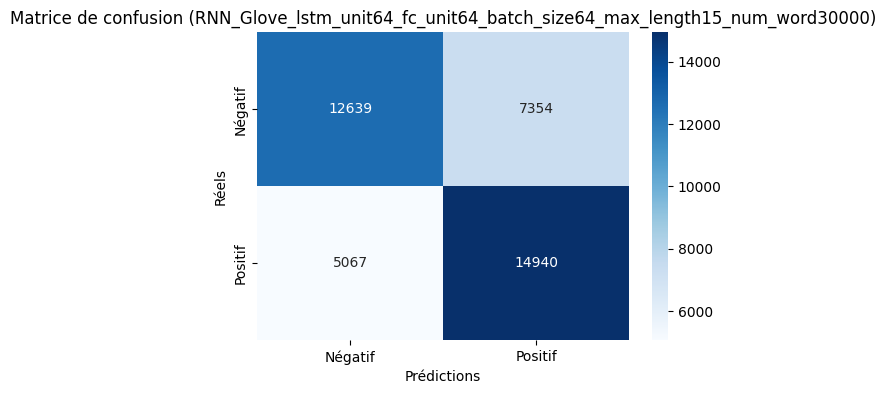

2025/03/08 16:30:33 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 16:30:49 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit64_batch_size64_max_length15_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 13ms/step - accuracy: 0.5625 - loss: 2.0763 - val_accuracy: 0.6529 - val_loss: 1.3733 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6581 - loss: 1.2414 - val_accuracy: 0.6715 - val_loss: 0.9400 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6725 - loss: 0.8847 - val_accuracy: 0.6784 - val_loss: 0.7483 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6797 - loss: 0.7231 - val_accuracy: 0.6798 - val_loss: 0.6637 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 26s 13ms/step - accuracy: 0.6839 - loss: 0.6498 - val_accuracy: 0.6823 - val_loss: 0.6232 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

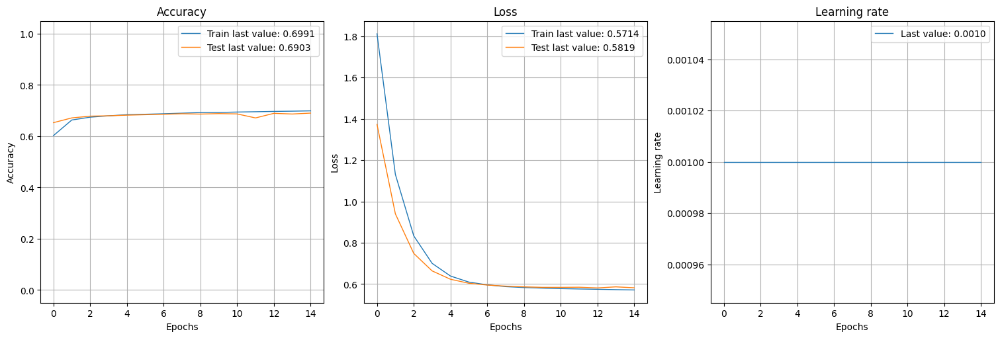

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step


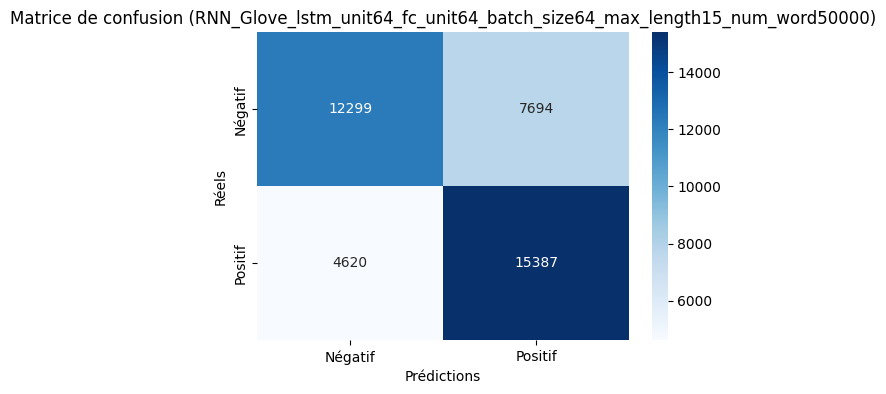

2025/03/08 16:38:12 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 16:38:25 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit64_batch_size64_max_length30_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 46s 22ms/step - accuracy: 0.5616 - loss: 2.0758 - val_accuracy: 0.6798 - val_loss: 1.3559 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 43s 22ms/step - accuracy: 0.6791 - loss: 1.2299 - val_accuracy: 0.6941 - val_loss: 0.9228 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 41s 21ms/step - accuracy: 0.6947 - loss: 0.8672 - val_accuracy: 0.6969 - val_loss: 0.7325 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 42s 21ms/step - accuracy: 0.7025 - loss: 0.7019 - val_accuracy: 0.7003 - val_loss: 0.6431 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 42s 21ms/step - accuracy: 0.7043 - loss: 0.6284 - val_accuracy: 0.7030 - val_loss: 0.6020 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

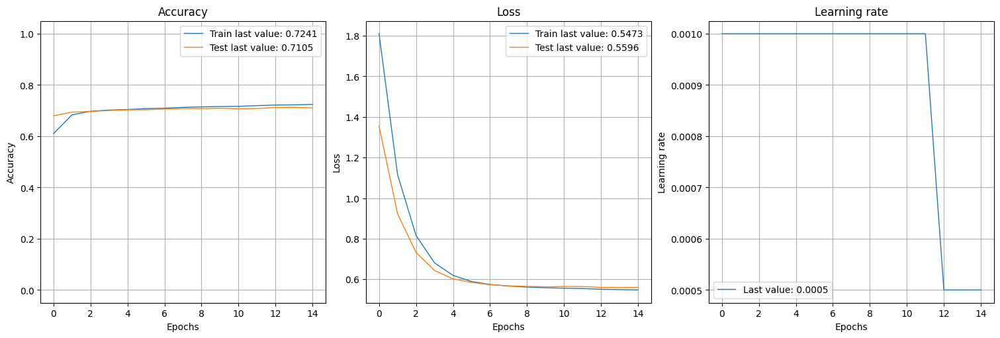

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


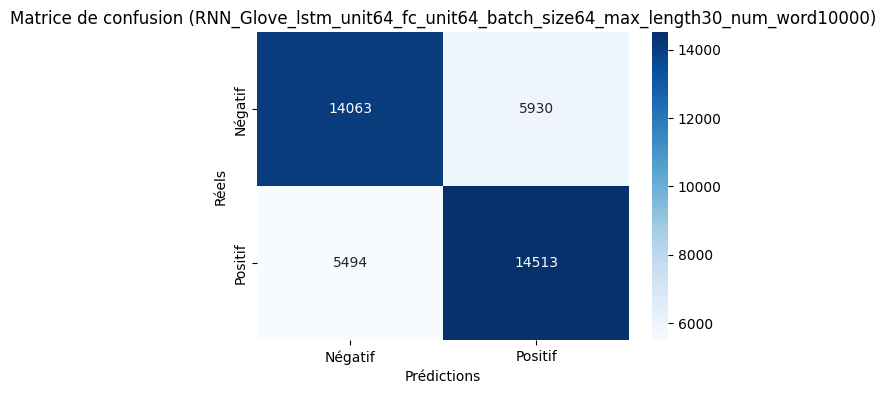

2025/03/08 16:49:55 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 16:50:08 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit64_batch_size64_max_length30_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 49s 22ms/step - accuracy: 0.5748 - loss: 2.0620 - val_accuracy: 0.6779 - val_loss: 1.3522 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 43s 21ms/step - accuracy: 0.6814 - loss: 1.2257 - val_accuracy: 0.6937 - val_loss: 0.9207 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 44s 22ms/step - accuracy: 0.6951 - loss: 0.8642 - val_accuracy: 0.6968 - val_loss: 0.7292 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 43s 22ms/step - accuracy: 0.7016 - loss: 0.7037 - val_accuracy: 0.7010 - val_loss: 0.6429 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 45s 22ms/step - accuracy: 0.7025 - loss: 0.6303 - val_accuracy: 0.7021 - val_loss: 0.6028 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━━

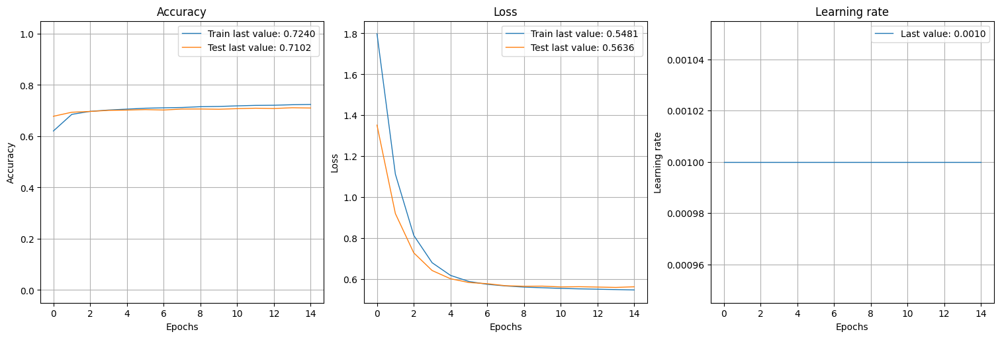

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


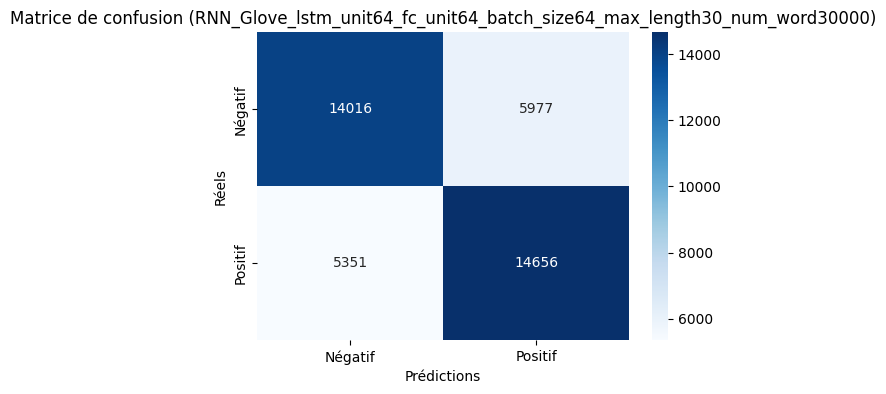

2025/03/08 17:02:06 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 17:02:18 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit64_batch_size64_max_length30_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 46s 22ms/step - accuracy: 0.5741 - loss: 2.0768 - val_accuracy: 0.6771 - val_loss: 1.3569 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 42s 21ms/step - accuracy: 0.6840 - loss: 1.2276 - val_accuracy: 0.6926 - val_loss: 0.9220 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 43s 21ms/step - accuracy: 0.6971 - loss: 0.8637 - val_accuracy: 0.6998 - val_loss: 0.7279 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 43s 22ms/step - accuracy: 0.7037 - loss: 0.7016 - val_accuracy: 0.7038 - val_loss: 0.6403 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 42s 21ms/step - accuracy: 0.7079 - loss: 0.6268 - val_accuracy: 0.7059 - val_loss: 0.6003 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

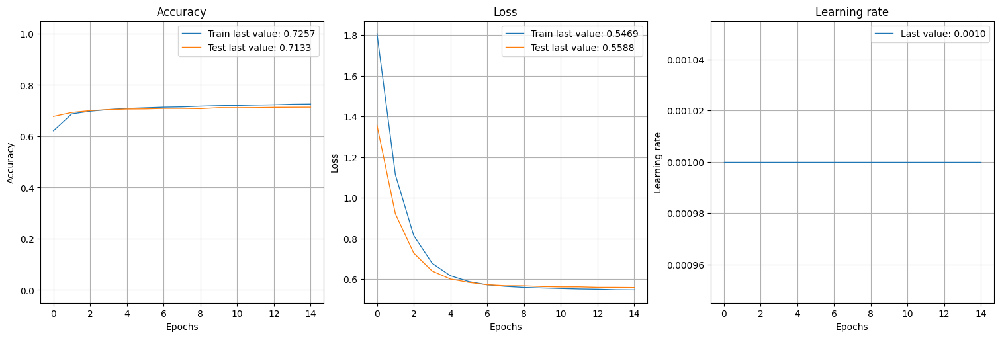

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


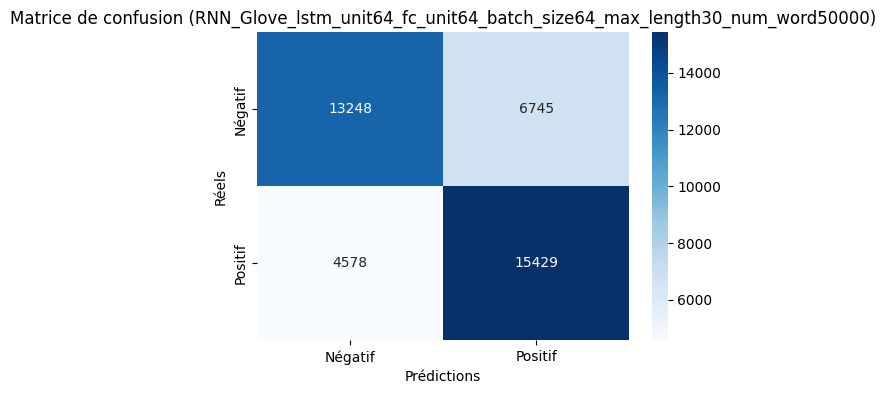

2025/03/08 17:13:55 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 17:14:08 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit128_batch_size64_max_length15_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 12ms/step - accuracy: 0.5658 - loss: 2.2447 - val_accuracy: 0.6512 - val_loss: 1.4692 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 25s 13ms/step - accuracy: 0.6590 - loss: 1.3221 - val_accuracy: 0.6712 - val_loss: 0.9836 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 25s 12ms/step - accuracy: 0.6737 - loss: 0.9182 - val_accuracy: 0.6757 - val_loss: 0.7698 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 14ms/step - accuracy: 0.6773 - loss: 0.7405 - val_accuracy: 0.6808 - val_loss: 0.6706 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 22s 11ms/step - accuracy: 0.6798 - loss: 0.6593 - val_accuracy: 0.6821 - val_loss: 0.6263 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

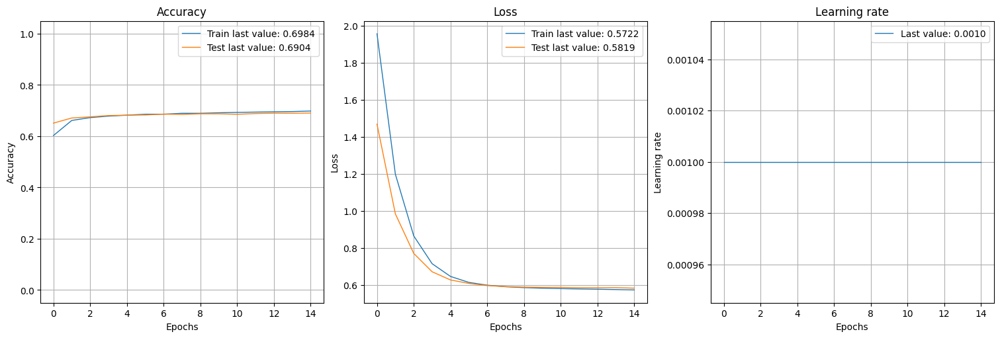

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


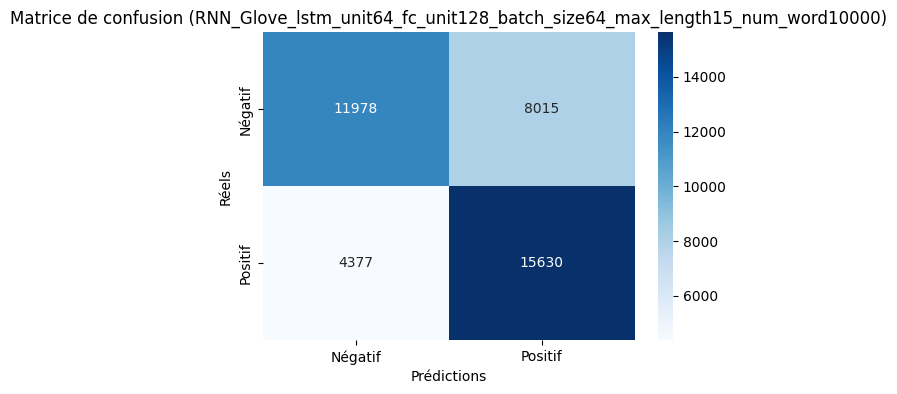

2025/03/08 17:20:57 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 17:21:09 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit128_batch_size64_max_length15_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 25s 11ms/step - accuracy: 0.5537 - loss: 2.2475 - val_accuracy: 0.6479 - val_loss: 1.4730 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 22s 11ms/step - accuracy: 0.6552 - loss: 1.3266 - val_accuracy: 0.6689 - val_loss: 0.9858 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 22s 11ms/step - accuracy: 0.6696 - loss: 0.9225 - val_accuracy: 0.6757 - val_loss: 0.7698 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 23s 11ms/step - accuracy: 0.6765 - loss: 0.7413 - val_accuracy: 0.6772 - val_loss: 0.6736 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 23s 12ms/step - accuracy: 0.6792 - loss: 0.6577 - val_accuracy: 0.6808 - val_loss: 0.6283 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

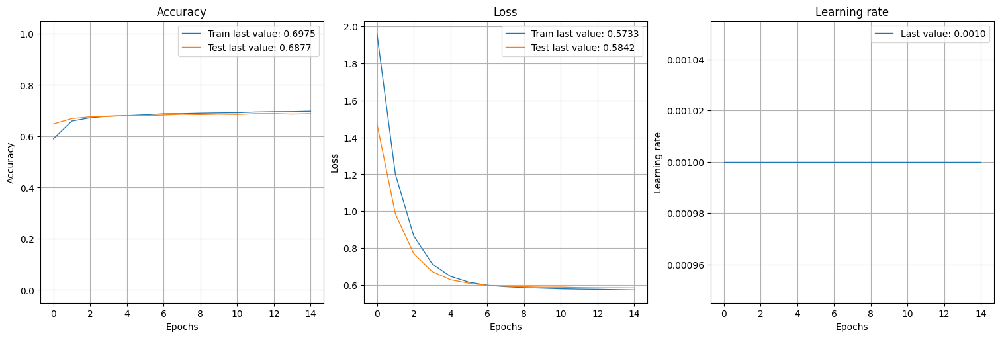

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


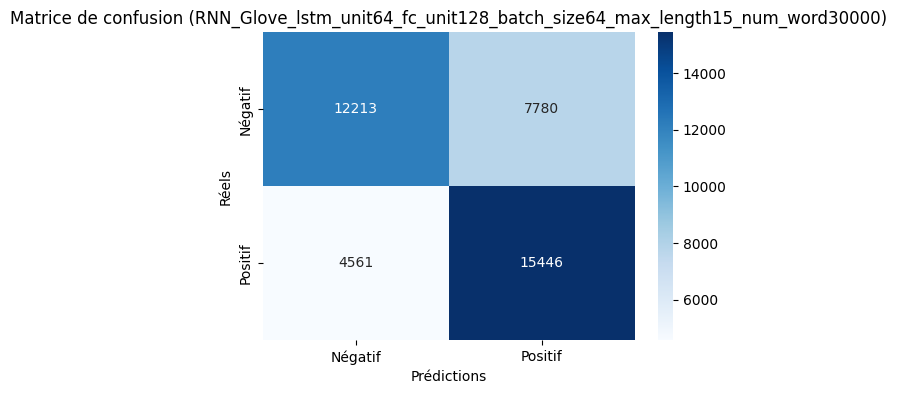

2025/03/08 17:27:36 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 17:27:49 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit128_batch_size64_max_length15_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 28s 13ms/step - accuracy: 0.5600 - loss: 2.2517 - val_accuracy: 0.6531 - val_loss: 1.4741 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 24s 12ms/step - accuracy: 0.6560 - loss: 1.3277 - val_accuracy: 0.6703 - val_loss: 0.9872 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 24s 12ms/step - accuracy: 0.6692 - loss: 0.9214 - val_accuracy: 0.6748 - val_loss: 0.7701 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 24s 12ms/step - accuracy: 0.6774 - loss: 0.7393 - val_accuracy: 0.6803 - val_loss: 0.6713 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 25s 12ms/step - accuracy: 0.6804 - loss: 0.6591 - val_accuracy: 0.6801 - val_loss: 0.6275 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━

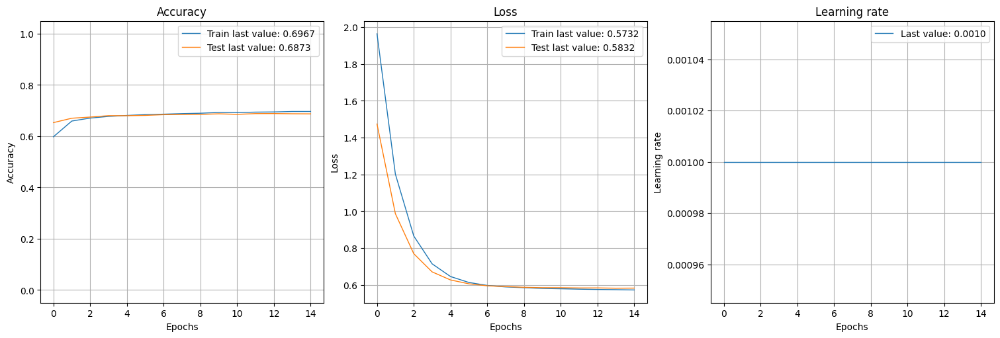

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step


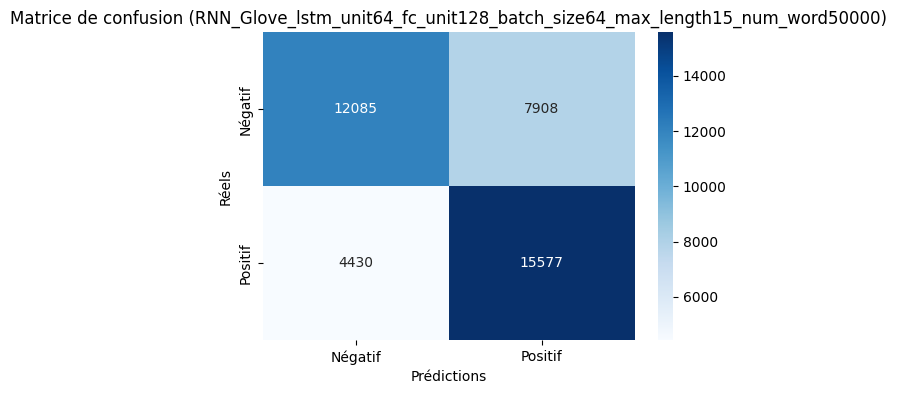

2025/03/08 17:34:41 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 17:34:53 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit128_batch_size64_max_length30_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 42s 20ms/step - accuracy: 0.5799 - loss: 2.2391 - val_accuracy: 0.6786 - val_loss: 1.4488 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 38s 19ms/step - accuracy: 0.6830 - loss: 1.3035 - val_accuracy: 0.6928 - val_loss: 0.9630 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 38s 19ms/step - accuracy: 0.6979 - loss: 0.8974 - val_accuracy: 0.6973 - val_loss: 0.7464 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 38s 19ms/step - accuracy: 0.7023 - loss: 0.7175 - val_accuracy: 0.6976 - val_loss: 0.6545 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 38s 19ms/step - accuracy: 0.7072 - loss: 0.6340 - val_accuracy: 0.7051 - val_loss: 0.6038 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

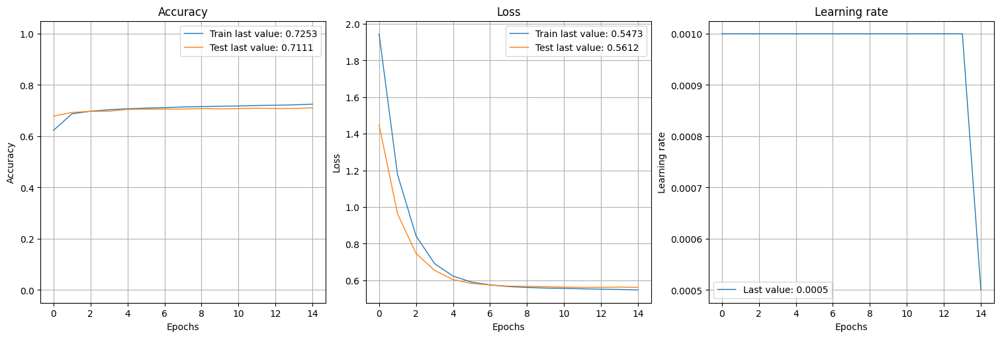

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


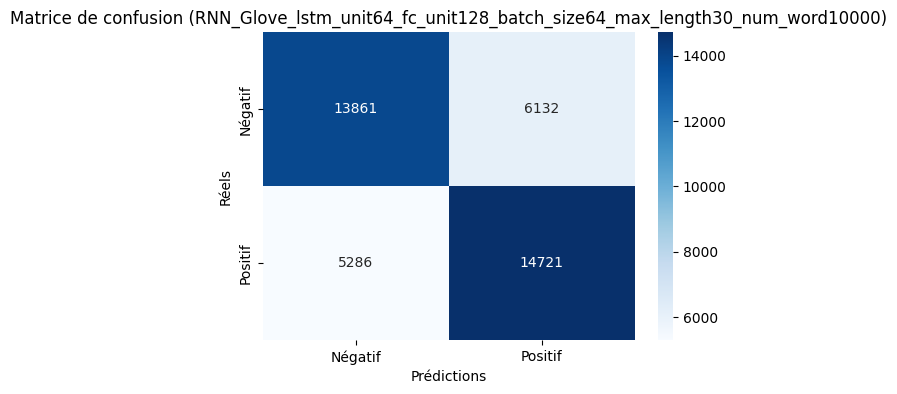

2025/03/08 17:45:15 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 17:45:27 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit128_batch_size64_max_length30_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 40s 19ms/step - accuracy: 0.5812 - loss: 2.2439 - val_accuracy: 0.6790 - val_loss: 1.4504 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 37s 18ms/step - accuracy: 0.6823 - loss: 1.3067 - val_accuracy: 0.6943 - val_loss: 0.9640 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 37s 18ms/step - accuracy: 0.6965 - loss: 0.8993 - val_accuracy: 0.6975 - val_loss: 0.7490 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 37s 19ms/step - accuracy: 0.7025 - loss: 0.7182 - val_accuracy: 0.6994 - val_loss: 0.6512 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 40s 20ms/step - accuracy: 0.7054 - loss: 0.6360 - val_accuracy: 0.7005 - val_loss: 0.6085 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

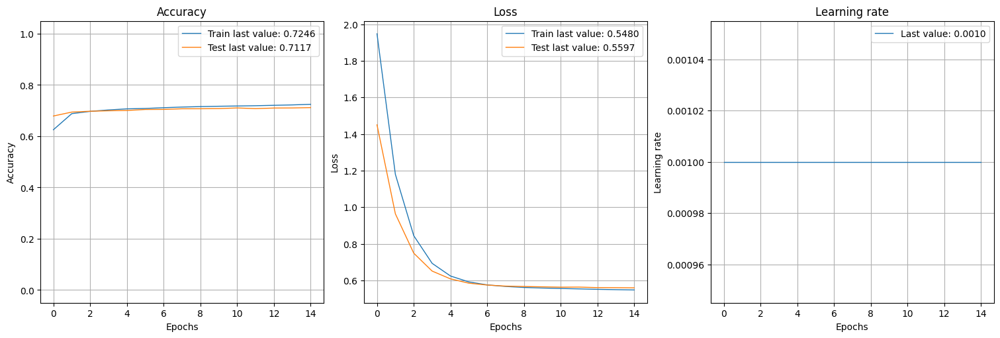

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


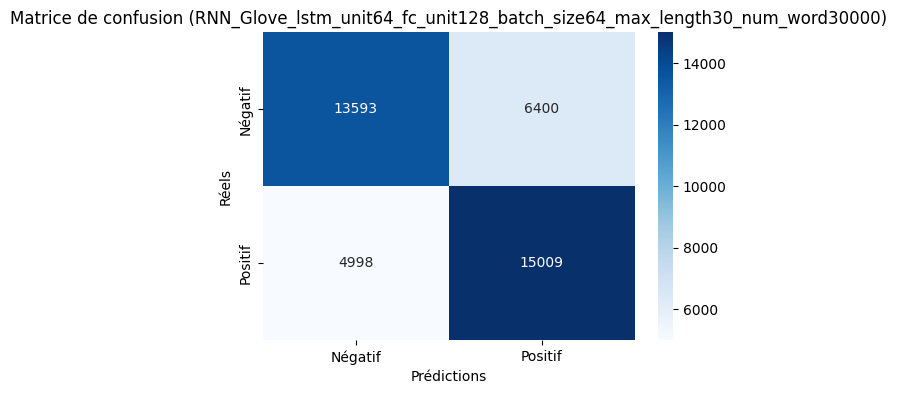

2025/03/08 17:55:34 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 17:55:46 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit64_fc_unit128_batch_size64_max_length30_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 41s 19ms/step - accuracy: 0.5821 - loss: 2.2324 - val_accuracy: 0.6799 - val_loss: 1.4432 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 38s 19ms/step - accuracy: 0.6819 - loss: 1.3000 - val_accuracy: 0.6960 - val_loss: 0.9594 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 38s 19ms/step - accuracy: 0.6957 - loss: 0.8975 - val_accuracy: 0.6974 - val_loss: 0.7468 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 38s 19ms/step - accuracy: 0.7036 - loss: 0.7155 - val_accuracy: 0.7014 - val_loss: 0.6489 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 38s 19ms/step - accuracy: 0.7069 - loss: 0.6333 - val_accuracy: 0.7041 - val_loss: 0.6046 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━

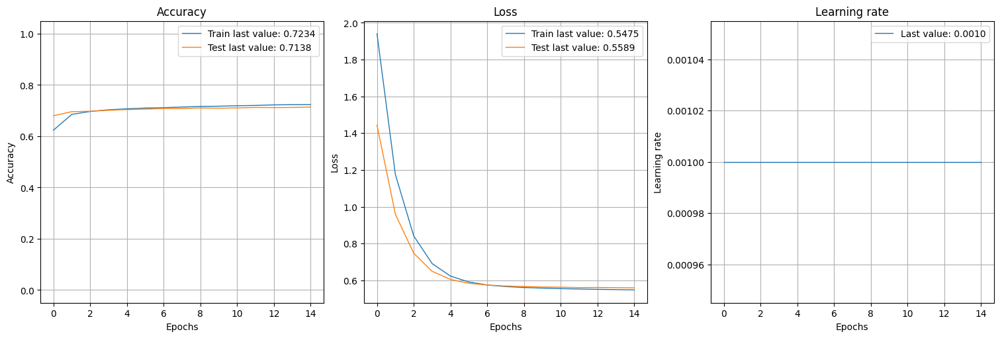

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


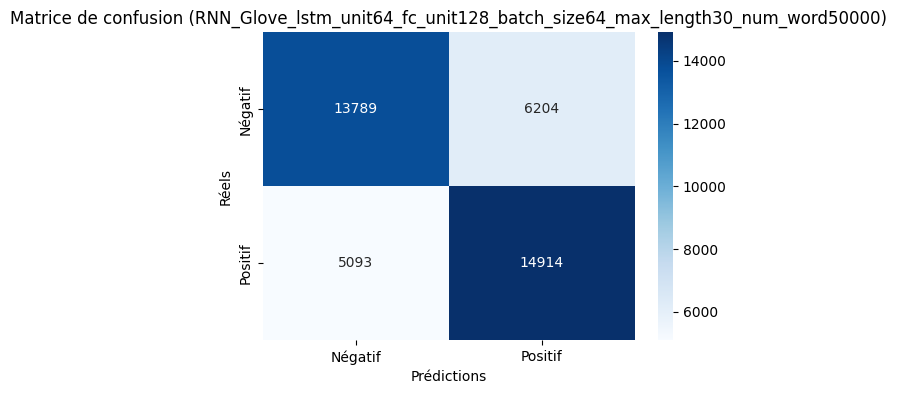

2025/03/08 18:06:18 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 18:06:29 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit32_batch_size64_max_length15_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 35s 16ms/step - accuracy: 0.5790 - loss: 2.0439 - val_accuracy: 0.6575 - val_loss: 1.3583 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 32s 16ms/step - accuracy: 0.6568 - loss: 1.2308 - val_accuracy: 0.6725 - val_loss: 0.9355 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 32s 16ms/step - accuracy: 0.6734 - loss: 0.8792 - val_accuracy: 0.6791 - val_loss: 0.7479 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 32s 16ms/step - accuracy: 0.6798 - loss: 0.7203 - val_accuracy: 0.6802 - val_loss: 0.6623 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 34s 17ms/step - accuracy: 0.6828 - loss: 0.6496 - val_accuracy: 0.6814 - val_loss: 0.6251 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

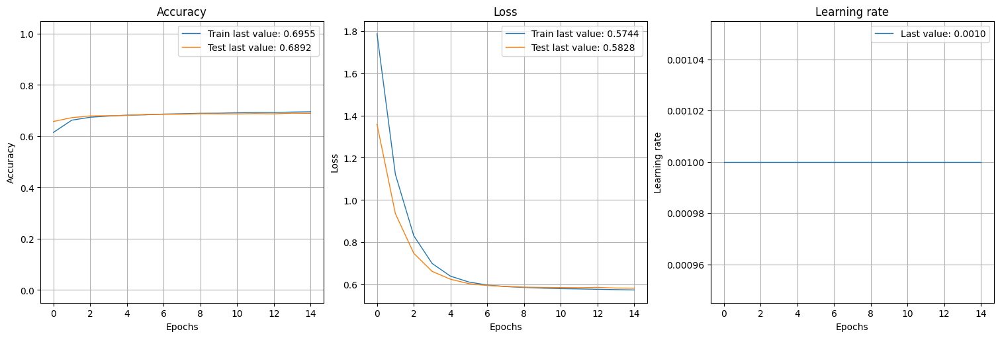

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


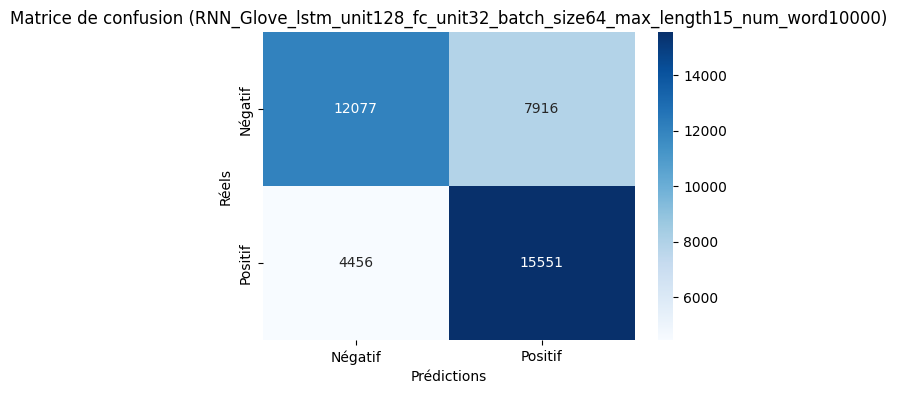

2025/03/08 18:15:19 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 18:15:31 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit32_batch_size64_max_length15_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 32s 15ms/step - accuracy: 0.5672 - loss: 2.0494 - val_accuracy: 0.6626 - val_loss: 1.3560 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6617 - loss: 1.2299 - val_accuracy: 0.6762 - val_loss: 0.9336 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 15ms/step - accuracy: 0.6767 - loss: 0.8769 - val_accuracy: 0.6784 - val_loss: 0.7472 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6790 - loss: 0.7211 - val_accuracy: 0.6804 - val_loss: 0.6615 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6819 - loss: 0.6492 - val_accuracy: 0.6819 - val_loss: 0.6229 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

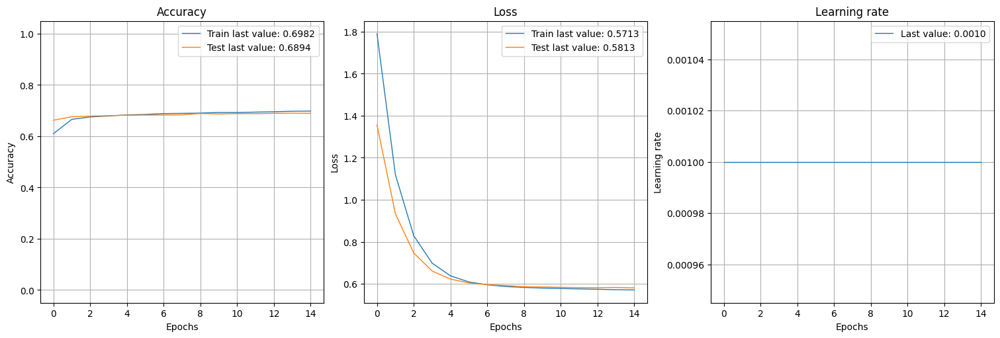

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


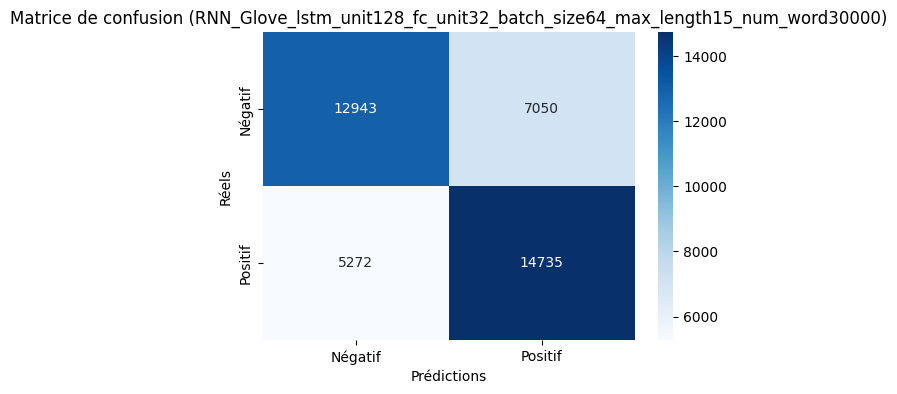

2025/03/08 18:24:01 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 18:24:13 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit32_batch_size64_max_length15_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 34s 16ms/step - accuracy: 0.5742 - loss: 2.0495 - val_accuracy: 0.6614 - val_loss: 1.3583 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 16ms/step - accuracy: 0.6632 - loss: 1.2318 - val_accuracy: 0.6713 - val_loss: 0.9367 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 16ms/step - accuracy: 0.6749 - loss: 0.8777 - val_accuracy: 0.6763 - val_loss: 0.7477 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 16ms/step - accuracy: 0.6783 - loss: 0.7201 - val_accuracy: 0.6796 - val_loss: 0.6621 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 15ms/step - accuracy: 0.6841 - loss: 0.6472 - val_accuracy: 0.6824 - val_loss: 0.6227 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━

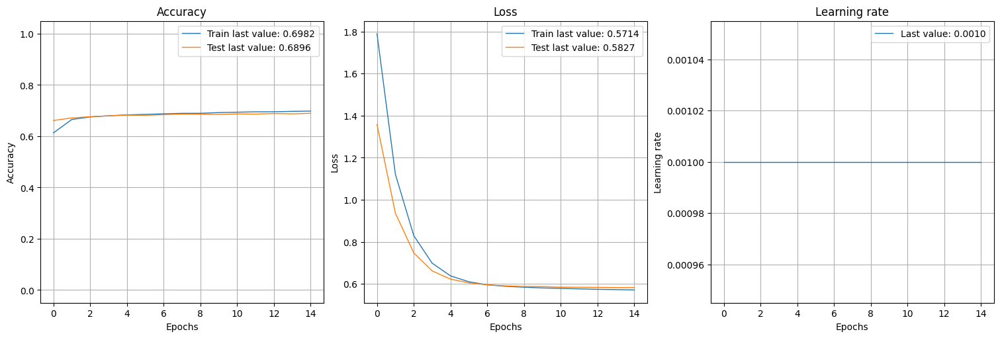

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


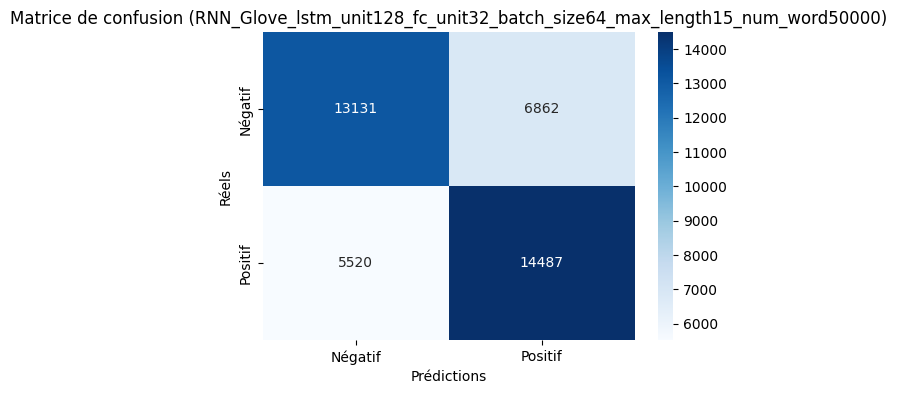

2025/03/08 18:32:56 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 18:33:08 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit32_batch_size64_max_length30_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 59s 28ms/step - accuracy: 0.5888 - loss: 2.0357 - val_accuracy: 0.6751 - val_loss: 1.3439 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 56s 28ms/step - accuracy: 0.6827 - loss: 1.2091 - val_accuracy: 0.6954 - val_loss: 0.9145 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 58s 29ms/step - accuracy: 0.6975 - loss: 0.8554 - val_accuracy: 0.6989 - val_loss: 0.7265 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 57s 28ms/step - accuracy: 0.6999 - loss: 0.7004 - val_accuracy: 0.7025 - val_loss: 0.6411 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 57s 29ms/step - accuracy: 0.7104 - loss: 0.6229 - val_accuracy: 0.7028 - val_loss: 0.6027 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

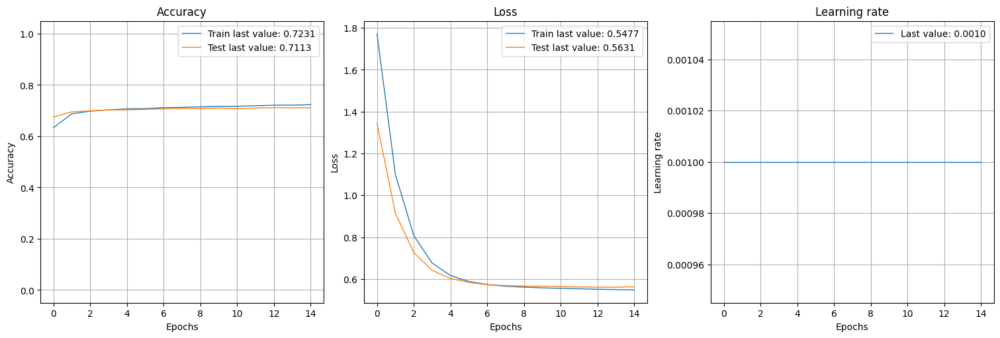

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 11s 9ms/step


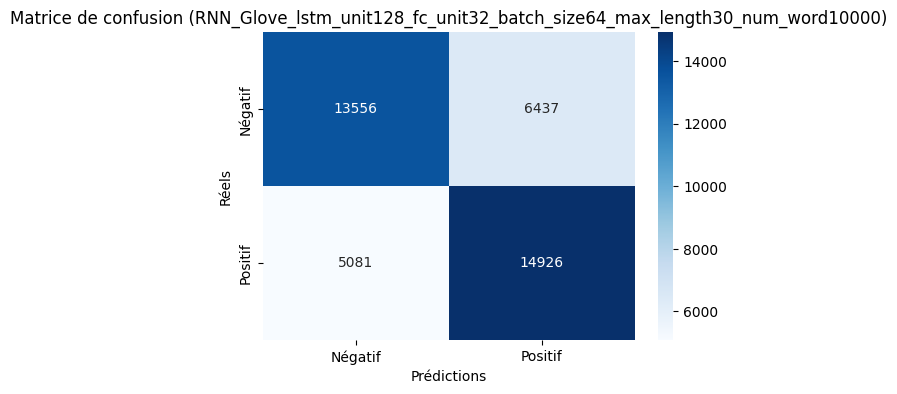

2025/03/08 18:48:23 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 18:48:35 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit32_batch_size64_max_length30_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 58s 28ms/step - accuracy: 0.5951 - loss: 2.0337 - val_accuracy: 0.6869 - val_loss: 1.3312 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 56s 28ms/step - accuracy: 0.6907 - loss: 1.2048 - val_accuracy: 0.6979 - val_loss: 0.9115 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 57s 28ms/step - accuracy: 0.6989 - loss: 0.8541 - val_accuracy: 0.7013 - val_loss: 0.7235 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 56s 28ms/step - accuracy: 0.7014 - loss: 0.6981 - val_accuracy: 0.7031 - val_loss: 0.6383 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 57s 28ms/step - accuracy: 0.7075 - loss: 0.6240 - val_accuracy: 0.7054 - val_loss: 0.5995 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

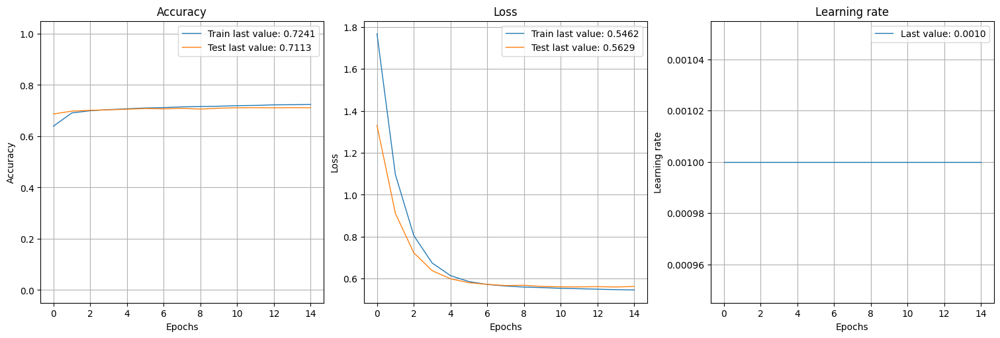

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 11s 9ms/step


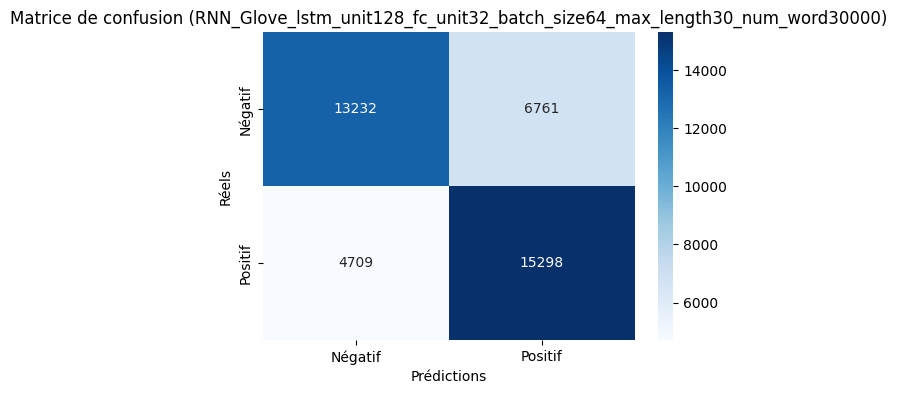

2025/03/08 19:03:37 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 19:03:48 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit32_batch_size64_max_length30_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 58s 28ms/step - accuracy: 0.5899 - loss: 2.0363 - val_accuracy: 0.6851 - val_loss: 1.3337 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 27ms/step - accuracy: 0.6880 - loss: 1.2057 - val_accuracy: 0.6987 - val_loss: 0.9124 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 55s 28ms/step - accuracy: 0.6993 - loss: 0.8541 - val_accuracy: 0.7019 - val_loss: 0.7255 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 56s 28ms/step - accuracy: 0.7041 - loss: 0.6964 - val_accuracy: 0.7040 - val_loss: 0.6405 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 27ms/step - accuracy: 0.7102 - loss: 0.6228 - val_accuracy: 0.7069 - val_loss: 0.6003 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━

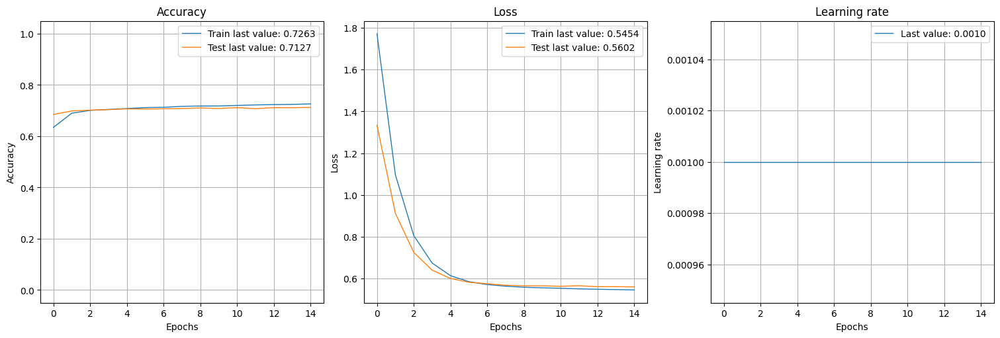

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 11s 8ms/step


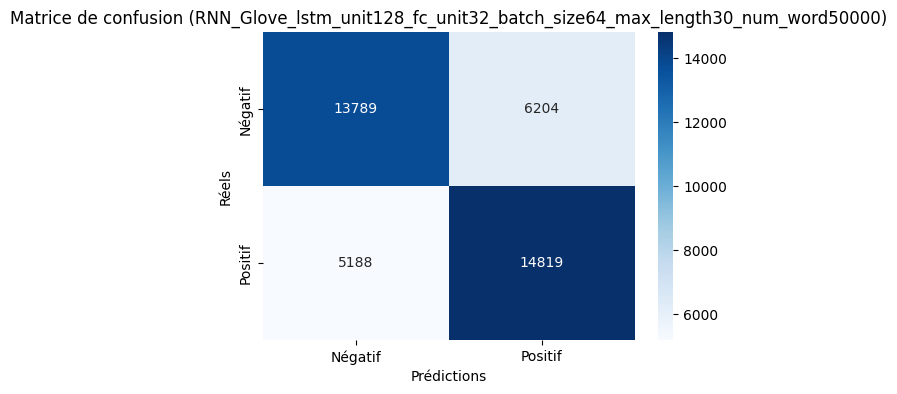

2025/03/08 19:18:28 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 19:18:41 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit64_batch_size64_max_length15_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 34s 16ms/step - accuracy: 0.5788 - loss: 2.3284 - val_accuracy: 0.6585 - val_loss: 1.5106 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6606 - loss: 1.3564 - val_accuracy: 0.6728 - val_loss: 1.0036 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6736 - loss: 0.9342 - val_accuracy: 0.6772 - val_loss: 0.7768 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6786 - loss: 0.7460 - val_accuracy: 0.6803 - val_loss: 0.6744 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 15ms/step - accuracy: 0.6822 - loss: 0.6586 - val_accuracy: 0.6809 - val_loss: 0.6280 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

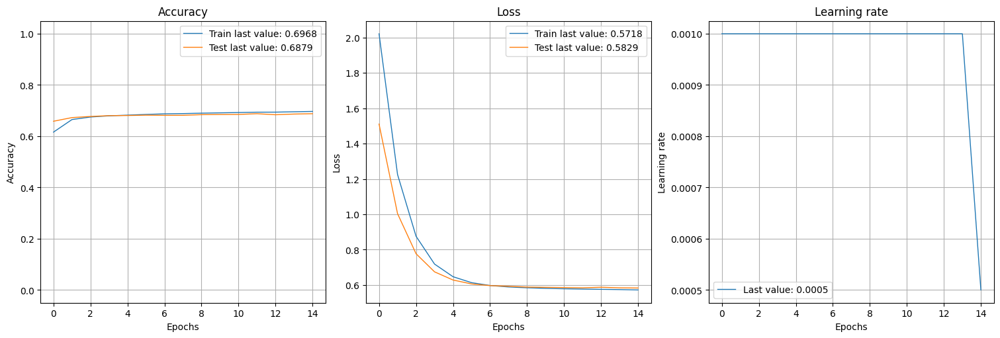

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


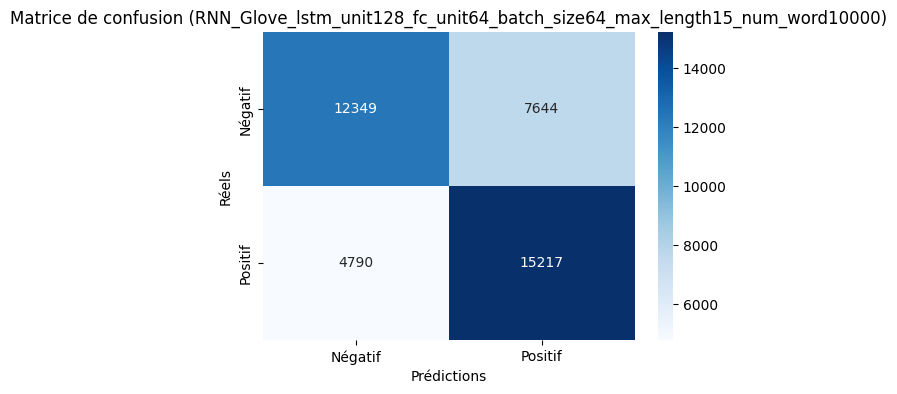

2025/03/08 19:27:12 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 19:27:24 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit64_batch_size64_max_length15_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 33s 15ms/step - accuracy: 0.5730 - loss: 2.3412 - val_accuracy: 0.6531 - val_loss: 1.5218 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6580 - loss: 1.3667 - val_accuracy: 0.6692 - val_loss: 1.0099 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6724 - loss: 0.9417 - val_accuracy: 0.6740 - val_loss: 0.7822 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6796 - loss: 0.7469 - val_accuracy: 0.6747 - val_loss: 0.6792 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6824 - loss: 0.6605 - val_accuracy: 0.6787 - val_loss: 0.6311 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

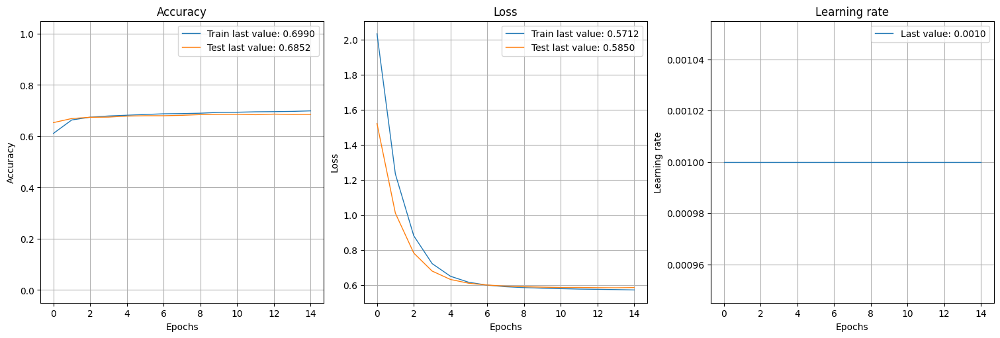

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


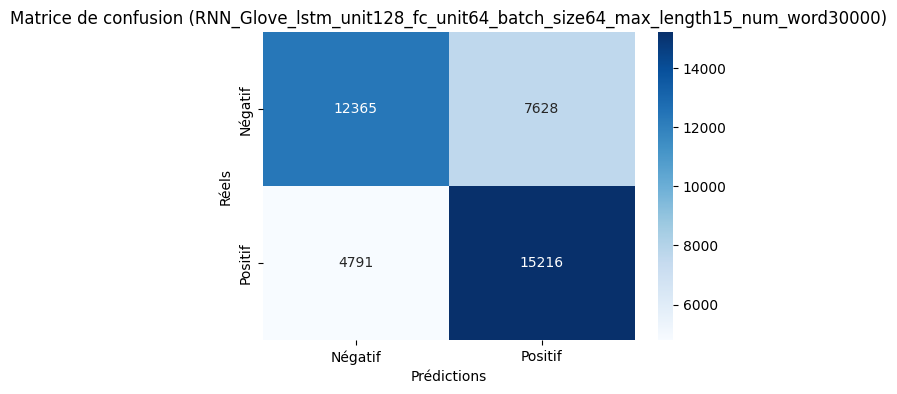

2025/03/08 19:35:49 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 19:36:01 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit64_batch_size64_max_length15_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 32s 15ms/step - accuracy: 0.5798 - loss: 2.3269 - val_accuracy: 0.6646 - val_loss: 1.5065 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6617 - loss: 1.3557 - val_accuracy: 0.6741 - val_loss: 1.0017 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 15ms/step - accuracy: 0.6739 - loss: 0.9350 - val_accuracy: 0.6777 - val_loss: 0.7769 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6777 - loss: 0.7462 - val_accuracy: 0.6815 - val_loss: 0.6744 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 16ms/step - accuracy: 0.6829 - loss: 0.6581 - val_accuracy: 0.6808 - val_loss: 0.6290 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━

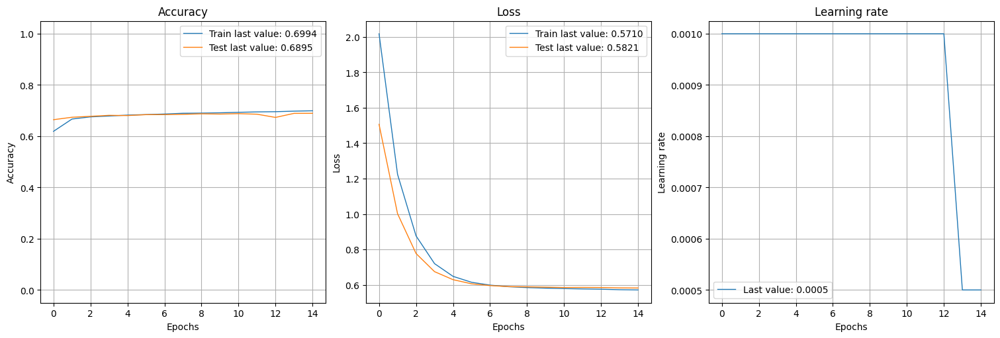

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


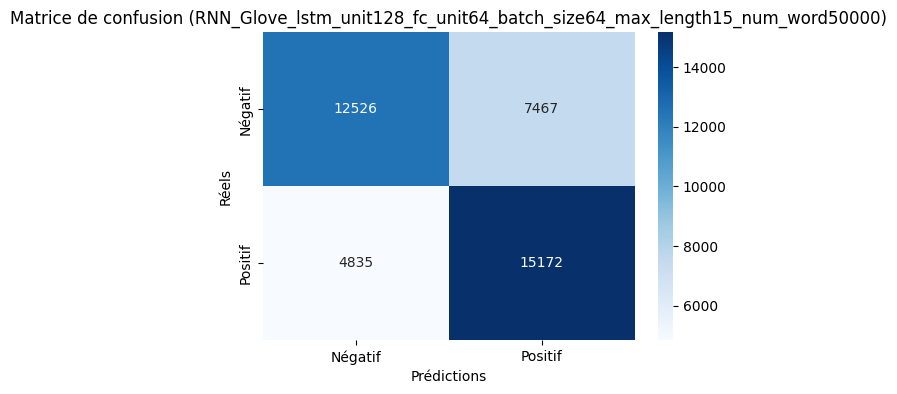

2025/03/08 19:44:24 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 19:44:36 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit64_batch_size64_max_length30_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 62s 30ms/step - accuracy: 0.5880 - loss: 2.3220 - val_accuracy: 0.6808 - val_loss: 1.4891 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 59s 29ms/step - accuracy: 0.6866 - loss: 1.3350 - val_accuracy: 0.6952 - val_loss: 0.9822 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 58s 29ms/step - accuracy: 0.6980 - loss: 0.9116 - val_accuracy: 0.7011 - val_loss: 0.7558 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 58s 29ms/step - accuracy: 0.7042 - loss: 0.7220 - val_accuracy: 0.7026 - val_loss: 0.6543 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 58s 29ms/step - accuracy: 0.7081 - loss: 0.6351 - val_accuracy: 0.7039 - val_loss: 0.6078 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

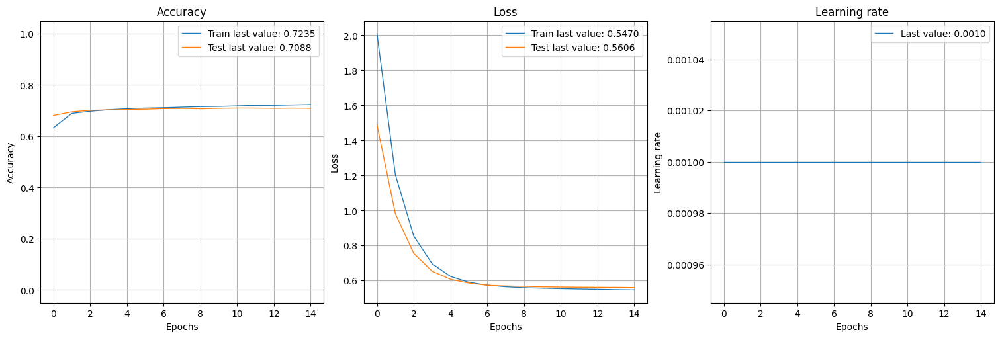

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 12s 9ms/step


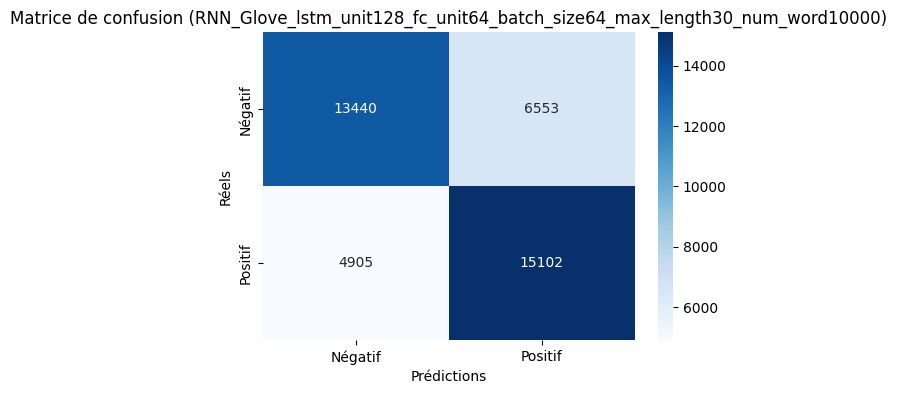

2025/03/08 20:00:11 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 20:00:23 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit64_batch_size64_max_length30_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 60s 29ms/step - accuracy: 0.6071 - loss: 2.3136 - val_accuracy: 0.6876 - val_loss: 1.4858 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 56s 28ms/step - accuracy: 0.6902 - loss: 1.3339 - val_accuracy: 0.6945 - val_loss: 0.9825 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 56s 28ms/step - accuracy: 0.7000 - loss: 0.9109 - val_accuracy: 0.6994 - val_loss: 0.7567 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 57s 28ms/step - accuracy: 0.7062 - loss: 0.7203 - val_accuracy: 0.7020 - val_loss: 0.6538 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 57s 28ms/step - accuracy: 0.7055 - loss: 0.6365 - val_accuracy: 0.7034 - val_loss: 0.6073 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━━

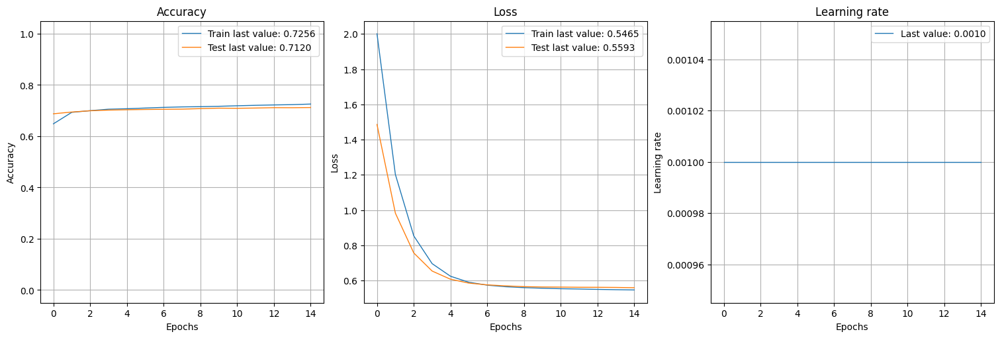

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 11s 9ms/step


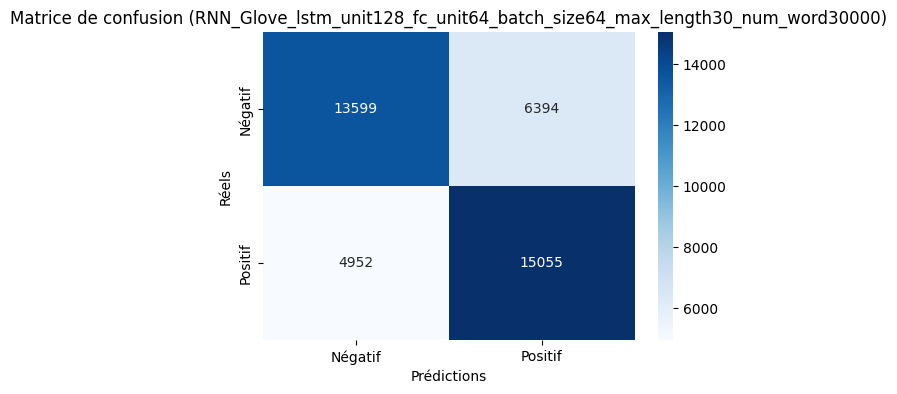

2025/03/08 20:15:36 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 20:15:48 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit64_batch_size64_max_length30_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 57s 28ms/step - accuracy: 0.5973 - loss: 2.3221 - val_accuracy: 0.6842 - val_loss: 1.4884 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 56s 28ms/step - accuracy: 0.6871 - loss: 1.3357 - val_accuracy: 0.6948 - val_loss: 0.9837 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 27ms/step - accuracy: 0.6999 - loss: 0.9115 - val_accuracy: 0.6999 - val_loss: 0.7576 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 27ms/step - accuracy: 0.7052 - loss: 0.7231 - val_accuracy: 0.7037 - val_loss: 0.6548 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 55s 28ms/step - accuracy: 0.7052 - loss: 0.6371 - val_accuracy: 0.6992 - val_loss: 0.6143 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━

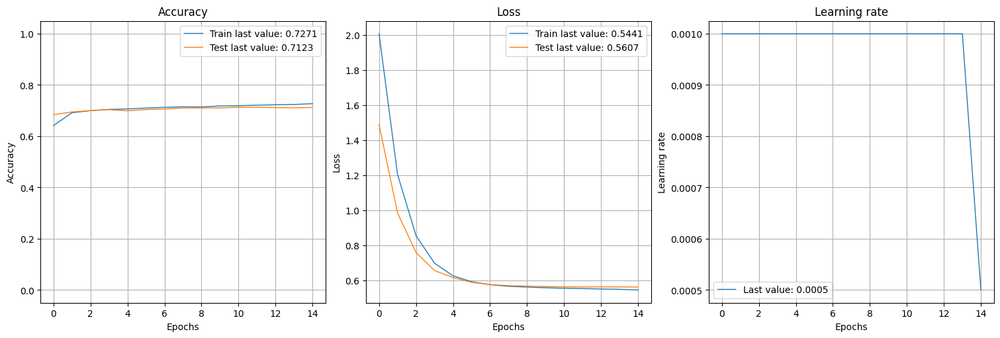

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 11s 8ms/step


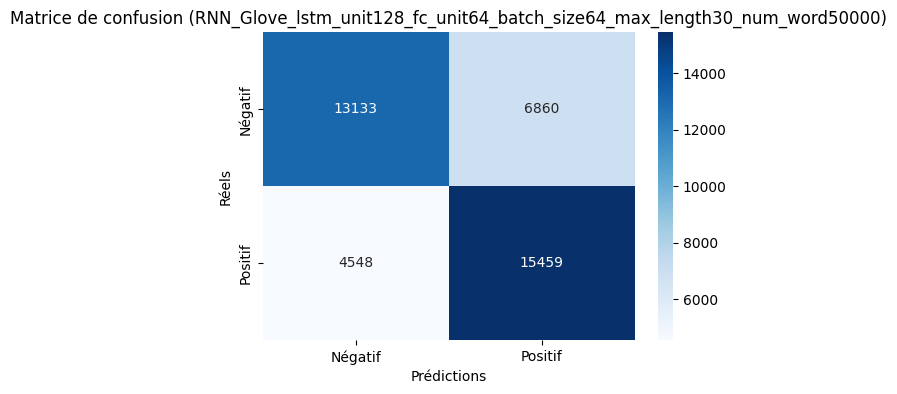

2025/03/08 20:30:21 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 20:30:33 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit128_batch_size64_max_length15_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 32s 15ms/step - accuracy: 0.5678 - loss: 2.6854 - val_accuracy: 0.6598 - val_loss: 1.7030 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 14ms/step - accuracy: 0.6608 - loss: 1.5175 - val_accuracy: 0.6714 - val_loss: 1.0912 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 14ms/step - accuracy: 0.6728 - loss: 1.0069 - val_accuracy: 0.6766 - val_loss: 0.8164 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 14ms/step - accuracy: 0.6802 - loss: 0.7766 - val_accuracy: 0.6778 - val_loss: 0.6938 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 29s 14ms/step - accuracy: 0.6798 - loss: 0.6753 - val_accuracy: 0.6816 - val_loss: 0.6374 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━

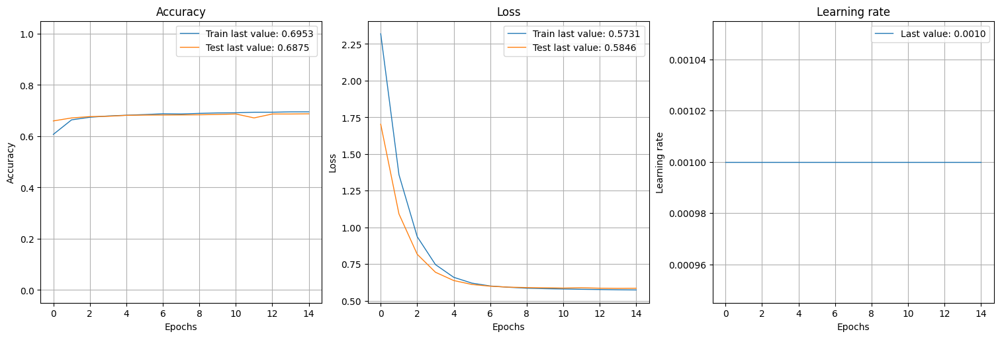

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


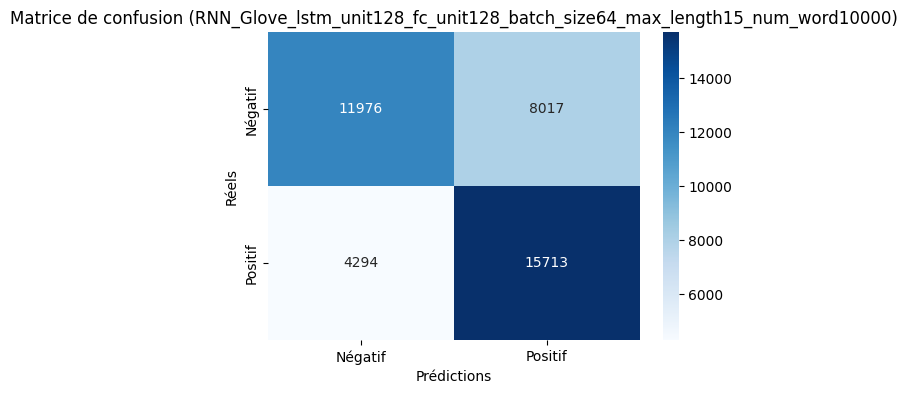

2025/03/08 20:38:39 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 20:38:51 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit128_batch_size64_max_length15_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 34s 16ms/step - accuracy: 0.5696 - loss: 2.6969 - val_accuracy: 0.6620 - val_loss: 1.7080 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 15ms/step - accuracy: 0.6625 - loss: 1.5220 - val_accuracy: 0.6744 - val_loss: 1.0921 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 15ms/step - accuracy: 0.6754 - loss: 1.0082 - val_accuracy: 0.6790 - val_loss: 0.8167 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 31s 16ms/step - accuracy: 0.6781 - loss: 0.7783 - val_accuracy: 0.6786 - val_loss: 0.6946 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 32s 16ms/step - accuracy: 0.6792 - loss: 0.6764 - val_accuracy: 0.6814 - val_loss: 0.6363 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━

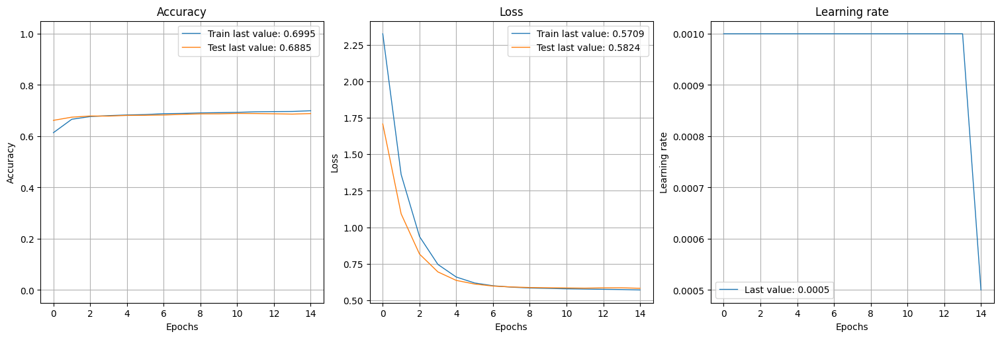

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


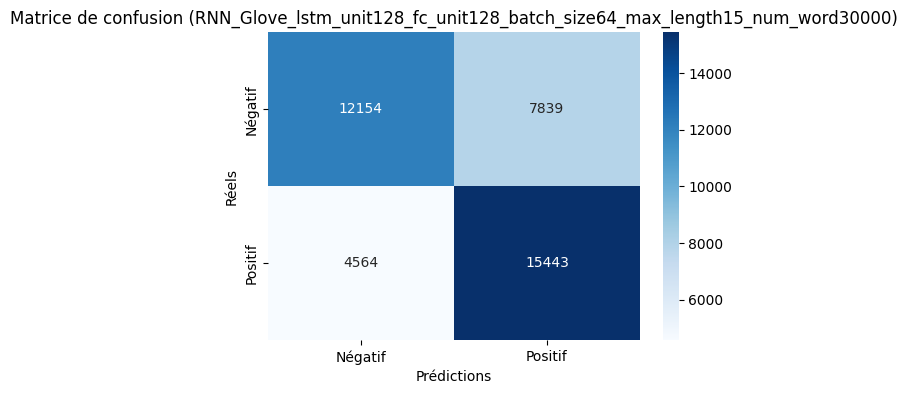

2025/03/08 20:47:28 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 20:47:40 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit128_batch_size64_max_length15_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 33s 15ms/step - accuracy: 0.5824 - loss: 2.6911 - val_accuracy: 0.6607 - val_loss: 1.7074 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6636 - loss: 1.5217 - val_accuracy: 0.6716 - val_loss: 1.0924 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6750 - loss: 1.0068 - val_accuracy: 0.6778 - val_loss: 0.8166 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6789 - loss: 0.7792 - val_accuracy: 0.6791 - val_loss: 0.6932 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 30s 15ms/step - accuracy: 0.6824 - loss: 0.6739 - val_accuracy: 0.6794 - val_loss: 0.6371 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━

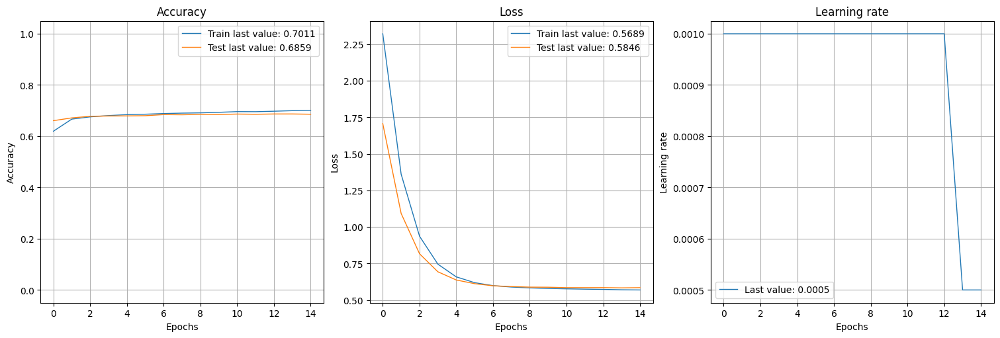

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step


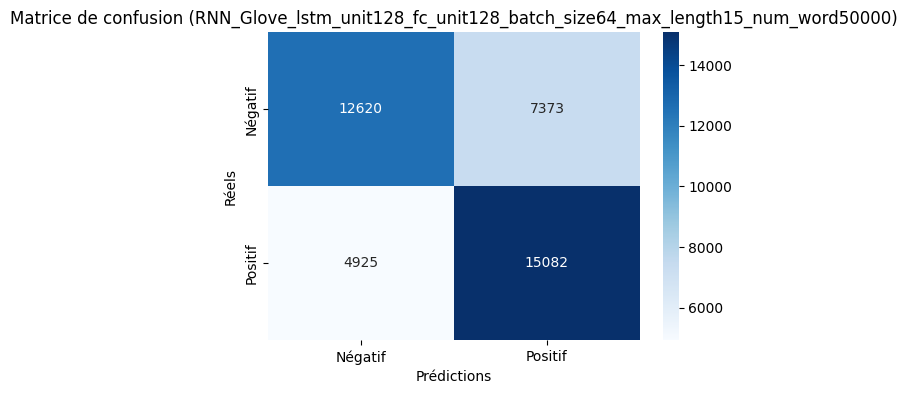

2025/03/08 20:56:05 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 20:56:17 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5262/10000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit128_batch_size64_max_length30_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 57s 27ms/step - accuracy: 0.5909 - loss: 2.6775 - val_accuracy: 0.6809 - val_loss: 1.6828 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 27ms/step - accuracy: 0.6844 - loss: 1.4971 - val_accuracy: 0.6914 - val_loss: 1.0708 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 27ms/step - accuracy: 0.6960 - loss: 0.9853 - val_accuracy: 0.6991 - val_loss: 0.7955 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 55s 28ms/step - accuracy: 0.7017 - loss: 0.7560 - val_accuracy: 0.6998 - val_loss: 0.6733 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 27ms/step - accuracy: 0.7046 - loss: 0.6529 - val_accuracy: 0.7017 - val_loss: 0.6181 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━

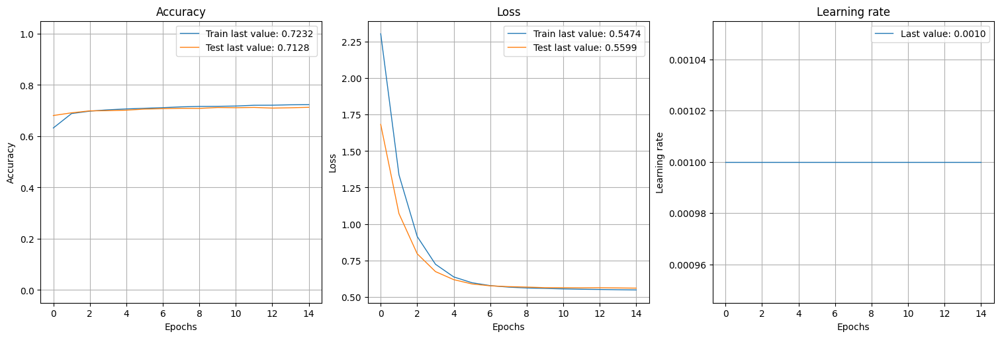

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 11s 8ms/step


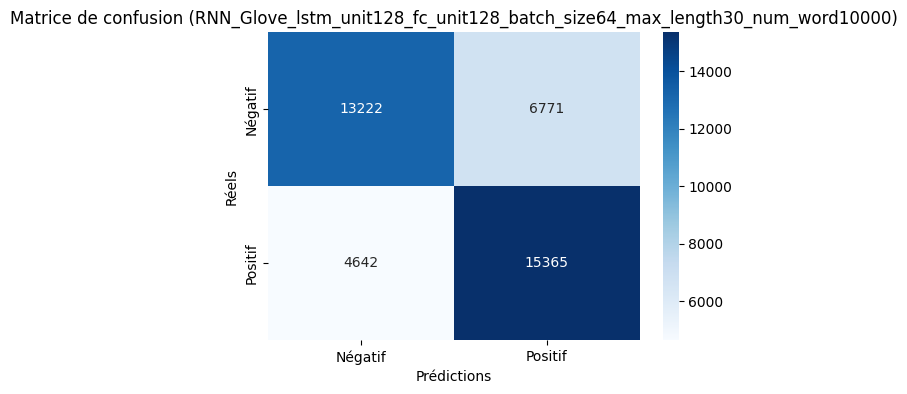

2025/03/08 21:10:42 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 21:10:54 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9357/30000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit128_batch_size64_max_length30_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 67s 31ms/step - accuracy: 0.6042 - loss: 2.6760 - val_accuracy: 0.6838 - val_loss: 1.6826 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 58s 29ms/step - accuracy: 0.6888 - loss: 1.4966 - val_accuracy: 0.6949 - val_loss: 1.0689 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 58s 29ms/step - accuracy: 0.7003 - loss: 0.9825 - val_accuracy: 0.6992 - val_loss: 0.7947 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 57s 29ms/step - accuracy: 0.7013 - loss: 0.7558 - val_accuracy: 0.7017 - val_loss: 0.6708 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 57s 28ms/step - accuracy: 0.7087 - loss: 0.6501 - val_accuracy: 0.7037 - val_loss: 0.6135 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━━

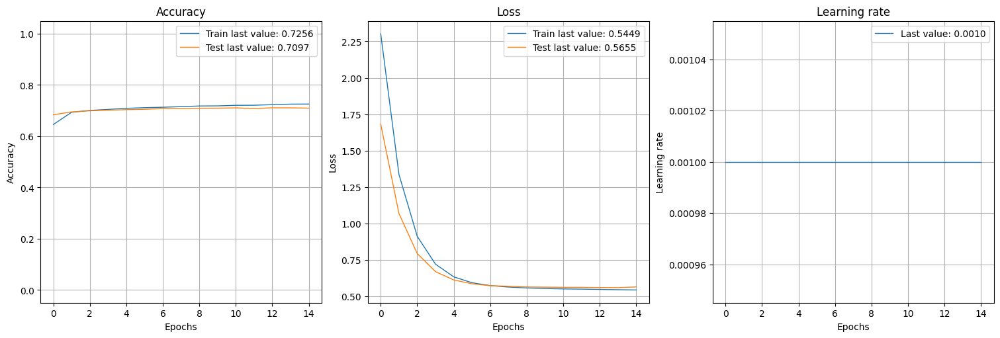

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 11s 9ms/step


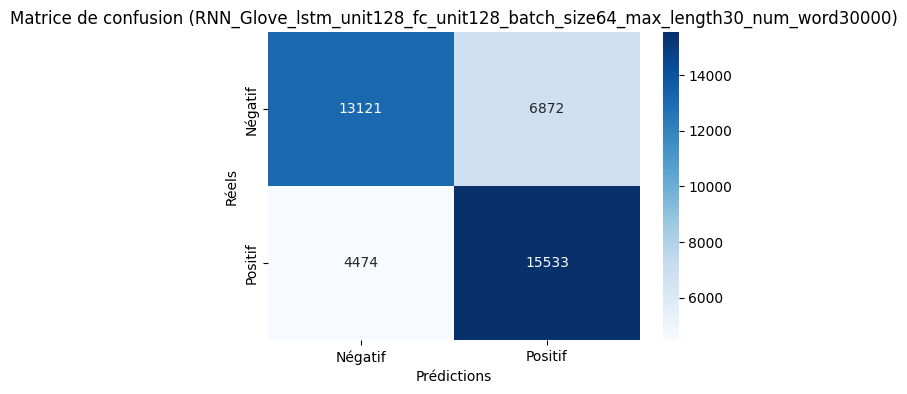

2025/03/08 21:26:16 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 21:26:29 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 12151/50000
-----------------------------------------------------------------------------
RNN_Glove_lstm_unit128_fc_unit128_batch_size64_max_length30_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 59s 28ms/step - accuracy: 0.5791 - loss: 2.6885 - val_accuracy: 0.6814 - val_loss: 1.6862 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 56s 28ms/step - accuracy: 0.6851 - loss: 1.4997 - val_accuracy: 0.6967 - val_loss: 1.0686 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 56s 28ms/step - accuracy: 0.6992 - loss: 0.9867 - val_accuracy: 0.6971 - val_loss: 0.7966 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 55s 28ms/step - accuracy: 0.7071 - loss: 0.7530 - val_accuracy: 0.7045 - val_loss: 0.6706 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 55s 27ms/step - accuracy: 0.7073 - loss: 0.6527 - val_accuracy: 0.7057 - val_loss: 0.6145 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━

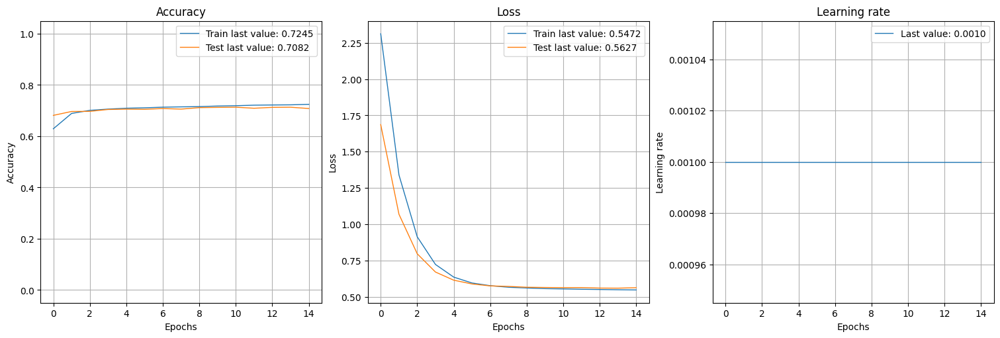

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 11s 9ms/step


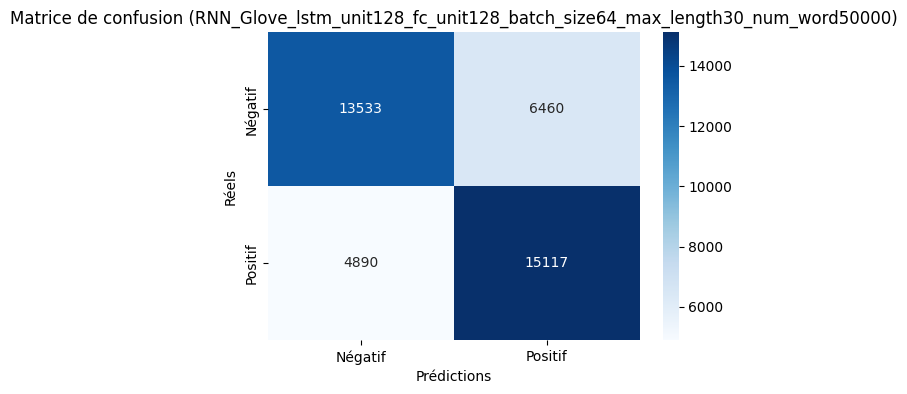

2025/03/08 21:41:25 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/08 21:41:37 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Tests d'hyperparamètres terminés et métriques enregistrées dans MLflow.


In [ ]:
# Hyperparamètres à tester
embedding_dim = 100  # Tailles des embeddings
lstm_units = [32,64, 128] # Nombre d'unités LSTM
fc_units = [32,64, 128]   # Nombre d'unités Dense
cnn_filters = 64  # Présence ou absence de CNN
kernel_size = 3  # Taille du noyau CNN
batch_sizes = [32,64]
epochs = 15
dropout_rate =  0.6 # Différents taux de dropout
max_length_list = [15,30]  # Longueur maximale des séquences

# Différentes stratégies de tokenization
num_word_list =  [10000,30000,50000]  # Taille du vocabulaire
best_recall_class_0 = 0


# Enregistrement avec MLflow
for batch_size,lstm_unit,fc_unit,max_length,num_word in product(batch_sizes,lstm_units,fc_units,max_length_list,num_word_list):

    run_name = f"RNN_Glove_lstm_unit{lstm_unit}_fc_unit{fc_unit}_batch_size{batch_size}_max_length{max_length}_num_word{num_word}"

    with mlflow.start_run(experiment_id='342420157858240682', run_name=run_name):
        mlflow.log_param("embedding_dim", embedding_dim)
        mlflow.log_param("lstm_units", lstm_unit)
        mlflow.log_param("fc_units", fc_units)
        mlflow.log_param("cnn_filters", cnn_filters)
        mlflow.log_param("batch_size", batch_size)
        mlflow.log_param("epochs", epochs)
        mlflow.log_param("dropout_rate", dropout_rate)
        mlflow.log_param("num_words", num_word)
        mlflow.log_param("max_length", max_length)

        # Prétraitement des données
        # Réservons deux nombres pour les tokens spéciaux : un pour les mots hors dictionnaire ('UNK') et l'autre pour la sequence ('PAD').
        most_used_words = [token for token, count in sorted_token_count[:num_word-2]]
        # dictionnaire mots vers indices
        word_to_idx = {}
        # dictionnaire  indices vers mots
        idx_to_word = {}

        # Inclusion du premier token d'abord
        PAD_token = 0
        UNK_token = 1

        word_to_idx['PAD'] = PAD_token
        word_to_idx['UNK'] = UNK_token

        idx_to_word[PAD_token] = 'PAD'
        idx_to_word[UNK_token] = 'UNK'

        # Remplissage du dictionnaire avec les mots les plus fréquents
        for num,word in enumerate(most_used_words):
          word_to_idx[word] = num + 2
          idx_to_word[num+2] = word

        X_train_idx = tokens_to_idx(X_train['token_by_tweet_finalised_sans_racinisation'],word_to_idx)
        X_val_idx = tokens_to_idx(X_val['token_by_tweet_finalised_sans_racinisation'],word_to_idx)
        X_test_idx = tokens_to_idx(X_test['token_by_tweet_finalised_sans_racinisation'],word_to_idx)

        X_train_pad = padding(X_train_idx,max_length)
        X_val_pad = padding(X_val_idx,max_length)
        X_test_pad = padding(X_test_idx,max_length)

        # Ajout de bruit dans les données d'entrainement
        # X_train_pad_noisy = X_train_pad + np.random.normal(0.0, 0.01,X_train_pad.shape)

        # One hot encoding
        y_train_categorical = to_categorical(X_train['target'], num_classes=2)
        y_val_categorical = to_categorical(X_val['target'], num_classes=2)
        y_test_categorical =to_categorical(X_test['target'], num_classes=2)

        embedding_matrix,vocab_size = load_glove_embeddings('D:\\tutorial-env\\OCR\\Projet7\glove.twitter.27B.100d.txt', word_to_idx, embedding_dim)

        mlflow.log_param("max_vocab_size", vocab_size)

        # Définition du modèle
        model = Sequential()
        model.add(Embedding(input_dim=vocab_size, output_dim=embedding_dim, weights=[embedding_matrix],input_length=max_length, trainable=False))

        if cnn_filters:
            model.add(Conv1D(filters=cnn_filters, kernel_size=kernel_size, activation='relu'))
            model.add(MaxPooling1D(pool_size=2))
            model.add(BatchNormalization())

        model.add(LSTM(lstm_unit, return_sequences=False, kernel_regularizer=l2(0.01)))
        model.add(Dropout(dropout_rate))
        model.add(Dense(fc_unit, activation='relu', kernel_regularizer=l2(0.01)))
        model.add(Dense(2, activation='softmax'))

        model.compile(optimizer=SGD(learning_rate=0.001, momentum=0.9), loss='categorical_crossentropy', metrics=['accuracy'])

        lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=1e-6)
        es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
        callbacks_list = [lr, es]

        # On accorde plus de poids aux erreurs sur la classe 0 dans notre mission
        # class_weight = {0: 1.5, 1: 1.0}

        print("-----------------------------------------------------------------------------")
        print(f"{run_name}")

        history = model.fit(
            X_train_pad, y_train_categorical,
            validation_data=(X_val_pad, y_val_categorical),
            batch_size=batch_size,
            epochs=epochs,
            callbacks=callbacks_list
            # class_weight=class_weight
        )

        # Courbe d'entrainement et de validation
        # plot_training_history(history)
        show_history(history)
        plot_history(history, path=f"D:/tutorial-env/OCR/Projet7/save/{run_name}.png")
        plt.close()


        # Journalisation des métriques dans MLflow
        mlflow.log_metric("final_train_accuracy", history.history['accuracy'][-1])
        mlflow.log_metric("final_val_accuracy", history.history['val_accuracy'][-1])

        # Évaluation
        y_pred_proba = model.predict(X_test_pad)
        y_pred = (y_pred_proba > 0.5).astype(int)
        test_accuracy = accuracy_score(y_test_categorical, y_pred)
        test_recall = recall_score(y_test_categorical, y_pred, average = 'macro')
        test_f1 = f1_score(y_test_categorical, y_pred, average = 'macro')
        test_roc_auc = roc_auc_score(y_test_categorical, y_pred_proba, average = 'macro')
        report = classification_report(y_test_categorical, y_pred, output_dict=True)
        recall_class_0 = report['0']['recall']

        # Visualisation distribution des probas
        # plt.hist(y_pred_proba, bins=50, edgecolor='k')
        # plt.title('Distribution des prédictions')

        mlflow.log_metric("test_accuracy", test_accuracy)
        mlflow.log_metric("test_recall", test_recall.item())
        mlflow.log_metric("test_f1", test_f1.item())
        mlflow.log_metric("test_roc_auc", test_roc_auc.item())
        mlflow.log_metric("recall_class_0", recall_class_0)

        # Matrice de confusion
        y_test_labels = y_test_categorical.argmax(axis=1)
        y_pred_labels = y_pred.argmax(axis=1)
        conf_matrix = confusion_matrix(y_test_labels, y_pred_labels)
        plt.figure(figsize=(6, 4))
        sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=["Négatif", "Positif"],
                    yticklabels=["Négatif", "Positif"])
        plt.xlabel("Prédictions")
        plt.ylabel("Réels")
        plt.title(f"Matrice de confusion ({run_name})")
        plt.show()


        # Enregistrement du modèle
        mlflow.tensorflow.log_model(model, run_name)
        if recall_class_0>best_recall_class_0:
          best_recall_class_0 = recall_class_0
          best_run_name = run_name
          model.save(f"D:/tutorial-env/OCR/Projet7/save/{best_run_name}.h5")
          plt.savefig(f"D:/tutorial-env/OCR/Projet7/save/confusion_matrix_{best_run_name}.png")
          mlflow.log_artifact(f"D:/tutorial-env/OCR/Projet7/save/confusion_matrix_{best_run_name}.png")
        plt.close()

print("Tests d'hyperparamètres terminés et métriques enregistrées dans MLflow.")

In [ ]:
process = subprocess.Popen(["mlflow", "ui", "--backend-store-uri", "file:/D:/tutorial-env/OCR/Projet7/mlruns", "--port", "5006"],stdout = subprocess.PIPE, stderr = subprocess.PIPE)
time.sleep(1)
webbrowser.open("http://localhost:5006")
print(f"MLFlow lancé")

MLFlow lancé


Pour anticiper les bad buzz, nous privilégierons un fort recall pour la classe négative 0. Cela permet de diminuer la mauvaise classification des tweets négatifs sans pour autant tout classifier en négatif.

Dans ce cas du RNN avec les embeddings GloVe, les meilleurs résultats sont avec les hyperparamètres suivants :
- Taille des embeddings : 100
- Nombre d'unités LSTM : 32
- Nombre d'unités Dense : 128
- Batch size : 64
- Taux de dropout : 0.6
- Longueur max des séquences : 15
- Taille de vocabulaire :  30000

Résultats :
- un recall de 74% pour la classe négative,
- un f1 score de 67%,
- et une aire sous la courbe ROC de 0.76 (bonne capacité à distinguer les deux classes),
- la matrice de confusion montre un minimum de 5192 tweets négatifs manqués.

Voici la matrice de confusion :

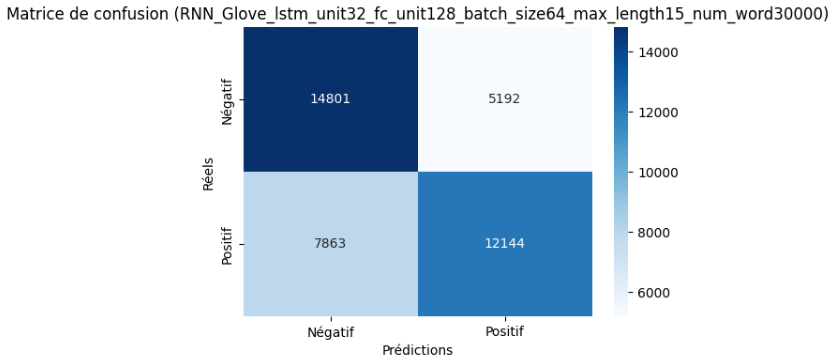

Pour optimiser les résultats et limiter le léger overfitting, il faudrait prendre plus de données mais cela augmenterait drastiquement le temps d'entrainement.

## Embeddings :

# FastText

Les embeddings FastText, développés par Facebook, sont des vecteurs de mots pré-entrainés qui tiennent compte des sous-mots pour mieux gérer les mots rares ou mal orthographiés.

Nous initialiserons donc notre couche d'embedding avec ces vecteurs et les garderons fixes.

## Embeddings :

In [ ]:
# Importation des embedding FastText pour les tweets
url = "https://dl.fbaipublicfiles.com/fasttext/vectors-crawl/cc.en.300.vec.gz"
output_zip_path = "D:\\tutorial-env\\OCR\\Projet7\\cc.en.300.vec.gz"
response = requests.get(url,stream = True)
with open(output_zip_path, "wb") as f:
    f.write(response.content)
print("téléchargement terminé")

téléchargement terminé


In [ ]:
# Extraction du fichier zip
with gzip.open(output_zip_path, 'rb') as gz:
  with open("D:\\tutorial-env\\OCR\\Projet7\\cc.en.300.vec.txt", 'wb') as out:
    shutil.copyfileobj(gz, out)
print("extraction terminé")

os.remove(output_zip_path)
print("fichier zip supprimé")

extraction terminé
fichier zip supprimé


In [ ]:
def load_fastext_embeddings(fastext_file_path, word_index, embedding_dim):
    """
    Charge les embeddings fastext et crée une matrice d'embeddings utilisable dans Keras.

    Params:
    - fastext_file_path (str) : chemin vers le fichier fastext (.txt)
    - word_index (dict) : dictionnaire {mot: index} du tokenizer Keras
    - embedding_dim (int) : dimension des embeddings fastext utilisés

    Return:
    - embedding_matrix (numpy array) : matrice d'embeddings prête à l'emploi
    """
    embeddings_index = {}
    with open(fastext_file_path, encoding="utf-8") as f:
        for line in f:
            values = line.rstrip().split(" ")
            word = values[0]
            coefs = np.asarray(values[1:], dtype='float32')
            embeddings_index[word] = coefs

    f = sum(1 for word in word_index if word in embeddings_index)
    print(f"Couverture  du vocabulaire : {f}/{len(word_index)}")

    vocab_size = len(word_index) + 1  # +1 pour le token "OOV"
    embedding_matrix = np.zeros((vocab_size, embedding_dim))

    for word, i in word_index.items():
        embedding_vector = embeddings_index.get(word)
        if embedding_vector is not None:
            embedding_matrix[i] = embedding_vector  # Mot trouvé → utiliser fastext

    return embedding_matrix, vocab_size

## Modèle de RNN :

Couverture  du vocabulaire : 5317/10000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit32_batch_size32_max_length15_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 80s 19ms/step - accuracy: 0.5831 - loss: 1.8415 - val_accuracy: 0.6461 - val_loss: 0.9511 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 71s 18ms/step - accuracy: 0.6690 - loss: 0.8452 - val_accuracy: 0.6778 - val_loss: 0.6679 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 71s 18ms/step - accuracy: 0.6802 - loss: 0.6450 - val_accuracy: 0.6792 - val_loss: 0.6113 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 71s 18ms/step - accuracy: 0.6839 - loss: 0.5994 - val_accuracy: 0.6804 - val_loss: 0.5961 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 70s 18ms/step - accuracy: 0.6903 - loss: 0.5859 - val_accuracy: 0.6830 - val_loss: 0.5910 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━

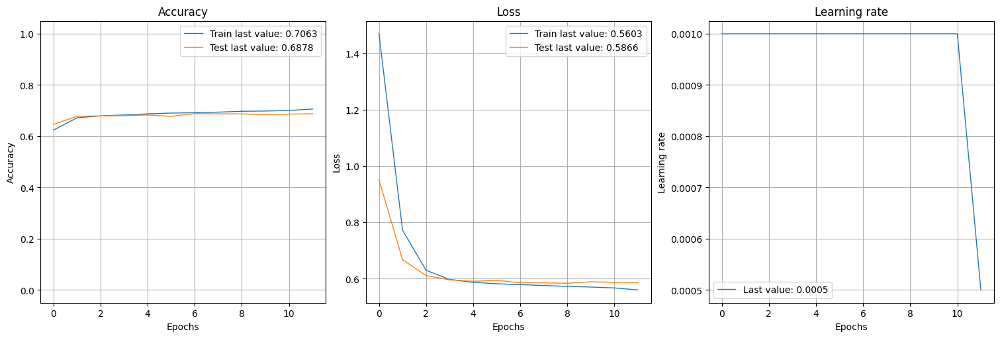

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 12s 9ms/step


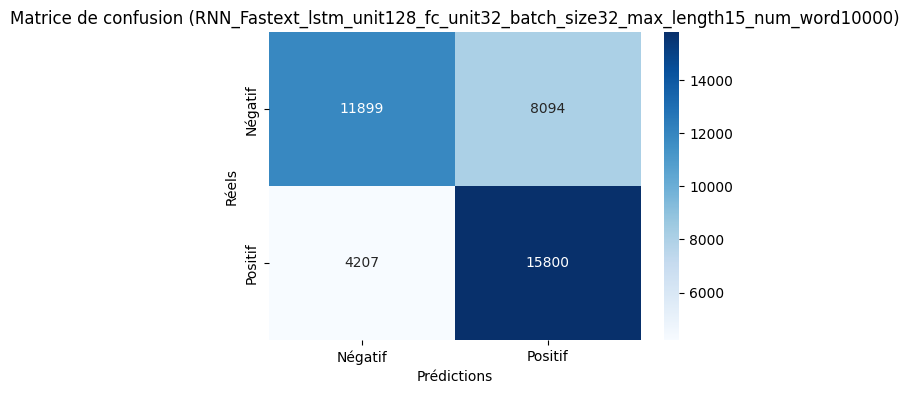

2025/03/10 14:24:41 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 14:25:08 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9340/30000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit32_batch_size32_max_length15_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 83s 20ms/step - accuracy: 0.5749 - loss: 1.8486 - val_accuracy: 0.6695 - val_loss: 0.9444 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 79s 20ms/step - accuracy: 0.6666 - loss: 0.8472 - val_accuracy: 0.6747 - val_loss: 0.6699 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 77s 19ms/step - accuracy: 0.6779 - loss: 0.6457 - val_accuracy: 0.6823 - val_loss: 0.6085 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 78s 20ms/step - accuracy: 0.6861 - loss: 0.5977 - val_accuracy: 0.6680 - val_loss: 0.5976 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 77s 19ms/step - accuracy: 0.6867 - loss: 0.5869 - val_accuracy: 0.6812 - val_loss: 0.5920 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━

<Figure size 640x480 with 0 Axes>

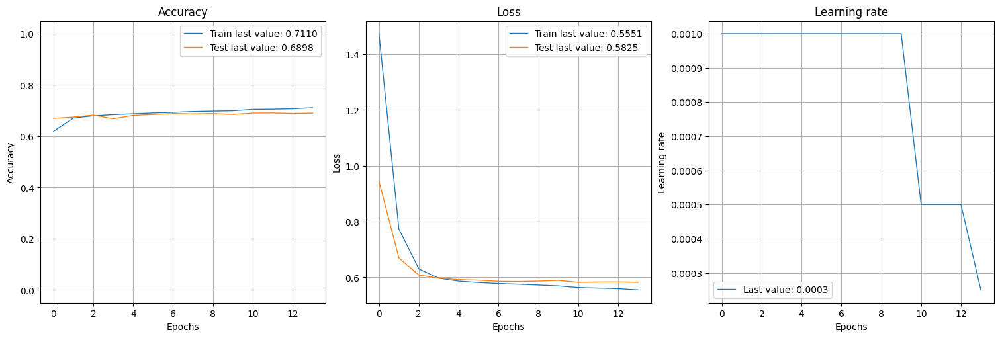

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 9s 7ms/step


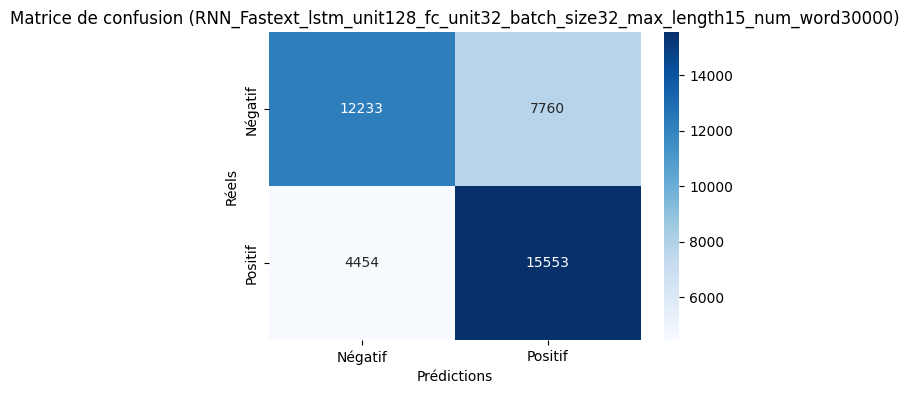

2025/03/10 14:46:35 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 14:47:03 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 11938/50000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit32_batch_size32_max_length15_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 80s 19ms/step - accuracy: 0.5814 - loss: 1.8233 - val_accuracy: 0.6649 - val_loss: 0.9387 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 75s 19ms/step - accuracy: 0.6731 - loss: 0.8373 - val_accuracy: 0.6785 - val_loss: 0.6653 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 72s 18ms/step - accuracy: 0.6821 - loss: 0.6411 - val_accuracy: 0.6817 - val_loss: 0.6087 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 74s 18ms/step - accuracy: 0.6884 - loss: 0.5968 - val_accuracy: 0.6839 - val_loss: 0.5936 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 72s 18ms/step - accuracy: 0.6909 - loss: 0.5853 - val_accuracy: 0.6878 - val_loss: 0.5905 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━

<Figure size 640x480 with 0 Axes>

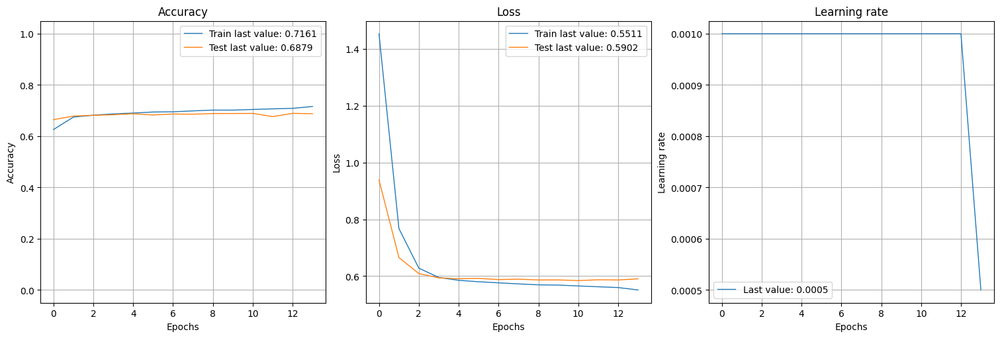

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 12s 9ms/step


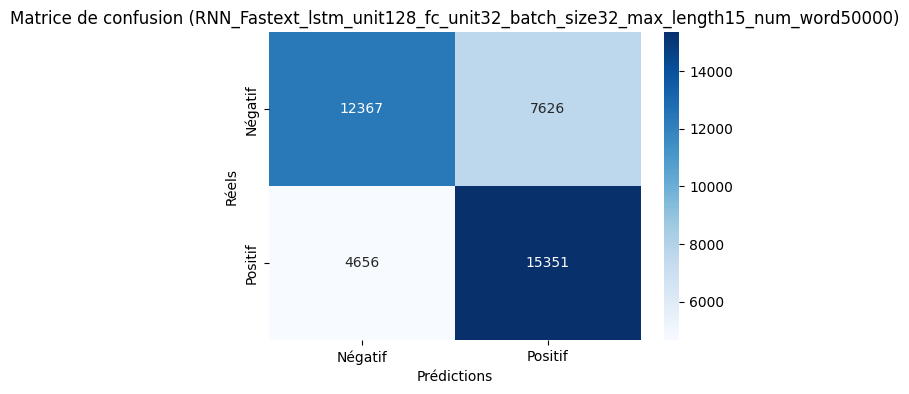

2025/03/10 15:09:16 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 15:09:44 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5317/10000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit32_batch_size32_max_length30_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 144s 35ms/step - accuracy: 0.5714 - loss: 1.8274 - val_accuracy: 0.6339 - val_loss: 0.9680 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 150s 37ms/step - accuracy: 0.6893 - loss: 0.8270 - val_accuracy: 0.6811 - val_loss: 0.6677 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 145s 36ms/step - accuracy: 0.7017 - loss: 0.6279 - val_accuracy: 0.6634 - val_loss: 0.6250 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 142s 35ms/step - accuracy: 0.7057 - loss: 0.5829 - val_accuracy: 0.6869 - val_loss: 0.5839 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 142s 36ms/step - accuracy: 0.7129 - loss: 0.5675 - val_accuracy: 0.7090 - val_loss: 0.5695 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━

<Figure size 640x480 with 0 Axes>

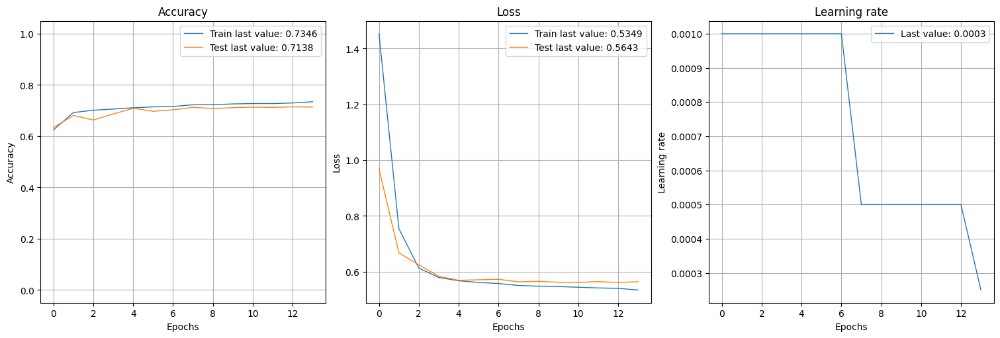

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 19s 15ms/step


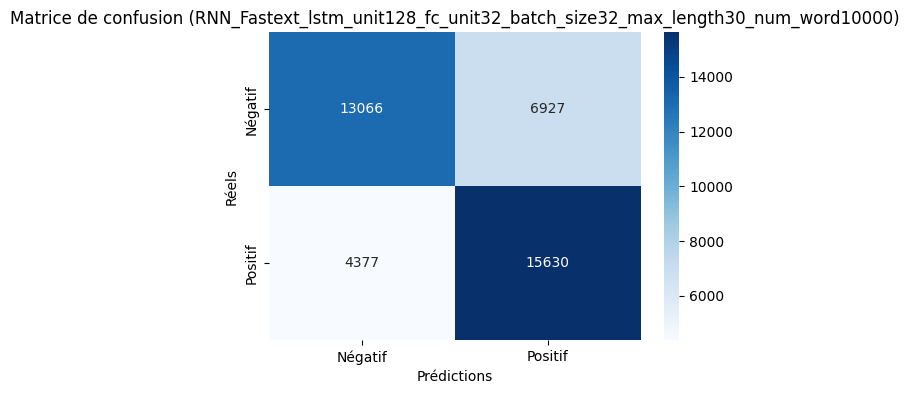

2025/03/10 15:47:26 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 15:47:53 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9340/30000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit32_batch_size32_max_length30_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 153s 37ms/step - accuracy: 0.5797 - loss: 1.8415 - val_accuracy: 0.6897 - val_loss: 0.9270 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 148s 37ms/step - accuracy: 0.6924 - loss: 0.8277 - val_accuracy: 0.6969 - val_loss: 0.6502 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 148s 37ms/step - accuracy: 0.7044 - loss: 0.6240 - val_accuracy: 0.7038 - val_loss: 0.5884 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 146s 36ms/step - accuracy: 0.7096 - loss: 0.5784 - val_accuracy: 0.7011 - val_loss: 0.5774 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 148s 37ms/step - accuracy: 0.7158 - loss: 0.5640 - val_accuracy: 0.7067 - val_loss: 0.5701 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━

<Figure size 640x480 with 0 Axes>

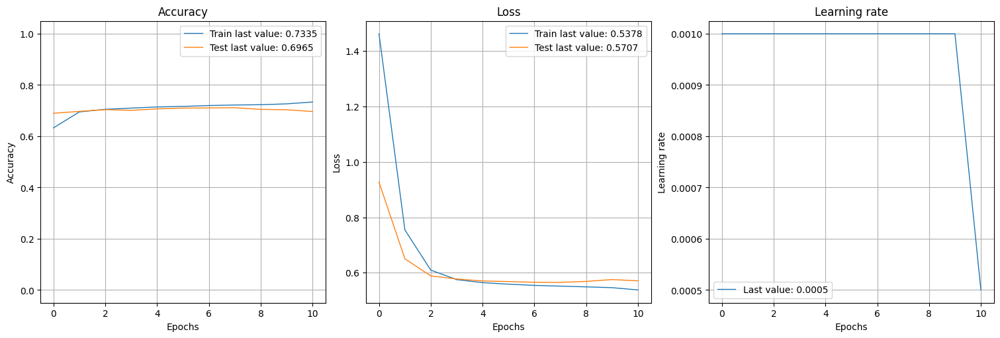

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 18s 14ms/step


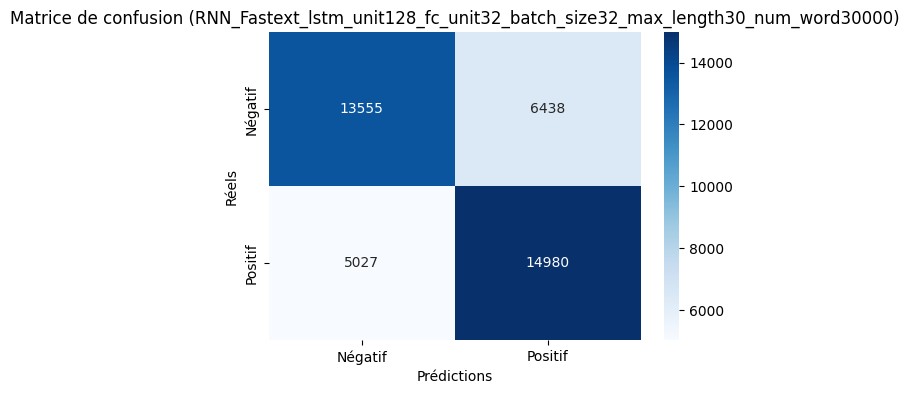

2025/03/10 16:19:55 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 16:20:22 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 11938/50000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit32_batch_size32_max_length30_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 138s 33ms/step - accuracy: 0.5771 - loss: 1.8477 - val_accuracy: 0.6860 - val_loss: 0.9330 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 143s 36ms/step - accuracy: 0.6934 - loss: 0.8276 - val_accuracy: 0.6942 - val_loss: 0.6564 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 134s 34ms/step - accuracy: 0.7024 - loss: 0.6270 - val_accuracy: 0.7029 - val_loss: 0.5917 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 134s 34ms/step - accuracy: 0.7075 - loss: 0.5818 - val_accuracy: 0.6612 - val_loss: 0.6191 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 132s 33ms/step - accuracy: 0.7126 - loss: 0.5660 - val_accuracy: 0.7056 - val_loss: 0.5724 - learning_rate: 0.0010
Epoch 6/15
4000/4000 

<Figure size 640x480 with 0 Axes>

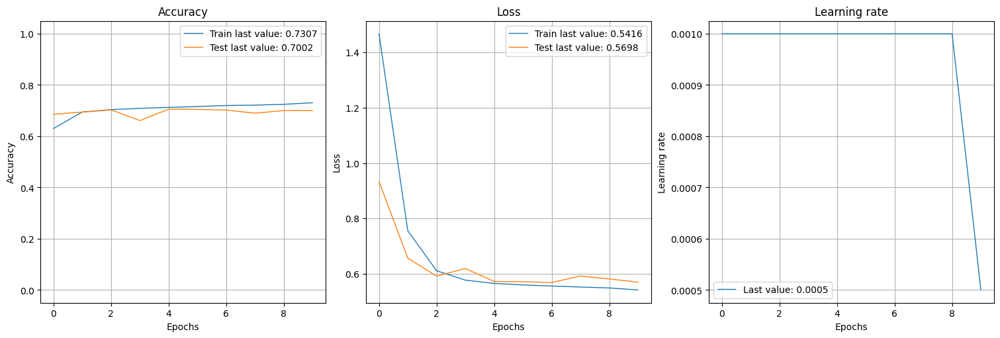

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 20s 16ms/step


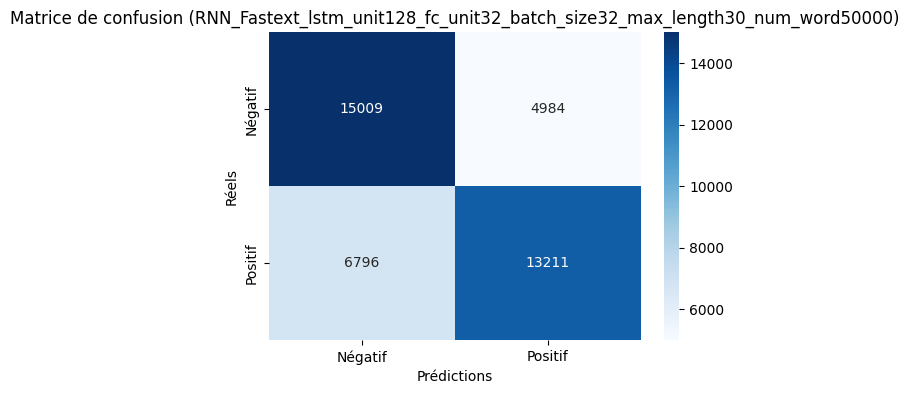

2025/03/10 16:48:31 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 16:48:58 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5317/10000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit32_batch_size64_max_length15_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 62s 29ms/step - accuracy: 0.5527 - loss: 2.0491 - val_accuracy: 0.6485 - val_loss: 1.3622 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 53s 26ms/step - accuracy: 0.6545 - loss: 1.2336 - val_accuracy: 0.6668 - val_loss: 0.9389 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 50s 25ms/step - accuracy: 0.6721 - loss: 0.8799 - val_accuracy: 0.6733 - val_loss: 0.7522 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 43s 22ms/step - accuracy: 0.6788 - loss: 0.7210 - val_accuracy: 0.6771 - val_loss: 0.6652 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 44s 22ms/step - accuracy: 0.6819 - loss: 0.6496 - val_accuracy: 0.6777 - val_loss: 0.6263 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━

<Figure size 640x480 with 0 Axes>

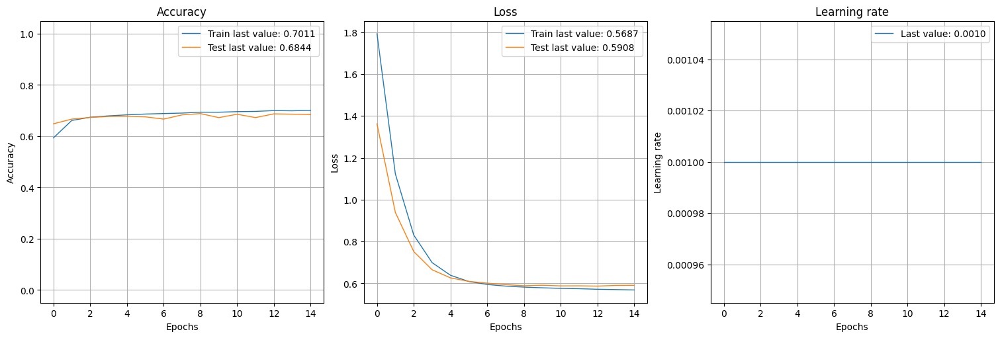

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step


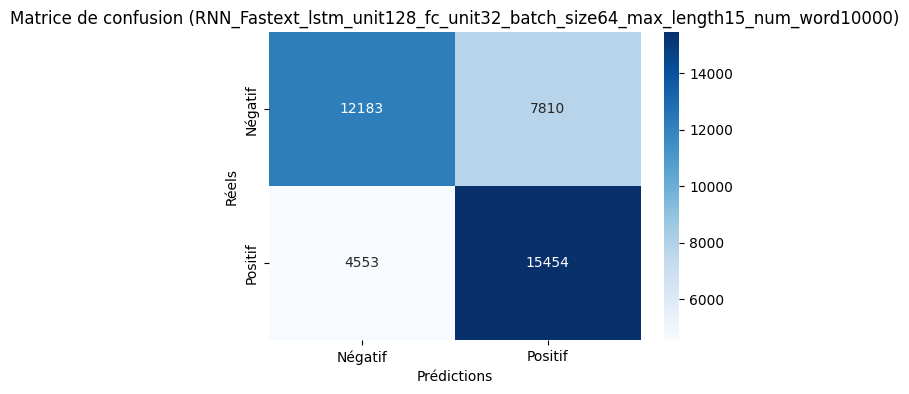

2025/03/10 17:07:44 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 17:08:12 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9340/30000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit32_batch_size64_max_length15_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 65s 31ms/step - accuracy: 0.5619 - loss: 2.0508 - val_accuracy: 0.6593 - val_loss: 1.3587 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 68s 34ms/step - accuracy: 0.6587 - loss: 1.2307 - val_accuracy: 0.6522 - val_loss: 0.9424 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 68s 34ms/step - accuracy: 0.6746 - loss: 0.8780 - val_accuracy: 0.6768 - val_loss: 0.7505 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 69s 34ms/step - accuracy: 0.6816 - loss: 0.7187 - val_accuracy: 0.6797 - val_loss: 0.6651 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 67s 34ms/step - accuracy: 0.6870 - loss: 0.6458 - val_accuracy: 0.6790 - val_loss: 0.6261 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━

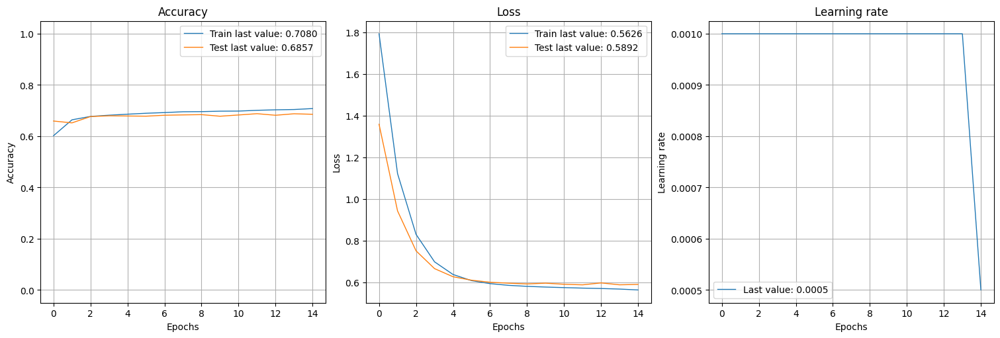

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step


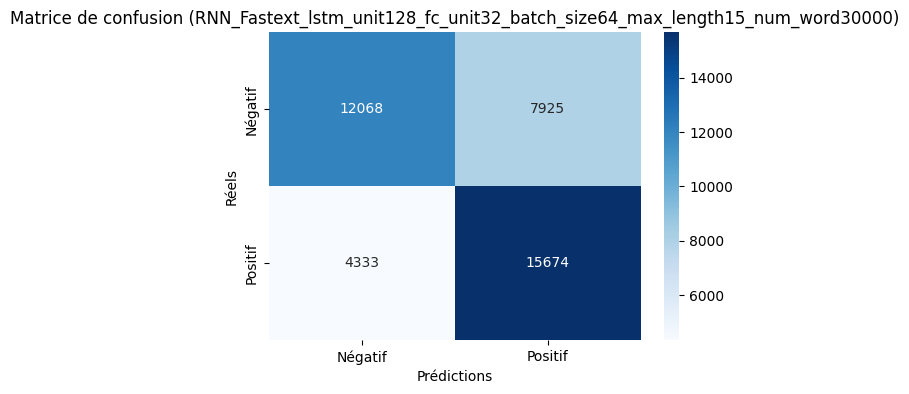

2025/03/10 17:30:21 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 17:36:54 WARNING mlflow.utils.environment: Encountered an unexpected error while inferring pip requirements (model URI: C:\Users\CELINE~1.LES\AppData\Local\Temp\tmpzlp5zi__\model, flavor: tensorflow). Fall back to return ['tensorflow==2.18.0', 'cloudpickle==3.0.0']. Set logging level to DEBUG to see the full traceback. 
2025/03/10 17:36:54 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 11938/50000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit32_batch_size64_max_length15_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 76s 35ms/step - accuracy: 0.5327 - loss: 2.0643 - val_accuracy: 0.6439 - val_loss: 1.3771 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 69s 34ms/step - accuracy: 0.6509 - loss: 1.2456 - val_accuracy: 0.6690 - val_loss: 0.9446 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 67s 34ms/step - accuracy: 0.6724 - loss: 0.8844 - val_accuracy: 0.6673 - val_loss: 0.7594 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 68s 34ms/step - accuracy: 0.6819 - loss: 0.7216 - val_accuracy: 0.6775 - val_loss: 0.6658 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 67s 33ms/step - accuracy: 0.6852 - loss: 0.6492 - val_accuracy: 0.6808 - val_loss: 0.6257 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━

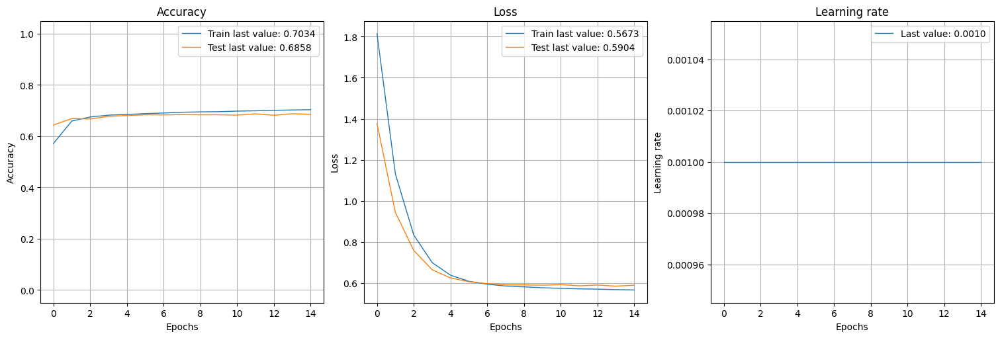

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 14s 11ms/step


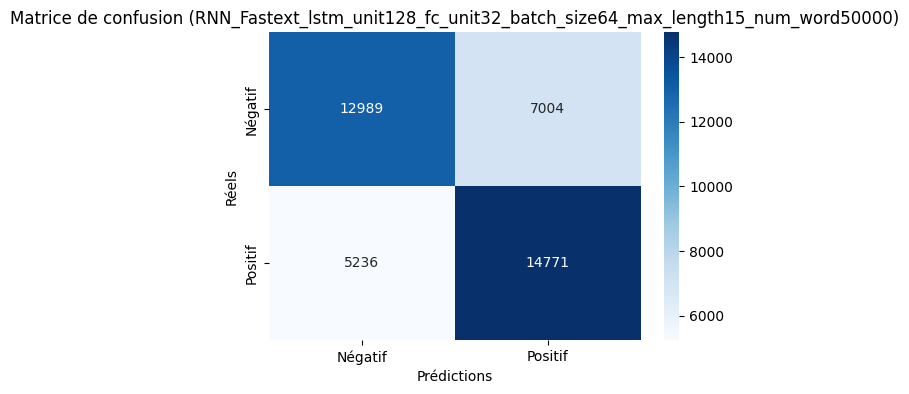

2025/03/10 18:03:02 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 18:03:37 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5317/10000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit32_batch_size64_max_length30_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 90s 42ms/step - accuracy: 0.5524 - loss: 2.0604 - val_accuracy: 0.6513 - val_loss: 1.3708 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 81s 40ms/step - accuracy: 0.6817 - loss: 1.2213 - val_accuracy: 0.6881 - val_loss: 0.9271 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 79s 39ms/step - accuracy: 0.6971 - loss: 0.8633 - val_accuracy: 0.6967 - val_loss: 0.7332 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 79s 39ms/step - accuracy: 0.7040 - loss: 0.7007 - val_accuracy: 0.6887 - val_loss: 0.6497 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 90s 45ms/step - accuracy: 0.7042 - loss: 0.6291 - val_accuracy: 0.6809 - val_loss: 0.6186 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━

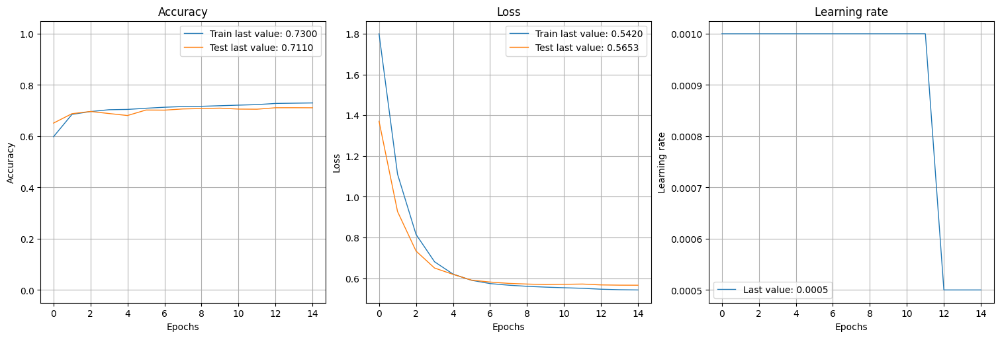

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 15s 12ms/step


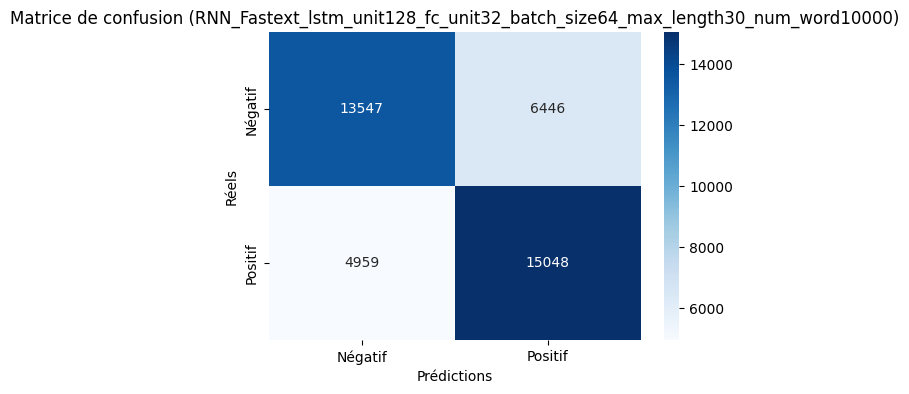

2025/03/10 18:30:48 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 18:31:08 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9340/30000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit32_batch_size64_max_length30_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 86s 42ms/step - accuracy: 0.5649 - loss: 2.0542 - val_accuracy: 0.6651 - val_loss: 1.3545 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 85s 42ms/step - accuracy: 0.6835 - loss: 1.2165 - val_accuracy: 0.6938 - val_loss: 0.9205 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 91s 46ms/step - accuracy: 0.6982 - loss: 0.8614 - val_accuracy: 0.6999 - val_loss: 0.7310 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 89s 44ms/step - accuracy: 0.7058 - loss: 0.6986 - val_accuracy: 0.7018 - val_loss: 0.6447 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 89s 44ms/step - accuracy: 0.7078 - loss: 0.6277 - val_accuracy: 0.7034 - val_loss: 0.6056 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━

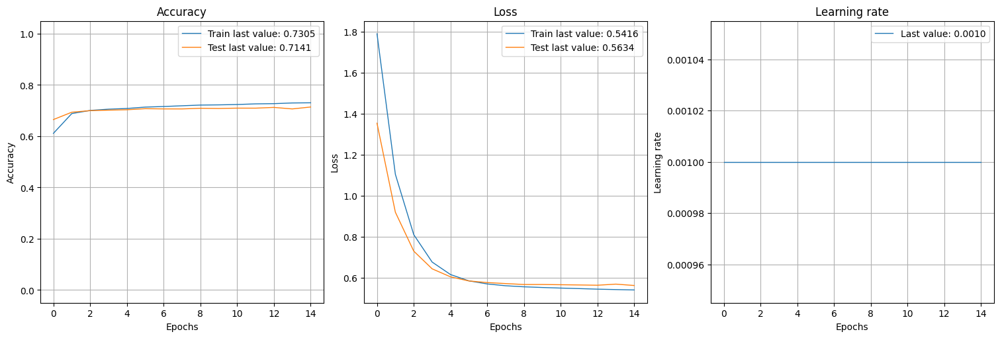

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 16s 13ms/step


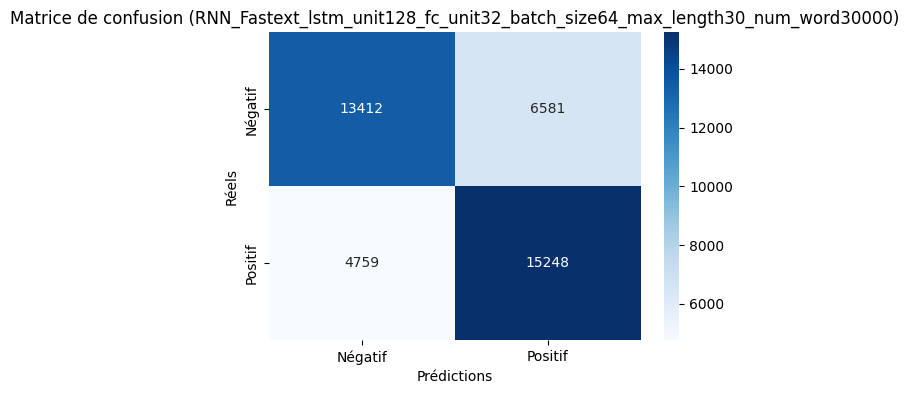

2025/03/10 18:56:03 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 18:56:24 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 11938/50000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit32_batch_size64_max_length30_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 90s 44ms/step - accuracy: 0.5654 - loss: 2.0592 - val_accuracy: 0.6301 - val_loss: 1.3807 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 88s 44ms/step - accuracy: 0.6854 - loss: 1.2200 - val_accuracy: 0.6894 - val_loss: 0.9249 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 87s 43ms/step - accuracy: 0.6954 - loss: 0.8642 - val_accuracy: 0.6954 - val_loss: 0.7342 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 87s 44ms/step - accuracy: 0.7051 - loss: 0.7011 - val_accuracy: 0.7023 - val_loss: 0.6455 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 85s 43ms/step - accuracy: 0.7104 - loss: 0.6271 - val_accuracy: 0.7032 - val_loss: 0.6063 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━

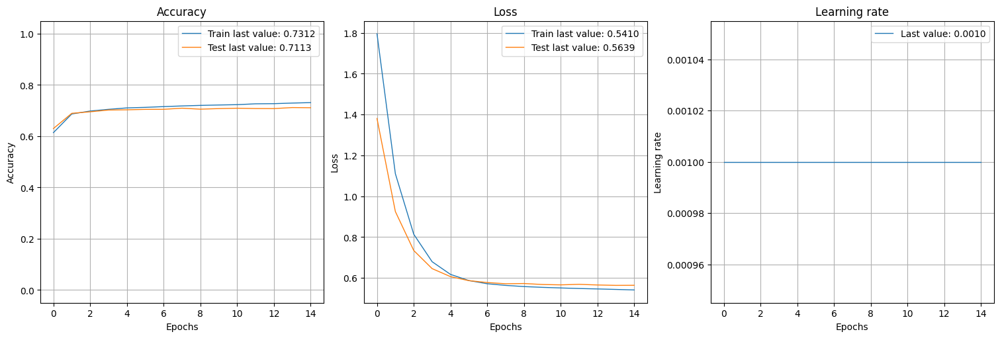

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 16s 13ms/step


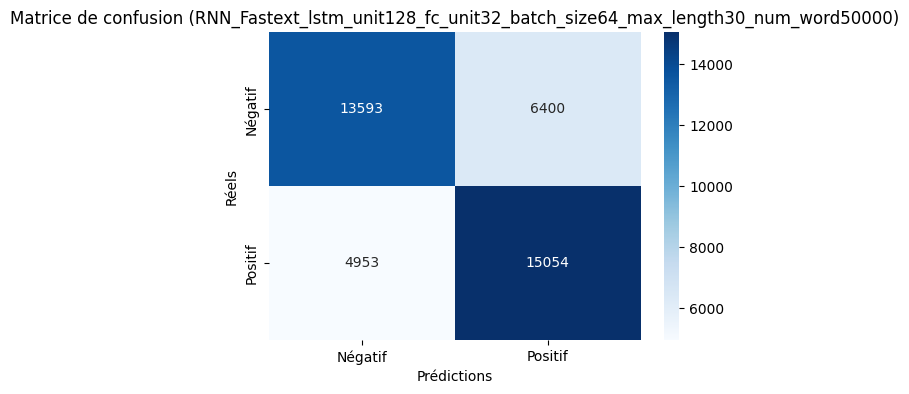

2025/03/10 19:21:51 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 19:22:13 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5317/10000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit64_batch_size32_max_length15_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 76s 18ms/step - accuracy: 0.5561 - loss: 2.1008 - val_accuracy: 0.6054 - val_loss: 1.0589 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 74s 18ms/step - accuracy: 0.6658 - loss: 0.8991 - val_accuracy: 0.6745 - val_loss: 0.6852 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 72s 18ms/step - accuracy: 0.6758 - loss: 0.6589 - val_accuracy: 0.6769 - val_loss: 0.6148 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 73s 18ms/step - accuracy: 0.6801 - loss: 0.6048 - val_accuracy: 0.6766 - val_loss: 0.6046 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 73s 18ms/step - accuracy: 0.6874 - loss: 0.5891 - val_accuracy: 0.6648 - val_loss: 0.5958 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━

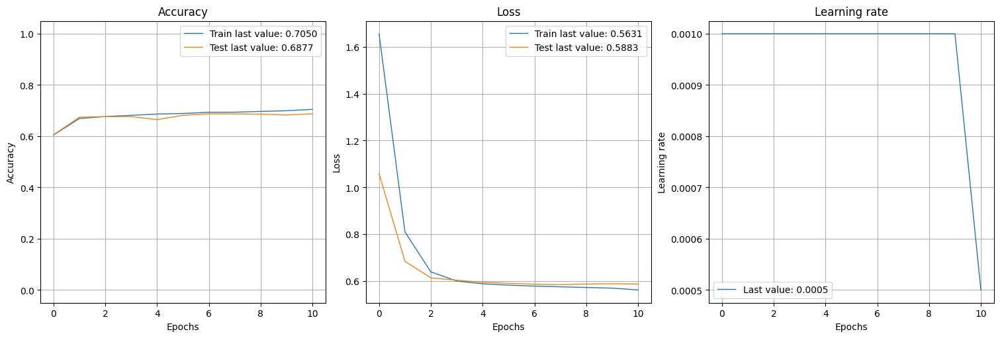

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 9s 7ms/step


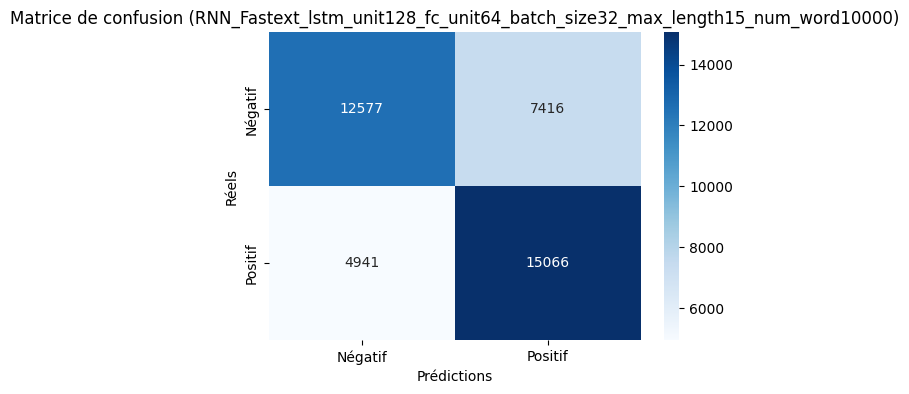

2025/03/10 19:39:06 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 19:39:25 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9340/30000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit64_batch_size32_max_length15_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 74s 18ms/step - accuracy: 0.5649 - loss: 2.0831 - val_accuracy: 0.6680 - val_loss: 1.0125 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 72s 18ms/step - accuracy: 0.6717 - loss: 0.8937 - val_accuracy: 0.6507 - val_loss: 0.6969 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 70s 17ms/step - accuracy: 0.6791 - loss: 0.6552 - val_accuracy: 0.6778 - val_loss: 0.6131 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 72s 18ms/step - accuracy: 0.6842 - loss: 0.6023 - val_accuracy: 0.6767 - val_loss: 0.6004 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 73s 18ms/step - accuracy: 0.6895 - loss: 0.5869 - val_accuracy: 0.6811 - val_loss: 0.5942 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━━

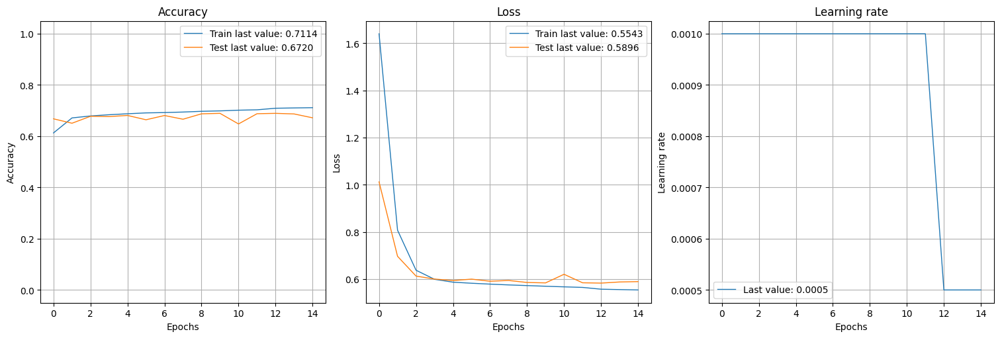

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 9s 7ms/step


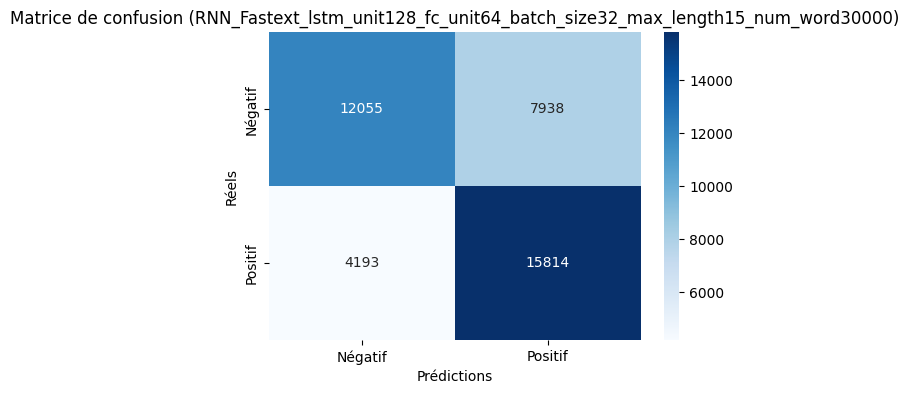

2025/03/10 20:01:03 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 20:01:24 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 11938/50000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit64_batch_size32_max_length15_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 75s 18ms/step - accuracy: 0.5877 - loss: 2.0789 - val_accuracy: 0.6560 - val_loss: 1.0242 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 72s 18ms/step - accuracy: 0.6692 - loss: 0.8932 - val_accuracy: 0.6782 - val_loss: 0.6833 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 71s 18ms/step - accuracy: 0.6822 - loss: 0.6542 - val_accuracy: 0.6787 - val_loss: 0.6133 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 72s 18ms/step - accuracy: 0.6841 - loss: 0.6035 - val_accuracy: 0.6859 - val_loss: 0.5945 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 72s 18ms/step - accuracy: 0.6879 - loss: 0.5898 - val_accuracy: 0.6805 - val_loss: 0.5952 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━━━━━

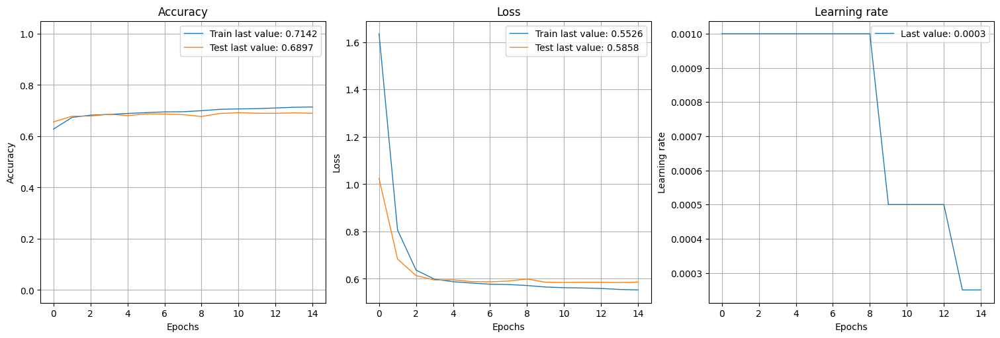

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 9s 7ms/step


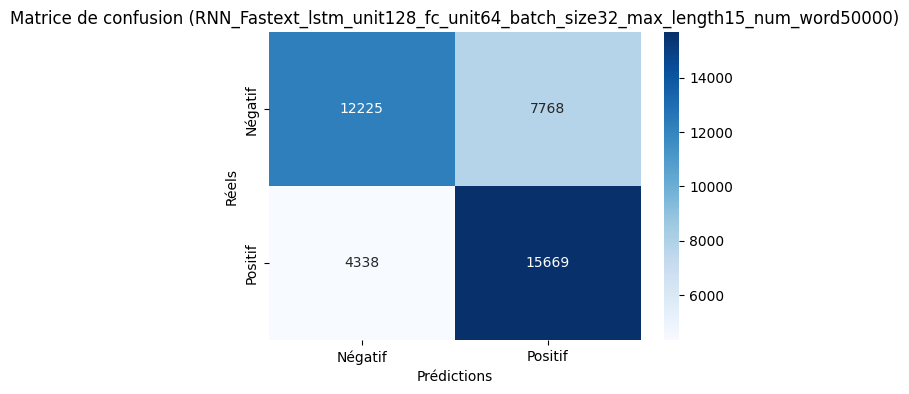

2025/03/10 20:22:54 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 20:23:15 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5317/10000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit64_batch_size32_max_length30_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 126s 31ms/step - accuracy: 0.5826 - loss: 2.0832 - val_accuracy: 0.6891 - val_loss: 0.9944 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 124s 31ms/step - accuracy: 0.6935 - loss: 0.8761 - val_accuracy: 0.6957 - val_loss: 0.6665 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 122s 30ms/step - accuracy: 0.6991 - loss: 0.6377 - val_accuracy: 0.6575 - val_loss: 0.6335 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 124s 31ms/step - accuracy: 0.7068 - loss: 0.5833 - val_accuracy: 0.6980 - val_loss: 0.5851 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 123s 31ms/step - accuracy: 0.7115 - loss: 0.5667 - val_accuracy: 0.7020 - val_loss: 0.5736 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━

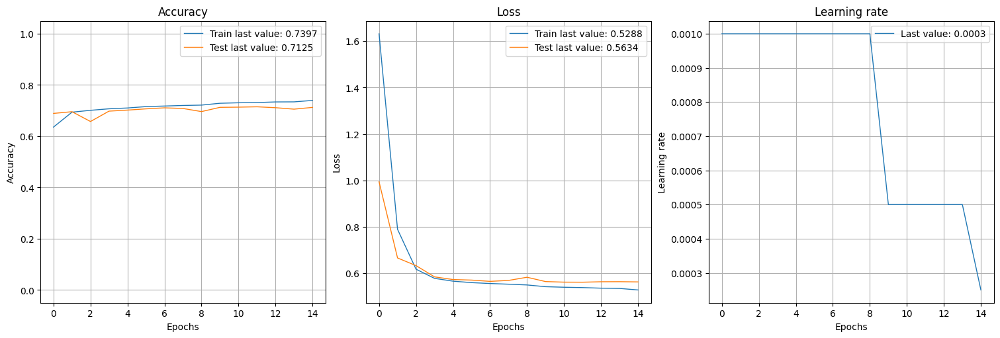

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 16s 12ms/step


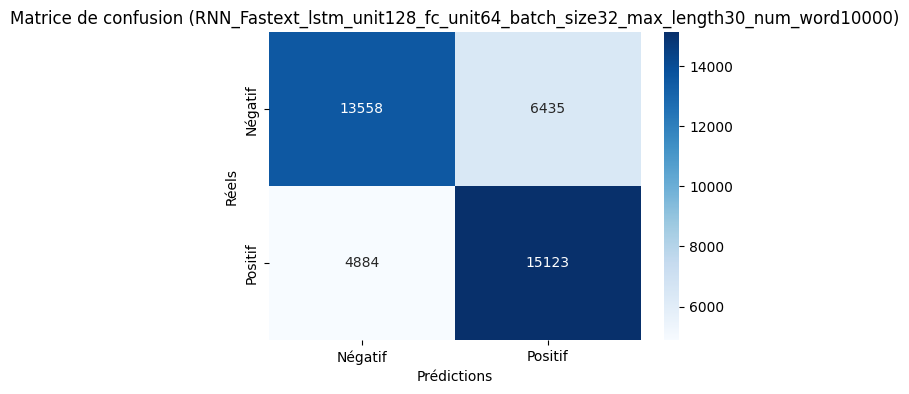

2025/03/10 20:58:00 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 20:58:20 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9340/30000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit64_batch_size32_max_length30_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 132s 32ms/step - accuracy: 0.5824 - loss: 2.0817 - val_accuracy: 0.6862 - val_loss: 0.9981 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 132s 33ms/step - accuracy: 0.6917 - loss: 0.8765 - val_accuracy: 0.6715 - val_loss: 0.6815 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 129s 32ms/step - accuracy: 0.7002 - loss: 0.6386 - val_accuracy: 0.6977 - val_loss: 0.5955 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 131s 33ms/step - accuracy: 0.7049 - loss: 0.5846 - val_accuracy: 0.6905 - val_loss: 0.5942 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 128s 32ms/step - accuracy: 0.7104 - loss: 0.5679 - val_accuracy: 0.7064 - val_loss: 0.5725 - learning_rate: 0.0010
Epoch 6/15
4000/4000 ━

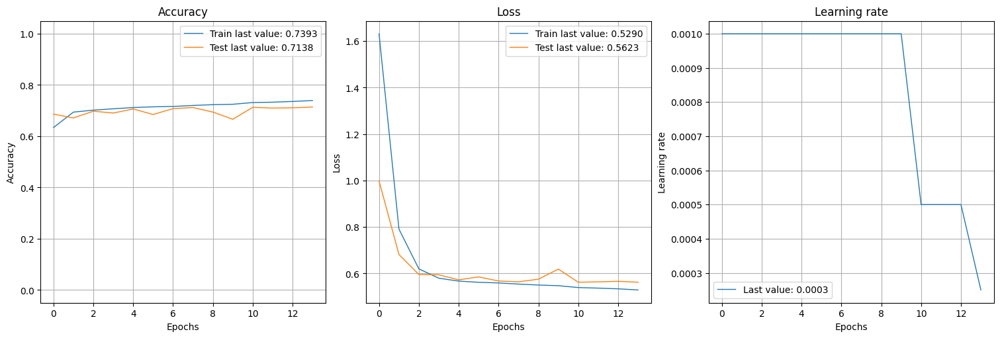

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 17s 13ms/step


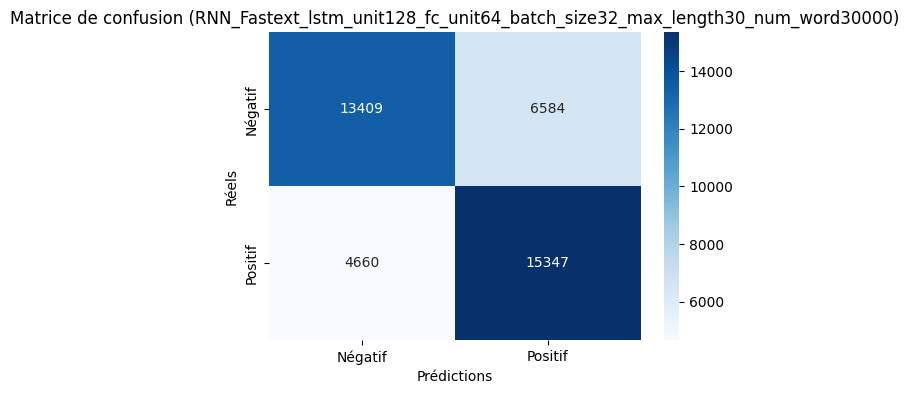

2025/03/10 21:32:38 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 21:32:59 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 11938/50000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit64_batch_size32_max_length30_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 135s 33ms/step - accuracy: 0.5949 - loss: 2.0833 - val_accuracy: 0.6790 - val_loss: 1.0069 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 133s 33ms/step - accuracy: 0.6908 - loss: 0.8786 - val_accuracy: 0.6935 - val_loss: 0.6686 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 131s 33ms/step - accuracy: 0.6997 - loss: 0.6377 - val_accuracy: 0.7031 - val_loss: 0.5931 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 136s 34ms/step - accuracy: 0.7070 - loss: 0.5831 - val_accuracy: 0.7029 - val_loss: 0.5778 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 131s 33ms/step - accuracy: 0.7125 - loss: 0.5664 - val_accuracy: 0.7093 - val_loss: 0.5700 - learning_rate: 0.0010
Epoch 6/15
4000/4000 

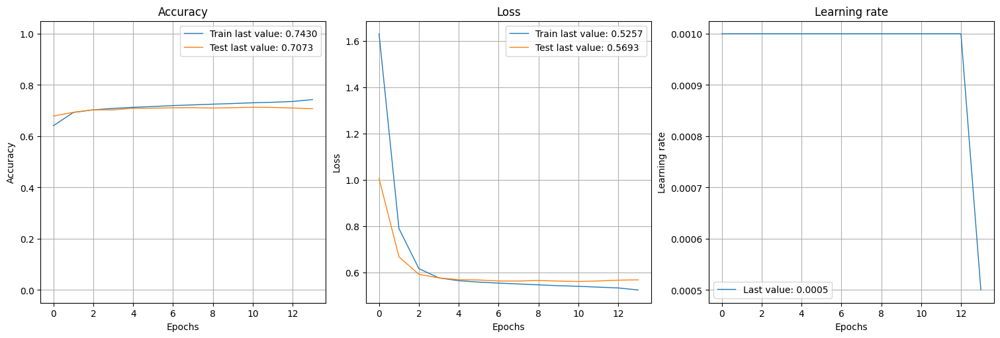

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 17s 13ms/step


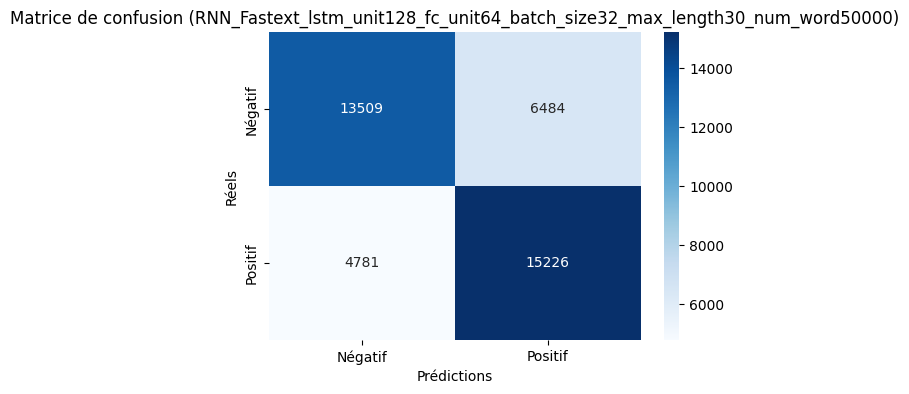

2025/03/10 22:07:37 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 22:07:58 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5317/10000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit64_batch_size64_max_length15_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 58s 27ms/step - accuracy: 0.5384 - loss: 2.3520 - val_accuracy: 0.6225 - val_loss: 1.5417 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 53s 27ms/step - accuracy: 0.6450 - loss: 1.3792 - val_accuracy: 0.6631 - val_loss: 1.0175 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 27ms/step - accuracy: 0.6703 - loss: 0.9452 - val_accuracy: 0.6647 - val_loss: 0.7917 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 27ms/step - accuracy: 0.6775 - loss: 0.7530 - val_accuracy: 0.6770 - val_loss: 0.6825 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 27ms/step - accuracy: 0.6843 - loss: 0.6628 - val_accuracy: 0.6789 - val_loss: 0.6347 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━

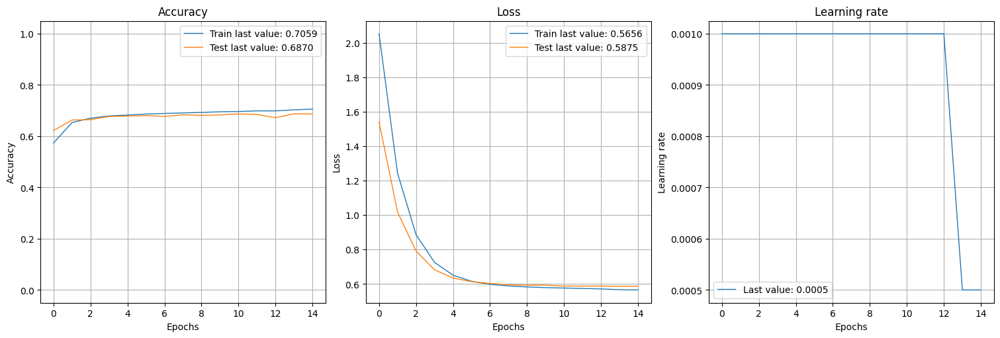

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step


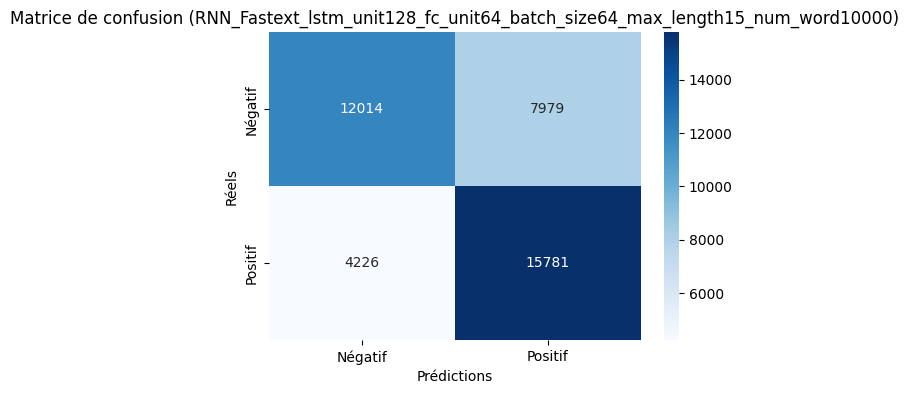

2025/03/10 22:24:56 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 22:25:18 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9340/30000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit64_batch_size64_max_length15_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 59s 28ms/step - accuracy: 0.5429 - loss: 2.3371 - val_accuracy: 0.6465 - val_loss: 1.5220 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 53s 27ms/step - accuracy: 0.6544 - loss: 1.3655 - val_accuracy: 0.6647 - val_loss: 1.0135 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 27ms/step - accuracy: 0.6741 - loss: 0.9388 - val_accuracy: 0.6720 - val_loss: 0.7857 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 53s 26ms/step - accuracy: 0.6806 - loss: 0.7449 - val_accuracy: 0.6809 - val_loss: 0.6778 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 53s 26ms/step - accuracy: 0.6840 - loss: 0.6577 - val_accuracy: 0.6834 - val_loss: 0.6306 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━━

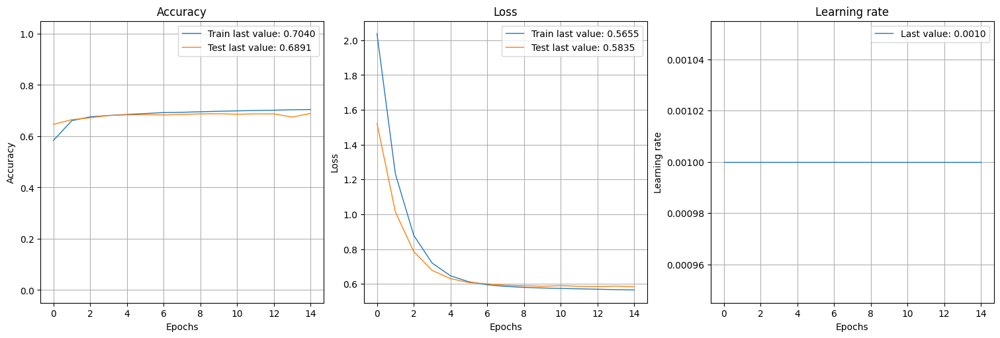

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step


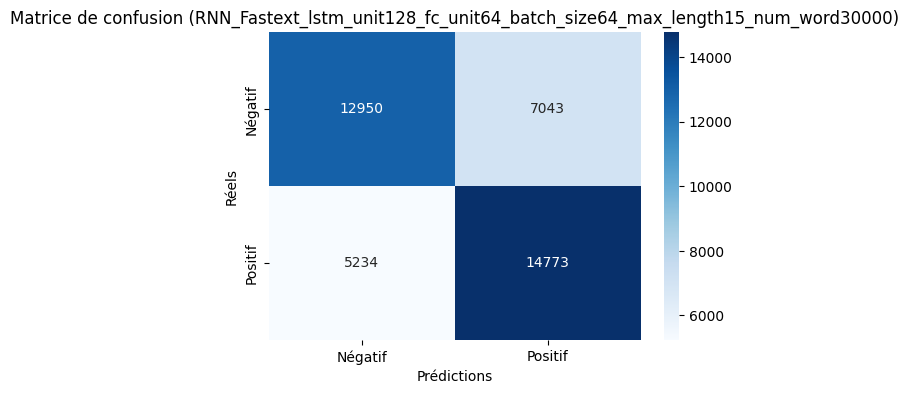

2025/03/10 22:42:07 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 22:42:27 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 11938/50000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit64_batch_size64_max_length15_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 59s 28ms/step - accuracy: 0.5499 - loss: 2.3443 - val_accuracy: 0.6543 - val_loss: 1.5204 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 55s 27ms/step - accuracy: 0.6590 - loss: 1.3646 - val_accuracy: 0.6633 - val_loss: 1.0180 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 55s 27ms/step - accuracy: 0.6741 - loss: 0.9387 - val_accuracy: 0.6773 - val_loss: 0.7826 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 55s 27ms/step - accuracy: 0.6820 - loss: 0.7469 - val_accuracy: 0.6642 - val_loss: 0.6820 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 27ms/step - accuracy: 0.6856 - loss: 0.6588 - val_accuracy: 0.6825 - val_loss: 0.6307 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━━━━━

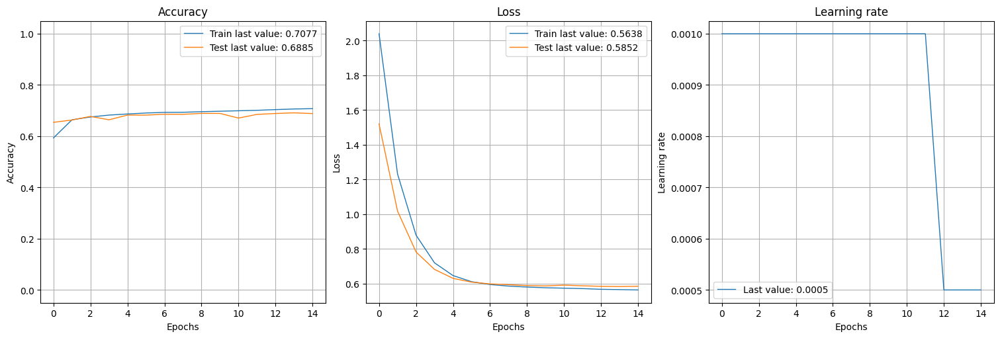

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step


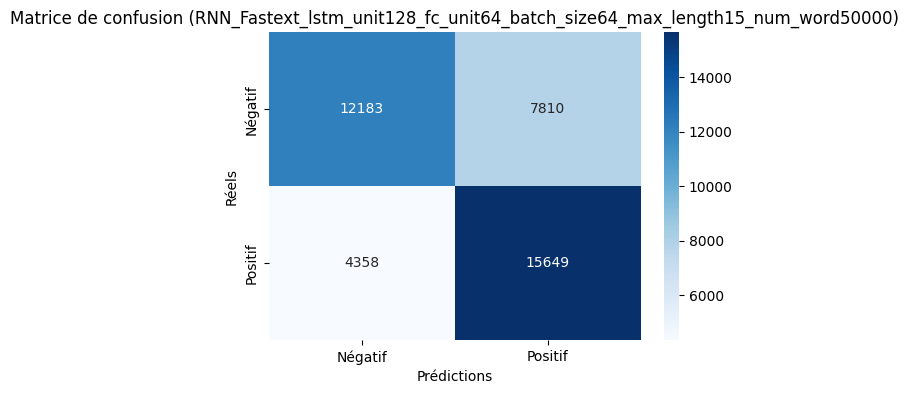

2025/03/10 22:59:40 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 22:59:59 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5317/10000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit64_batch_size64_max_length30_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 105s 51ms/step - accuracy: 0.5645 - loss: 2.3520 - val_accuracy: 0.6697 - val_loss: 1.5062 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 103s 51ms/step - accuracy: 0.6833 - loss: 1.3486 - val_accuracy: 0.6574 - val_loss: 1.0339 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 102s 51ms/step - accuracy: 0.7002 - loss: 0.9185 - val_accuracy: 0.6908 - val_loss: 0.7677 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 102s 51ms/step - accuracy: 0.7014 - loss: 0.7279 - val_accuracy: 0.6930 - val_loss: 0.6673 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 102s 51ms/step - accuracy: 0.7093 - loss: 0.6379 - val_accuracy: 0.6798 - val_loss: 0.6255 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━

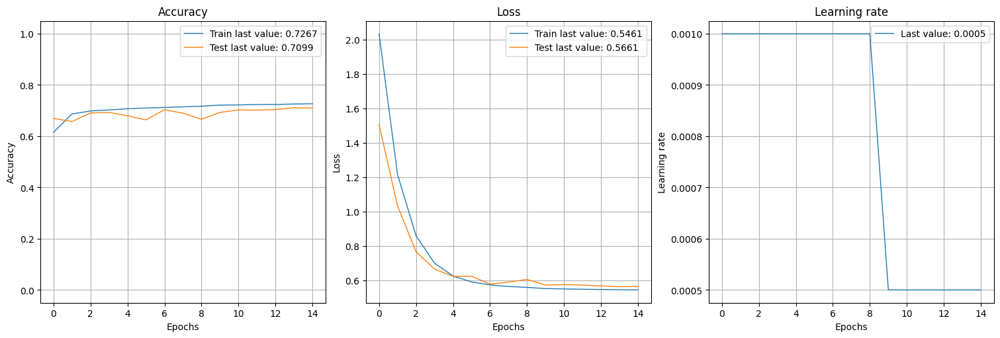

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 19s 15ms/step


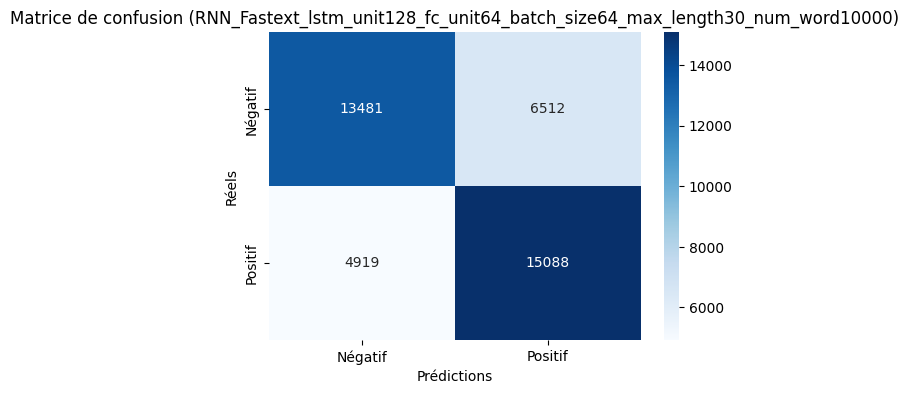

2025/03/10 23:29:23 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/10 23:29:43 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9340/30000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit64_batch_size64_max_length30_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 111s 54ms/step - accuracy: 0.5570 - loss: 2.3509 - val_accuracy: 0.5929 - val_loss: 1.5876 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 107s 53ms/step - accuracy: 0.6760 - loss: 1.3547 - val_accuracy: 0.6856 - val_loss: 0.9999 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 107s 53ms/step - accuracy: 0.6908 - loss: 0.9256 - val_accuracy: 0.6946 - val_loss: 0.7664 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 106s 53ms/step - accuracy: 0.7008 - loss: 0.7312 - val_accuracy: 0.6938 - val_loss: 0.6651 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 107s 53ms/step - accuracy: 0.7058 - loss: 0.6413 - val_accuracy: 0.6911 - val_loss: 0.6261 - learning_rate: 0.0010
Epoch 6/15
2000/2000 ━

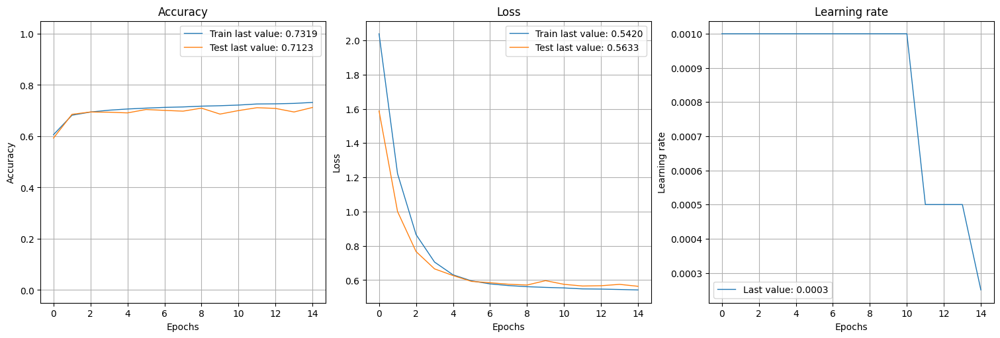

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 20s 16ms/step


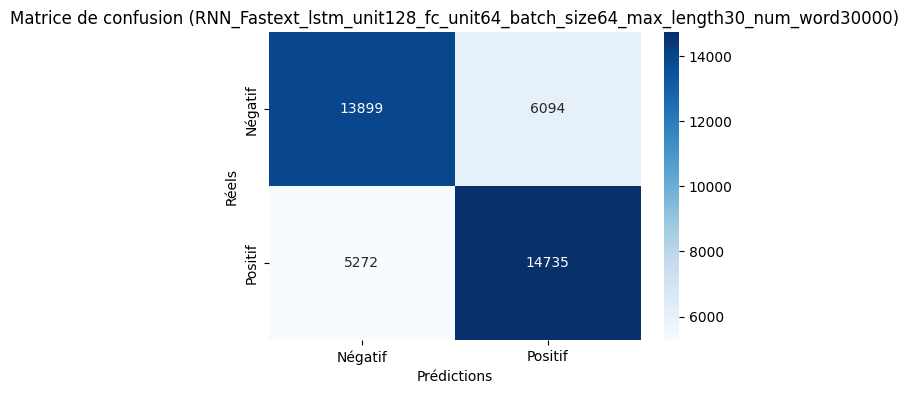

2025/03/11 00:00:25 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 00:00:45 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 11938/50000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit64_batch_size64_max_length30_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 118s 58ms/step - accuracy: 0.5714 - loss: 2.3346 - val_accuracy: 0.6744 - val_loss: 1.4995 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 113s 56ms/step - accuracy: 0.6853 - loss: 1.3399 - val_accuracy: 0.6901 - val_loss: 0.9920 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 112s 56ms/step - accuracy: 0.6971 - loss: 0.9180 - val_accuracy: 0.6945 - val_loss: 0.7687 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 112s 56ms/step - accuracy: 0.7051 - loss: 0.7250 - val_accuracy: 0.6965 - val_loss: 0.6636 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 114s 57ms/step - accuracy: 0.7112 - loss: 0.6367 - val_accuracy: 0.7033 - val_loss: 0.6102 - learning_rate: 0.0010
Epoch 6/15
2000/2000 

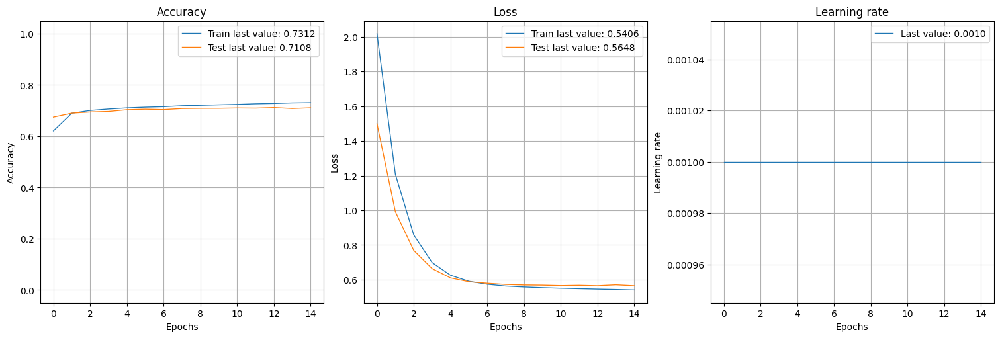

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 21s 16ms/step


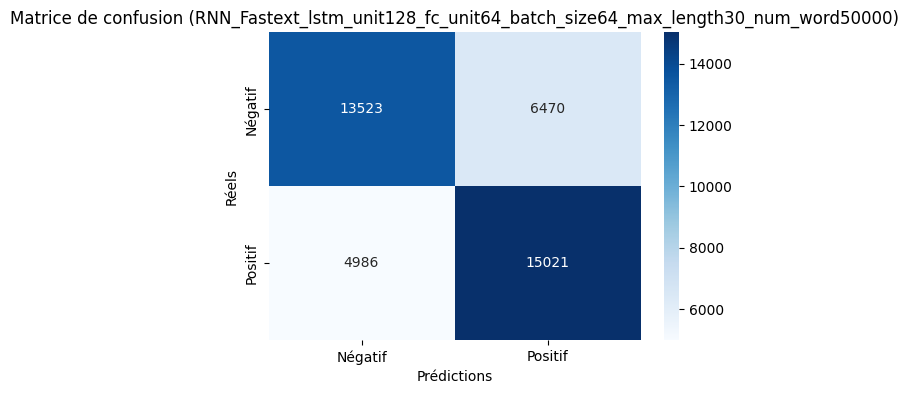

2025/03/11 00:32:48 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 00:33:09 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5317/10000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit128_batch_size32_max_length15_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 103s 25ms/step - accuracy: 0.5807 - loss: 2.3780 - val_accuracy: 0.6543 - val_loss: 1.0956 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 101s 25ms/step - accuracy: 0.6670 - loss: 0.9523 - val_accuracy: 0.6769 - val_loss: 0.6973 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 101s 25ms/step - accuracy: 0.6803 - loss: 0.6652 - val_accuracy: 0.6836 - val_loss: 0.6145 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 102s 25ms/step - accuracy: 0.6841 - loss: 0.6041 - val_accuracy: 0.6823 - val_loss: 0.5962 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 100s 25ms/step - accuracy: 0.6905 - loss: 0.5878 - val_accuracy: 0.6852 - val_loss: 0.5939 - learning_rate: 0.0010
Epoch 6/15
4000/4000 

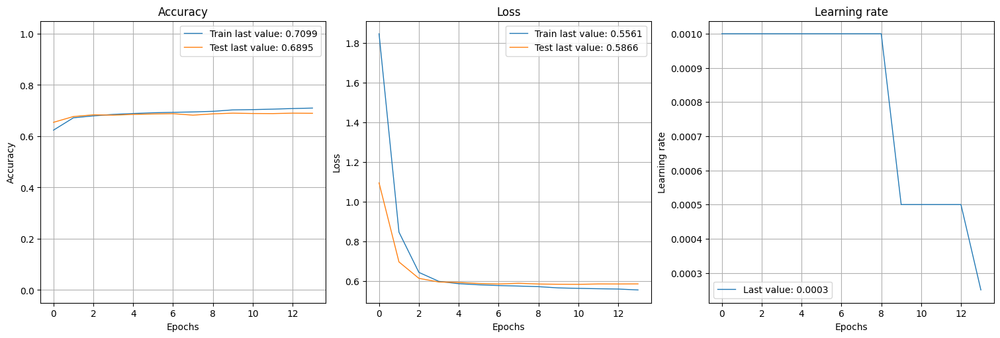

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 12s 9ms/step


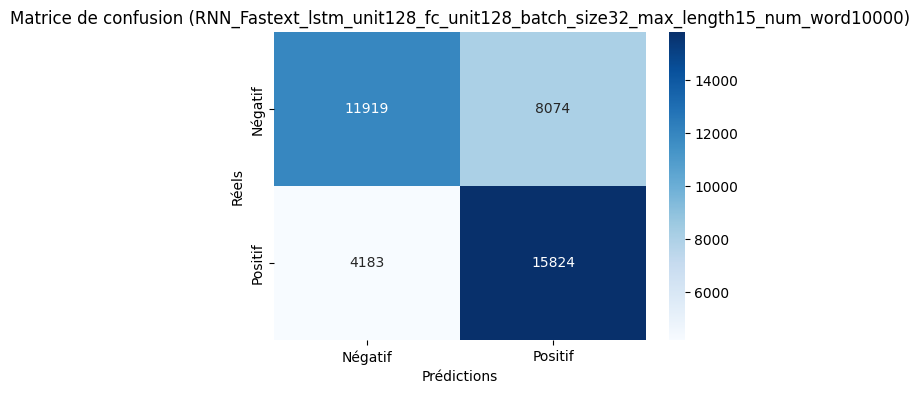

2025/03/11 01:00:16 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 01:00:35 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9340/30000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit128_batch_size32_max_length15_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 108s 26ms/step - accuracy: 0.5812 - loss: 2.3977 - val_accuracy: 0.6581 - val_loss: 1.1094 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 103s 26ms/step - accuracy: 0.6706 - loss: 0.9566 - val_accuracy: 0.6712 - val_loss: 0.7055 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 103s 26ms/step - accuracy: 0.6768 - loss: 0.6694 - val_accuracy: 0.6754 - val_loss: 0.6224 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 103s 26ms/step - accuracy: 0.6858 - loss: 0.6045 - val_accuracy: 0.6840 - val_loss: 0.5966 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 103s 26ms/step - accuracy: 0.6884 - loss: 0.5889 - val_accuracy: 0.6833 - val_loss: 0.5931 - learning_rate: 0.0010
Epoch 6/15
4000/4000 

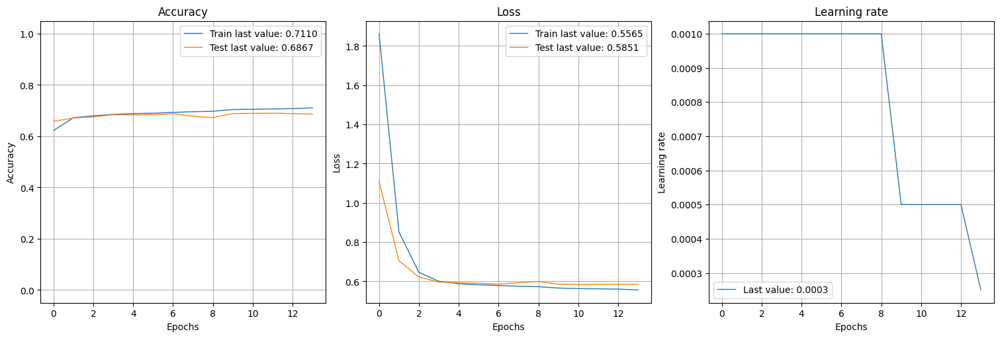

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 12s 9ms/step


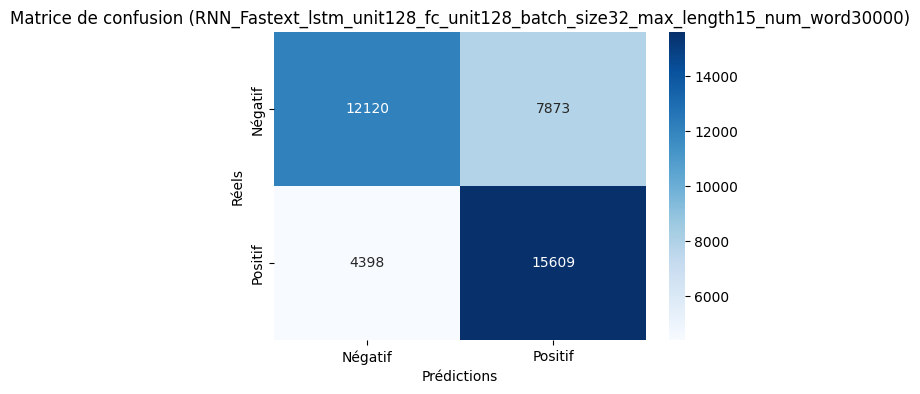

2025/03/11 01:28:21 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 01:28:42 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 11938/50000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit128_batch_size32_max_length15_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 109s 27ms/step - accuracy: 0.5792 - loss: 2.3913 - val_accuracy: 0.6665 - val_loss: 1.1017 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 106s 26ms/step - accuracy: 0.6678 - loss: 0.9561 - val_accuracy: 0.6746 - val_loss: 0.7012 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 106s 27ms/step - accuracy: 0.6783 - loss: 0.6673 - val_accuracy: 0.5972 - val_loss: 0.7510 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 106s 26ms/step - accuracy: 0.6795 - loss: 0.6069 - val_accuracy: 0.6763 - val_loss: 0.6063 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 106s 26ms/step - accuracy: 0.6884 - loss: 0.5880 - val_accuracy: 0.6807 - val_loss: 0.5952 - learning_rate: 0.0010
Epoch 6/15
4000/4000

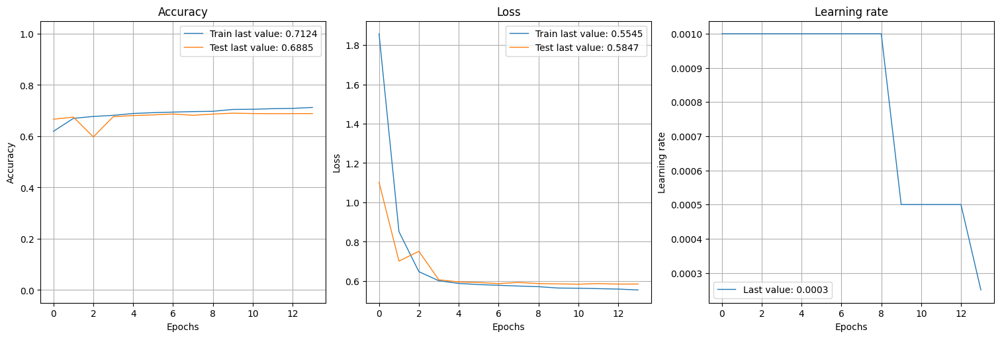

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 13s 11ms/step


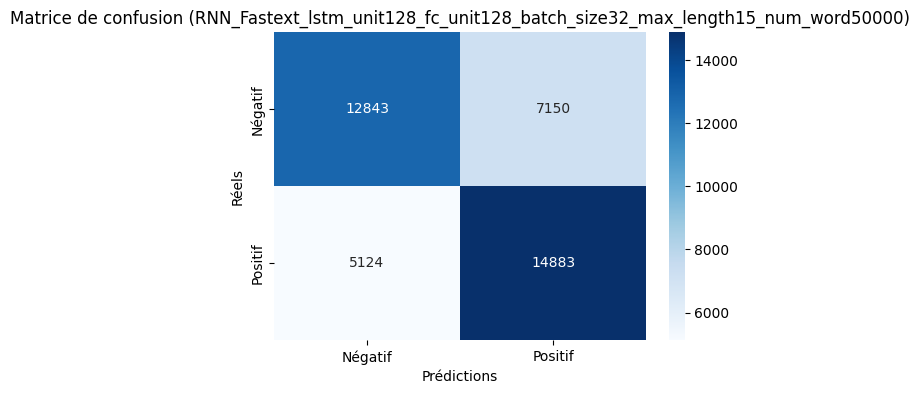

2025/03/11 01:57:00 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 01:57:19 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5317/10000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit128_batch_size32_max_length30_num_word10000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 211s 52ms/step - accuracy: 0.5792 - loss: 2.3891 - val_accuracy: 0.6840 - val_loss: 1.0859 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 210s 52ms/step - accuracy: 0.6908 - loss: 0.9399 - val_accuracy: 0.6884 - val_loss: 0.6890 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 189s 47ms/step - accuracy: 0.6987 - loss: 0.6520 - val_accuracy: 0.6965 - val_loss: 0.6049 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 202s 50ms/step - accuracy: 0.7060 - loss: 0.5862 - val_accuracy: 0.7027 - val_loss: 0.5795 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 205s 51ms/step - accuracy: 0.7110 - loss: 0.5690 - val_accuracy: 0.6997 - val_loss: 0.5804 - learning_rate: 0.0010
Epoch 6/15
4000/4000 

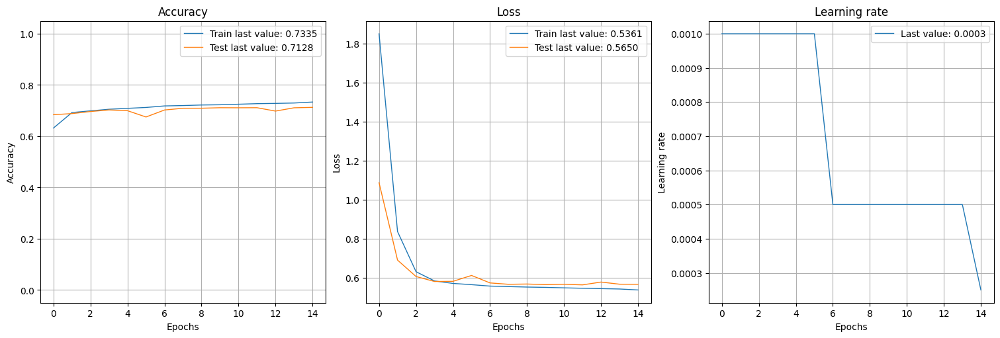

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 25s 19ms/step


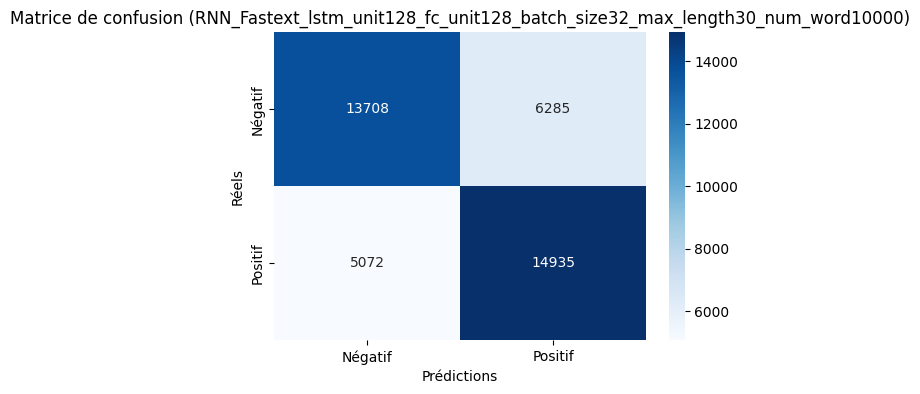

2025/03/11 02:52:59 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 02:53:19 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9340/30000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit128_batch_size32_max_length30_num_word30000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 218s 54ms/step - accuracy: 0.6049 - loss: 2.3836 - val_accuracy: 0.6840 - val_loss: 1.0877 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 216s 54ms/step - accuracy: 0.6955 - loss: 0.9361 - val_accuracy: 0.6979 - val_loss: 0.6807 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 224s 56ms/step - accuracy: 0.7043 - loss: 0.6485 - val_accuracy: 0.6986 - val_loss: 0.6000 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 216s 54ms/step - accuracy: 0.7080 - loss: 0.5840 - val_accuracy: 0.7077 - val_loss: 0.5734 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 217s 54ms/step - accuracy: 0.7137 - loss: 0.5666 - val_accuracy: 0.7033 - val_loss: 0.5730 - learning_rate: 0.0010
Epoch 6/15
4000/4000 

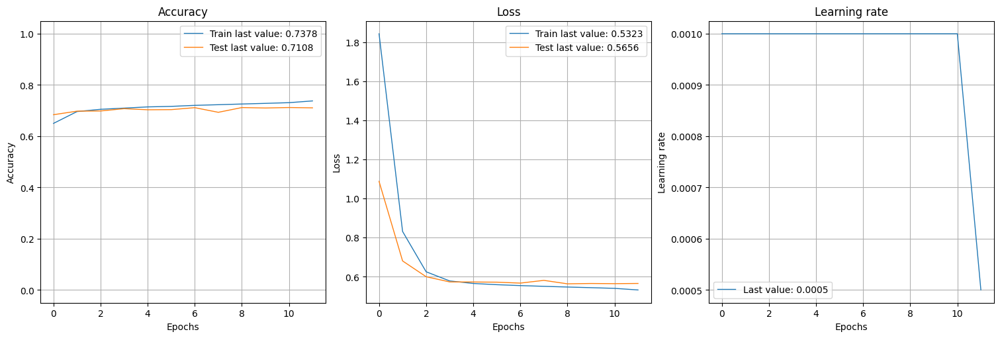

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 27s 21ms/step


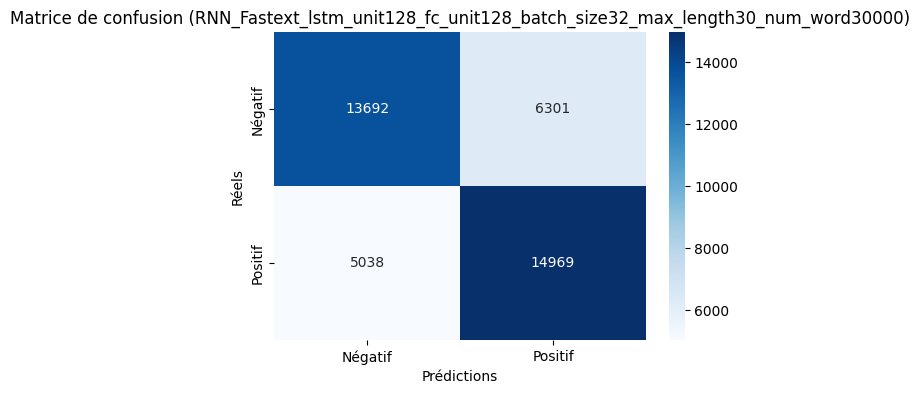

2025/03/11 03:41:40 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 03:42:01 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 11938/50000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit128_batch_size32_max_length30_num_word50000
Epoch 1/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 252s 62ms/step - accuracy: 0.5849 - loss: 2.3946 - val_accuracy: 0.6695 - val_loss: 1.0993 - learning_rate: 0.0010
Epoch 2/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 246s 62ms/step - accuracy: 0.6950 - loss: 0.9377 - val_accuracy: 0.6735 - val_loss: 0.7113 - learning_rate: 0.0010
Epoch 3/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 250s 62ms/step - accuracy: 0.7035 - loss: 0.6488 - val_accuracy: 0.6953 - val_loss: 0.6039 - learning_rate: 0.0010
Epoch 4/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 249s 62ms/step - accuracy: 0.7097 - loss: 0.5827 - val_accuracy: 0.7066 - val_loss: 0.5756 - learning_rate: 0.0010
Epoch 5/15
4000/4000 ━━━━━━━━━━━━━━━━━━━━ 250s 62ms/step - accuracy: 0.7125 - loss: 0.5676 - val_accuracy: 0.7066 - val_loss: 0.5715 - learning_rate: 0.0010
Epoch 6/15
4000/4000

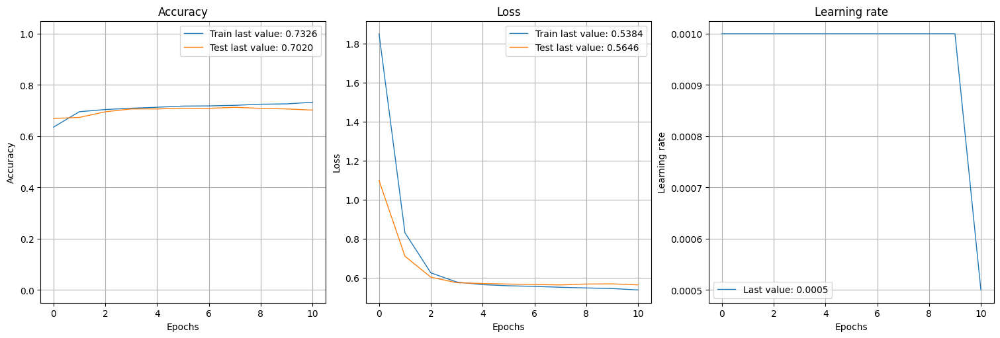

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 32s 25ms/step


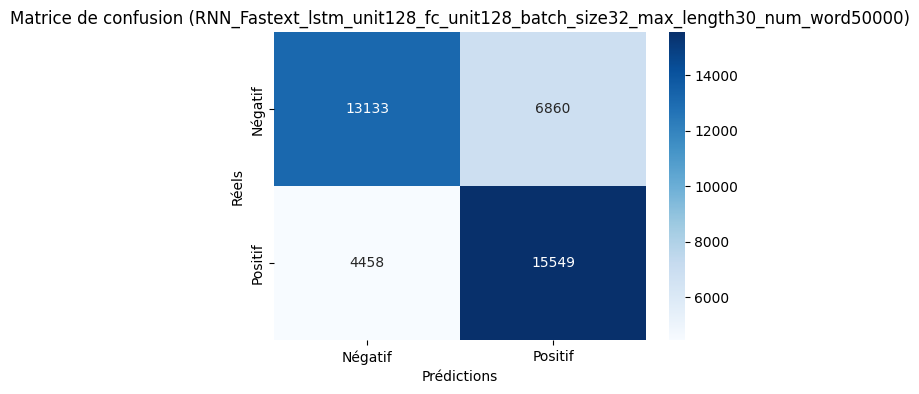

2025/03/11 04:33:32 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 04:33:53 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5317/10000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit128_batch_size64_max_length15_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 112s 54ms/step - accuracy: 0.5583 - loss: 2.6997 - val_accuracy: 0.6382 - val_loss: 1.7214 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 109s 54ms/step - accuracy: 0.6567 - loss: 1.5266 - val_accuracy: 0.6672 - val_loss: 1.0982 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 106s 53ms/step - accuracy: 0.6718 - loss: 1.0119 - val_accuracy: 0.6730 - val_loss: 0.8223 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 108s 54ms/step - accuracy: 0.6814 - loss: 0.7786 - val_accuracy: 0.6642 - val_loss: 0.6970 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 107s 53ms/step - accuracy: 0.6843 - loss: 0.6745 - val_accuracy: 0.6800 - val_loss: 0.6395 - learning_rate: 0.0010
Epoch 6/15
2000/2000 

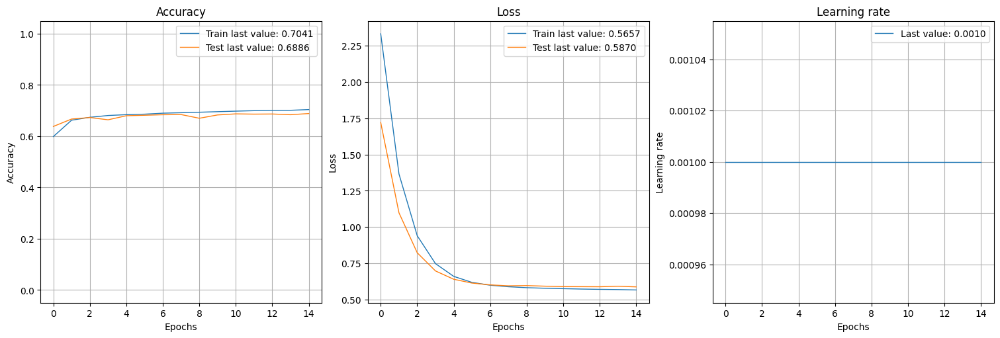

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 18s 14ms/step


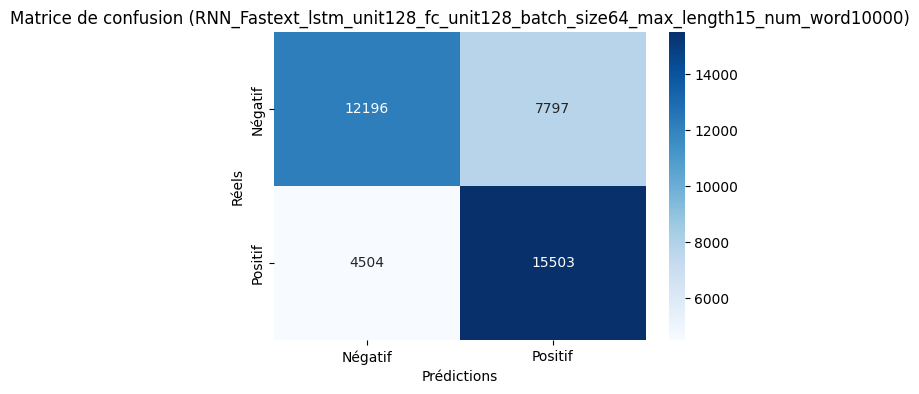

2025/03/11 05:04:48 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 05:05:08 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9340/30000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit128_batch_size64_max_length15_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 115s 56ms/step - accuracy: 0.5640 - loss: 2.6974 - val_accuracy: 0.6547 - val_loss: 1.7136 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 111s 56ms/step - accuracy: 0.6619 - loss: 1.5240 - val_accuracy: 0.6706 - val_loss: 1.0954 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 114s 57ms/step - accuracy: 0.6769 - loss: 1.0110 - val_accuracy: 0.6757 - val_loss: 0.8210 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 112s 56ms/step - accuracy: 0.6808 - loss: 0.7813 - val_accuracy: 0.6789 - val_loss: 0.6974 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 111s 56ms/step - accuracy: 0.6859 - loss: 0.6754 - val_accuracy: 0.6820 - val_loss: 0.6395 - learning_rate: 0.0010
Epoch 6/15
2000/2000 

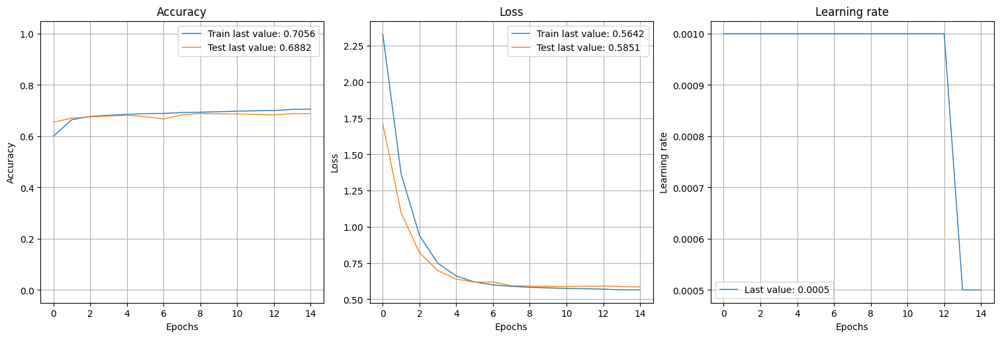

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 19s 15ms/step


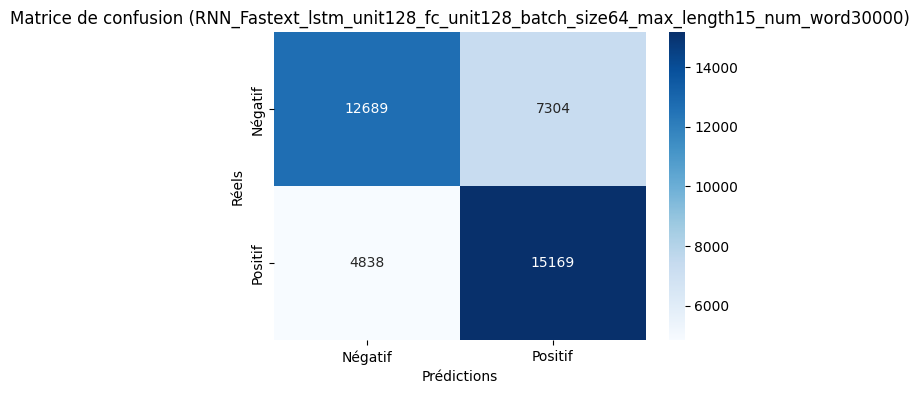

2025/03/11 05:37:21 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 05:37:43 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 11938/50000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit128_batch_size64_max_length15_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 122s 60ms/step - accuracy: 0.5554 - loss: 2.6876 - val_accuracy: 0.6505 - val_loss: 1.7089 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 117s 58ms/step - accuracy: 0.6581 - loss: 1.5203 - val_accuracy: 0.6719 - val_loss: 1.0936 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 117s 59ms/step - accuracy: 0.6737 - loss: 1.0069 - val_accuracy: 0.6765 - val_loss: 0.8206 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 118s 59ms/step - accuracy: 0.6821 - loss: 0.7772 - val_accuracy: 0.6797 - val_loss: 0.6956 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 116s 58ms/step - accuracy: 0.6852 - loss: 0.6724 - val_accuracy: 0.6827 - val_loss: 0.6397 - learning_rate: 0.0010
Epoch 6/15
2000/2000

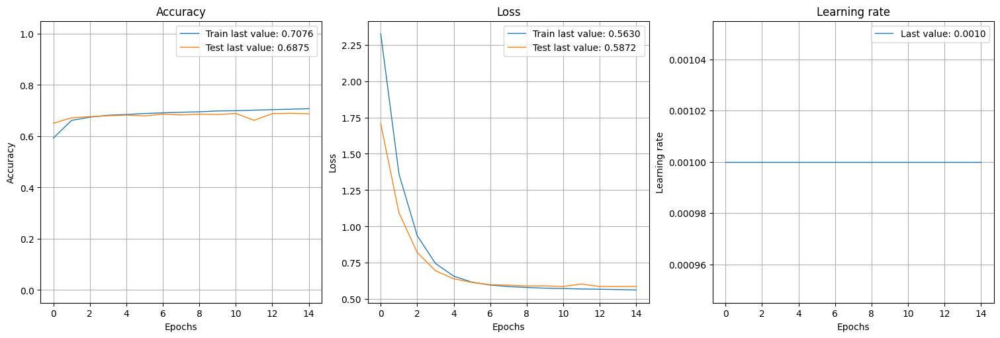

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 19s 15ms/step


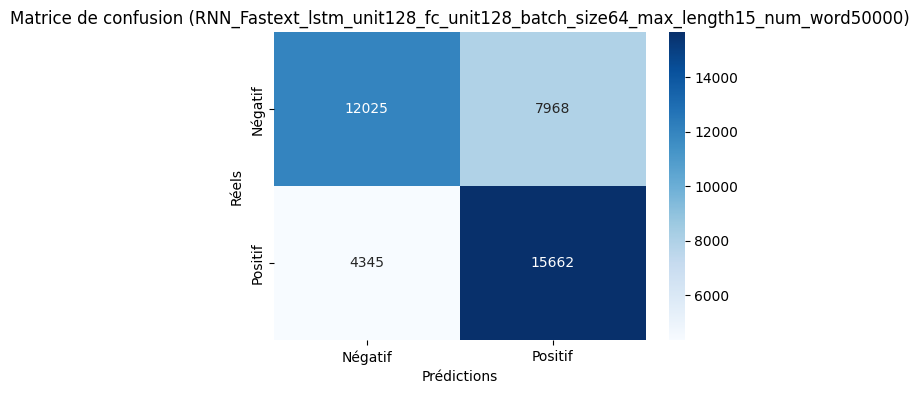

2025/03/11 06:10:46 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 06:11:08 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 5317/10000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit128_batch_size64_max_length30_num_word10000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 215s 105ms/step - accuracy: 0.5695 - loss: 2.6908 - val_accuracy: 0.6684 - val_loss: 1.6977 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 211s 106ms/step - accuracy: 0.6836 - loss: 1.5053 - val_accuracy: 0.6922 - val_loss: 1.0759 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 211s 106ms/step - accuracy: 0.6986 - loss: 0.9899 - val_accuracy: 0.6957 - val_loss: 0.8027 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 212s 106ms/step - accuracy: 0.7038 - loss: 0.7587 - val_accuracy: 0.6972 - val_loss: 0.6806 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 209s 105ms/step - accuracy: 0.7069 - loss: 0.6539 - val_accuracy: 0.7041 - val_loss: 0.6187 - learning_rate: 0.0010
Epoch 6/15
2000/

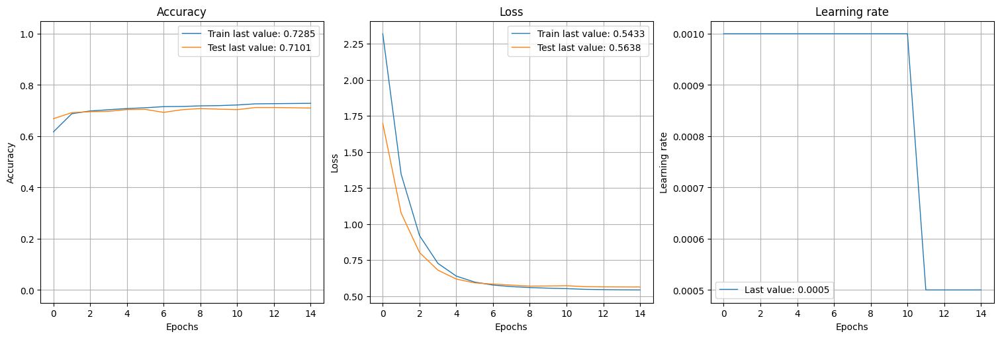

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step


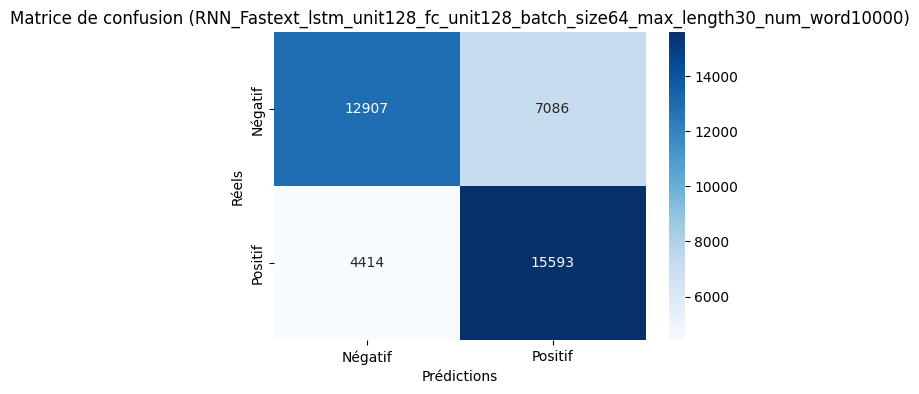

2025/03/11 07:07:50 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 07:08:11 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 9340/30000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit128_batch_size64_max_length30_num_word30000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 211s 104ms/step - accuracy: 0.5447 - loss: 2.6903 - val_accuracy: 0.6723 - val_loss: 1.6931 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 212s 106ms/step - accuracy: 0.6768 - loss: 1.5057 - val_accuracy: 0.6671 - val_loss: 1.0894 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 211s 106ms/step - accuracy: 0.6955 - loss: 0.9907 - val_accuracy: 0.6942 - val_loss: 0.8038 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 213s 106ms/step - accuracy: 0.7046 - loss: 0.7584 - val_accuracy: 0.6988 - val_loss: 0.6777 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 212s 106ms/step - accuracy: 0.7076 - loss: 0.6541 - val_accuracy: 0.7024 - val_loss: 0.6223 - learning_rate: 0.0010
Epoch 6/15
2000/

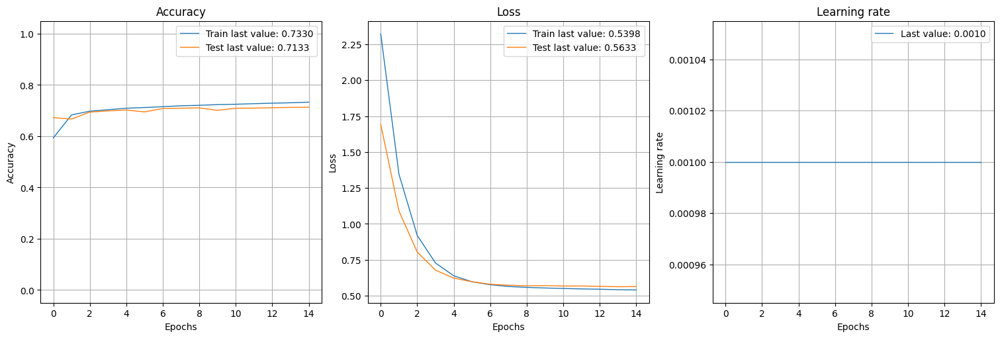

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 61s 48ms/step


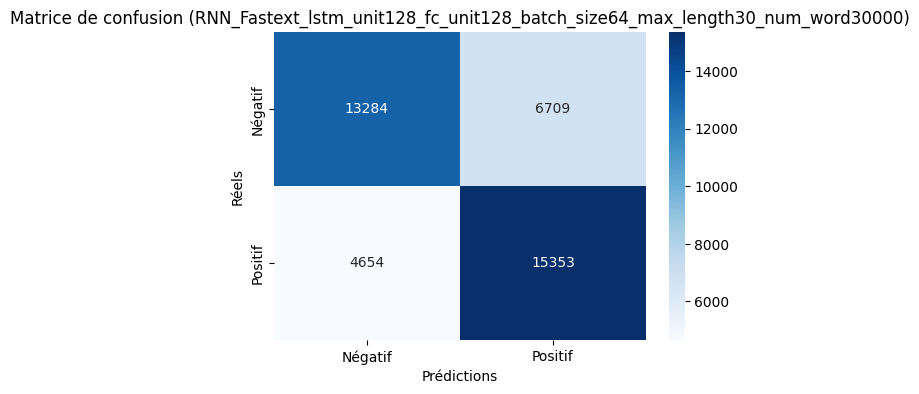

2025/03/11 08:11:09 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 08:11:42 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Couverture  du vocabulaire : 11938/50000
-----------------------------------------------------------------------------
RNN_Fastext_lstm_unit128_fc_unit128_batch_size64_max_length30_num_word50000
Epoch 1/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 305s 149ms/step - accuracy: 0.5561 - loss: 2.6919 - val_accuracy: 0.6770 - val_loss: 1.6921 - learning_rate: 0.0010
Epoch 2/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 296s 148ms/step - accuracy: 0.6814 - loss: 1.5055 - val_accuracy: 0.6928 - val_loss: 1.0769 - learning_rate: 0.0010
Epoch 3/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 295s 148ms/step - accuracy: 0.6980 - loss: 0.9909 - val_accuracy: 0.7001 - val_loss: 0.8005 - learning_rate: 0.0010
Epoch 4/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 296s 148ms/step - accuracy: 0.7021 - loss: 0.7608 - val_accuracy: 0.6982 - val_loss: 0.6811 - learning_rate: 0.0010
Epoch 5/15
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 293s 147ms/step - accuracy: 0.7103 - loss: 0.6521 - val_accuracy: 0.6955 - val_loss: 0.6277 - learning_rate: 0.0010
Epoch 6/15
2000

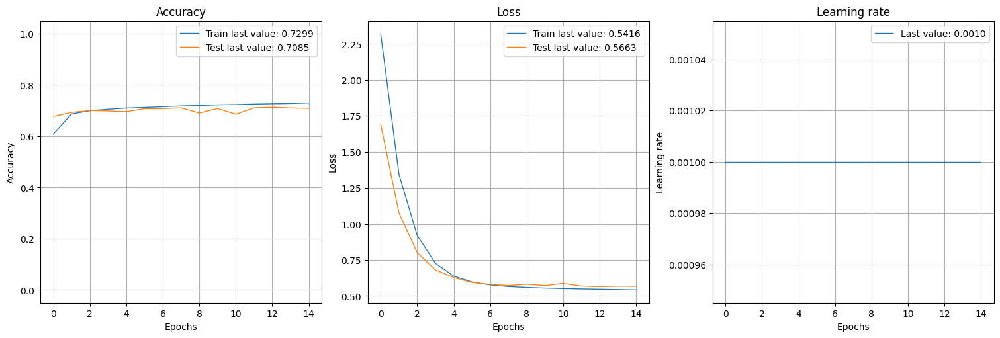

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 46s 37ms/step


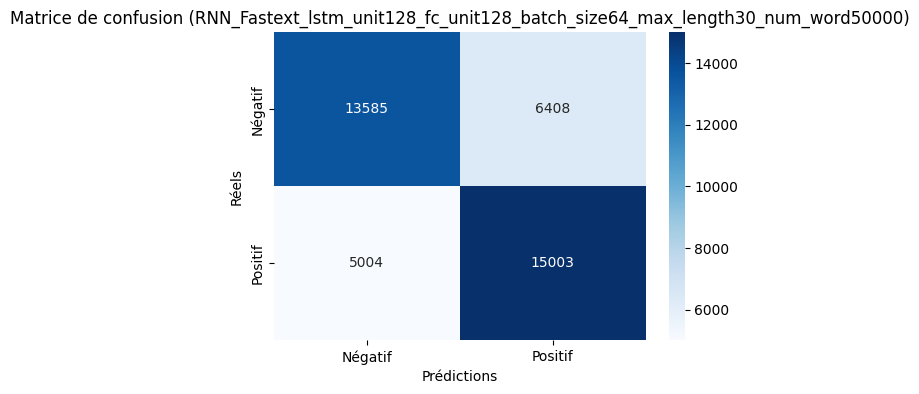

2025/03/11 09:33:56 WARNING mlflow.tensorflow: You are saving a TensorFlow Core model or Keras model without a signature. Inference with mlflow.pyfunc.spark_udf() will not work unless the model's pyfunc representation accepts pandas DataFrames as inference inputs.
2025/03/11 09:34:21 WARNING mlflow.models.model: Model logged without a signature and input example. Please set `input_example` parameter when logging the model to auto infer the model signature.


Tests d'hyperparamètres terminés et métriques enregistrées dans MLflow.


In [ ]:
# Hyperparamètres à tester
embedding_dim = 300  # Tailles des embeddings
lstm_units = [32, 64, 128]  # Nombre d'unités LSTM
fc_units = [32,64, 128]   # Nombre d'unités Dense
cnn_filters = 64  # Présence ou absence de CNN
kernel_size = 3  # Taille du noyau CNN
batch_sizes = [32,64]
epochs = 15
dropout_rate =  0.6 # Différents taux de dropout
max_length_list = [15,30]  # Longueur maximale des séquences

# Différentes stratégies de tokenization
num_word_list =  [10000,30000,50000]  # Taille du vocabulaire
best_recall_class_0 = 0

# Enregistrement avec MLflow
for lstm_unit,fc_unit,batch_size,max_length,num_word in product(lstm_units,fc_units,batch_sizes,max_length_list,num_word_list):

    run_name = f"RNN_Fastext_lstm_unit{lstm_unit}_fc_unit{fc_unit}_batch_size{batch_size}_max_length{max_length}_num_word{num_word}"

    with mlflow.start_run(experiment_id='342420157858240682', run_name=run_name):
        mlflow.log_param("embedding_dim", embedding_dim)
        mlflow.log_param("lstm_units", lstm_unit)
        mlflow.log_param("fc_units", fc_unit)
        mlflow.log_param("cnn_filters", cnn_filters)
        mlflow.log_param("batch_size", batch_size)
        mlflow.log_param("epochs", epochs)
        mlflow.log_param("dropout_rate", dropout_rate)
        mlflow.log_param("num_words", num_word)
        mlflow.log_param("max_length", max_length)

        # Prétraitement des données
        # Réservons deux nombres pour les tokens spéciaux : un pour les mots hors dictionnaire ('UNK') et l'autre pour la sequence ('PAD').
        most_used_words = [token for token, count in sorted_token_count[:num_word-2]]
        # dictionnaire mots vers indices
        word_to_idx = {}
        # dictionnaire  indices vers mots
        idx_to_word = {}

        # Inclusion du premier token d'abord
        PAD_token = 0
        UNK_token = 1

        word_to_idx['PAD'] = PAD_token
        word_to_idx['UNK'] = UNK_token

        idx_to_word[PAD_token] = 'PAD'
        idx_to_word[UNK_token] = 'UNK'

        # Remplissage du dictionnaire avec les mots les plus fréquents
        for num,word in enumerate(most_used_words):
          word_to_idx[word] = num + 2
          idx_to_word[num+2] = word

        X_train_idx = tokens_to_idx(X_train['token_by_tweet_finalised_sans_racinisation'],word_to_idx)
        X_val_idx = tokens_to_idx(X_val['token_by_tweet_finalised_sans_racinisation'],word_to_idx)
        X_test_idx = tokens_to_idx(X_test['token_by_tweet_finalised_sans_racinisation'],word_to_idx)

        X_train_pad = padding(X_train_idx,max_length)
        X_val_pad = padding(X_val_idx,max_length)
        X_test_pad = padding(X_test_idx,max_length)

        # Ajout de bruit dans les données d'entrainement
        # X_train_pad_noisy = X_train_pad + np.random.normal(0.0, 0.01,X_train_pad.shape)

        # One hot encoding
        y_train_categorical = to_categorical(X_train['target'], num_classes=2)
        y_val_categorical = to_categorical(X_val['target'], num_classes=2)
        y_test_categorical =to_categorical(X_test['target'], num_classes=2)

        embedding_matrix,vocab_size = load_fastext_embeddings('D:\\tutorial-env\\OCR\\Projet7\\cc.en.300.vec.txt', word_to_idx, embedding_dim)

        mlflow.log_param("max_vocab_size", vocab_size)

        # Définition du modèle
        model = Sequential()
        model.add(Embedding(input_dim=vocab_size, output_dim=embedding_dim, weights=[embedding_matrix],input_length=max_length, trainable=False))

        if cnn_filters:
            model.add(Conv1D(filters=cnn_filters, kernel_size=kernel_size, activation='relu'))
            model.add(MaxPooling1D(pool_size=2))
            model.add(BatchNormalization())

        model.add(LSTM(lstm_unit, return_sequences=False, kernel_regularizer=l2(0.01)))
        model.add(Dropout(dropout_rate))
        model.add(Dense(fc_unit, activation='relu', kernel_regularizer=l2(0.01)))
        model.add(Dense(2, activation='softmax'))

        model.compile(optimizer=SGD(learning_rate=0.001, momentum=0.9), loss='categorical_crossentropy', metrics=['accuracy'])

        lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=1e-6)
        es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
        callbacks_list = [lr, es]

        # On accorde plus de poids aux erreurs sur la classe 0 dans notre mission
        # class_weight = {0: 1.5, 1: 1.0}

        print("-----------------------------------------------------------------------------")
        print(f"{run_name}")

        history = model.fit(
            X_train_pad, y_train_categorical,
            validation_data=(X_val_pad, y_val_categorical),
            batch_size=batch_size,
            epochs=epochs,
            callbacks=callbacks_list
            # class_weight=class_weight
        )

        # Courbe d'entrainement et de validation
        # plot_training_history(history)
        show_history(history)
        plot_history(history, path=f"D:/tutorial-env/OCR/Projet7/save/{run_name}.png")
        plt.close()


        # Journalisation des métriques dans MLflow
        mlflow.log_metric("final_train_accuracy", history.history['accuracy'][-1])
        mlflow.log_metric("final_val_accuracy", history.history['val_accuracy'][-1])

        # Évaluation
        y_pred_proba = model.predict(X_test_pad)
        y_pred = (y_pred_proba > 0.5).astype(int)
        test_accuracy = accuracy_score(y_test_categorical, y_pred)
        test_recall = recall_score(y_test_categorical, y_pred, average = 'macro')
        test_f1 = f1_score(y_test_categorical, y_pred, average = 'macro')
        test_roc_auc = roc_auc_score(y_test_categorical, y_pred_proba, average = 'macro')
        report = classification_report(y_test_categorical, y_pred, output_dict=True)
        recall_class_0 = report['0']['recall']

        # Visualisation distribution des probas
        # plt.hist(y_pred_proba, bins=50, edgecolor='k')
        # plt.title('Distribution des prédictions')

        mlflow.log_metric("test_accuracy", test_accuracy)
        mlflow.log_metric("test_recall", test_recall.item())
        mlflow.log_metric("test_f1", test_f1.item())
        mlflow.log_metric("test_roc_auc", test_roc_auc.item())
        mlflow.log_metric("recall_class_0", recall_class_0)

        # Matrice de confusion
        y_test_labels = y_test_categorical.argmax(axis=1)
        y_pred_labels = y_pred.argmax(axis=1)
        conf_matrix = confusion_matrix(y_test_labels, y_pred_labels)
        plt.figure(figsize=(6, 4))
        sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=["Négatif", "Positif"],
                    yticklabels=["Négatif", "Positif"])
        plt.xlabel("Prédictions")
        plt.ylabel("Réels")
        plt.title(f"Matrice de confusion ({run_name})")
        plt.show()
        plt.close()

        # Enregistrement du modèle
        mlflow.tensorflow.log_model(model, run_name)
        if recall_class_0>best_recall_class_0:
          best_recall_class_0 = recall_class_0
          best_run_name = run_name
          model.save(f"D:/tutorial-env/OCR/Projet7/save/{best_run_name}.h5")
          plt.savefig(f"D:/tutorial-env/OCR/Projet7/save/confusion_matrix_{best_run_name}.png")
          mlflow.log_artifact(f"D:/tutorial-env/OCR/Projet7/save/confusion_matrix_{best_run_name}.png")


print("Tests d'hyperparamètres terminés et métriques enregistrées dans MLflow.")

In [10]:
process = subprocess.Popen(["mlflow", "ui", "--backend-store-uri", "file:/D:/tutorial-env/OCR/Projet7/mlruns", "--port", "5006"],stdout = subprocess.PIPE, stderr = subprocess.PIPE)
time.sleep(1)
webbrowser.open("http://localhost:5006")
print(f"MLFlow lancé")

MLFlow lancé


Les embeddings Glove et Fastext obtiennent un recall maximum sur la classe 0 légèrement plus bas que notre RNN from scratch.

Il est possible que ces embeddings entrainés sur des corpus généraux comme Wikipédia ne sont pas complètement adaptés à notre dataset de tweets, surtout que nous n'avons pas ré-entrainés les poids de ces embeddings.

Dans ce cas du RNN avec les embeddings FastText, les meilleurs résultats sont avec les hyperparamètres suivants :
- Taille des embeddings : 300
- Nombre d'unités LSTM : 128
- Nombre d'unités Dense : 32
- Batch size : 32
- Taux de dropout : 0.6
- Longueur max des séquences : 30
- Taille de vocabulaire :  50000

Résultats :
- un recall de 75% pour la classe négative,
- un f1 score de 70%,
- et une aire sous la courbe ROC de 0.79 (bonne capacité à distinguer les deux classes),
- la matrice de confusion montre un minimum de 4984 tweets négatifs manqués.

Voici la matrice de confusion :

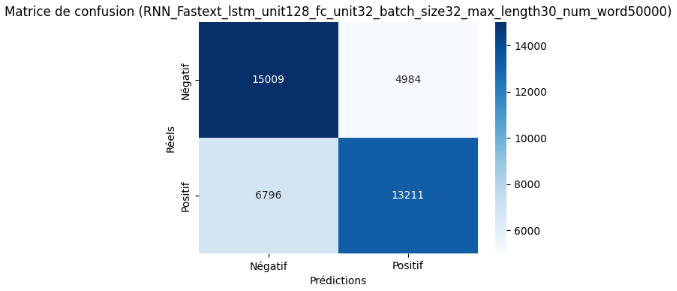



# ModernBert

ModernBERT est une variante de modèle BERT (Bidirectional Encoder Representations from Transformers), qui est un modèle de langage pré-entrainé basé sur l'architecture Transformer.

Contrairement aux RNNs, BERT capture le contexte bidirectionnel des mots dans une phrase, ce qui le rend particulièrement efficace pour diverses tâches de NLP.

ModernBERT est amélioré pour traiter efficacement de longues séquences.

Chargement du tokenizer...
-----------------------------------------------------------------------------
ModernBERT_batch32_maxlen15_lr2e-05
Prétraitement des données...
Chargement du modèle...


Some weights of ModernBertForSequenceClassification were not initialized from the model checkpoint at answerdotai/ModernBERT-base and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Début de l'entraînement...


Epoch,Training Loss,Validation Loss,Accuracy,Recall,F1,Roc Auc
1,0.562200,0.566160,0.697219,0.697306,0.696848,0.697306
2,0.521200,0.563916,0.708281,0.708101,0.706511,0.708101
3,0.414200,0.631184,0.701031,0.700934,0.700483,0.700934


Évaluation du modèle...


📊 Génération de la matrice de confusion...


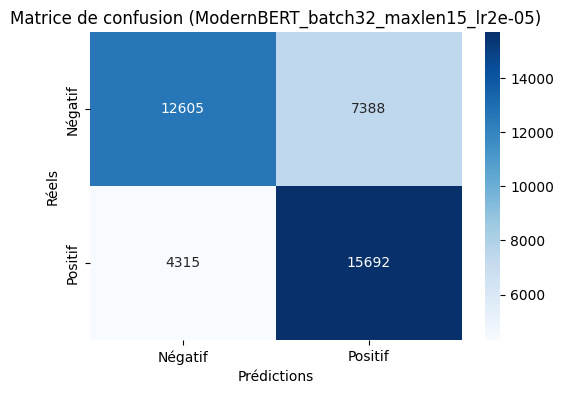

-----------------------------------------------------------------------------
ModernBERT_batch32_maxlen15_lr3e-05
Prétraitement des données...
Chargement du modèle...


Some weights of ModernBertForSequenceClassification were not initialized from the model checkpoint at answerdotai/ModernBERT-base and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Début de l'entraînement...


Epoch,Training Loss,Validation Loss,Accuracy,Recall,F1,Roc Auc
1,0.562200,0.566766,0.696531,0.696613,0.696205,0.696613
2,0.520000,0.563241,0.707063,0.706884,0.705324,0.706884
3,0.396100,0.663320,0.697750,0.697665,0.697329,0.697665


Évaluation du modèle...


📊 Génération de la matrice de confusion...


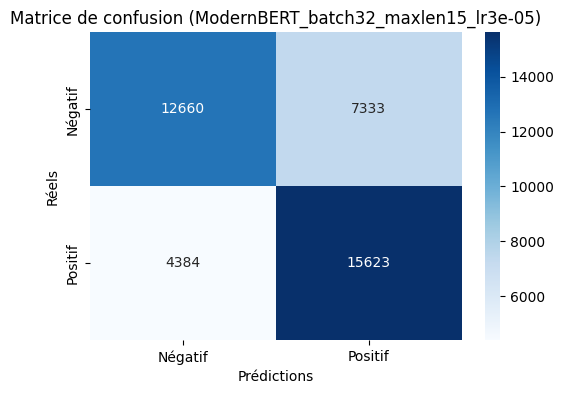

-----------------------------------------------------------------------------
ModernBERT_batch32_maxlen30_lr2e-05
Prétraitement des données...
Chargement du modèle...


Some weights of ModernBertForSequenceClassification were not initialized from the model checkpoint at answerdotai/ModernBERT-base and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Début de l'entraînement...


Epoch,Training Loss,Validation Loss,Accuracy,Recall,F1,Roc Auc
1,0.523500,0.519441,0.737469,0.737465,0.737466,0.737465


In [ ]:
# Hyperparamètres ModernBERT
model_name = "answerdotai/ModernBERT-base"
batch_sizes = [32,64]
max_length_list = [15, 30]
learning_rates = [1e-5 , 2e-5 , 3e-5]
epochs = 3  # ModernBERT converge vite

best_recall_class_0 = 0
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Tokenizer
print("Chargement du tokenizer...")
tokenizer = AutoTokenizer.from_pretrained(model_name)

for  batch_size, max_length, learning_rate in product( batch_sizes,max_length_list, learning_rates):
    run_name = f"ModernBERT_batch{batch_size}_maxlen{max_length}_lr{learning_rate}"
    with mlflow.start_run(experiment_id='342420157858240682', run_name=run_name):

        mlflow.log_param("model", model_name)
        mlflow.log_param("batch_size", batch_size)
        mlflow.log_param("max_length", max_length)
        mlflow.log_param("learning_rate", learning_rate)
        mlflow.log_param("epochs", epochs)

        print("-----------------------------------------------------------------------------")
        print(f"{run_name}")

        # Vérification et Prétraitement des données
        def preprocess_data(texts, targets, max_length):
            encodings = tokenizer(texts, padding=True, truncation=True, max_length=max_length, return_tensors="pt")

            # 🔍 Vérification des NaN dans targets
            targets = torch.tensor(targets, dtype=torch.long)
            if torch.isnan(targets).any():
                raise ValueError("⚠️ Les labels contiennent des NaN !")

            return Dataset.from_dict({
                "input_ids": encodings["input_ids"],
                "attention_mask": encodings["attention_mask"],
                "labels": targets
            })

        print("Prétraitement des données...")
        dt_train = preprocess_data(X_train["token_by_tweet_finalised_sans_racinisation"].astype(str).tolist(), X_train["target"].tolist(), max_length)
        dt_val = preprocess_data(X_val["token_by_tweet_finalised_sans_racinisation"].astype(str).tolist(), X_val["target"].tolist(), max_length)
        dt_test = preprocess_data(X_test["token_by_tweet_finalised_sans_racinisation"].astype(str).tolist(), X_test["target"].tolist(), max_length)

        # Modèle
        print("Chargement du modèle...")
        model = AutoModelForSequenceClassification.from_pretrained(
            model_name, num_labels=2).to(device)

        # Arguments
        training_args = TrainingArguments(
            output_dir=f"D:/tutorial-env/OCR/Projet7/save/{run_name}",
            evaluation_strategy="epoch",
            save_strategy="epoch",
            learning_rate=learning_rate,
            per_device_train_batch_size=batch_size,
            per_device_eval_batch_size=batch_size,
            num_train_epochs=epochs,
            weight_decay=0.01,
            load_best_model_at_end=True,
            metric_for_best_model="eval_loss",
            save_total_limit=2,
            fp16=False,
            bf16=True,
            gradient_checkpointing=True,
            report_to="none"  # On évite Weights & Biases pour rester sur MLflow
        )

        # Callback pour détecter les NaN
        class CheckForNaNsCallback(TrainerCallback):
            def on_log(self, args, state, control, logs=None, **kwargs):
                if logs and "loss" in logs and torch.isnan(torch.tensor(logs["loss"])).any():
                    print(f"NaN détecté dans la loss à l'étape {state.global_step}")
                    control.should_training_stop = True

        # Fonction de métrique
        def compute_metrics(eval_pred):
          logits,labels = eval_pred
          predictions = np.argmax(logits, axis=1)

          if np.isnan(predictions).any():
              print("⚠️ Erreur : Les prédictions contiennent NaN. Correction en cours...")
              predictions = np.nan_to_num(predictions)

          y_pred = (predictions > 0.5).astype(int)
          return {
              "accuracy": accuracy_score(labels, y_pred),
              "recall": recall_score(labels, y_pred, average="macro"),
              "f1": f1_score(labels, y_pred, average="macro"),
              "roc_auc": roc_auc_score(labels, predictions)
        }

        # Début de l'entraînement
        print("Début de l'entraînement...")
        trainer = Trainer(
            model=model,
            args=training_args,
            train_dataset=dt_train,
            eval_dataset=dt_val,
            compute_metrics=compute_metrics,
            callbacks=[CheckForNaNsCallback()]
        )

        trainer.train()

        # Évaluation
        print("Évaluation du modèle...")
        predictions = trainer.predict(dt_test)
        logits = predictions.predictions #proba
        y_proba_positive_class = torch.sigmoid(torch.tensor(logits)[:,1]).numpy()
        y_pred = np.argmax(logits, axis=1) #prediction binaire
        labels = predictions.label_ids # Les vraies étiquettes

        test_accuracy = accuracy_score(labels, y_pred)
        test_recall = recall_score(labels, y_pred, average="macro")
        test_f1 = f1_score(labels, y_pred, average="macro")
        test_roc_auc = roc_auc_score(labels, y_proba_positive_class)

        report = classification_report(labels, y_pred, output_dict=True)
        recall_class_0 = report["0"]["recall"]

        # Log MLflow
        mlflow.log_metric("test_accuracy", test_accuracy)
        mlflow.log_metric("test_recall", test_recall)
        mlflow.log_metric("test_f1", test_f1)
        mlflow.log_metric("test_roc_auc", test_roc_auc)
        mlflow.log_metric("recall_class_0", recall_class_0)

        # Matrice de confusion
        print("📊 Génération de la matrice de confusion...")
        conf_matrix = confusion_matrix(labels, y_pred)
        plt.figure(figsize=(6, 4))
        sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=["Négatif", "Positif"],
                    yticklabels=["Négatif", "Positif"])
        plt.xlabel("Prédictions")
        plt.ylabel("Réels")
        plt.title(f"Matrice de confusion ({run_name})")
        plt.savefig(f"D:/tutorial-env/OCR/Projet7/save/confusion_matrix_{run_name}.png")
        plt.show()
        plt.close()
        mlflow.log_artifact(f"D:/tutorial-env/OCR/Projet7/save/confusion_matrix_{run_name}.png")

        # 🔥 Sauvegarde du meilleur modèle
        if recall_class_0 > best_recall_class_0:
            best_recall_class_0 = recall_class_0
            best_run_name = run_name
            trainer.save_model(f"D:/tutorial-env/OCR/Projet7/save/{best_run_name}")
            mlflow.log_artifact(f"D:/tutorial-env/OCR/Projet7/save/{best_run_name}")

print("✅ Entraînement de ModernBERT terminé avec log MLflow et sauvegarde du meilleur modèle")

In [ ]:
process = subprocess.Popen(["mlflow", "ui", "--backend-store-uri", "file:/D:/tutorial-env/OCR/Projet7/mlruns", "--port", "5006"],stdout = subprocess.PIPE, stderr = subprocess.PIPE)
time.sleep(1)
webbrowser.open("http://localhost:5006")
print(f"MLFlow lancé")

Dans ce cas de la classification avec ModernBERT, les meilleurs résultats sont avec les hyperparamètres suivants :
- Batch size : 32
- Longueur max des séquences : 30
- Taux d'apprentissage : 3e-05

Résultats :
- un recall de 77% pour la classe négative,
- un f1 score de 73%,
- et une aire sous la courbe ROC de 0.81 (bonne capacité à distinguer les deux classes),
- la matrice de confusion montre un minimum de 4588 tweets négatifs manqués.

Voici la matrice de confusion :

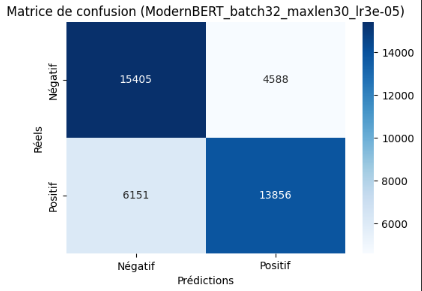

C'est donc avec le modèle BERT, ModernBERT, qu'on obtient les meilleurs résultats. C'est donc ce modèle qu'on déploiera.